##Tiny NeRF
This is a simplied version of the method presented in *NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis*

[Project Website](http://www.matthewtancik.com/nerf)

[arXiv Paper](https://arxiv.org/abs/2003.08934)

[Full Code](github.com/bmild/nerf)

Components not included in the notebook
*   5D input including view directions
*   Hierarchical Sampling



In [1]:
try:
  import google.colab
  IN_COLAB = True
except:
  IN_COLAB = False

if IN_COLAB:
    %tensorflow_version 2.x

import os, sys
import tensorflow as tf
tf.compat.v1.enable_eager_execution()

from tqdm import tqdm_notebook as tqdm
import numpy as np
import matplotlib.pyplot as plt

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [2]:
import os
if not os.path.exists('tiny_nerf_data.npz'):
    !wget --no-check-certificate http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz

--2024-04-21 14:50:04--  http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Resolving cseweb.ucsd.edu (cseweb.ucsd.edu)... 132.239.8.30
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz [following]
--2024-04-21 14:50:04--  https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:443... connected.
  Unable to locally verify the issuer's authority.
HTTP request sent, awaiting response... 200 OK
Length: 12727482 (12M)
Saving to: ‘tiny_nerf_data.npz’

tiny_nerf_data.npz  100%[===================>]  12.14M  21.2MB/s    in 0.6s    

2024-04-21 14:50:05 (21.2 MB/s) - ‘tiny_nerf_data.npz’ saved [12727482/12727482]



# Load Input Images and Poses

(106, 100, 100, 3) (106, 4, 4) 138.88887889922103


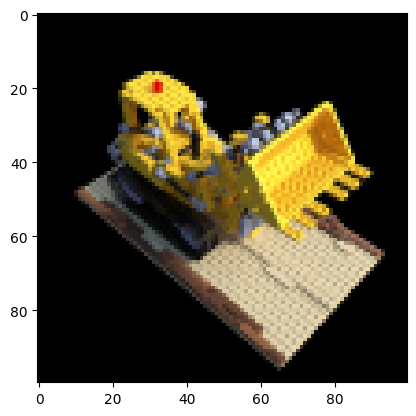

In [3]:
data = np.load('tiny_nerf_data.npz')
images = data['images']
poses = data['poses']
focal = data['focal']
H, W = images.shape[1:3]
print(images.shape, poses.shape, focal)

testimg, testpose = images[101], poses[101]
images = images[:100,...,:3]
poses = poses[:100]

plt.imshow(testimg)
plt.show()

# Optimize NeRF

In [4]:


def posenc(x):
  rets = [x]
  for i in range(L_embed):
    for fn in [tf.sin, tf.cos]:
      rets.append(fn(2.**i * x))
  return tf.concat(rets, -1)

L_embed = 6
embed_fn = posenc
# L_embed = 0
# embed_fn = tf.identity

def init_model(D=8, W=256):
    relu = tf.keras.layers.ReLU()
    dense = lambda W=W, act=relu : tf.keras.layers.Dense(W, activation=act)

    inputs = tf.keras.Input(shape=(3 + 3*2*L_embed))
    outputs = inputs
    for i in range(D):
        outputs = dense()(outputs)
        if i%4==0 and i>0:
            outputs = tf.concat([outputs, inputs], -1)
    outputs = dense(4, act=None)(outputs)

    model = tf.keras.Model(inputs=inputs, outputs=outputs)
    return model


def get_rays(H, W, focal, c2w):
    i, j = tf.meshgrid(tf.range(W, dtype=tf.float32), tf.range(H, dtype=tf.float32), indexing='xy')
    dirs = tf.stack([(i-W*.5)/focal, -(j-H*.5)/focal, -tf.ones_like(i)], -1)
    rays_d = tf.reduce_sum(dirs[..., np.newaxis, :] * c2w[:3,:3], -1)
    rays_o = tf.broadcast_to(c2w[:3,-1], tf.shape(rays_d))
    return rays_o, rays_d



def render_rays(network_fn, rays_o, rays_d, near, far, N_samples, rand=False):

    def batchify(fn, chunk=1024*32):
        return lambda inputs : tf.concat([fn(inputs[i:i+chunk]) for i in range(0, inputs.shape[0], chunk)], 0)

    # Compute 3D query points
    z_vals = tf.linspace(near, far, N_samples)
    if rand:
      z_vals += tf.random.uniform(list(rays_o.shape[:-1]) + [N_samples]) * (far-near)/N_samples
    pts = rays_o[...,None,:] + rays_d[...,None,:] * z_vals[...,:,None]

    # Run network
    pts_flat = tf.reshape(pts, [-1,3])
    pts_flat = embed_fn(pts_flat)
    raw = batchify(network_fn)(pts_flat)
    raw = tf.reshape(raw, list(pts.shape[:-1]) + [4])

    # Compute opacities and colors
    sigma_a = tf.nn.relu(raw[...,3])
    rgb = tf.math.sigmoid(raw[...,:3])

    # Do volume rendering
    dists = tf.concat([z_vals[..., 1:] - z_vals[..., :-1], tf.broadcast_to([1e10], z_vals[...,:1].shape)], -1)
    alpha = 1.-tf.exp(-sigma_a * dists)
    weights = alpha * tf.math.cumprod(1.-alpha + 1e-10, -1, exclusive=True)

    rgb_map = tf.reduce_sum(weights[...,None] * rgb, -2)
    depth_map = tf.reduce_sum(weights * z_vals, -1)
    acc_map = tf.reduce_sum(weights, -1)

    return rgb_map, depth_map, acc_map

In [5]:
!pip install lpips
!pip install scikit-image
!pip install torchmetrics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 744.5 kB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-many

<ipython-input-7-ae40becefd8a>:50: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_loss = 1 - tf.convert_to_tensor(compare_ssim(rgb_np, target_np, multichannel=True), dtype=tf.float32)


0 11.462666511535645 secs per iter


<ipython-input-7-ae40becefd8a>:91: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_score = compare_ssim(rgb_np, testimg_np, multichannel=True)


Iteration: 0,PSNR: 10.529450416564941, SSIM: 0.10176101498530421, LPIPS: 0.6323031783103943


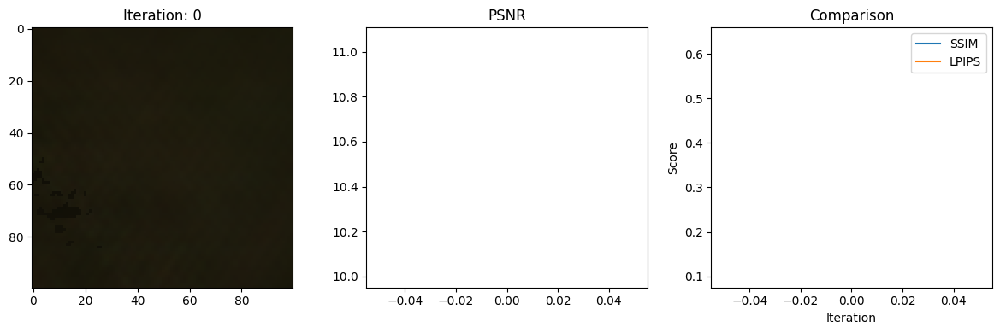

Data saved to: metrics.csv
1 8.508101224899292 secs per iter
Iteration: 1,PSNR: 10.854131698608398, SSIM: 0.10773344296718786, LPIPS: 0.5823944807052612


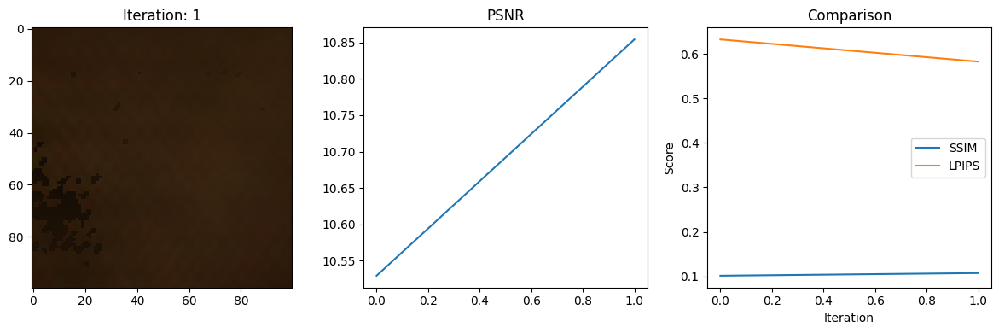

Data saved to: metrics.csv
2 8.461989402770996 secs per iter
Iteration: 2,PSNR: 11.125097274780273, SSIM: 0.09564898372813503, LPIPS: 0.5288705825805664


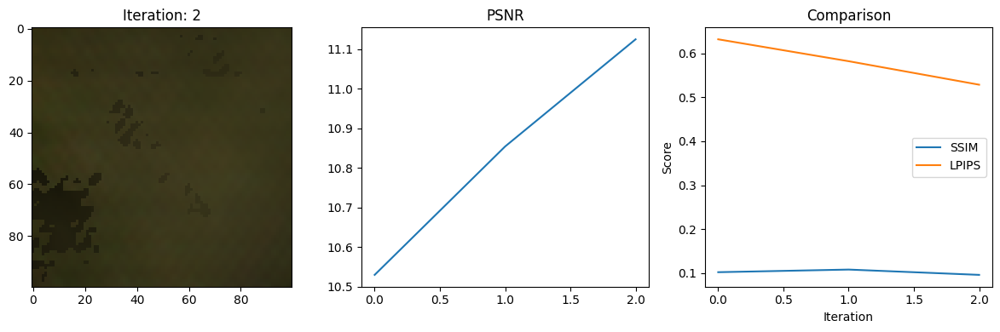

Data saved to: metrics.csv
3 8.51998519897461 secs per iter
Iteration: 3,PSNR: 11.288229942321777, SSIM: 0.10217646062809727, LPIPS: 0.5345851182937622


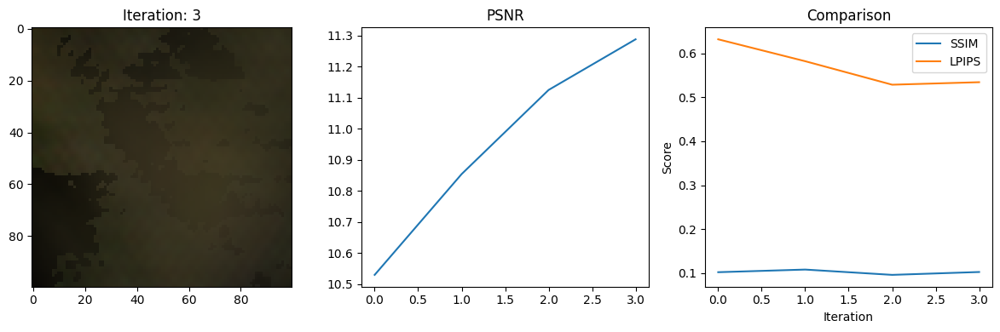

Data saved to: metrics.csv
4 8.716053009033203 secs per iter
Iteration: 4,PSNR: 11.777968406677246, SSIM: 0.14180623153885313, LPIPS: 0.5089948773384094


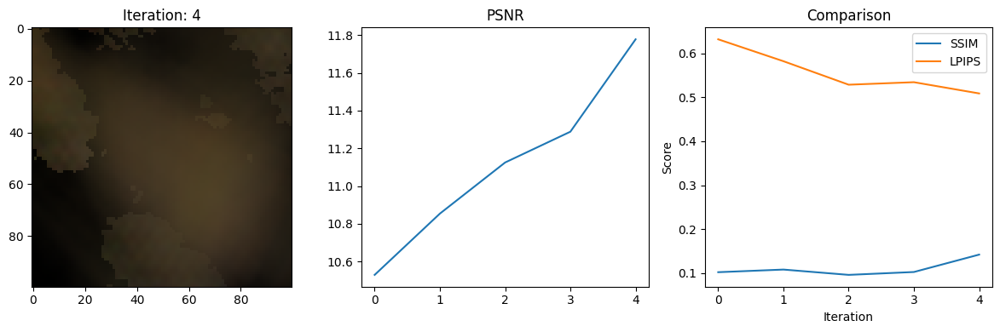

Data saved to: metrics.csv
5 8.353865623474121 secs per iter
Iteration: 5,PSNR: 12.675212860107422, SSIM: 0.2341809395082016, LPIPS: 0.5626975297927856


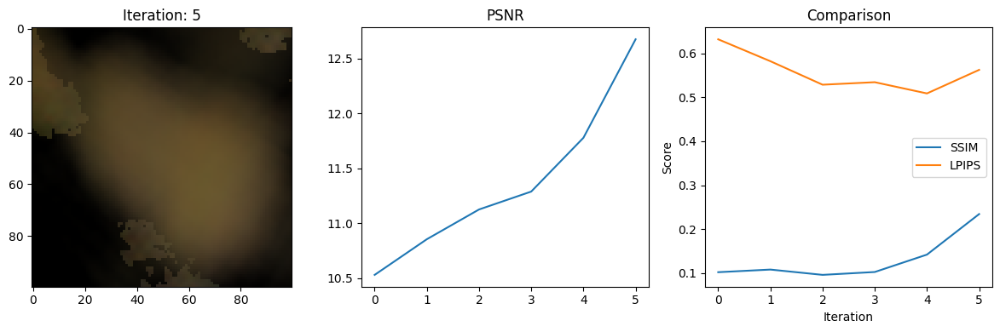

Data saved to: metrics.csv
6 8.241775274276733 secs per iter
Iteration: 6,PSNR: 13.76393985748291, SSIM: 0.3289767675743807, LPIPS: 0.6297114491462708


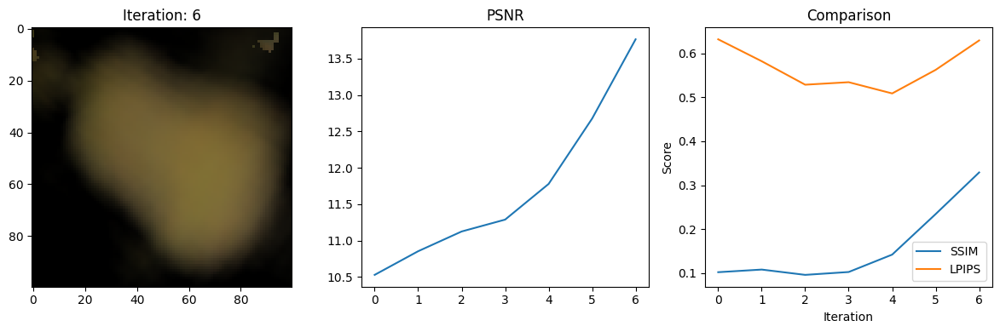

Data saved to: metrics.csv
7 8.32094955444336 secs per iter
Iteration: 7,PSNR: 14.215535163879395, SSIM: 0.3888518903022331, LPIPS: 0.606825590133667


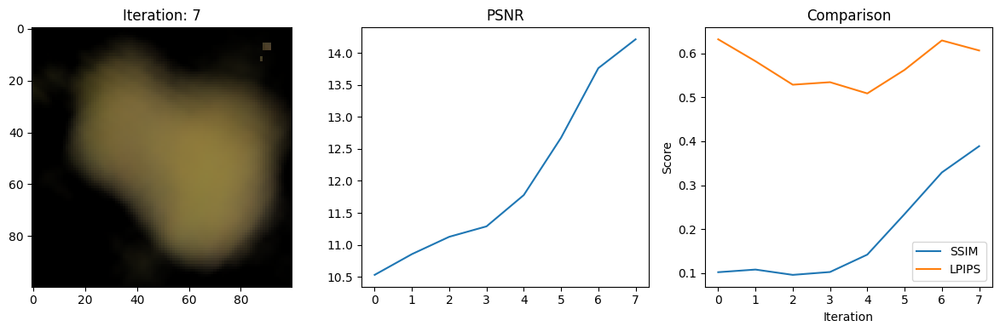

Data saved to: metrics.csv
8 8.690273523330688 secs per iter
Iteration: 8,PSNR: 14.405783653259277, SSIM: 0.39270112861087725, LPIPS: 0.6023457050323486


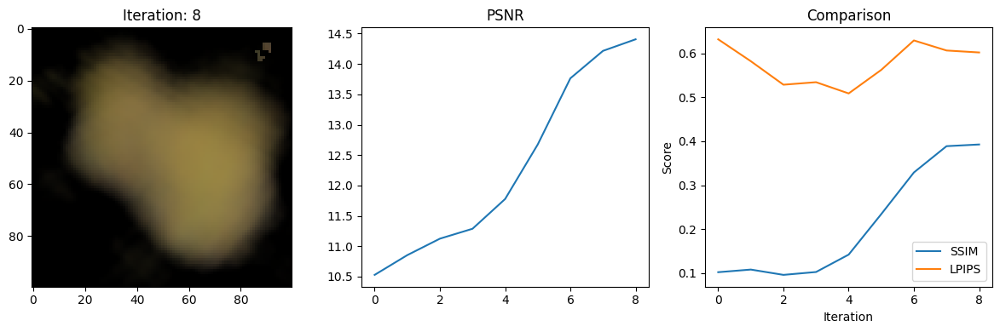

Data saved to: metrics.csv
9 8.355099439620972 secs per iter
Iteration: 9,PSNR: 14.609861373901367, SSIM: 0.4000155349242816, LPIPS: 0.5859596729278564


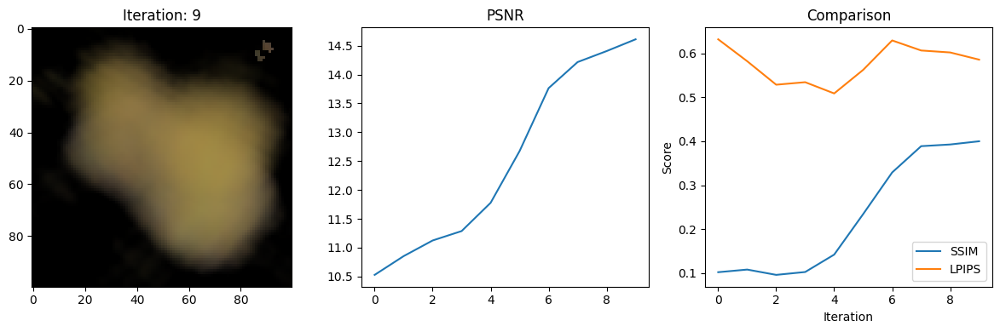

Data saved to: metrics.csv
10 8.68160605430603 secs per iter
Iteration: 10,PSNR: 14.83279037475586, SSIM: 0.4314613574878355, LPIPS: 0.5716033577919006


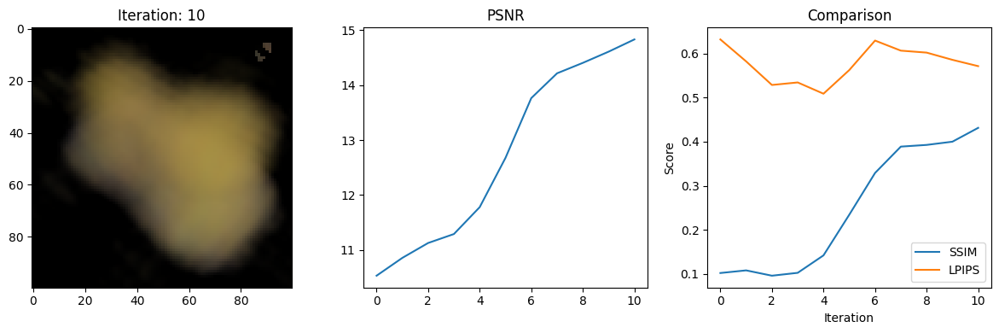

Data saved to: metrics.csv
11 8.487537145614624 secs per iter
Iteration: 11,PSNR: 15.116840362548828, SSIM: 0.5393150388150695, LPIPS: 0.5345684885978699


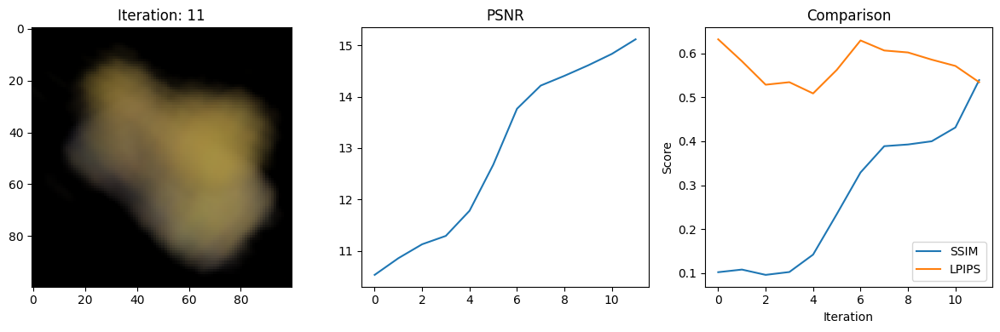

Data saved to: metrics.csv
12 8.606268167495728 secs per iter
Iteration: 12,PSNR: 15.169363021850586, SSIM: 0.5913553782253343, LPIPS: 0.4844765365123749


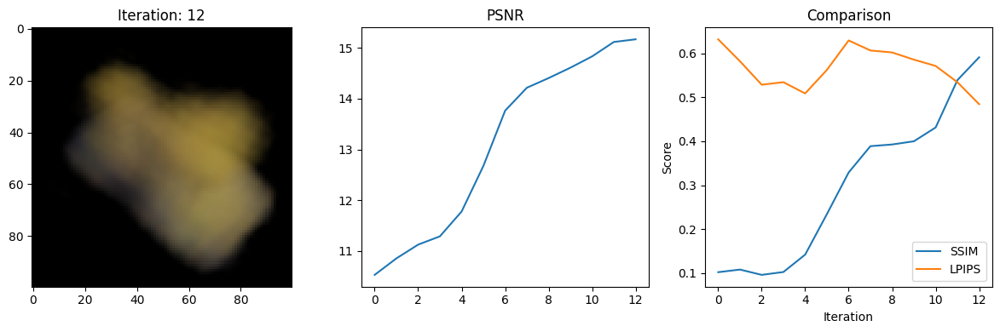

Data saved to: metrics.csv
13 8.634846448898315 secs per iter
Iteration: 13,PSNR: 15.839957237243652, SSIM: 0.5992871155785114, LPIPS: 0.46037811040878296


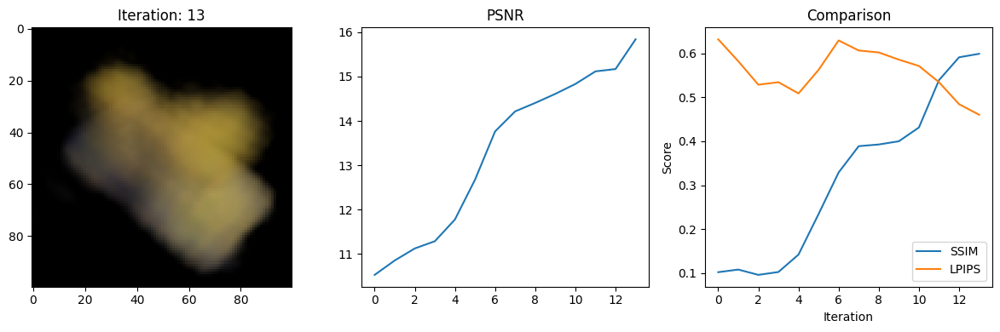

Data saved to: metrics.csv
14 8.819644689559937 secs per iter
Iteration: 14,PSNR: 16.4685115814209, SSIM: 0.613296157401999, LPIPS: 0.4443049132823944


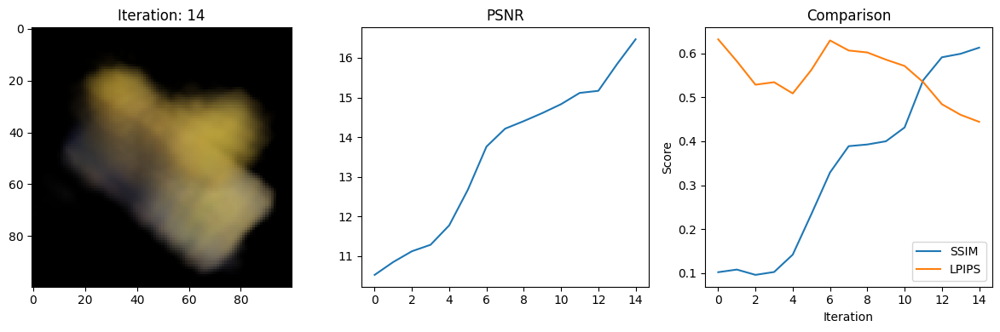

Data saved to: metrics.csv
15 8.844494104385376 secs per iter
Iteration: 15,PSNR: 16.98712730407715, SSIM: 0.6377793696375581, LPIPS: 0.41873082518577576


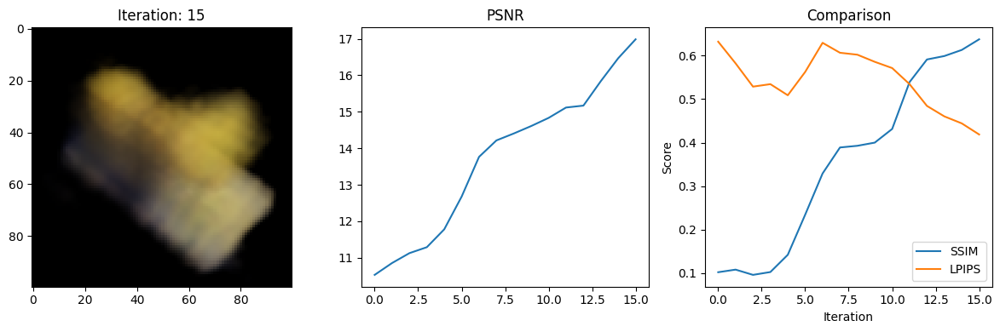

Data saved to: metrics.csv
16 8.872610092163086 secs per iter
Iteration: 16,PSNR: 17.421232223510742, SSIM: 0.6564821398114519, LPIPS: 0.39747485518455505


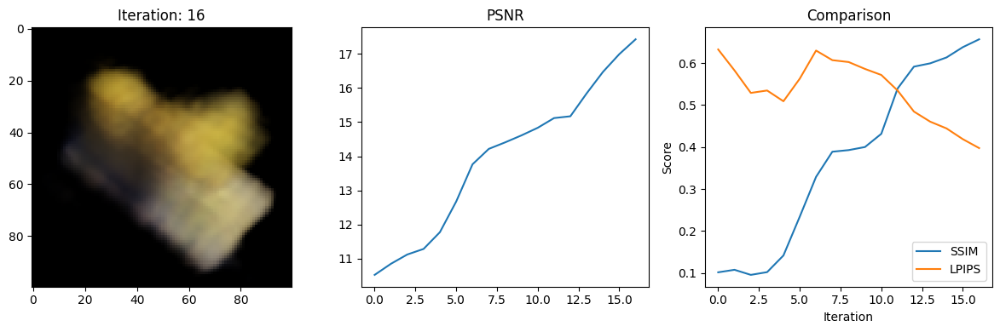

Data saved to: metrics.csv
17 9.09120488166809 secs per iter
Iteration: 17,PSNR: 17.723737716674805, SSIM: 0.6703980657384636, LPIPS: 0.3799811005592346


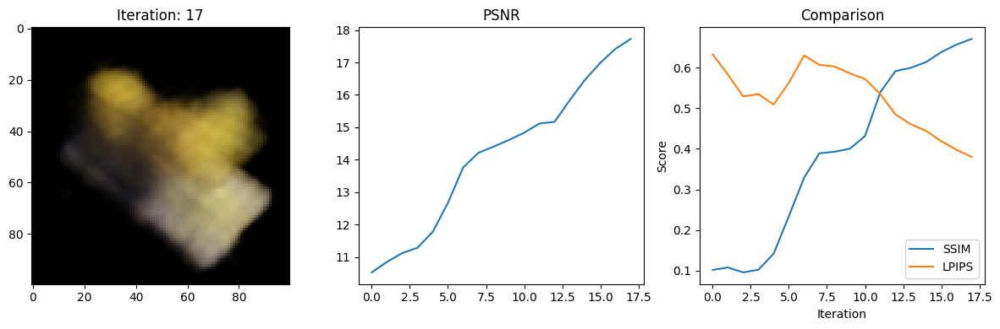

Data saved to: metrics.csv
18 8.882189512252808 secs per iter
Iteration: 18,PSNR: 17.9423828125, SSIM: 0.6803537269693506, LPIPS: 0.36994051933288574


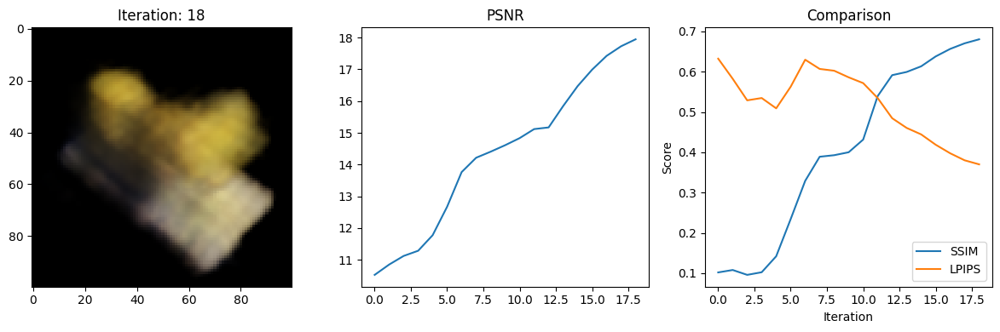

Data saved to: metrics.csv
19 8.76746416091919 secs per iter
Iteration: 19,PSNR: 18.247230529785156, SSIM: 0.6869969541429265, LPIPS: 0.36314821243286133


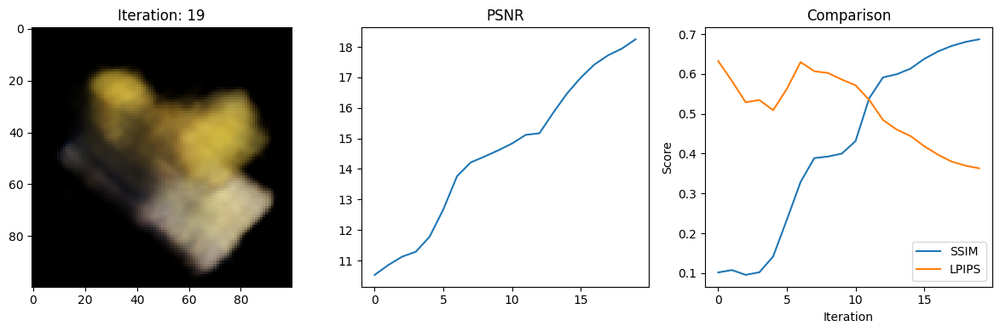

Data saved to: metrics.csv
20 8.835972785949707 secs per iter
Iteration: 20,PSNR: 18.509172439575195, SSIM: 0.6938174179094925, LPIPS: 0.34756016731262207


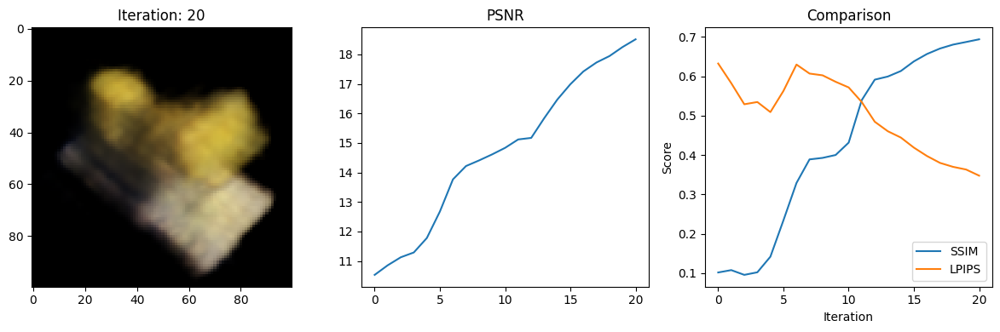

Data saved to: metrics.csv
21 9.090570449829102 secs per iter
Iteration: 21,PSNR: 18.6887264251709, SSIM: 0.7011252101258777, LPIPS: 0.33084025979042053


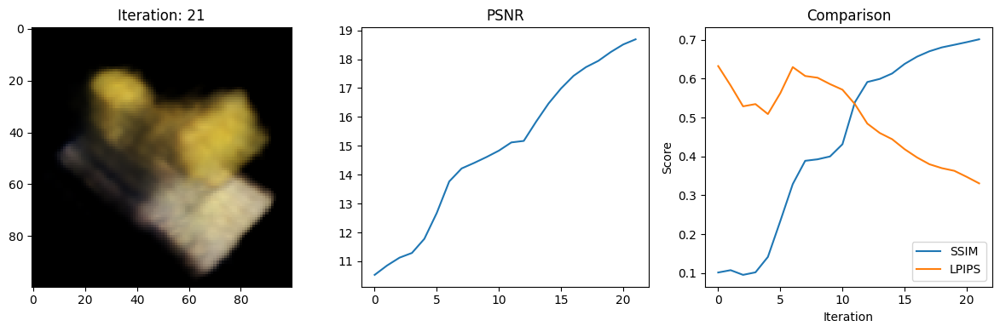

Data saved to: metrics.csv
22 8.720581531524658 secs per iter
Iteration: 22,PSNR: 18.7876033782959, SSIM: 0.7030839866427915, LPIPS: 0.322040855884552


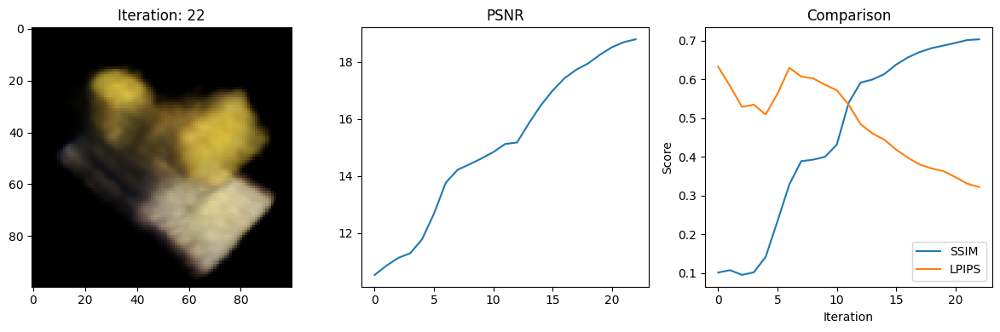

Data saved to: metrics.csv
23 9.12978219985962 secs per iter
Iteration: 23,PSNR: 18.94382095336914, SSIM: 0.7028618632383766, LPIPS: 0.31728506088256836


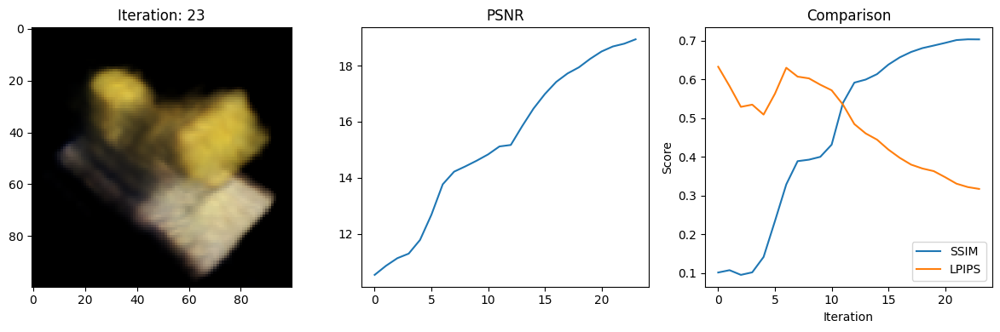

Data saved to: metrics.csv
24 8.72067379951477 secs per iter
Iteration: 24,PSNR: 19.074743270874023, SSIM: 0.7122889769195179, LPIPS: 0.3076774775981903


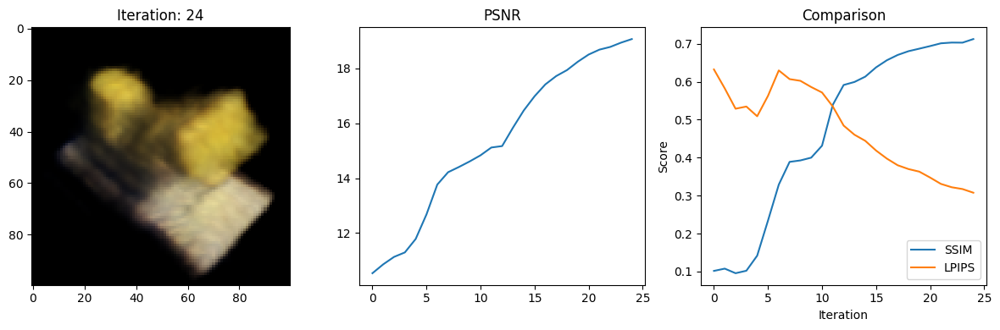

Data saved to: metrics.csv
25 9.420852184295654 secs per iter
Iteration: 25,PSNR: 19.11859130859375, SSIM: 0.7099531848826627, LPIPS: 0.3018459379673004


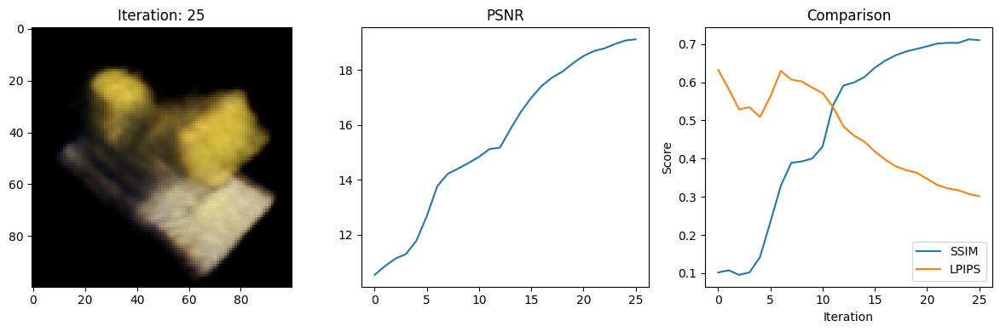

Data saved to: metrics.csv
26 8.810866117477417 secs per iter
Iteration: 26,PSNR: 19.17273712158203, SSIM: 0.7090537122013392, LPIPS: 0.29956743121147156


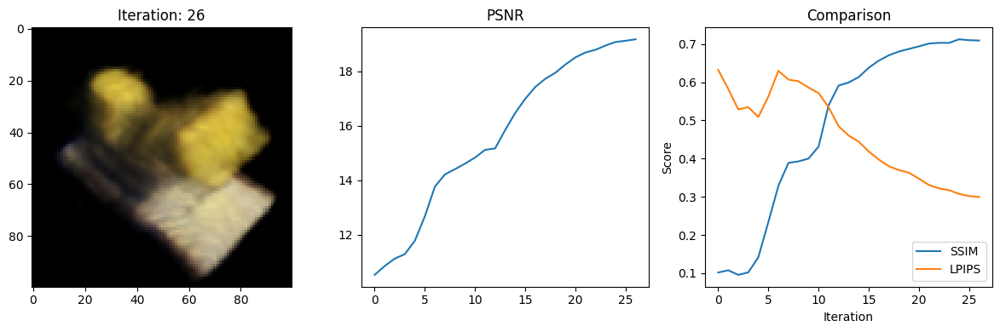

Data saved to: metrics.csv
27 8.80383849143982 secs per iter
Iteration: 27,PSNR: 19.28373146057129, SSIM: 0.7165317624727837, LPIPS: 0.29503047466278076


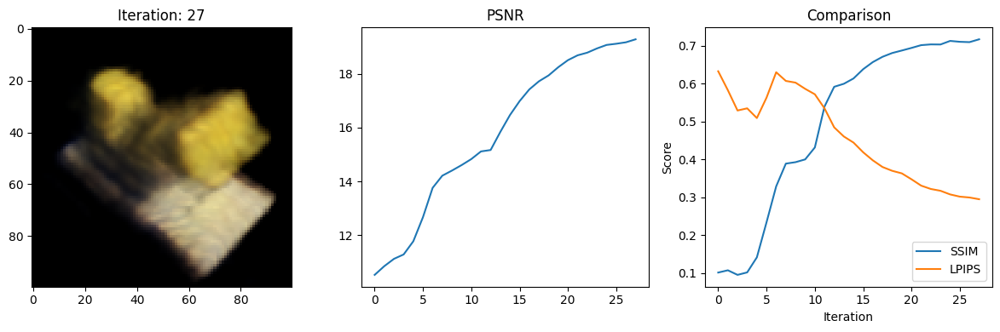

Data saved to: metrics.csv
28 8.750030279159546 secs per iter
Iteration: 28,PSNR: 19.314865112304688, SSIM: 0.7154715643663209, LPIPS: 0.2926931381225586


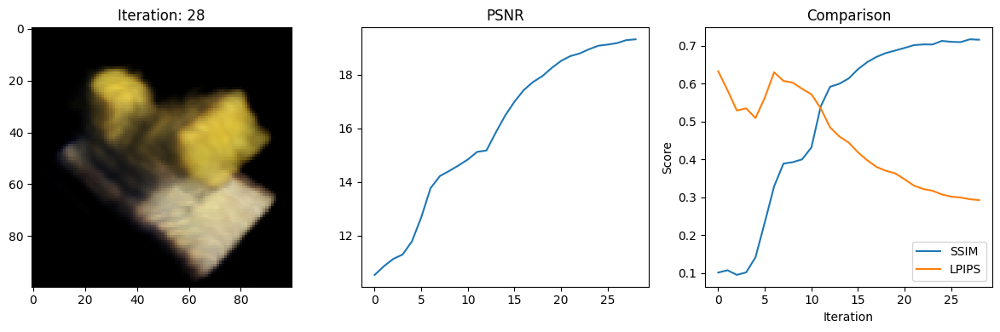

Data saved to: metrics.csv
29 8.955698490142822 secs per iter
Iteration: 29,PSNR: 19.3055477142334, SSIM: 0.7149850128426505, LPIPS: 0.2897835969924927


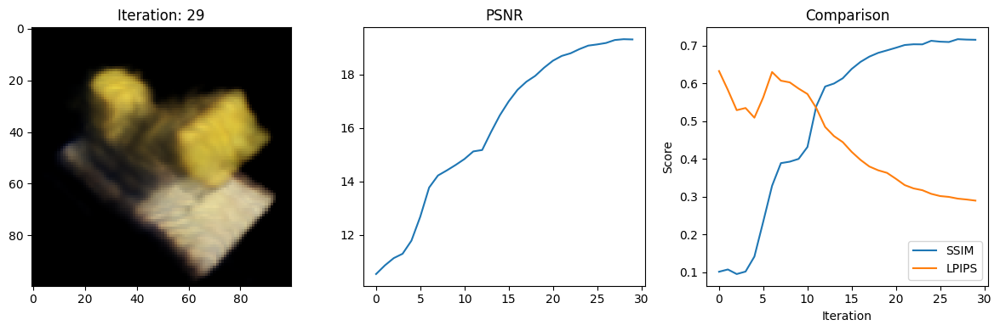

Data saved to: metrics.csv
30 8.762445211410522 secs per iter
Iteration: 30,PSNR: 19.413314819335938, SSIM: 0.720634566658981, LPIPS: 0.28386539220809937


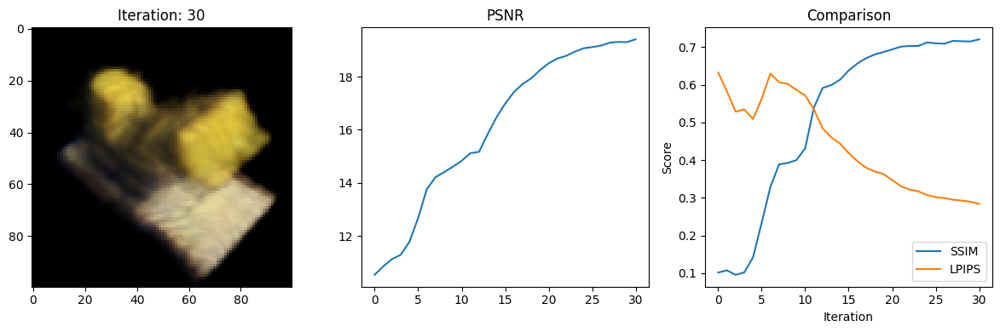

Data saved to: metrics.csv
31 8.743392944335938 secs per iter
Iteration: 31,PSNR: 19.39252281188965, SSIM: 0.7180731228690331, LPIPS: 0.27904629707336426


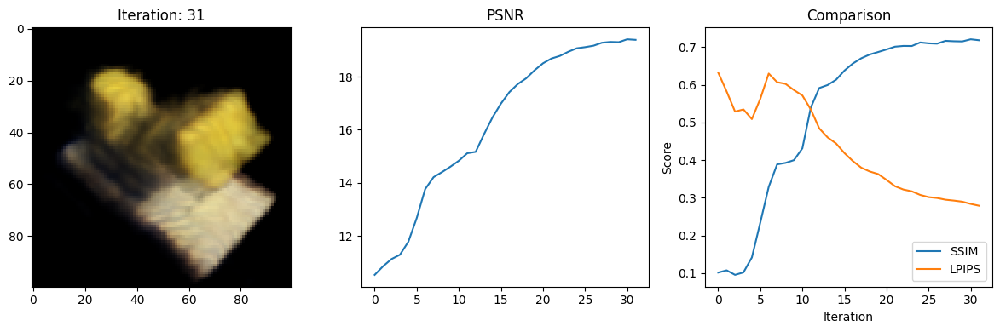

Data saved to: metrics.csv
32 8.701753616333008 secs per iter
Iteration: 32,PSNR: 19.499614715576172, SSIM: 0.7246206441208184, LPIPS: 0.2773471176624298


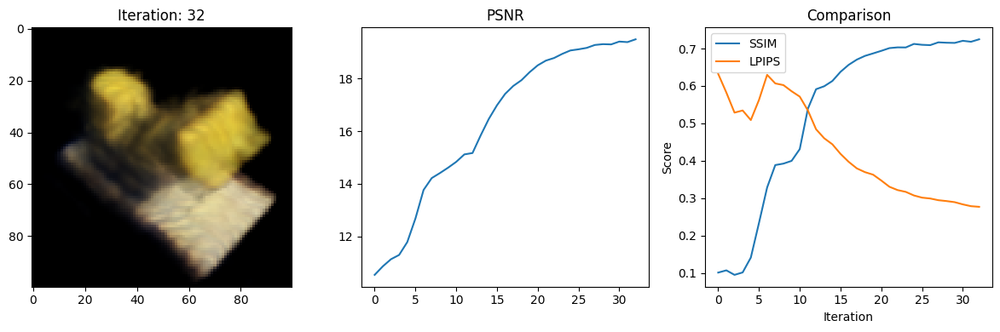

Data saved to: metrics.csv
33 8.895008325576782 secs per iter
Iteration: 33,PSNR: 19.390106201171875, SSIM: 0.7179984536738978, LPIPS: 0.27513575553894043


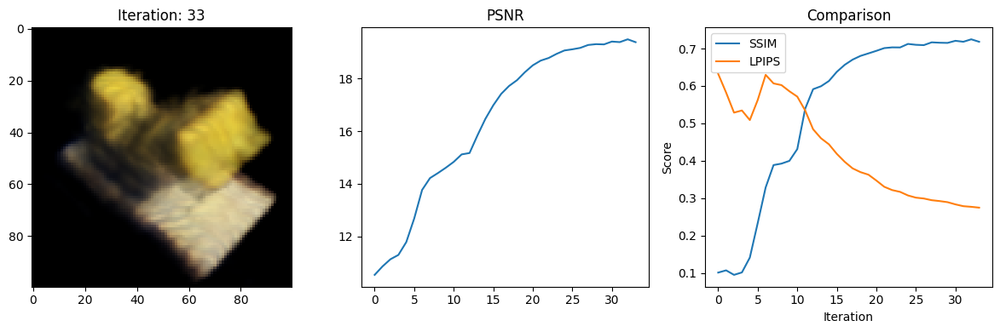

Data saved to: metrics.csv
34 8.723430633544922 secs per iter
Iteration: 34,PSNR: 19.576995849609375, SSIM: 0.7292282884869853, LPIPS: 0.274208664894104


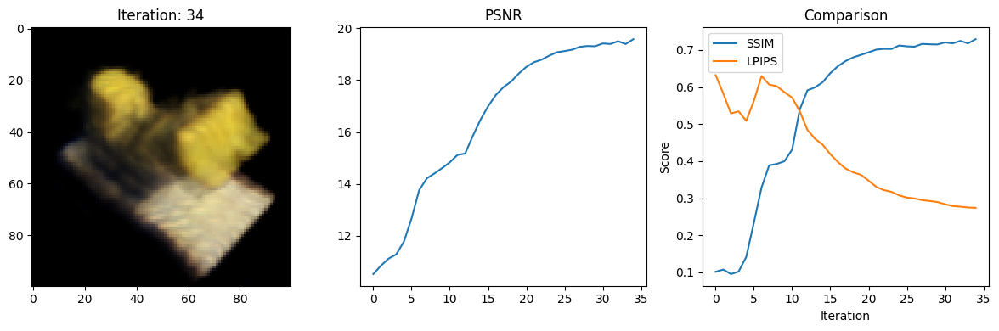

Data saved to: metrics.csv
35 8.78260326385498 secs per iter
Iteration: 35,PSNR: 19.332786560058594, SSIM: 0.7136484377339768, LPIPS: 0.27223020792007446


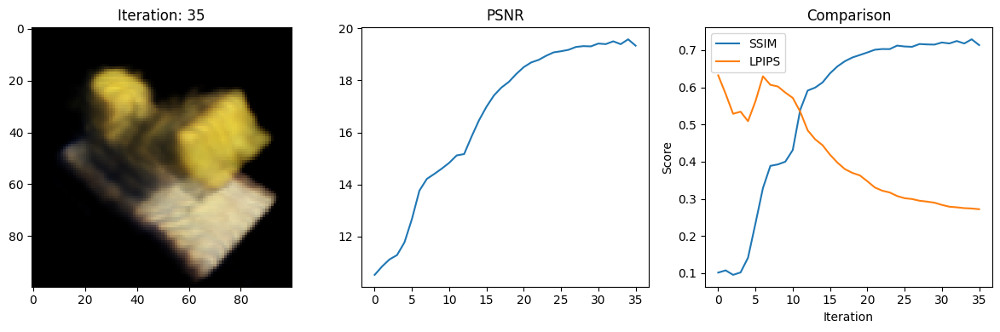

Data saved to: metrics.csv
36 8.702667951583862 secs per iter
Iteration: 36,PSNR: 19.62753677368164, SSIM: 0.7360437221658566, LPIPS: 0.2735365331172943


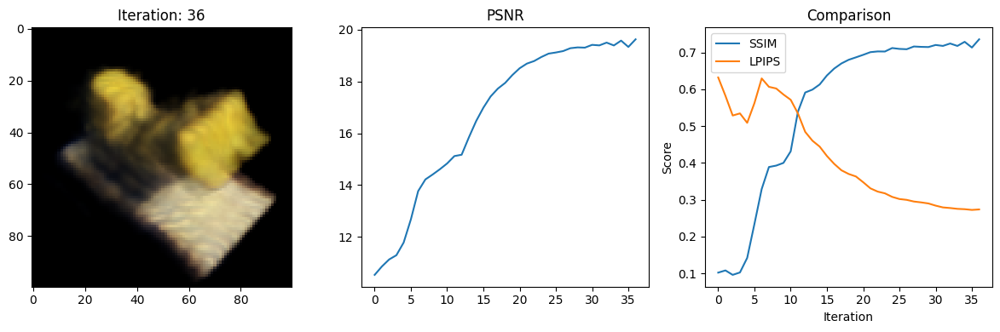

Data saved to: metrics.csv
37 8.936613082885742 secs per iter
Iteration: 37,PSNR: 19.216238021850586, SSIM: 0.709359537777142, LPIPS: 0.2659219801425934


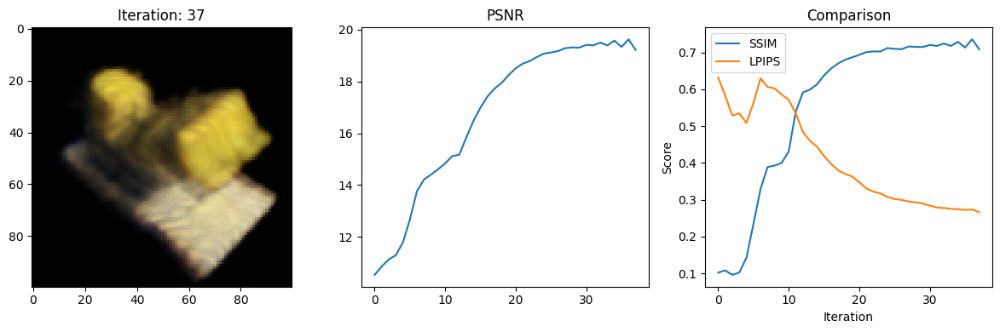

Data saved to: metrics.csv
38 8.77213168144226 secs per iter
Iteration: 38,PSNR: 19.672224044799805, SSIM: 0.7367879321043075, LPIPS: 0.27540257573127747


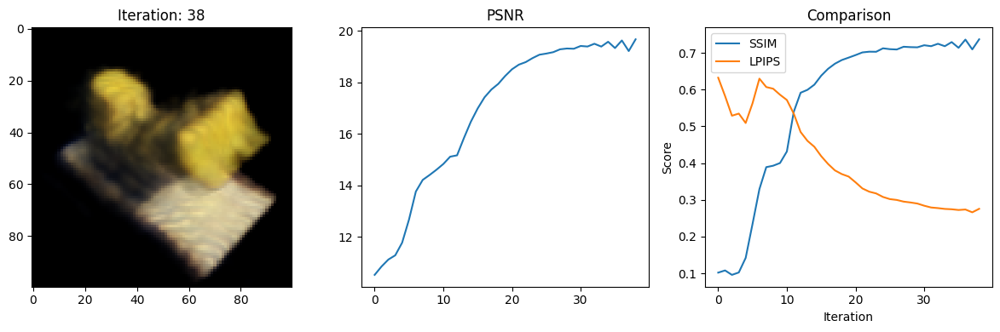

Data saved to: metrics.csv
39 9.203943967819214 secs per iter
Iteration: 39,PSNR: 19.47513198852539, SSIM: 0.7282093291097711, LPIPS: 0.25935593247413635


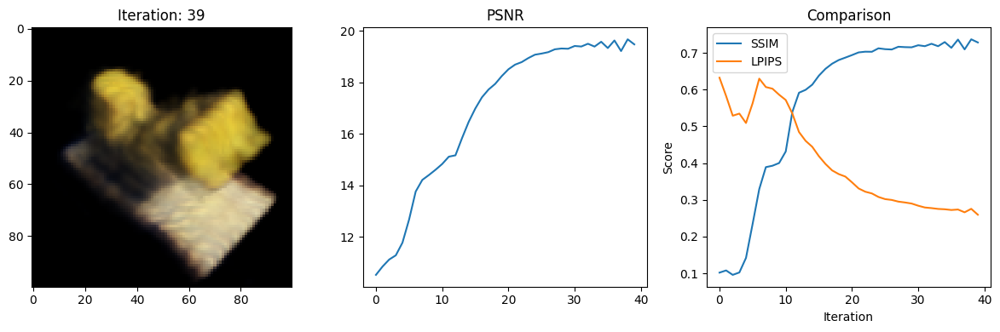

Data saved to: metrics.csv
40 8.727771997451782 secs per iter
Iteration: 40,PSNR: 19.40924072265625, SSIM: 0.7106456201615972, LPIPS: 0.2738596796989441


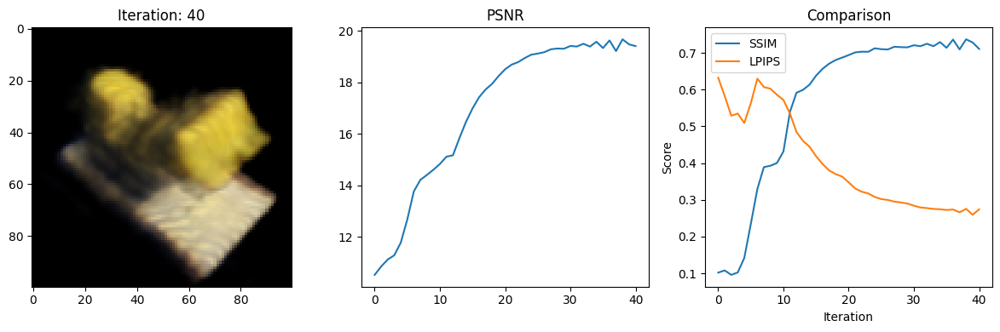

Data saved to: metrics.csv
41 8.96356987953186 secs per iter
Iteration: 41,PSNR: 19.626741409301758, SSIM: 0.7380827937385473, LPIPS: 0.26007768511772156


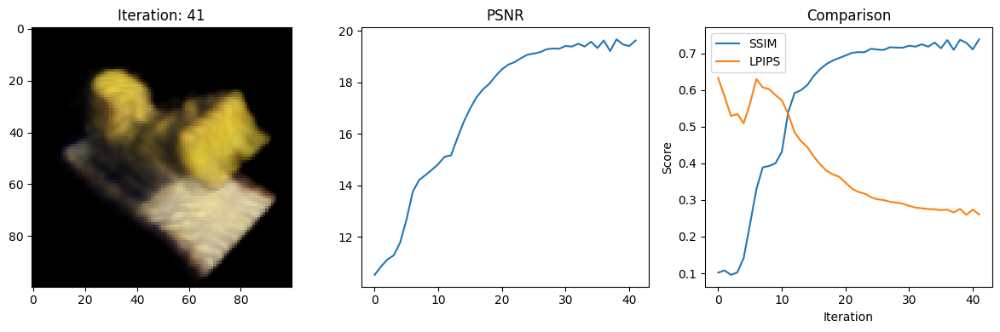

Data saved to: metrics.csv
42 8.739680767059326 secs per iter
Iteration: 42,PSNR: 19.671485900878906, SSIM: 0.7314251735998166, LPIPS: 0.2586114704608917


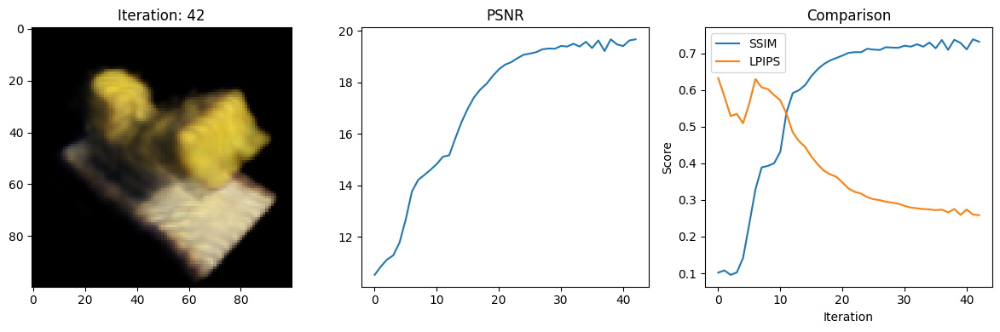

Data saved to: metrics.csv
43 8.72646713256836 secs per iter
Iteration: 43,PSNR: 19.658153533935547, SSIM: 0.7323656820807313, LPIPS: 0.26333436369895935


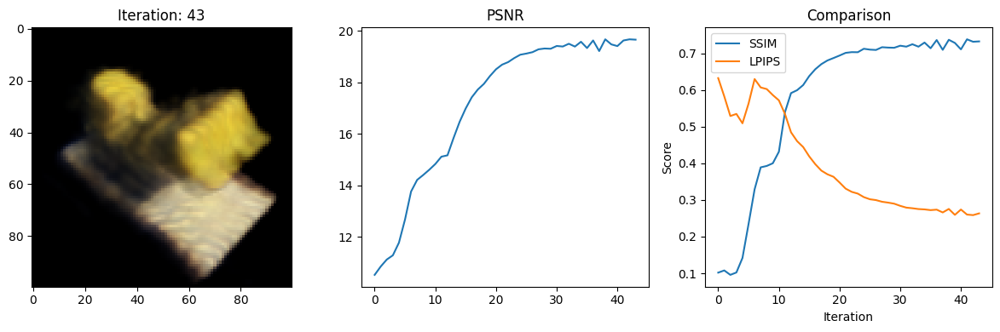

Data saved to: metrics.csv
44 8.710411787033081 secs per iter
Iteration: 44,PSNR: 19.756200790405273, SSIM: 0.7363776942474553, LPIPS: 0.25338655710220337


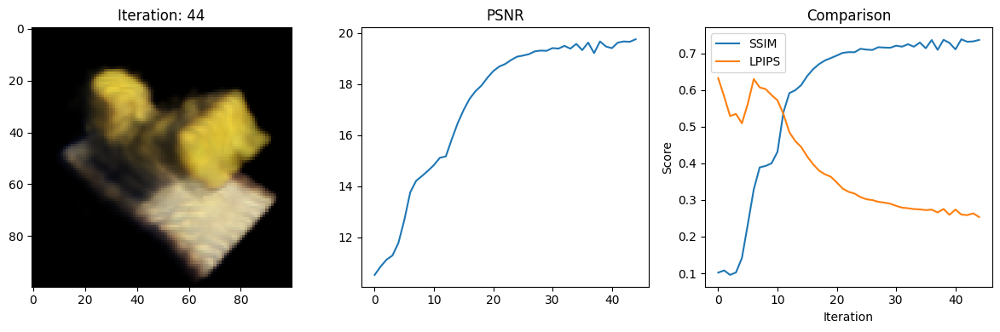

Data saved to: metrics.csv
45 8.752147436141968 secs per iter
Iteration: 45,PSNR: 19.75064468383789, SSIM: 0.7356238862757146, LPIPS: 0.2595282196998596


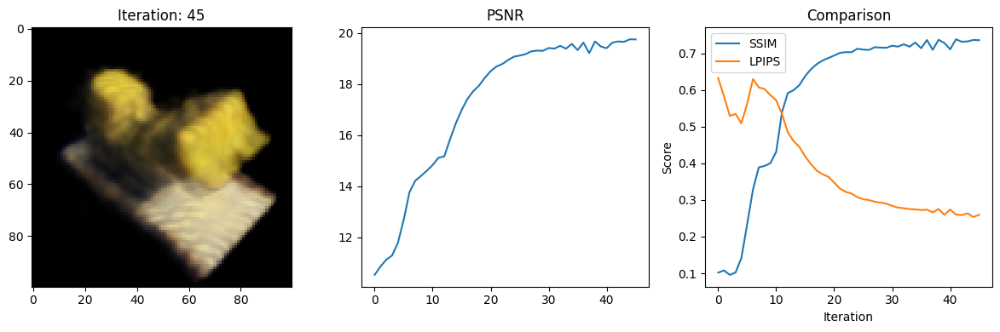

Data saved to: metrics.csv
46 8.77014970779419 secs per iter
Iteration: 46,PSNR: 19.66901206970215, SSIM: 0.7308370863272687, LPIPS: 0.25293025374412537


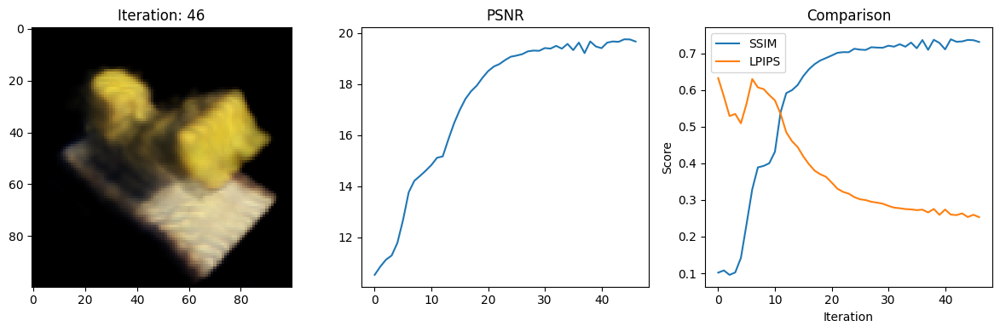

Data saved to: metrics.csv
47 8.798884868621826 secs per iter
Iteration: 47,PSNR: 19.833953857421875, SSIM: 0.7402191600640601, LPIPS: 0.25609976053237915


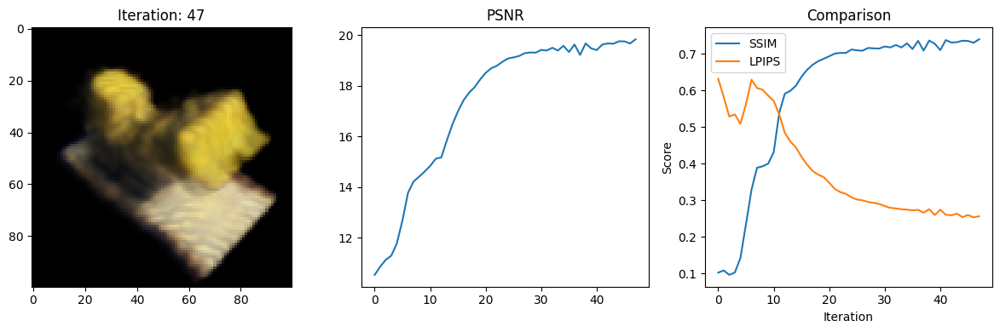

Data saved to: metrics.csv
48 8.705309391021729 secs per iter
Iteration: 48,PSNR: 19.550521850585938, SSIM: 0.72477575544373, LPIPS: 0.24909937381744385


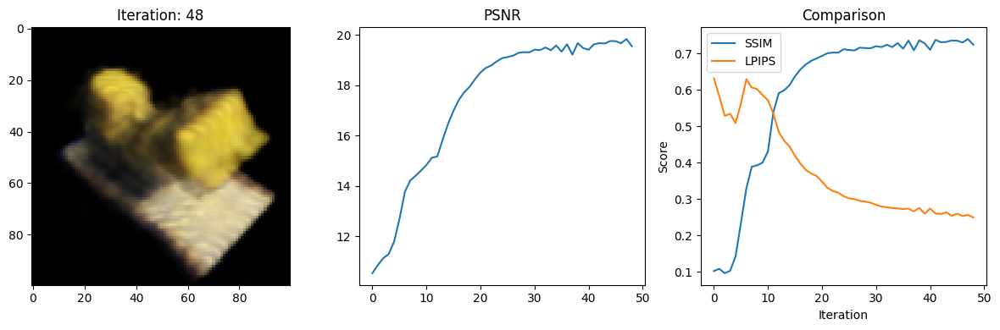

Data saved to: metrics.csv
49 8.794184446334839 secs per iter
Iteration: 49,PSNR: 19.842823028564453, SSIM: 0.7445308429870846, LPIPS: 0.25183117389678955


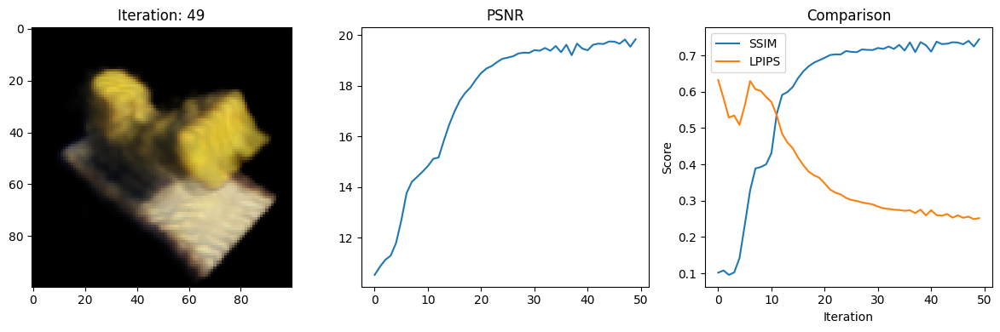

Data saved to: metrics.csv
50 8.719239234924316 secs per iter
Iteration: 50,PSNR: 19.305500030517578, SSIM: 0.7125204539442159, LPIPS: 0.25090882182121277


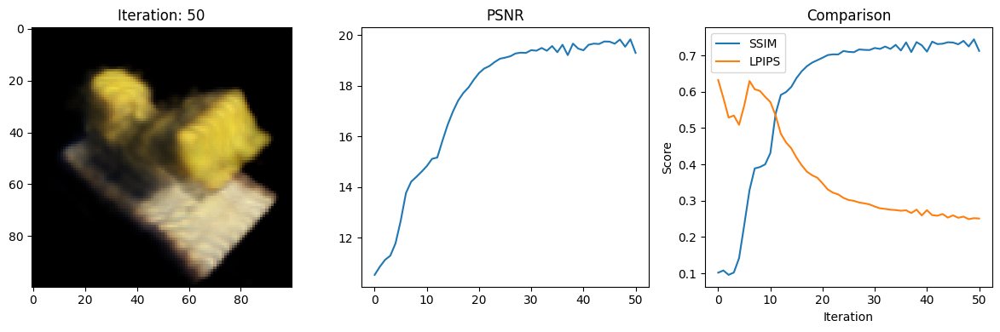

Data saved to: metrics.csv
51 8.699634552001953 secs per iter
Iteration: 51,PSNR: 19.796728134155273, SSIM: 0.7480574088605794, LPIPS: 0.24836033582687378


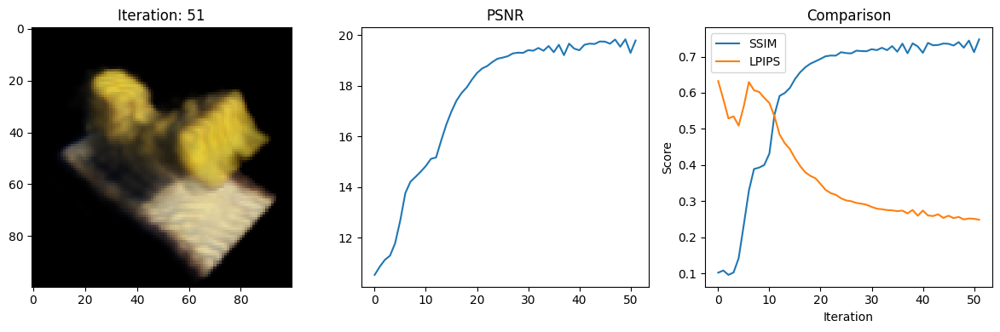

Data saved to: metrics.csv
52 8.94793701171875 secs per iter
Iteration: 52,PSNR: 19.302352905273438, SSIM: 0.7148373622518932, LPIPS: 0.24585208296775818


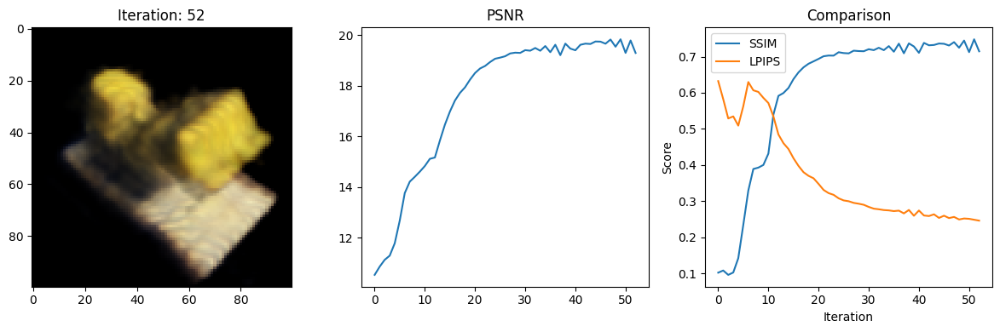

Data saved to: metrics.csv
53 8.76741099357605 secs per iter
Iteration: 53,PSNR: 19.840394973754883, SSIM: 0.7431896303752062, LPIPS: 0.2537086308002472


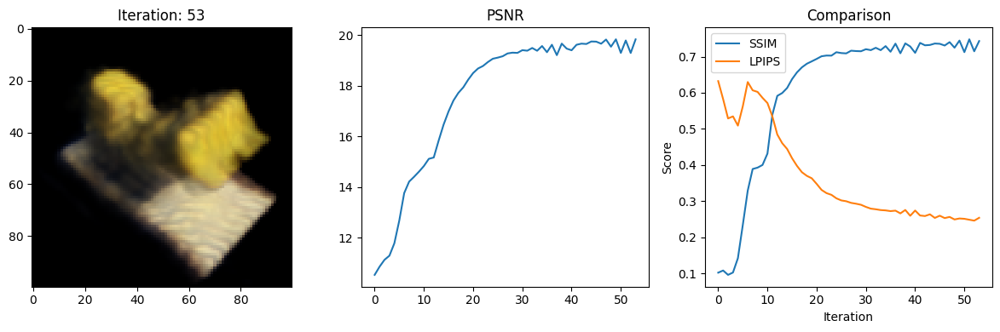

Data saved to: metrics.csv
54 9.166991710662842 secs per iter
Iteration: 54,PSNR: 19.72053337097168, SSIM: 0.7397156481978198, LPIPS: 0.24349285662174225


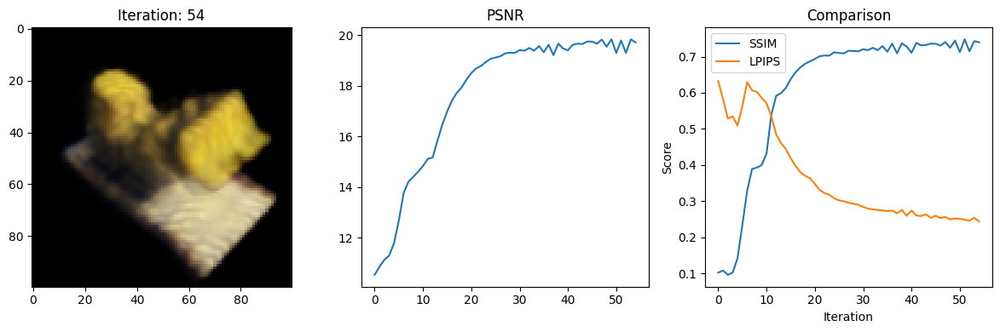

Data saved to: metrics.csv
55 8.752944707870483 secs per iter
Iteration: 55,PSNR: 19.655893325805664, SSIM: 0.7250394563314478, LPIPS: 0.25694355368614197


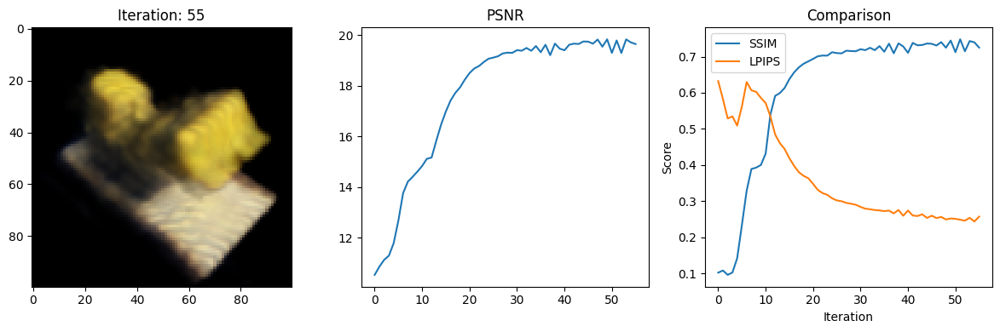

Data saved to: metrics.csv
56 8.970166206359863 secs per iter
Iteration: 56,PSNR: 19.84478759765625, SSIM: 0.7455396720448849, LPIPS: 0.24416348338127136


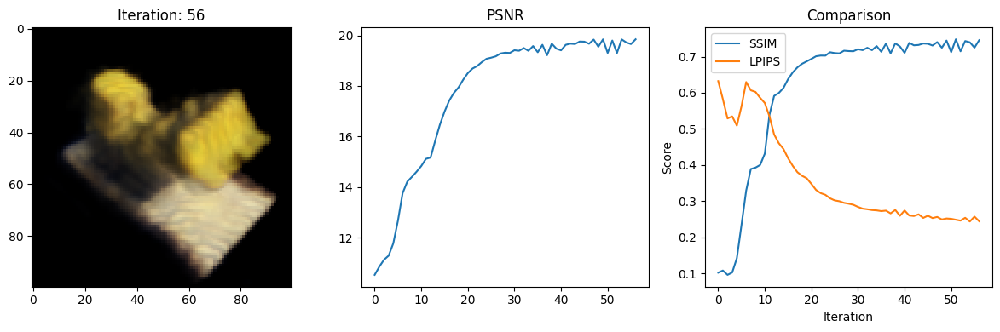

Data saved to: metrics.csv
57 8.792877912521362 secs per iter
Iteration: 57,PSNR: 19.93051528930664, SSIM: 0.7435484794900211, LPIPS: 0.2444005310535431


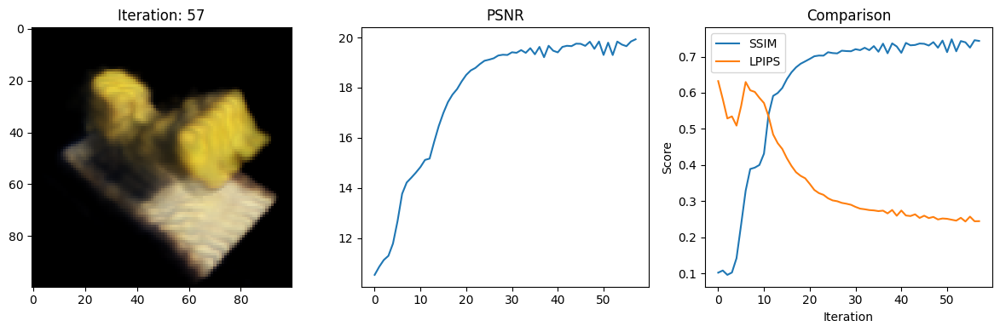

Data saved to: metrics.csv
58 8.78636884689331 secs per iter
Iteration: 58,PSNR: 19.82624626159668, SSIM: 0.7374659158852052, LPIPS: 0.24711723625659943


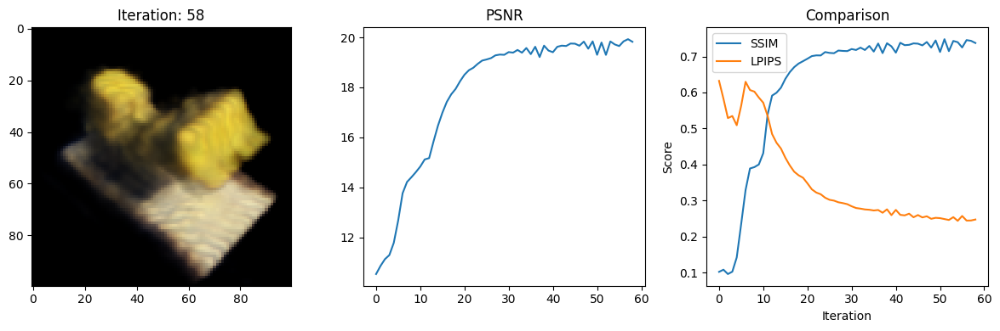

Data saved to: metrics.csv
59 8.740466356277466 secs per iter
Iteration: 59,PSNR: 19.932361602783203, SSIM: 0.7459620689941672, LPIPS: 0.24072033166885376


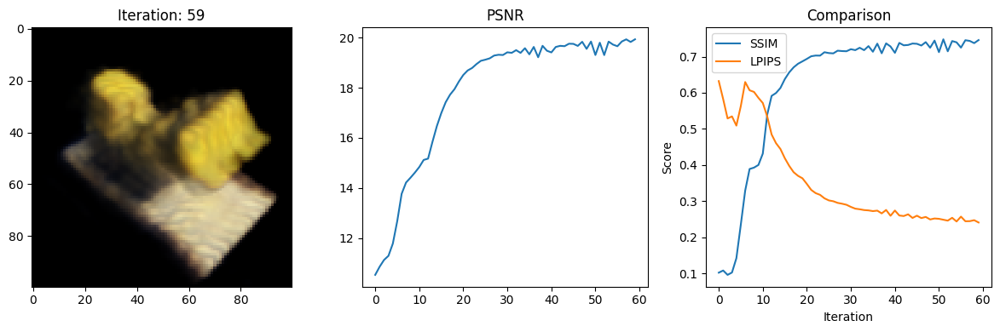

Data saved to: metrics.csv
60 8.990288019180298 secs per iter
Iteration: 60,PSNR: 19.90366554260254, SSIM: 0.7422276844476836, LPIPS: 0.24308322370052338


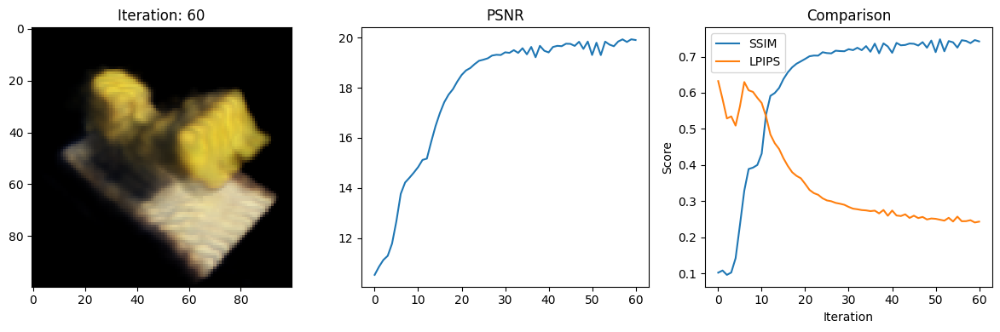

Data saved to: metrics.csv
61 8.79145884513855 secs per iter
Iteration: 61,PSNR: 19.883562088012695, SSIM: 0.7420320697024199, LPIPS: 0.2422095239162445


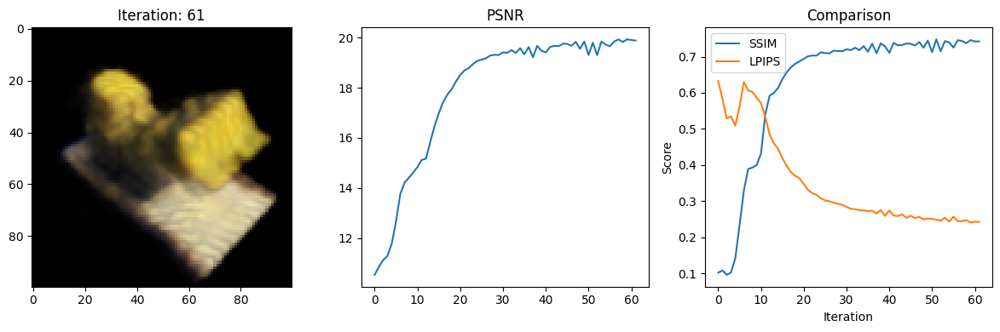

Data saved to: metrics.csv
62 8.744389057159424 secs per iter
Iteration: 62,PSNR: 19.921924591064453, SSIM: 0.7425752153140027, LPIPS: 0.24016903340816498


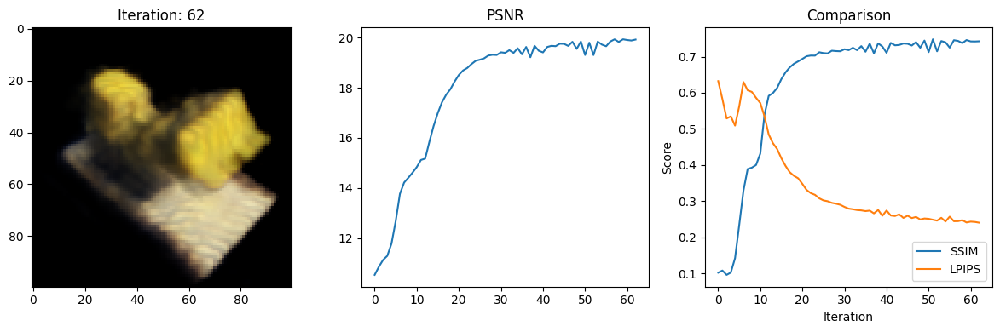

Data saved to: metrics.csv
63 8.698970556259155 secs per iter
Iteration: 63,PSNR: 19.915966033935547, SSIM: 0.7435686301841796, LPIPS: 0.24006877839565277


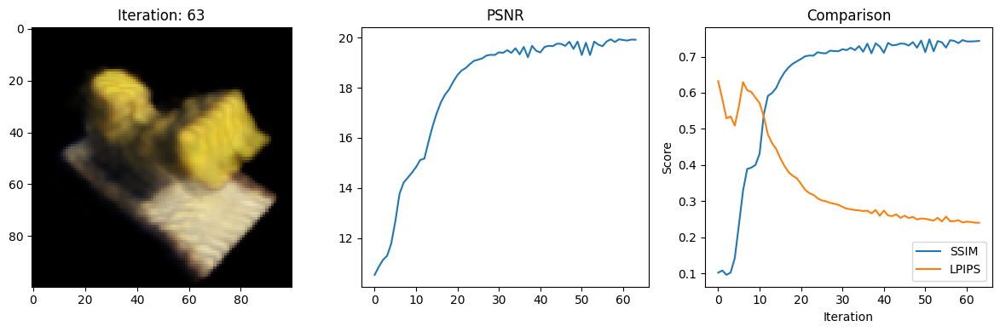

Data saved to: metrics.csv
64 9.013241052627563 secs per iter
Iteration: 64,PSNR: 19.864744186401367, SSIM: 0.7407361083887792, LPIPS: 0.23849761486053467


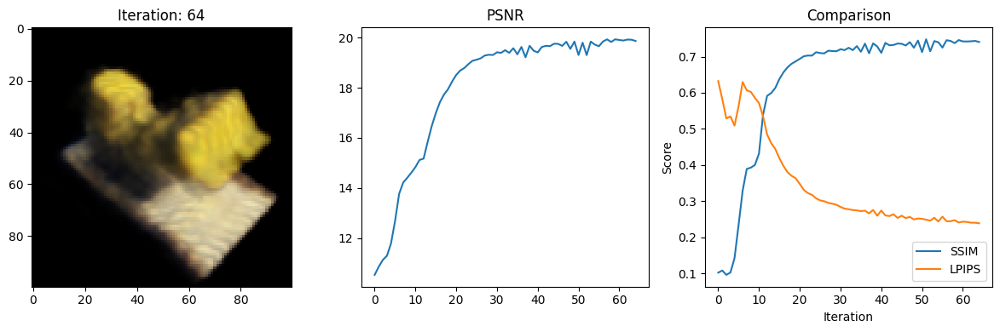

Data saved to: metrics.csv
65 8.811856508255005 secs per iter
Iteration: 65,PSNR: 19.967927932739258, SSIM: 0.7459124248362499, LPIPS: 0.23784464597702026


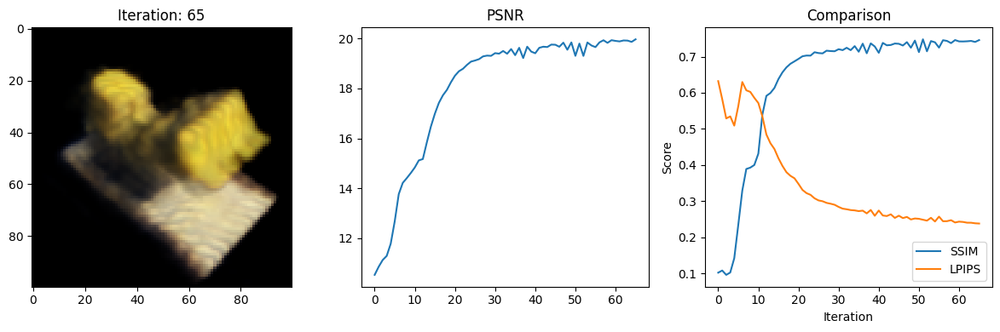

Data saved to: metrics.csv
66 8.82387375831604 secs per iter
Iteration: 66,PSNR: 19.743953704833984, SSIM: 0.7347616317688098, LPIPS: 0.23645055294036865


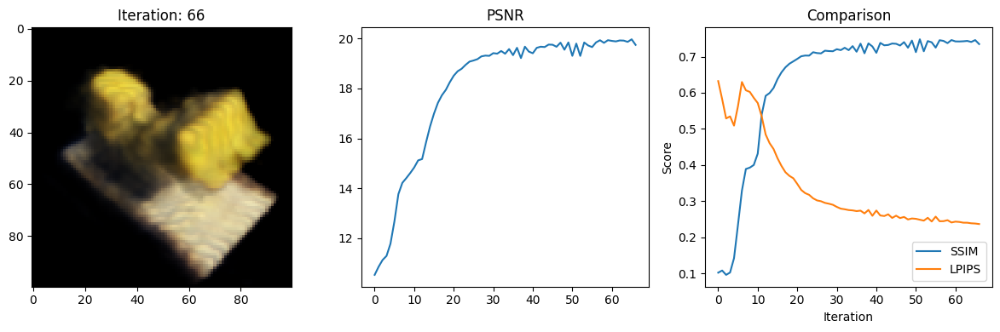

Data saved to: metrics.csv
67 8.748536825180054 secs per iter
Iteration: 67,PSNR: 19.997817993164062, SSIM: 0.7497345594047191, LPIPS: 0.2338985800743103


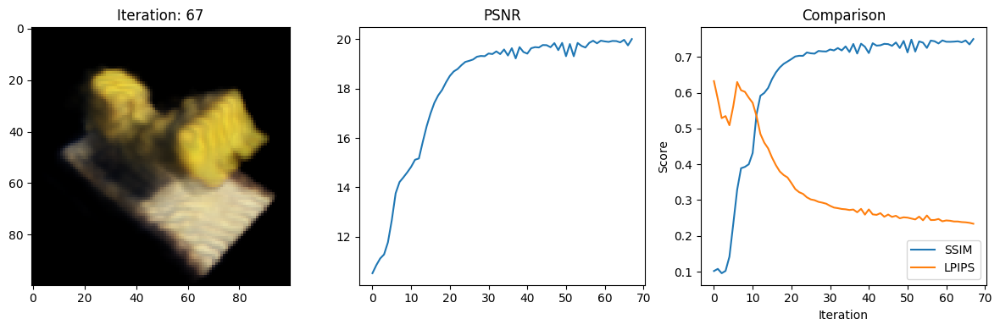

Data saved to: metrics.csv
68 9.017043113708496 secs per iter
Iteration: 68,PSNR: 19.51218605041504, SSIM: 0.7224710758697305, LPIPS: 0.23733019828796387


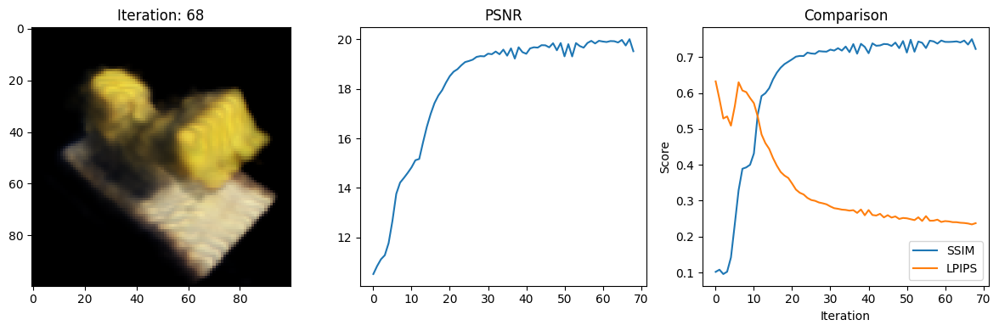

Data saved to: metrics.csv
69 8.812118291854858 secs per iter
Iteration: 69,PSNR: 19.953662872314453, SSIM: 0.7524021817359907, LPIPS: 0.2307836413383484


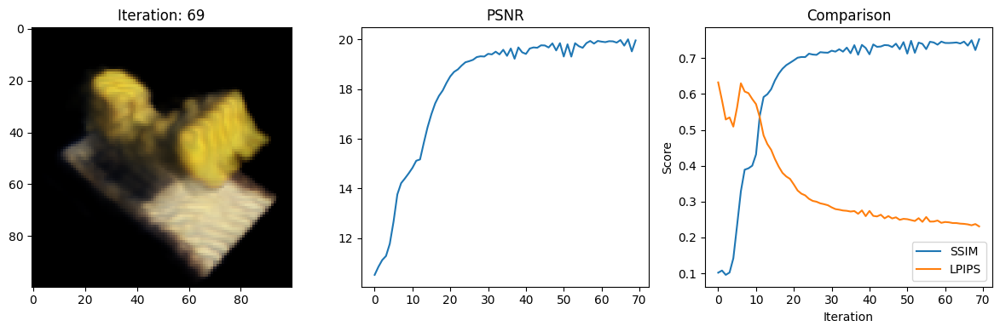

Data saved to: metrics.csv
70 9.158278942108154 secs per iter
Iteration: 70,PSNR: 19.178064346313477, SSIM: 0.707118372586706, LPIPS: 0.24234053492546082


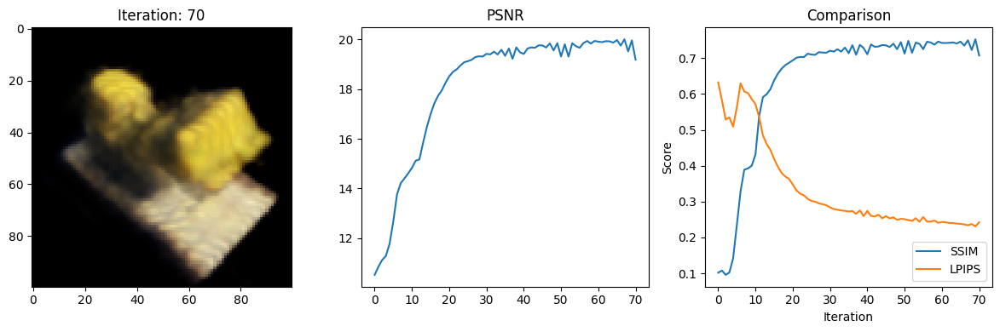

Data saved to: metrics.csv
71 8.740993738174438 secs per iter
Iteration: 71,PSNR: 19.830957412719727, SSIM: 0.7525583041201068, LPIPS: 0.23114530742168427


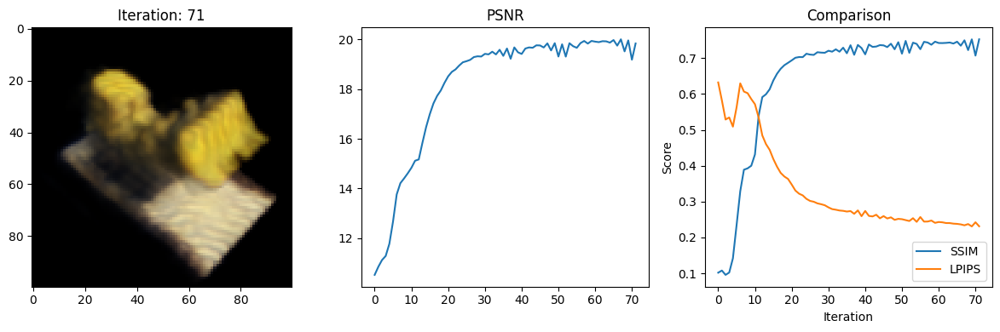

Data saved to: metrics.csv
72 8.98912501335144 secs per iter
Iteration: 72,PSNR: 19.489086151123047, SSIM: 0.7236165350117353, LPIPS: 0.235515296459198


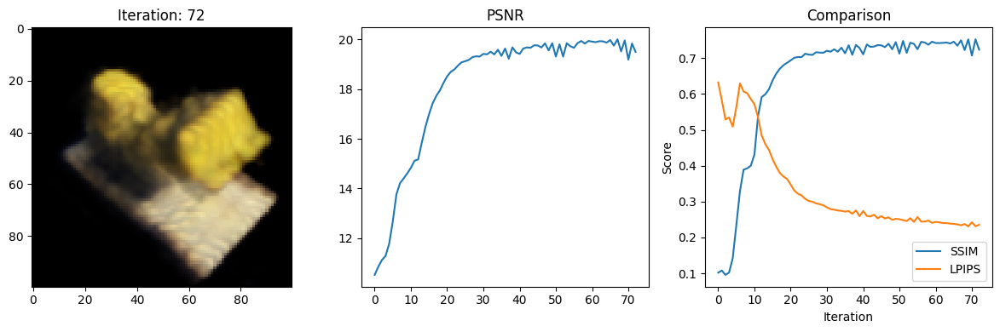

Data saved to: metrics.csv
73 8.838104486465454 secs per iter
Iteration: 73,PSNR: 19.837200164794922, SSIM: 0.7321833125772127, LPIPS: 0.2452637255191803


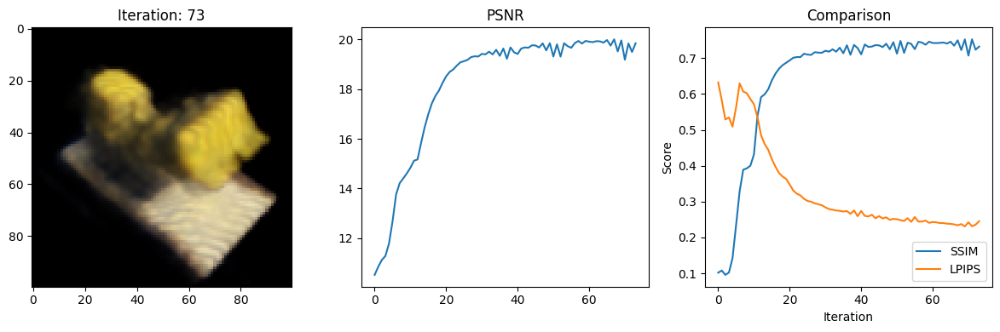

Data saved to: metrics.csv
74 8.830918073654175 secs per iter
Iteration: 74,PSNR: 19.866771697998047, SSIM: 0.7495365874953626, LPIPS: 0.22610127925872803


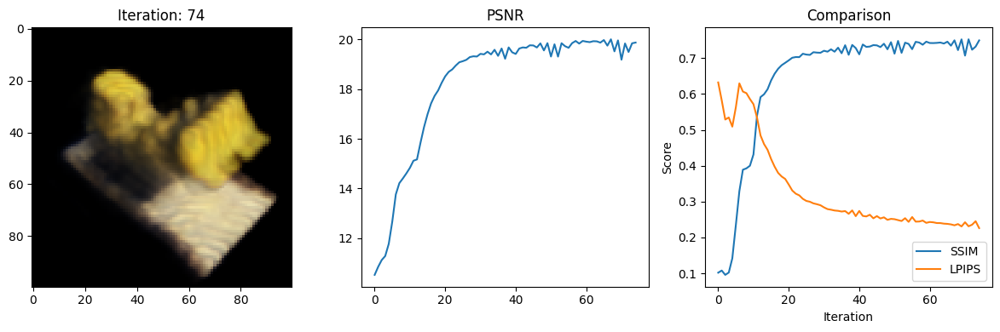

Data saved to: metrics.csv
75 8.743293523788452 secs per iter
Iteration: 75,PSNR: 20.00428009033203, SSIM: 0.7445648409784763, LPIPS: 0.23555241525173187


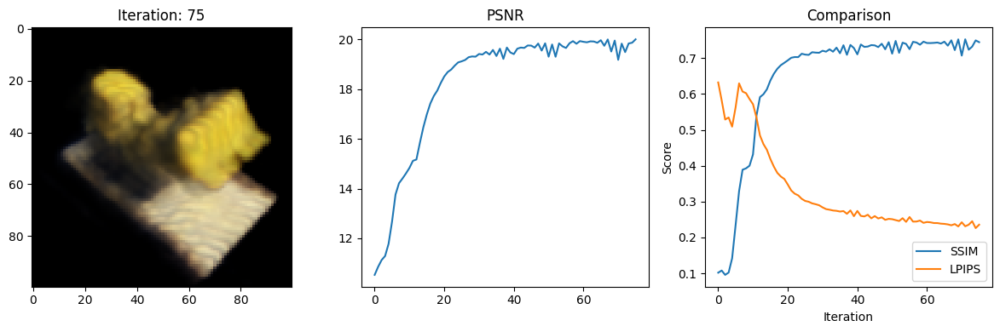

Data saved to: metrics.csv
76 8.803382396697998 secs per iter
Iteration: 76,PSNR: 19.973108291625977, SSIM: 0.7457926864705152, LPIPS: 0.23724554479122162


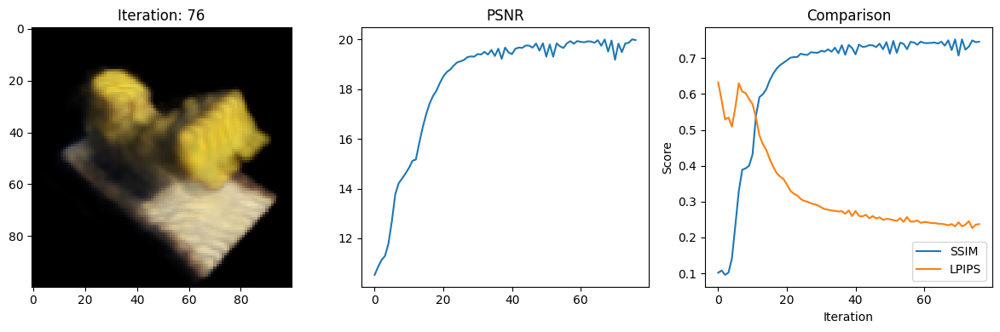

Data saved to: metrics.csv
77 8.773406267166138 secs per iter
Iteration: 77,PSNR: 20.08037757873535, SSIM: 0.7510071540302174, LPIPS: 0.2323540449142456


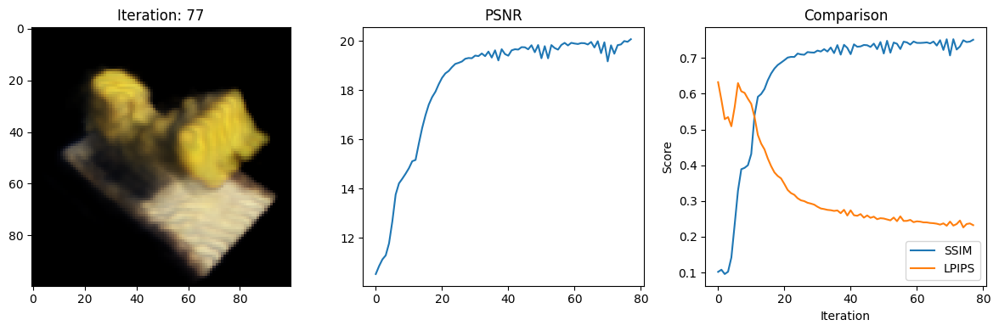

Data saved to: metrics.csv
78 8.788199186325073 secs per iter
Iteration: 78,PSNR: 20.017202377319336, SSIM: 0.7469141824663502, LPIPS: 0.2339845597743988


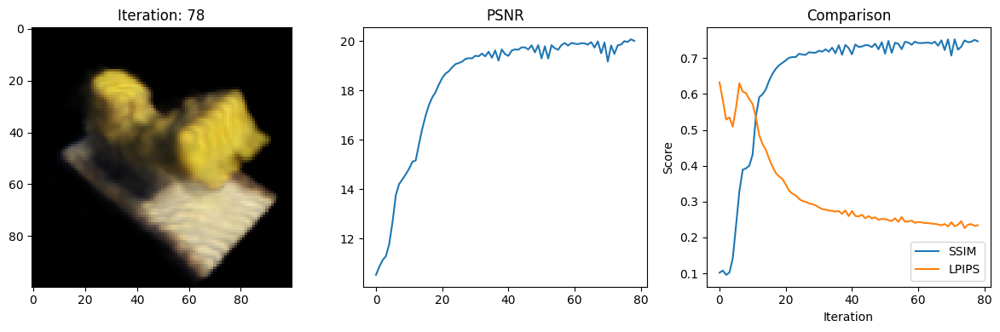

Data saved to: metrics.csv
79 8.760123014450073 secs per iter
Iteration: 79,PSNR: 20.03413963317871, SSIM: 0.7497051524749804, LPIPS: 0.2318280041217804


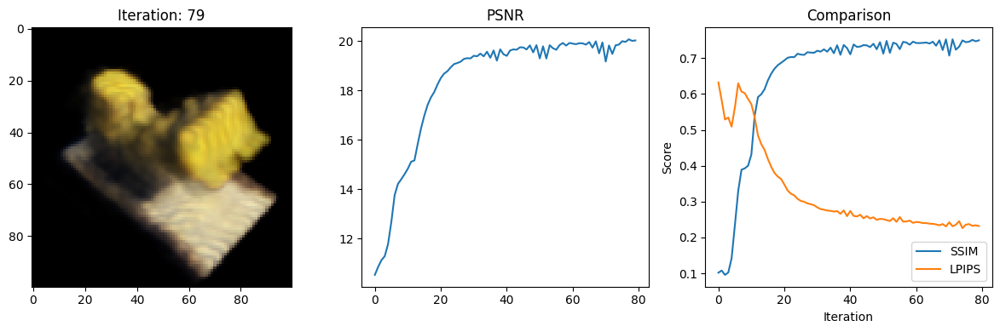

Data saved to: metrics.csv
80 8.788759708404541 secs per iter
Iteration: 80,PSNR: 20.08526039123535, SSIM: 0.7501072573172333, LPIPS: 0.22989800572395325


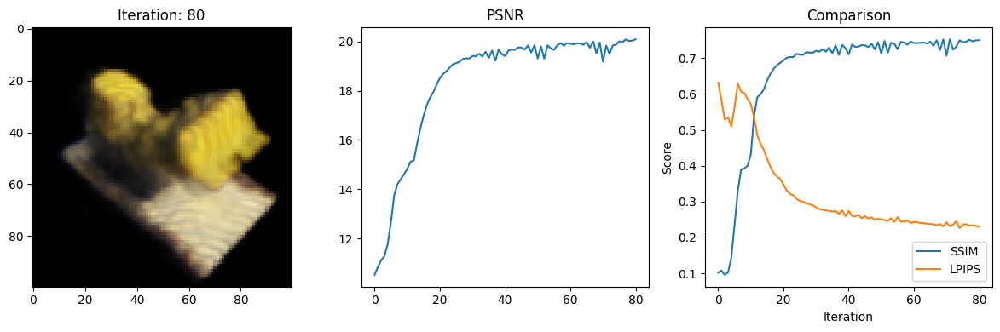

Data saved to: metrics.csv
81 8.815711736679077 secs per iter
Iteration: 81,PSNR: 19.99967384338379, SSIM: 0.7471511818459877, LPIPS: 0.23136292397975922


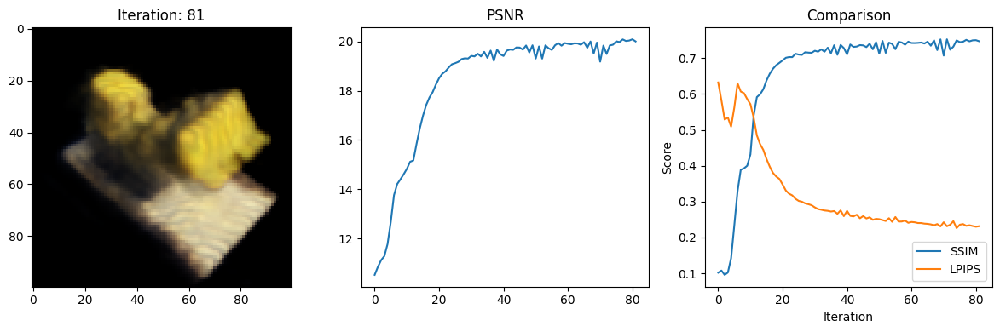

Data saved to: metrics.csv
82 8.75822401046753 secs per iter
Iteration: 82,PSNR: 20.053794860839844, SSIM: 0.749575744808841, LPIPS: 0.2297719419002533


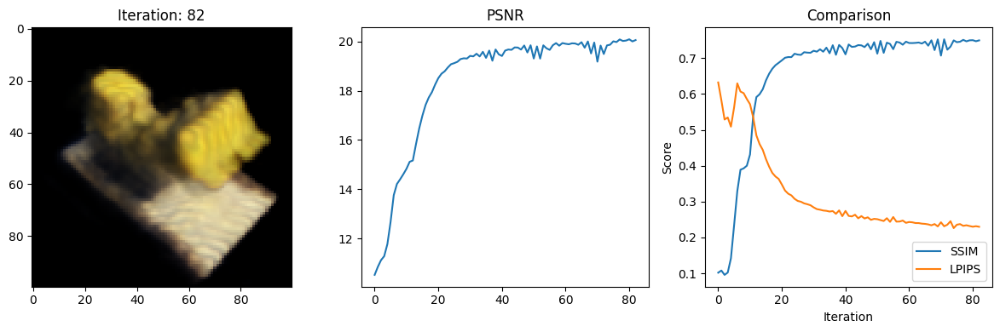

Data saved to: metrics.csv
83 8.96217393875122 secs per iter
Iteration: 83,PSNR: 19.965015411376953, SSIM: 0.745293577326823, LPIPS: 0.23156288266181946


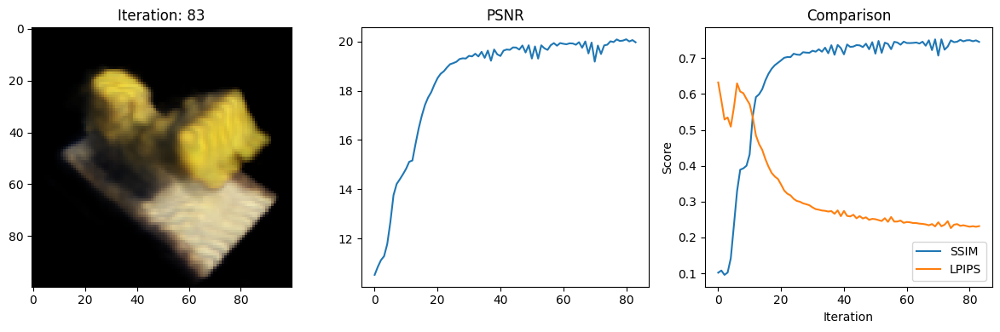

Data saved to: metrics.csv
84 8.823195695877075 secs per iter
Iteration: 84,PSNR: 20.089548110961914, SSIM: 0.7519108930898888, LPIPS: 0.22817738354206085


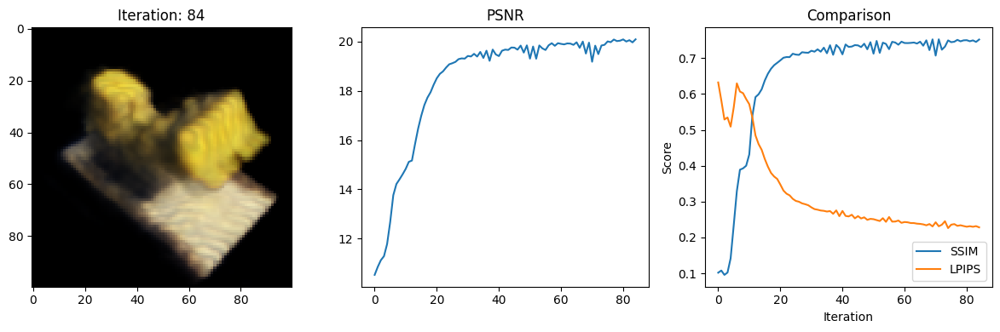

Data saved to: metrics.csv
85 8.803184032440186 secs per iter
Iteration: 85,PSNR: 19.882347106933594, SSIM: 0.7413898777432452, LPIPS: 0.23218263685703278


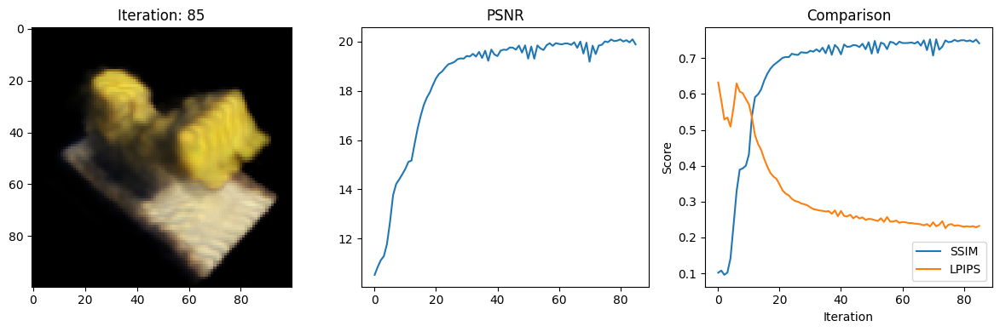

Data saved to: metrics.csv
86 9.117919683456421 secs per iter
Iteration: 86,PSNR: 20.102275848388672, SSIM: 0.7538892724629022, LPIPS: 0.22668080031871796


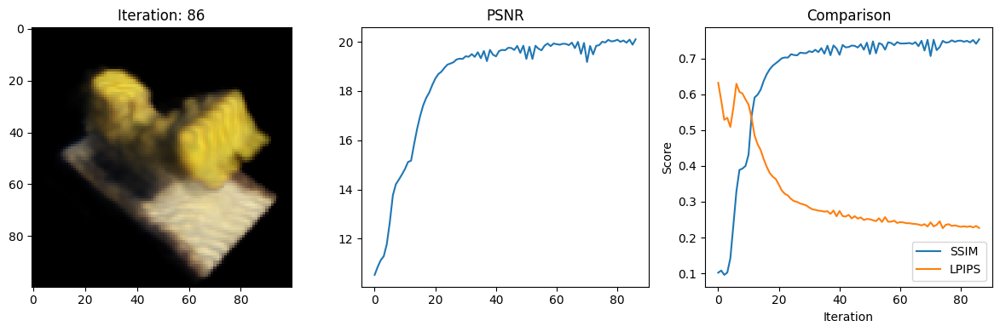

Data saved to: metrics.csv
87 9.028563737869263 secs per iter
Iteration: 87,PSNR: 19.799421310424805, SSIM: 0.7368698518292613, LPIPS: 0.23283110558986664


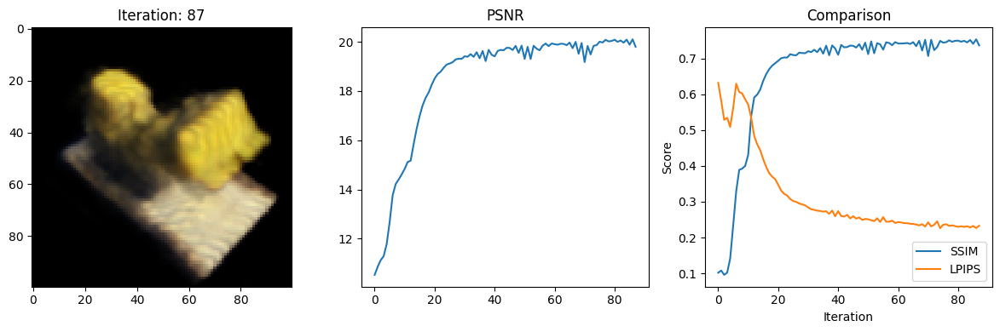

Data saved to: metrics.csv
88 8.846156120300293 secs per iter
Iteration: 88,PSNR: 20.08495330810547, SSIM: 0.7552588248350763, LPIPS: 0.224275603890419


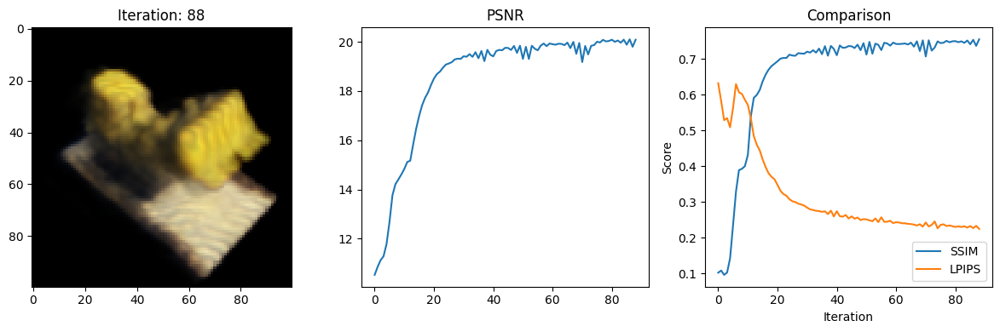

Data saved to: metrics.csv
89 8.832576274871826 secs per iter
Iteration: 89,PSNR: 19.60274314880371, SSIM: 0.7281320912422959, LPIPS: 0.23313742876052856


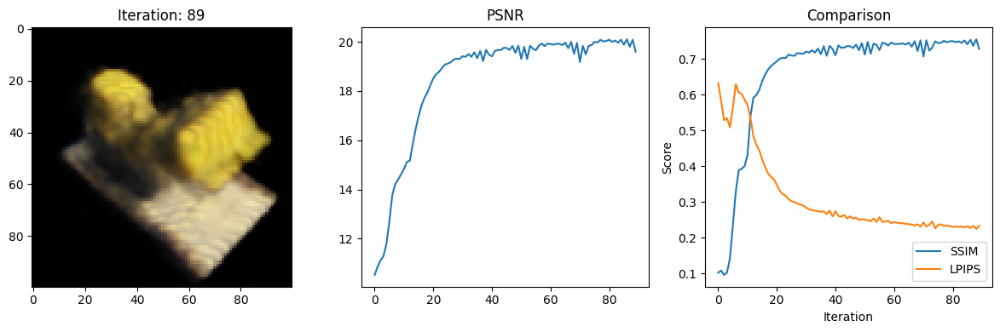

Data saved to: metrics.csv
90 8.761451482772827 secs per iter
Iteration: 90,PSNR: 20.07231903076172, SSIM: 0.757165886677701, LPIPS: 0.22138172388076782


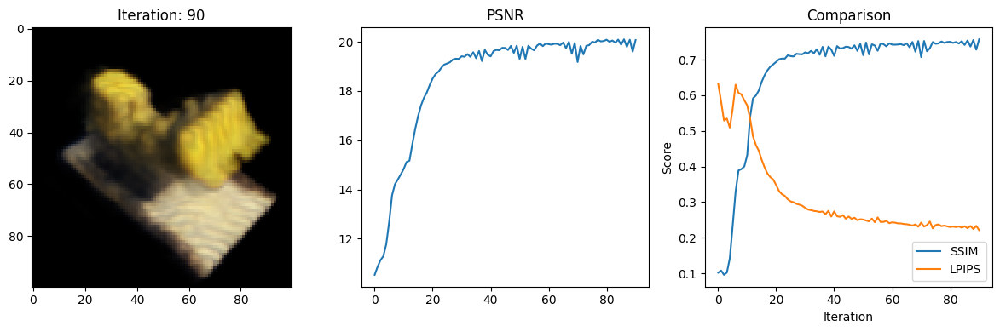

Data saved to: metrics.csv
91 9.106110334396362 secs per iter
Iteration: 91,PSNR: 19.346988677978516, SSIM: 0.7160376509921832, LPIPS: 0.23517245054244995


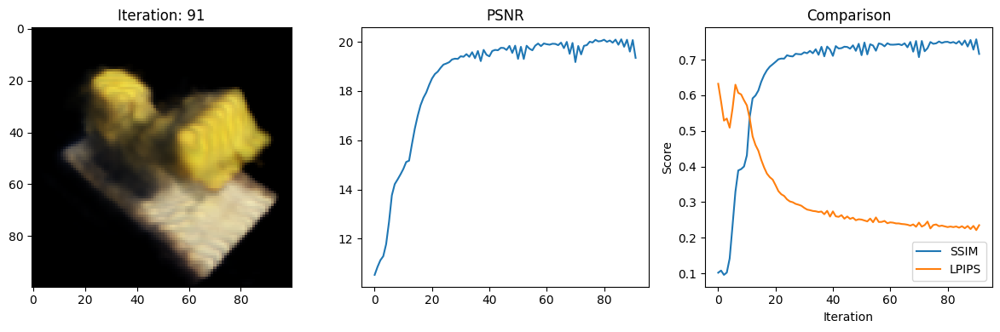

Data saved to: metrics.csv
92 8.904699087142944 secs per iter
Iteration: 92,PSNR: 19.897869110107422, SSIM: 0.7566877172848864, LPIPS: 0.22074656188488007


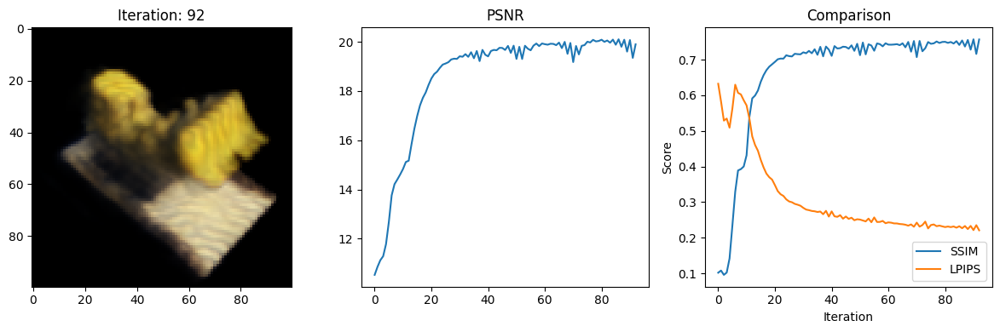

Data saved to: metrics.csv
93 8.816631555557251 secs per iter
Iteration: 93,PSNR: 19.35760498046875, SSIM: 0.7176605461291495, LPIPS: 0.23554641008377075


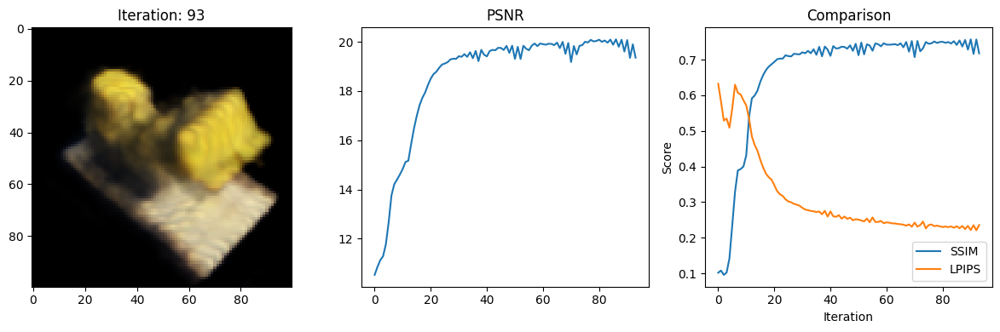

Data saved to: metrics.csv
94 8.752714157104492 secs per iter
Iteration: 94,PSNR: 19.99774932861328, SSIM: 0.7425156959742947, LPIPS: 0.23406265676021576


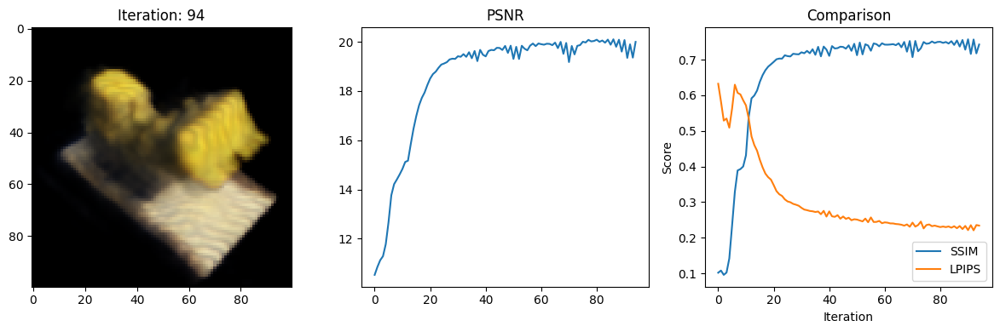

Data saved to: metrics.csv
95 8.974167823791504 secs per iter
Iteration: 95,PSNR: 19.845382690429688, SSIM: 0.7487817041397063, LPIPS: 0.21765513718128204


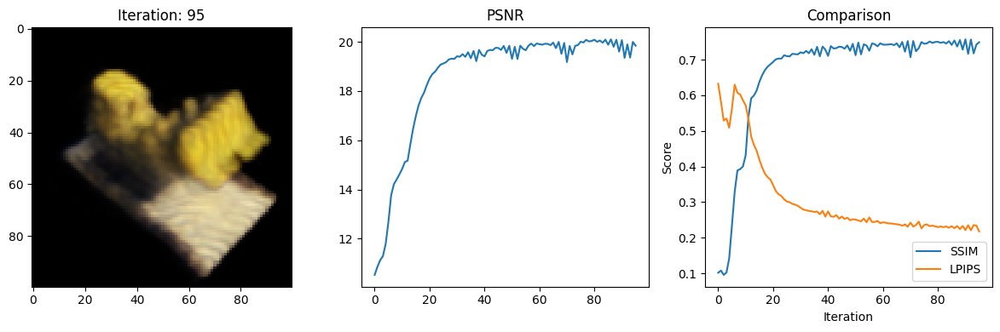

Data saved to: metrics.csv
96 8.806315898895264 secs per iter
Iteration: 96,PSNR: 19.921110153198242, SSIM: 0.7366418932140751, LPIPS: 0.23403005301952362


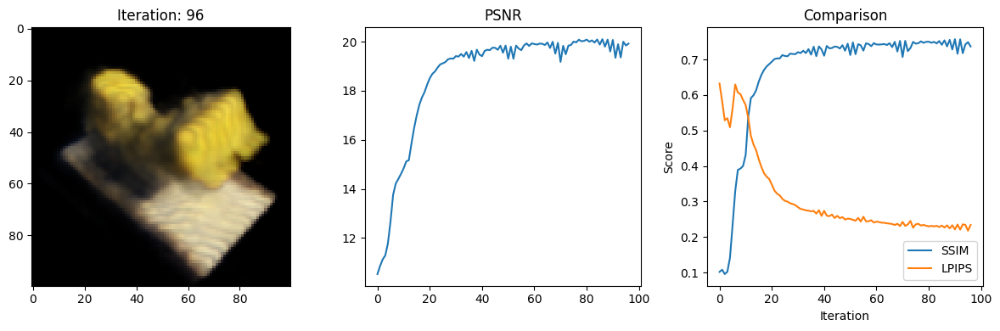

Data saved to: metrics.csv
97 8.786489009857178 secs per iter
Iteration: 97,PSNR: 20.067842483520508, SSIM: 0.7527704537850172, LPIPS: 0.22721946239471436


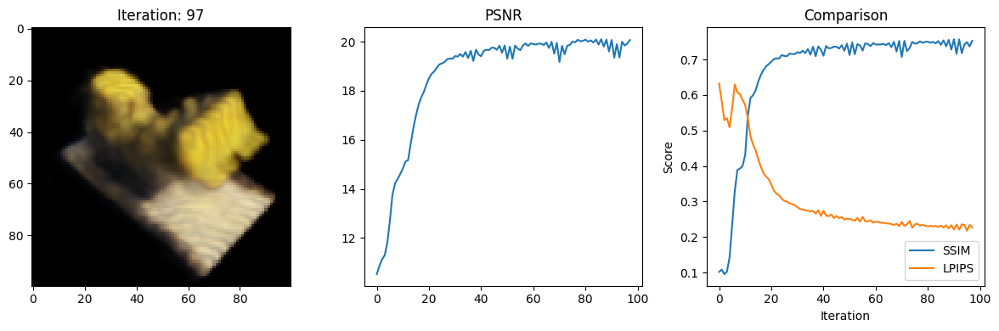

Data saved to: metrics.csv
98 8.751596450805664 secs per iter
Iteration: 98,PSNR: 20.173864364624023, SSIM: 0.7554995999863786, LPIPS: 0.22240005433559418


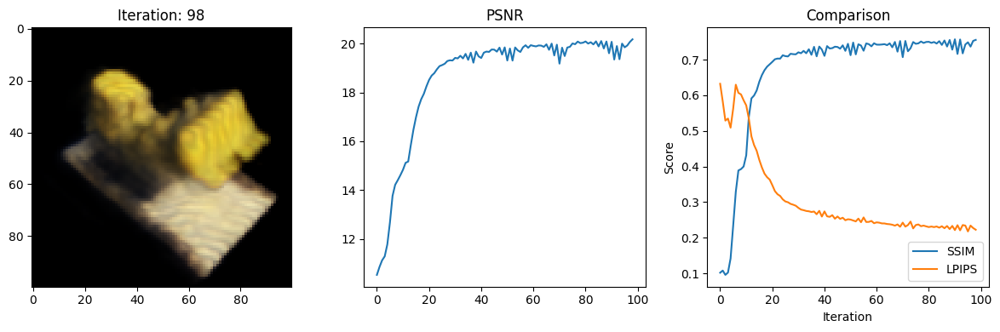

Data saved to: metrics.csv
99 9.087315082550049 secs per iter
Iteration: 99,PSNR: 19.908323287963867, SSIM: 0.7411183520958078, LPIPS: 0.23221342265605927


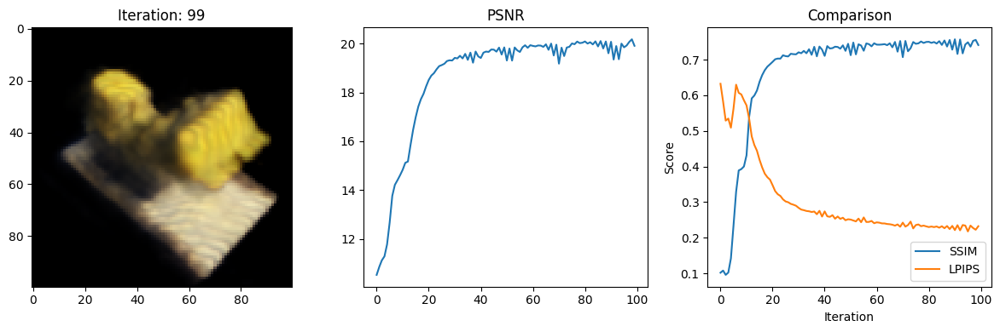

Data saved to: metrics.csv
100 8.807506799697876 secs per iter
Iteration: 100,PSNR: 20.121143341064453, SSIM: 0.7564941651351091, LPIPS: 0.22337618470191956


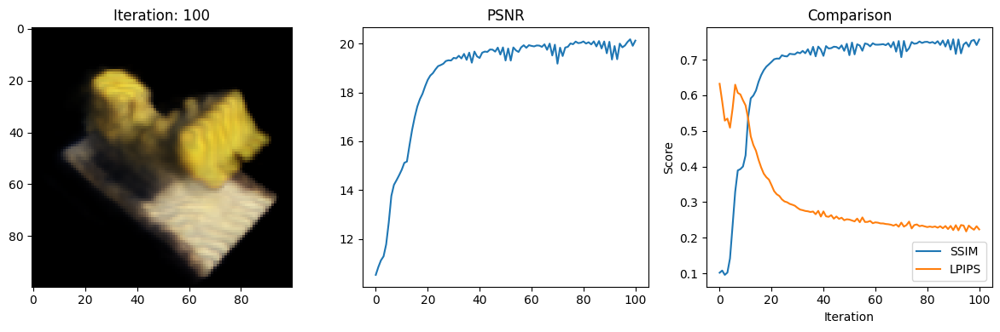

Data saved to: metrics.csv
101 8.959863185882568 secs per iter
Iteration: 101,PSNR: 20.07767105102539, SSIM: 0.7491805105367431, LPIPS: 0.22605732083320618


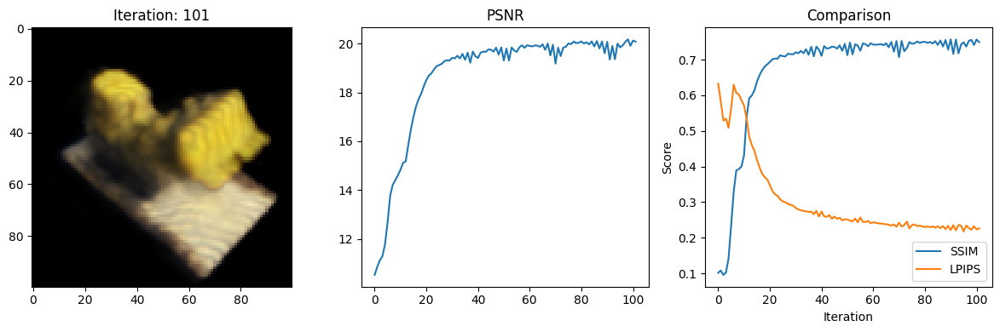

Data saved to: metrics.csv
102 9.091633558273315 secs per iter
Iteration: 102,PSNR: 20.148956298828125, SSIM: 0.7562239107595792, LPIPS: 0.22221945226192474


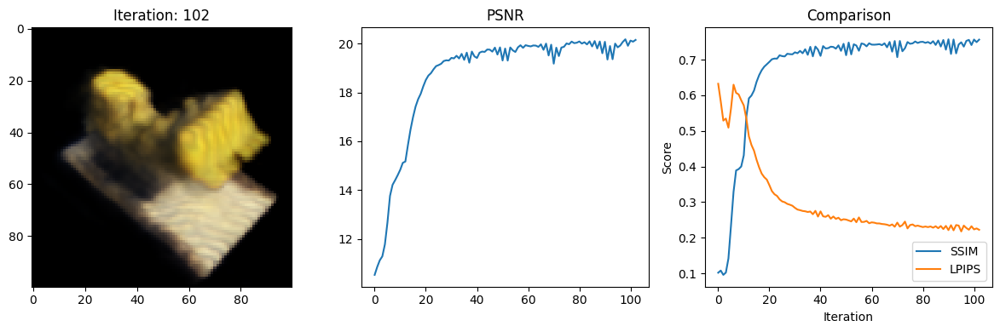

Data saved to: metrics.csv
103 9.121080160140991 secs per iter
Iteration: 103,PSNR: 20.010765075683594, SSIM: 0.7471794110183301, LPIPS: 0.22776803374290466


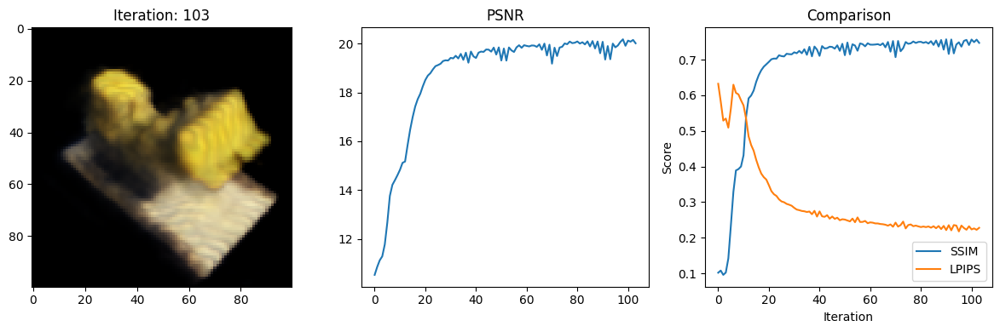

Data saved to: metrics.csv
104 8.820862054824829 secs per iter
Iteration: 104,PSNR: 20.17751121520996, SSIM: 0.7593128068914959, LPIPS: 0.21729978919029236


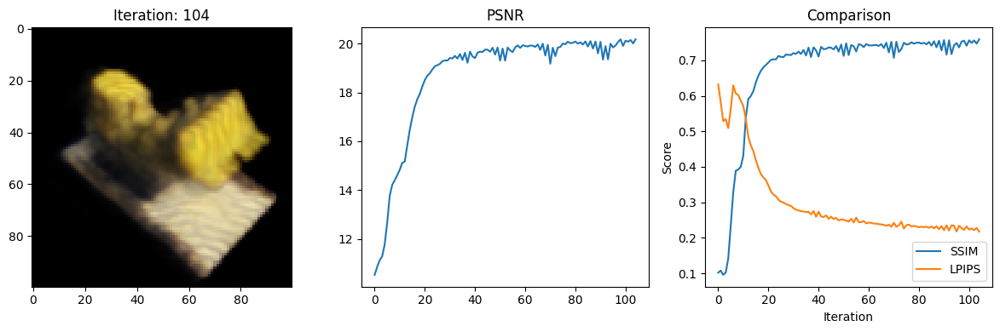

Data saved to: metrics.csv
105 8.86783218383789 secs per iter
Iteration: 105,PSNR: 19.80724334716797, SSIM: 0.7377651340907033, LPIPS: 0.23028238117694855


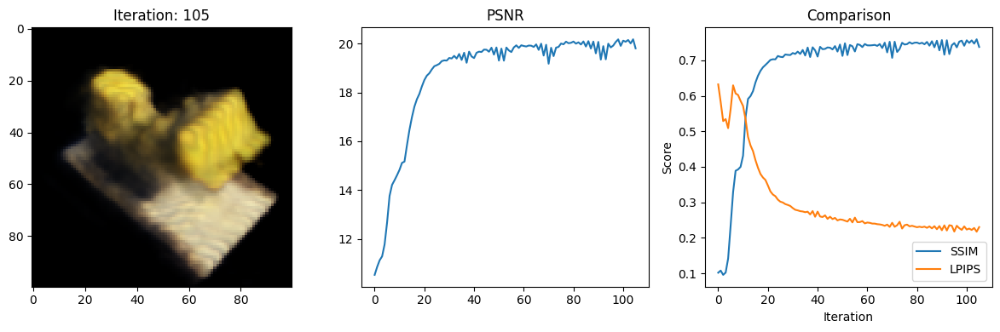

Data saved to: metrics.csv
106 8.788147687911987 secs per iter
Iteration: 106,PSNR: 20.156715393066406, SSIM: 0.7594611467609119, LPIPS: 0.21726275980472565


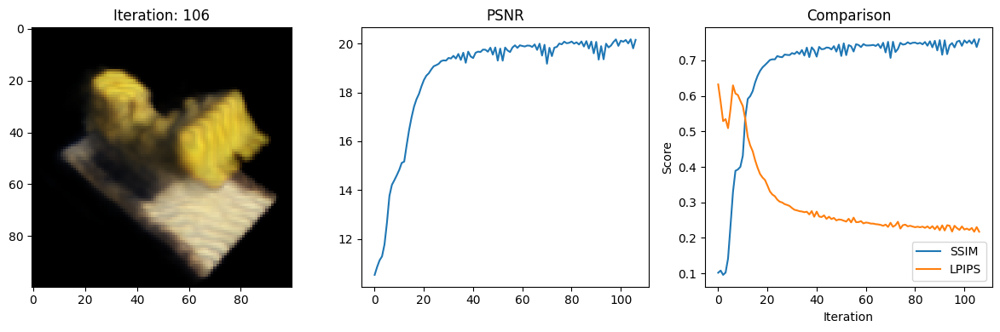

Data saved to: metrics.csv
107 8.978525876998901 secs per iter
Iteration: 107,PSNR: 19.82282257080078, SSIM: 0.7393182283389534, LPIPS: 0.22990372776985168


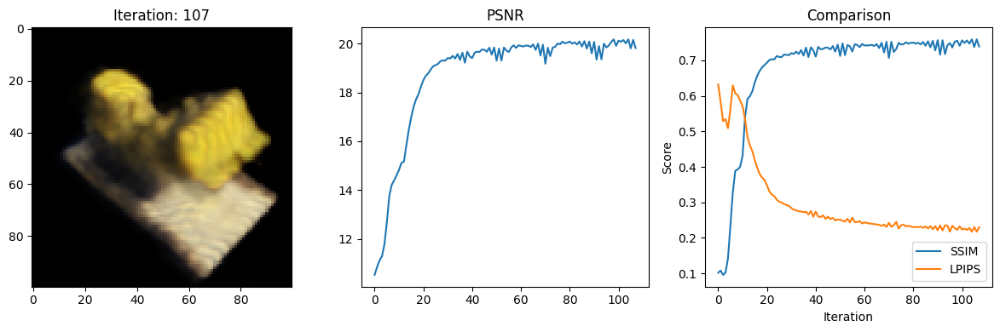

Data saved to: metrics.csv
108 8.83581256866455 secs per iter
Iteration: 108,PSNR: 20.15280532836914, SSIM: 0.7554577552942267, LPIPS: 0.2213825285434723


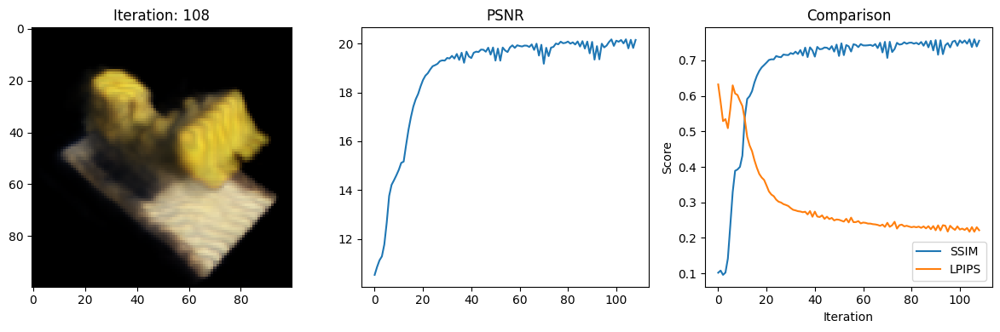

Data saved to: metrics.csv
109 8.801410436630249 secs per iter
Iteration: 109,PSNR: 20.048625946044922, SSIM: 0.751818186487787, LPIPS: 0.22437795996665955


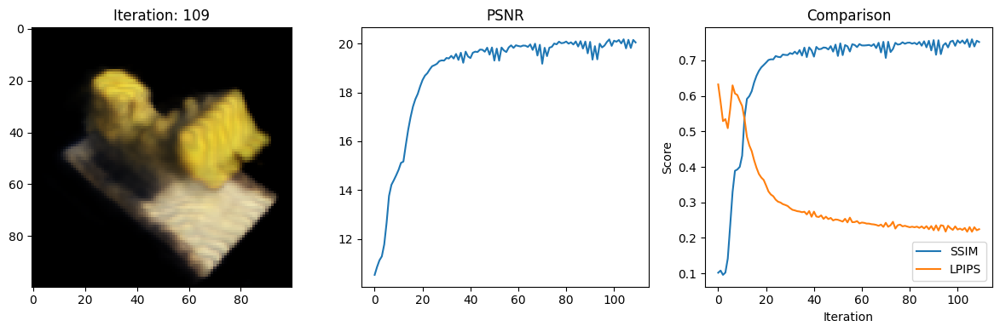

Data saved to: metrics.csv
110 8.736340522766113 secs per iter
Iteration: 110,PSNR: 20.108896255493164, SSIM: 0.7498492689203368, LPIPS: 0.22409270703792572


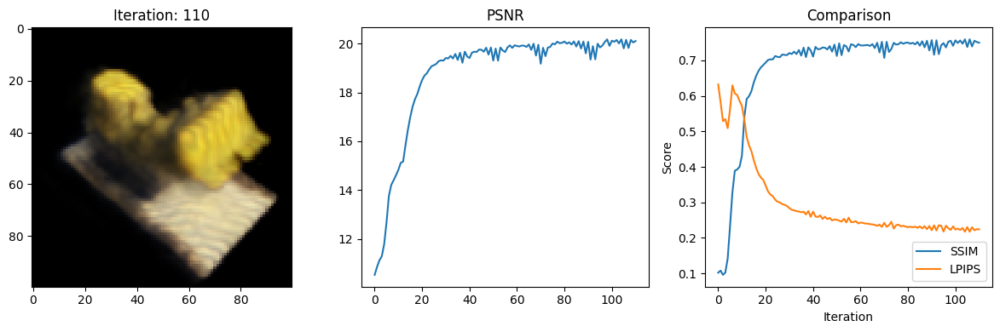

Data saved to: metrics.csv
111 8.814343214035034 secs per iter
Iteration: 111,PSNR: 20.1052303314209, SSIM: 0.7542502985560953, LPIPS: 0.2244686335325241


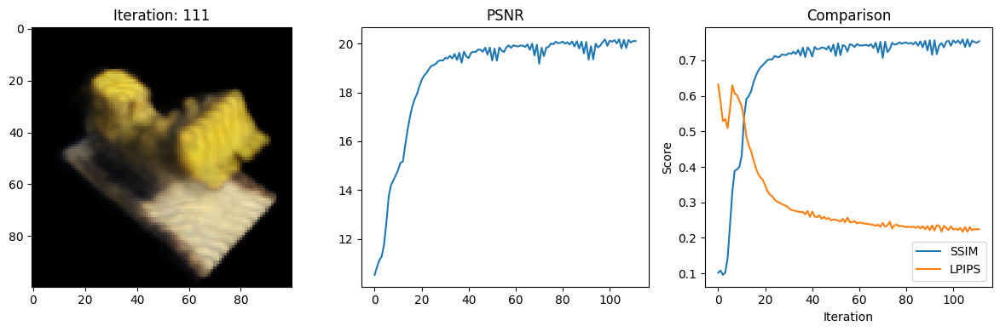

Data saved to: metrics.csv
112 8.86387324333191 secs per iter
Iteration: 112,PSNR: 20.101871490478516, SSIM: 0.7516609901712877, LPIPS: 0.2240591198205948


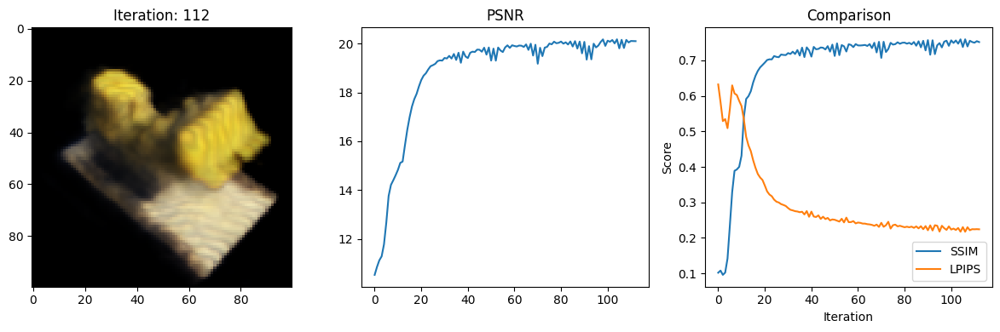

Data saved to: metrics.csv
113 8.818712949752808 secs per iter
Iteration: 113,PSNR: 20.14471435546875, SSIM: 0.7546318024650941, LPIPS: 0.22218984365463257


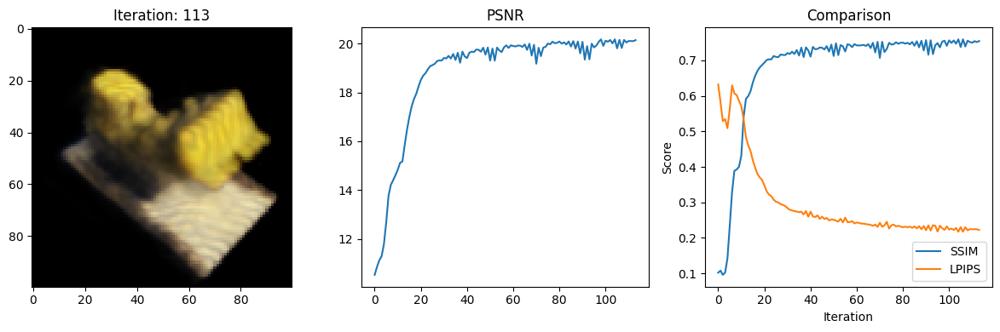

Data saved to: metrics.csv
114 8.855477809906006 secs per iter
Iteration: 114,PSNR: 20.04398536682129, SSIM: 0.7493247118546794, LPIPS: 0.226189523935318


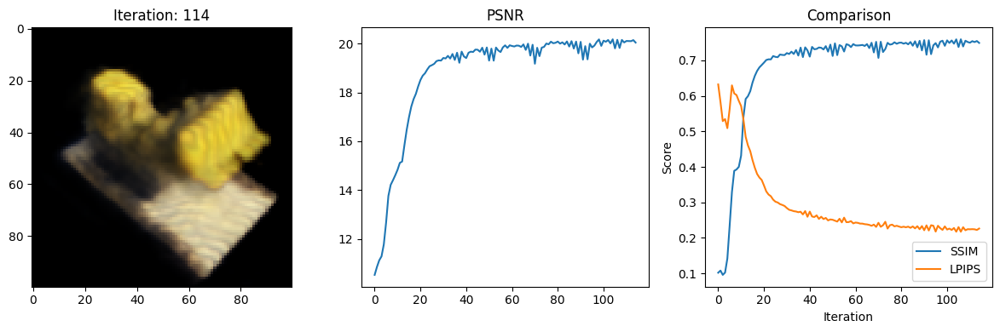

Data saved to: metrics.csv
115 8.85138726234436 secs per iter
Iteration: 115,PSNR: 20.157873153686523, SSIM: 0.7568023371582387, LPIPS: 0.21761369705200195


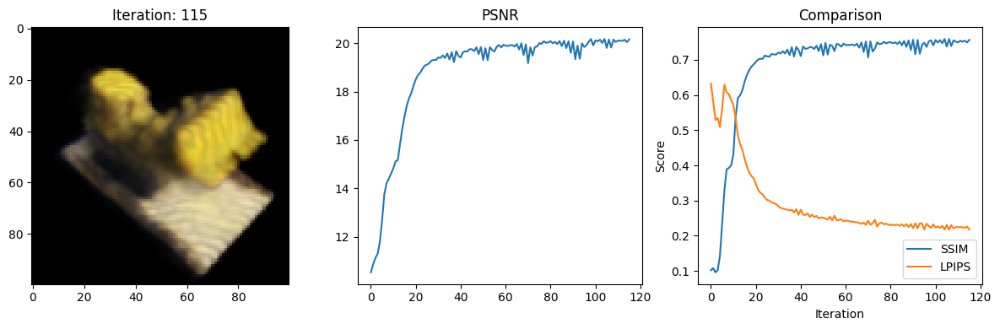

Data saved to: metrics.csv
116 8.867642402648926 secs per iter
Iteration: 116,PSNR: 19.956274032592773, SSIM: 0.746316062959148, LPIPS: 0.22493411600589752


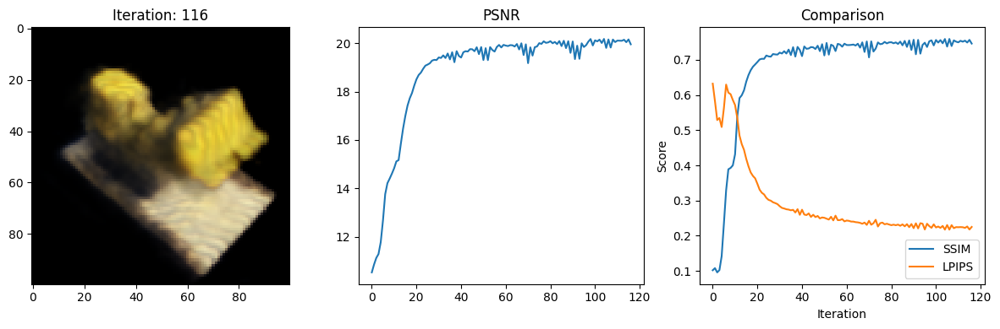

Data saved to: metrics.csv
117 8.847537517547607 secs per iter
Iteration: 117,PSNR: 20.16057777404785, SSIM: 0.757671035319528, LPIPS: 0.21688270568847656


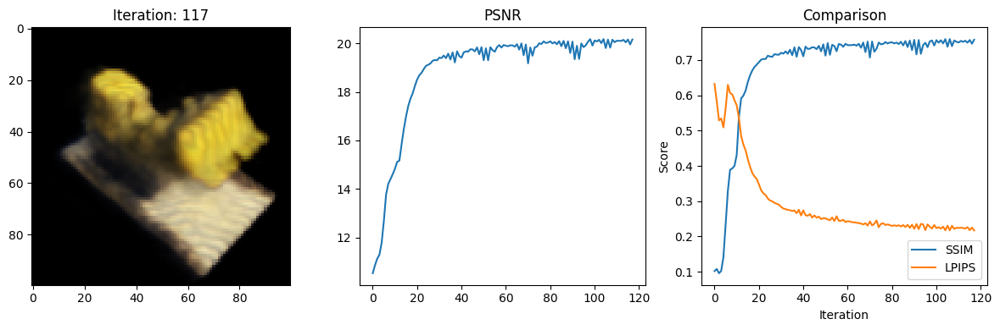

Data saved to: metrics.csv
118 9.353762149810791 secs per iter
Iteration: 118,PSNR: 19.868989944458008, SSIM: 0.7418396551438605, LPIPS: 0.22593897581100464


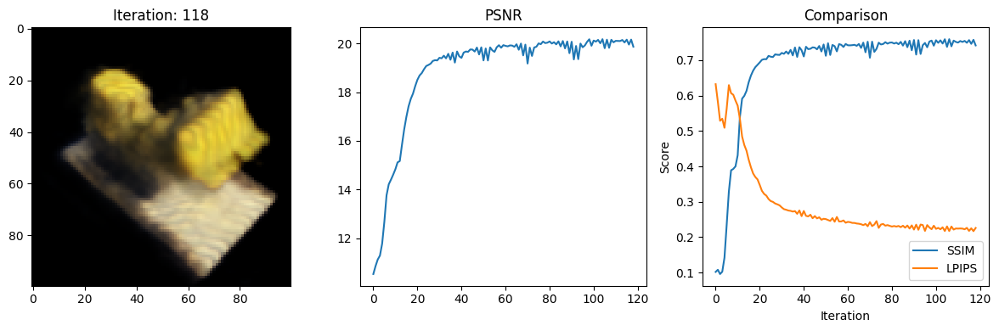

Data saved to: metrics.csv
119 8.862731218338013 secs per iter
Iteration: 119,PSNR: 20.17776107788086, SSIM: 0.7598205709993412, LPIPS: 0.21095509827136993


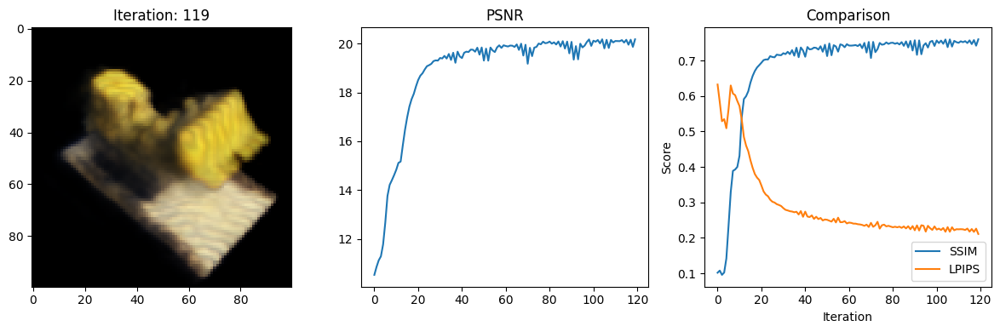

Data saved to: metrics.csv
120 8.88823390007019 secs per iter
Iteration: 120,PSNR: 19.730159759521484, SSIM: 0.7340541986079443, LPIPS: 0.2278289794921875


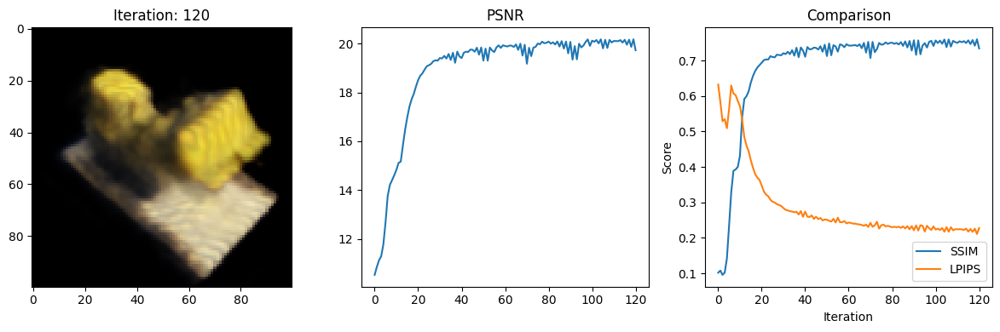

Data saved to: metrics.csv
121 8.856266736984253 secs per iter
Iteration: 121,PSNR: 20.153034210205078, SSIM: 0.7626462814612296, LPIPS: 0.2082815021276474


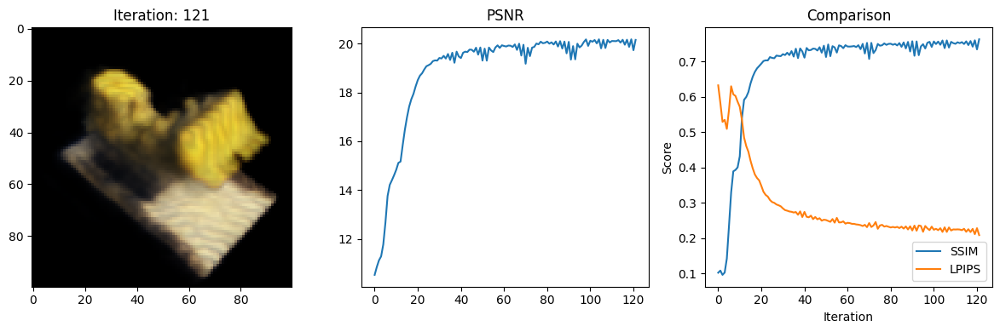

Data saved to: metrics.csv
122 8.912071704864502 secs per iter
Iteration: 122,PSNR: 19.51651382446289, SSIM: 0.7230490461639146, LPIPS: 0.23005113005638123


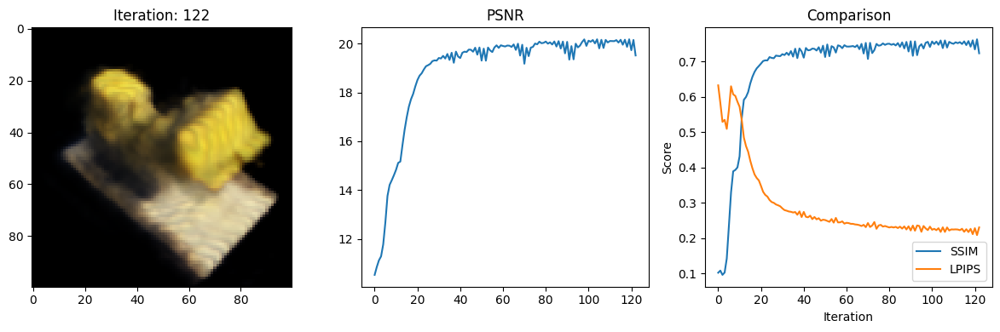

Data saved to: metrics.csv
123 8.893036127090454 secs per iter
Iteration: 123,PSNR: 20.042985916137695, SSIM: 0.7618984726047623, LPIPS: 0.20918163657188416


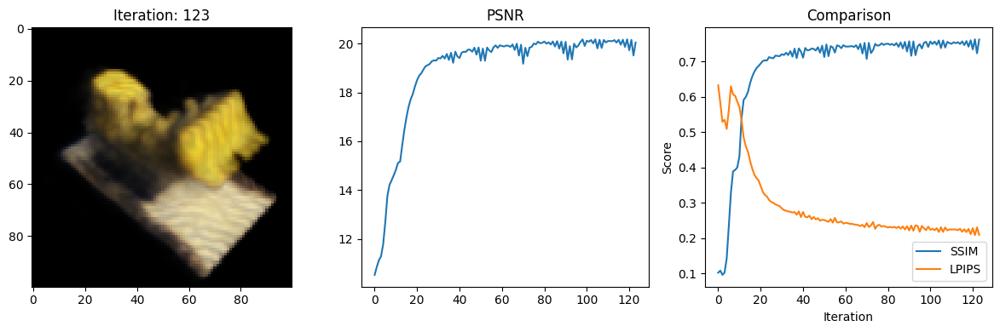

Data saved to: metrics.csv
124 8.849956274032593 secs per iter
Iteration: 124,PSNR: 19.566978454589844, SSIM: 0.7275928431568534, LPIPS: 0.22948363423347473


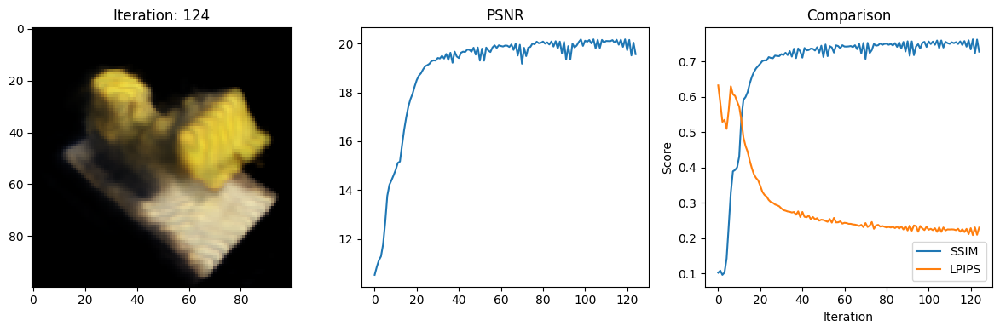

Data saved to: metrics.csv
125 8.818914651870728 secs per iter
Iteration: 125,PSNR: 20.082727432250977, SSIM: 0.7509879767580436, LPIPS: 0.2194443792104721


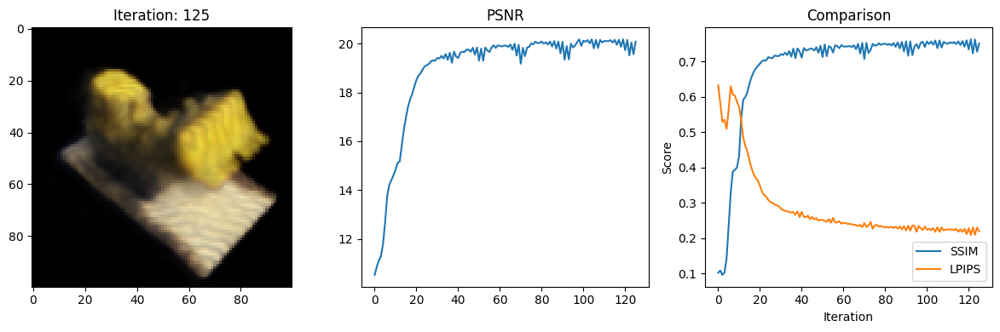

Data saved to: metrics.csv
126 9.05013656616211 secs per iter
Iteration: 126,PSNR: 19.997377395629883, SSIM: 0.754780325356757, LPIPS: 0.21388068795204163


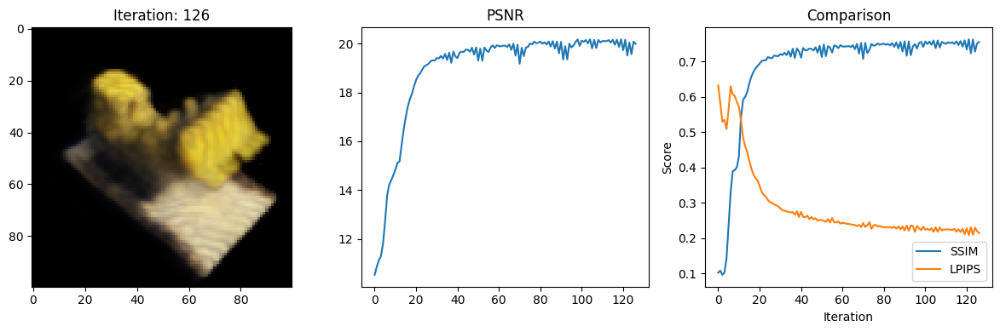

Data saved to: metrics.csv
127 8.8719961643219 secs per iter
Iteration: 127,PSNR: 19.78062629699707, SSIM: 0.7307838156459484, LPIPS: 0.22970283031463623


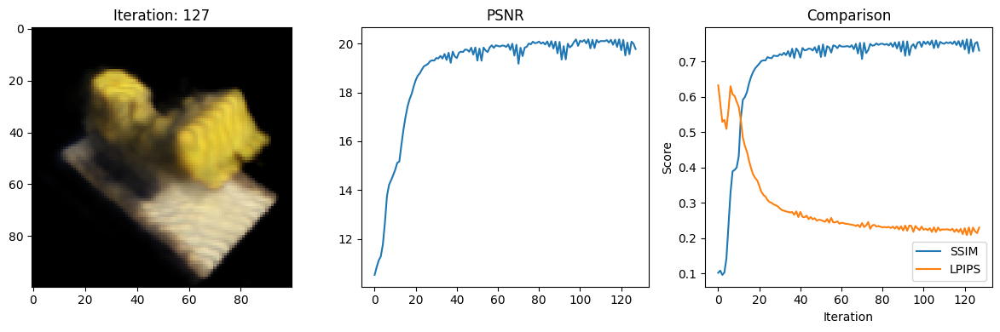

Data saved to: metrics.csv
128 9.148534297943115 secs per iter
Iteration: 128,PSNR: 20.15502166748047, SSIM: 0.7595163218642851, LPIPS: 0.21611781418323517


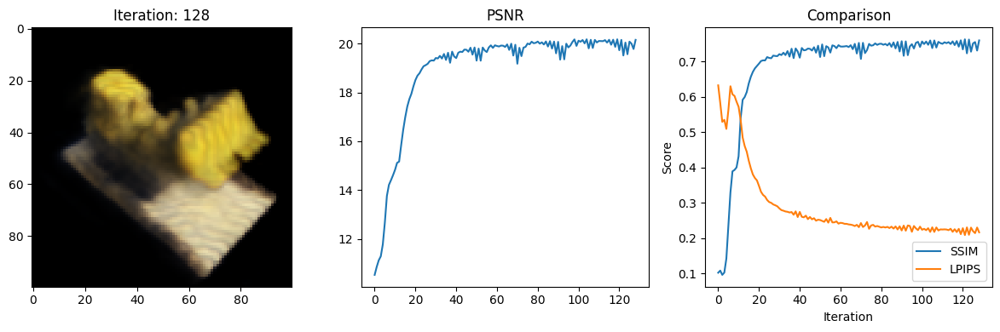

Data saved to: metrics.csv
129 8.830189228057861 secs per iter
Iteration: 129,PSNR: 20.198043823242188, SSIM: 0.7581305810841991, LPIPS: 0.21171629428863525


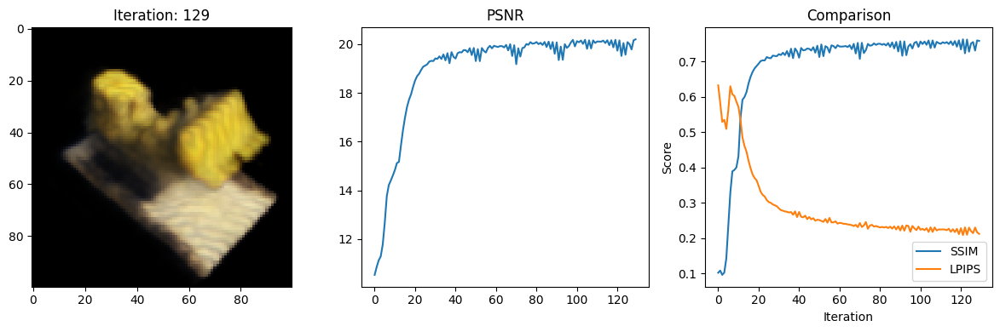

Data saved to: metrics.csv
130 9.03626561164856 secs per iter
Iteration: 130,PSNR: 19.897605895996094, SSIM: 0.740512114333494, LPIPS: 0.22848379611968994


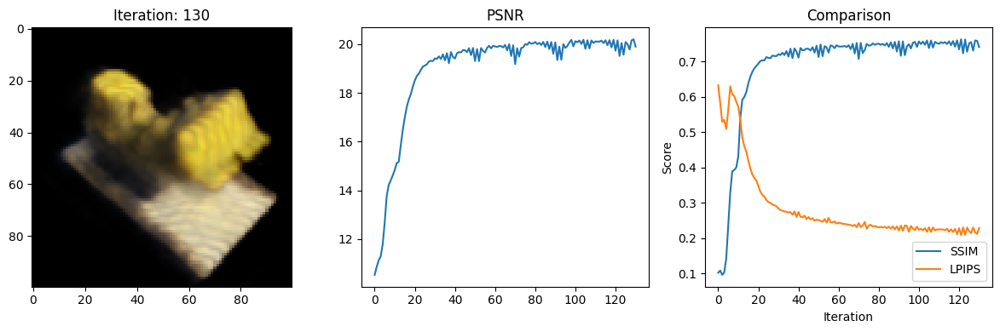

Data saved to: metrics.csv
131 8.853827476501465 secs per iter
Iteration: 131,PSNR: 20.144533157348633, SSIM: 0.7599282413048547, LPIPS: 0.21499912440776825


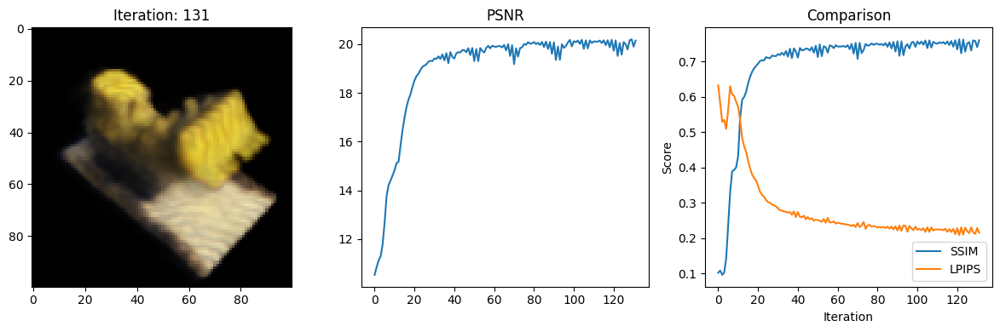

Data saved to: metrics.csv
132 8.87749195098877 secs per iter
Iteration: 132,PSNR: 20.165054321289062, SSIM: 0.7547457867966866, LPIPS: 0.2165648639202118


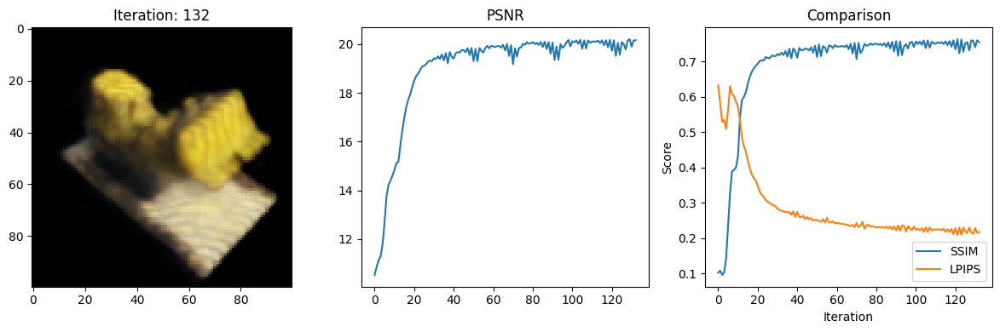

Data saved to: metrics.csv
133 8.921920776367188 secs per iter
Iteration: 133,PSNR: 20.13575553894043, SSIM: 0.7542136146641877, LPIPS: 0.21849416196346283


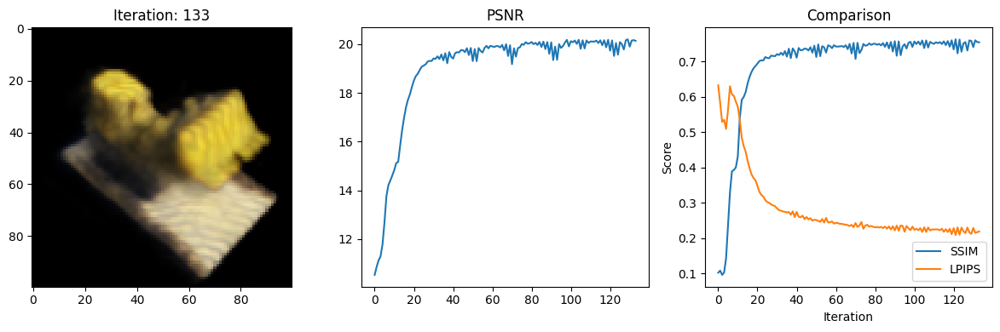

Data saved to: metrics.csv
134 9.405033349990845 secs per iter
Iteration: 134,PSNR: 20.137922286987305, SSIM: 0.756523168287262, LPIPS: 0.21732546389102936


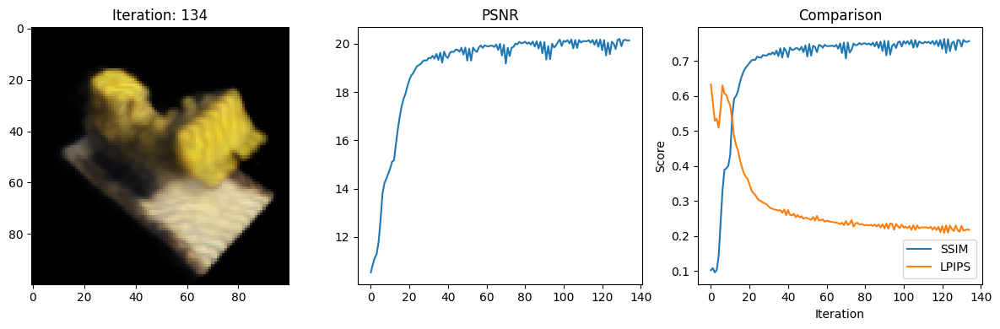

Data saved to: metrics.csv
135 8.908760786056519 secs per iter
Iteration: 135,PSNR: 20.119583129882812, SSIM: 0.7535493418280542, LPIPS: 0.21842852234840393


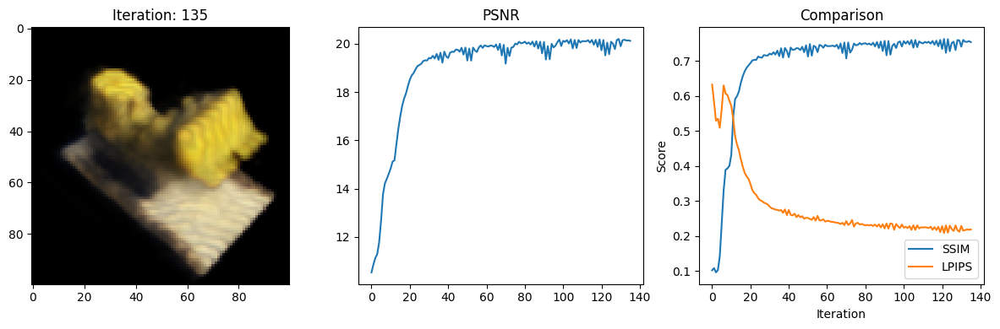

Data saved to: metrics.csv
136 8.896379232406616 secs per iter
Iteration: 136,PSNR: 20.180286407470703, SSIM: 0.7572634091136844, LPIPS: 0.2157256305217743


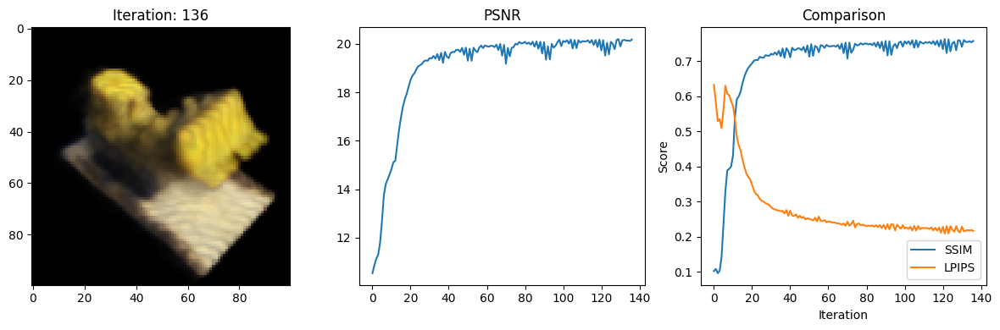

Data saved to: metrics.csv
137 8.845818281173706 secs per iter
Iteration: 137,PSNR: 20.1147403717041, SSIM: 0.7530966329920119, LPIPS: 0.22020165622234344


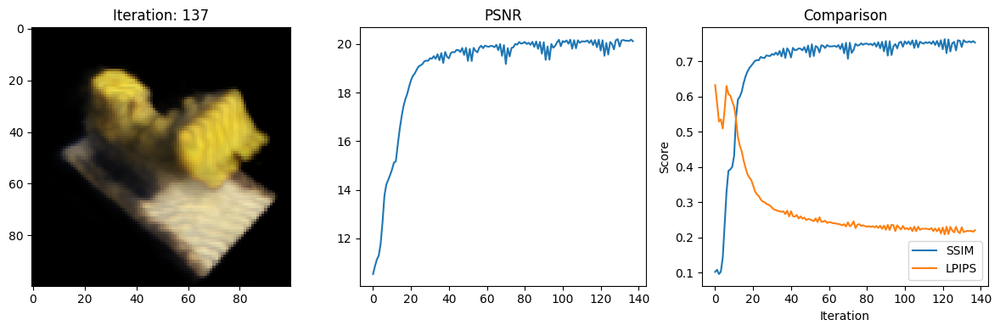

Data saved to: metrics.csv
138 9.020376205444336 secs per iter
Iteration: 138,PSNR: 20.187395095825195, SSIM: 0.7590535366315012, LPIPS: 0.21104614436626434


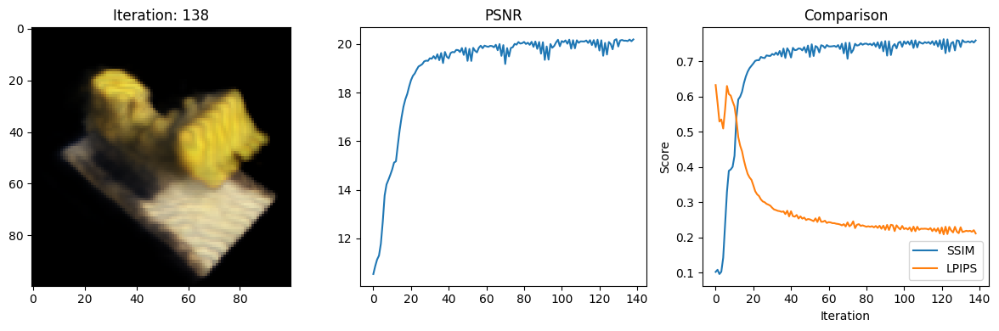

Data saved to: metrics.csv
139 8.908630132675171 secs per iter
Iteration: 139,PSNR: 20.008787155151367, SSIM: 0.7489371976848515, LPIPS: 0.22260242700576782


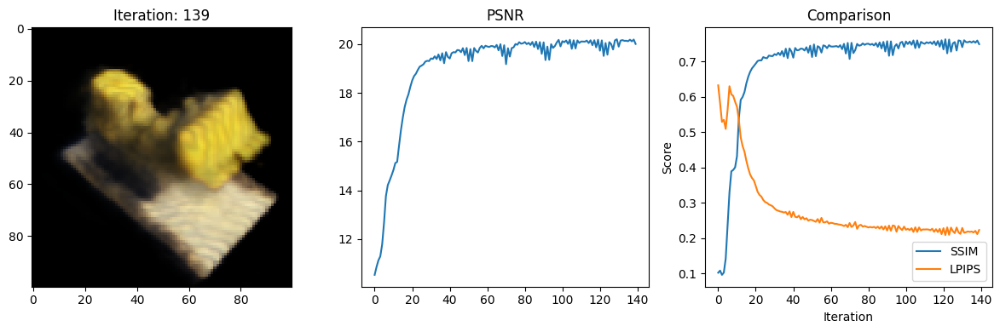

Data saved to: metrics.csv
140 8.894742727279663 secs per iter
Iteration: 140,PSNR: 20.189130783081055, SSIM: 0.7596025815253126, LPIPS: 0.20968937873840332


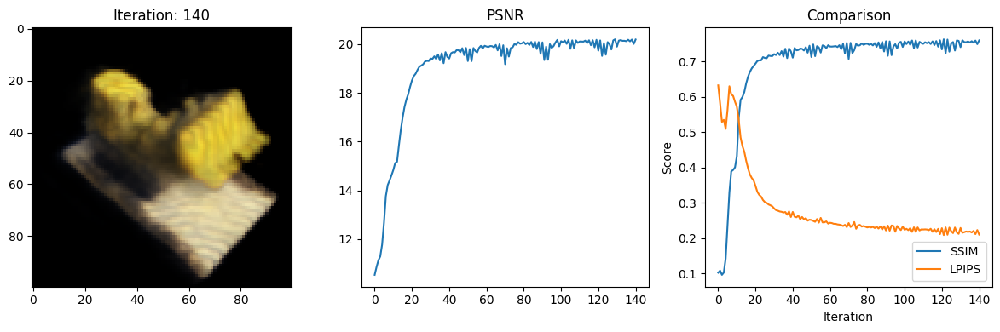

Data saved to: metrics.csv
141 8.875407934188843 secs per iter
Iteration: 141,PSNR: 19.97899627685547, SSIM: 0.7470647339216357, LPIPS: 0.22194775938987732


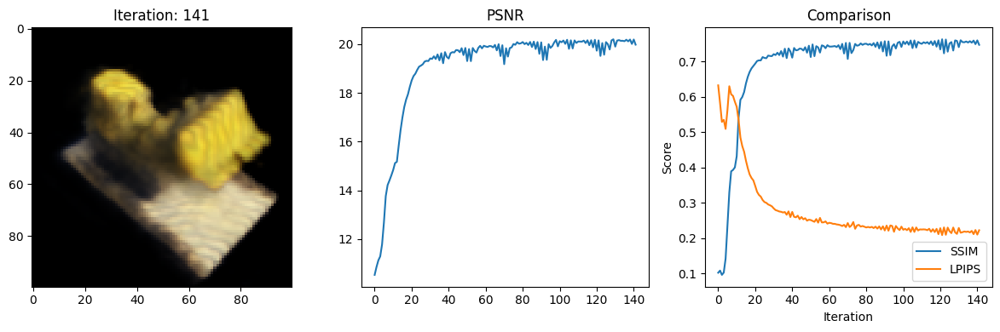

Data saved to: metrics.csv
142 9.084537506103516 secs per iter
Iteration: 142,PSNR: 20.218408584594727, SSIM: 0.7612711202123044, LPIPS: 0.20758995413780212


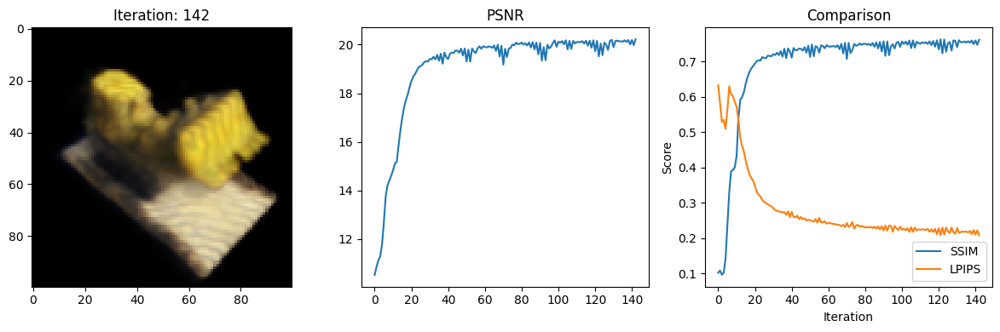

Data saved to: metrics.csv
143 8.911622524261475 secs per iter
Iteration: 143,PSNR: 20.003440856933594, SSIM: 0.7485656096861856, LPIPS: 0.21906810998916626


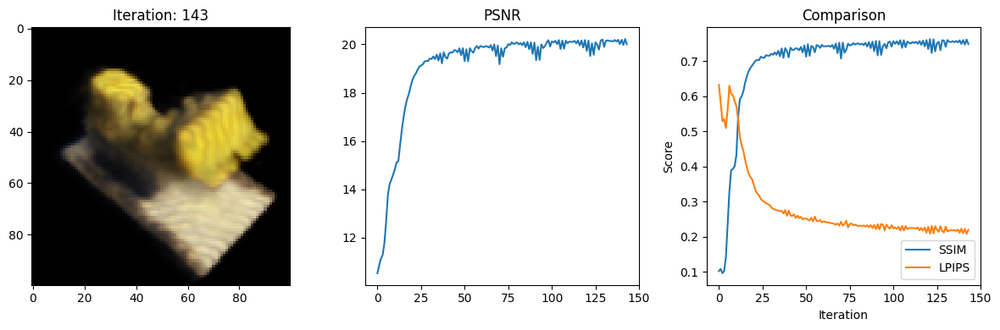

Data saved to: metrics.csv
144 8.907279014587402 secs per iter
Iteration: 144,PSNR: 20.253864288330078, SSIM: 0.762761866942329, LPIPS: 0.204135000705719


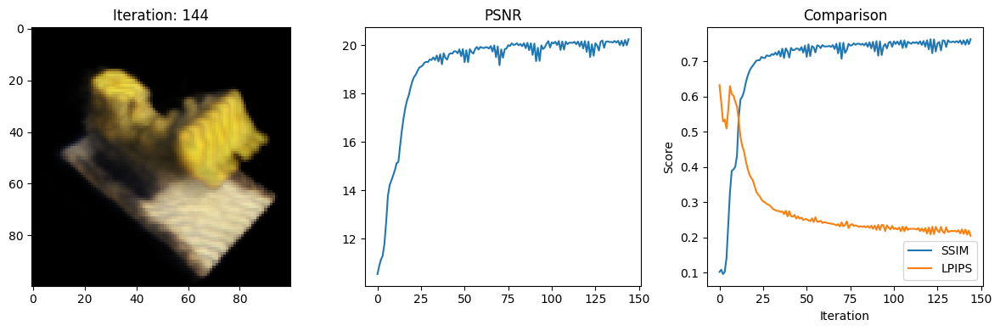

Data saved to: metrics.csv
145 8.873998403549194 secs per iter
Iteration: 145,PSNR: 19.974790573120117, SSIM: 0.7468061396985964, LPIPS: 0.21925446391105652


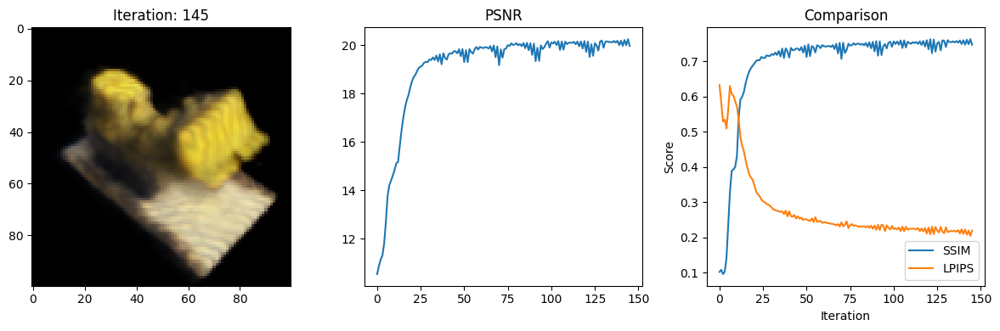

Data saved to: metrics.csv
146 9.101900100708008 secs per iter
Iteration: 146,PSNR: 20.251842498779297, SSIM: 0.7637716089069567, LPIPS: 0.20232920348644257


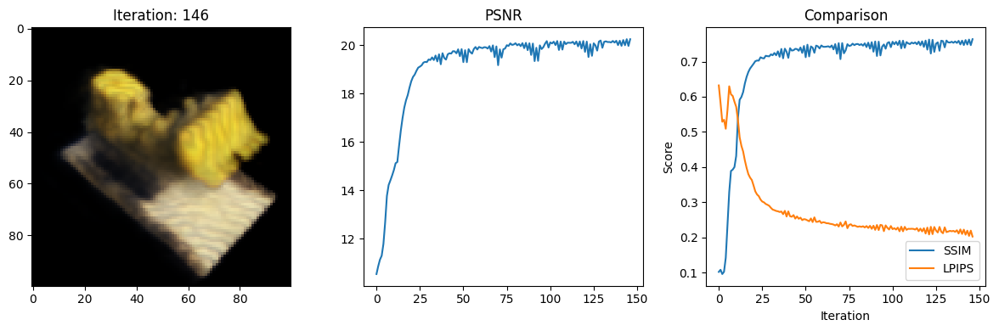

Data saved to: metrics.csv
147 8.896691799163818 secs per iter
Iteration: 147,PSNR: 19.961416244506836, SSIM: 0.7450526365941098, LPIPS: 0.22073820233345032


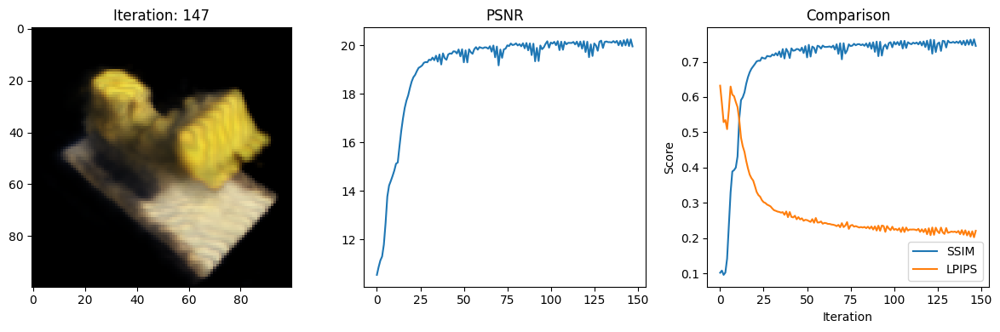

Data saved to: metrics.csv
148 8.875009059906006 secs per iter
Iteration: 148,PSNR: 20.213533401489258, SSIM: 0.7618158286228759, LPIPS: 0.20459595322608948


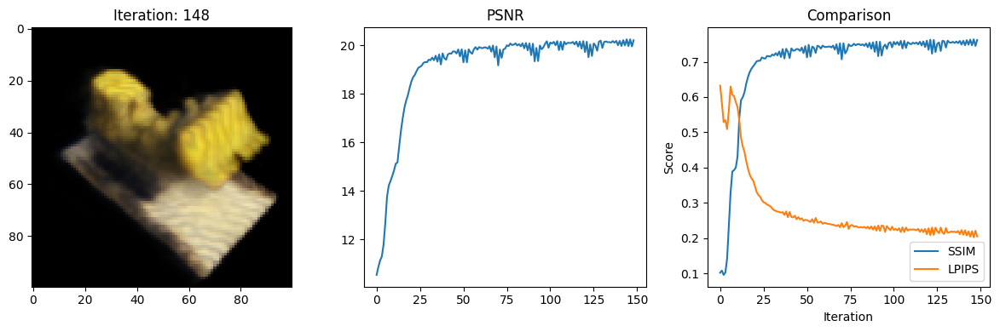

Data saved to: metrics.csv
149 8.863544464111328 secs per iter
Iteration: 149,PSNR: 20.032798767089844, SSIM: 0.7500642466735085, LPIPS: 0.21397016942501068


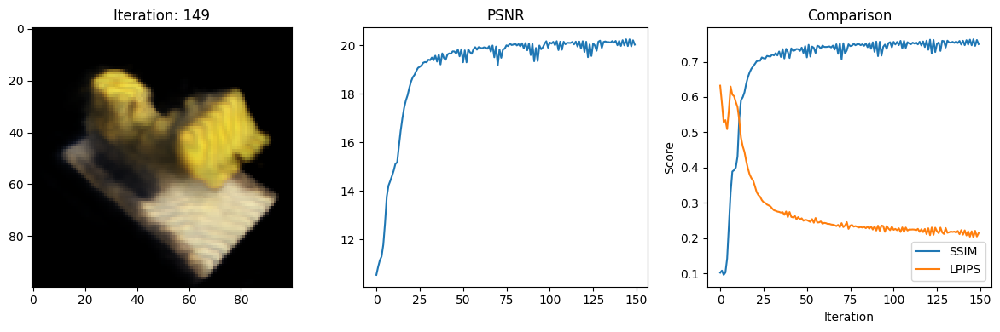

Data saved to: metrics.csv
150 9.538908004760742 secs per iter
Iteration: 150,PSNR: 20.19631576538086, SSIM: 0.7597205460037629, LPIPS: 0.2048192024230957


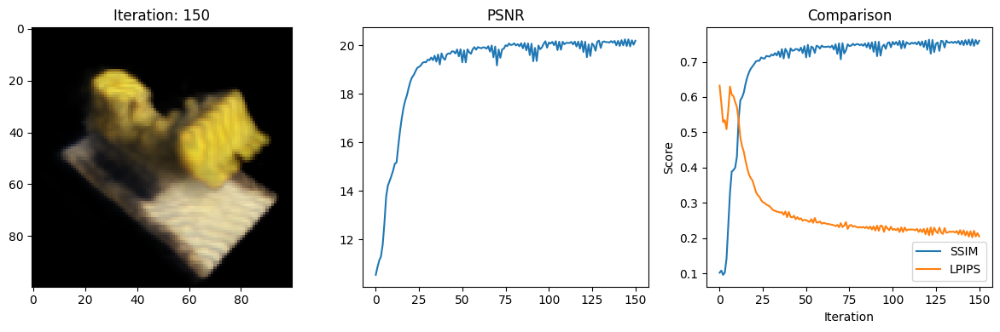

Data saved to: metrics.csv
151 8.885557651519775 secs per iter
Iteration: 151,PSNR: 20.1605281829834, SSIM: 0.7565148449774518, LPIPS: 0.20734447240829468


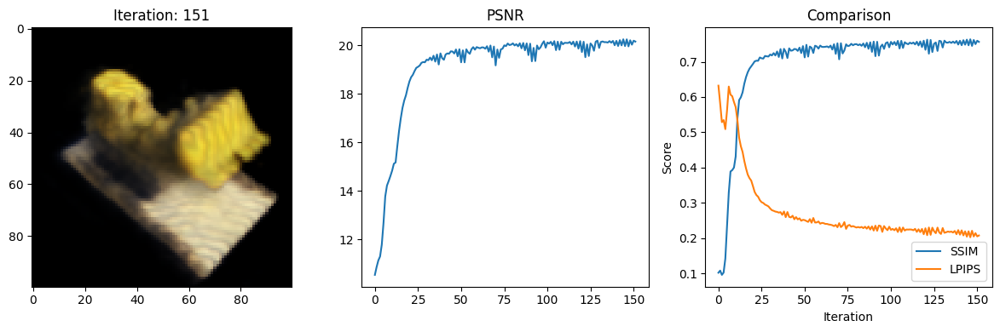

Data saved to: metrics.csv
152 8.921328783035278 secs per iter
Iteration: 152,PSNR: 20.161048889160156, SSIM: 0.7554678805891065, LPIPS: 0.20715096592903137


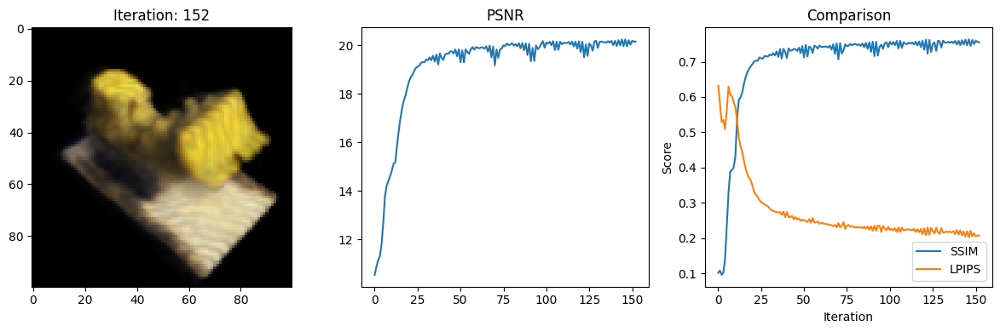

Data saved to: metrics.csv
153 8.902880668640137 secs per iter
Iteration: 153,PSNR: 20.217439651489258, SSIM: 0.762374060999159, LPIPS: 0.19894972443580627


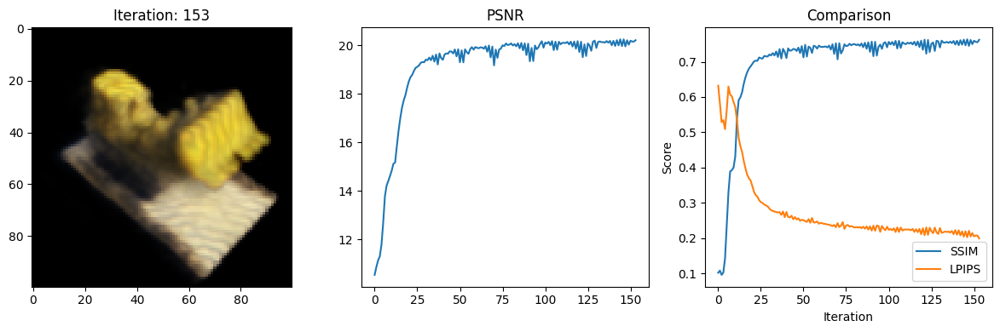

Data saved to: metrics.csv
154 9.143741130828857 secs per iter
Iteration: 154,PSNR: 20.01091194152832, SSIM: 0.7470044451868776, LPIPS: 0.21887506544589996


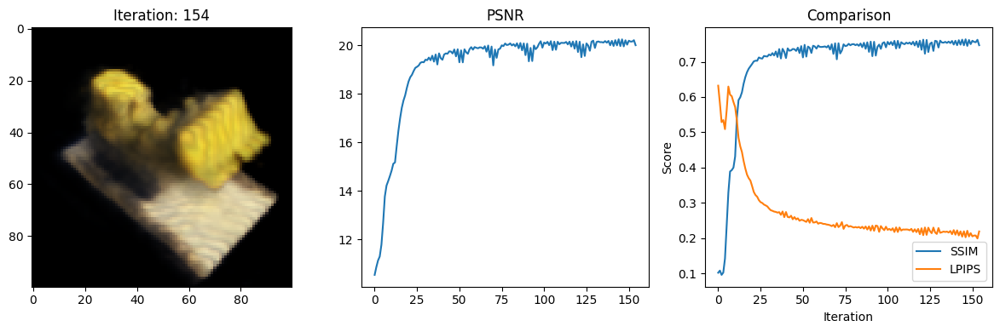

Data saved to: metrics.csv
155 8.92307424545288 secs per iter
Iteration: 155,PSNR: 20.178892135620117, SSIM: 0.7648429792744359, LPIPS: 0.1968756914138794


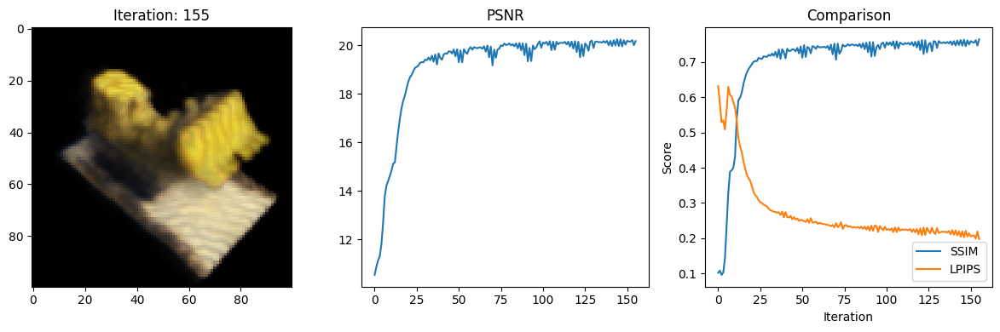

Data saved to: metrics.csv
156 8.900906085968018 secs per iter
Iteration: 156,PSNR: 19.81840705871582, SSIM: 0.7364386794403038, LPIPS: 0.225895494222641


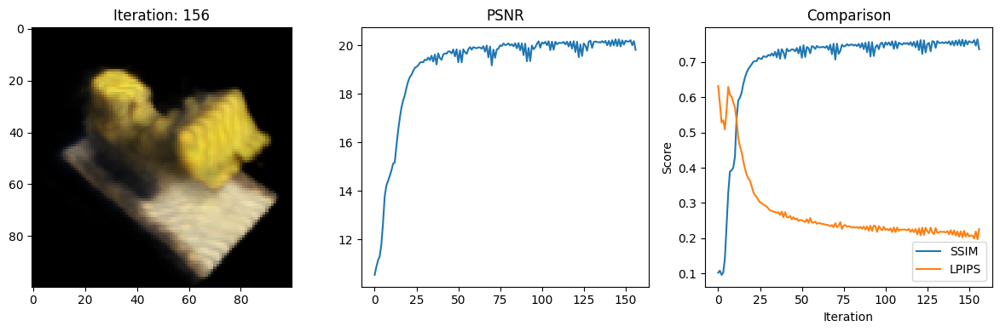

Data saved to: metrics.csv
157 8.89328670501709 secs per iter
Iteration: 157,PSNR: 20.129915237426758, SSIM: 0.7641562900952277, LPIPS: 0.19986523687839508


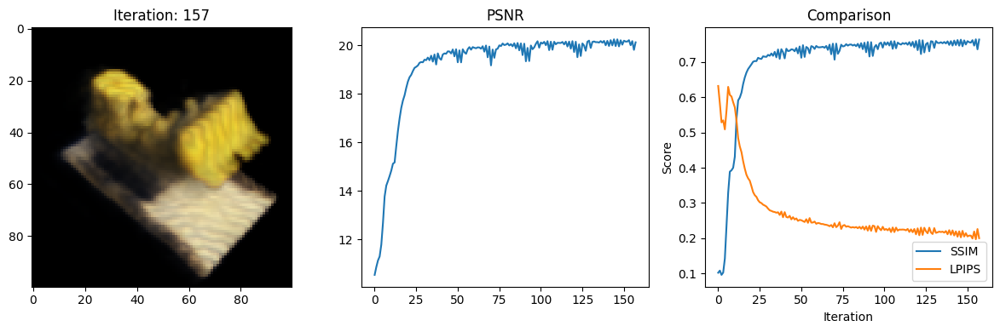

Data saved to: metrics.csv
158 9.058254957199097 secs per iter
Iteration: 158,PSNR: 19.559980392456055, SSIM: 0.7252370405633165, LPIPS: 0.22982023656368256


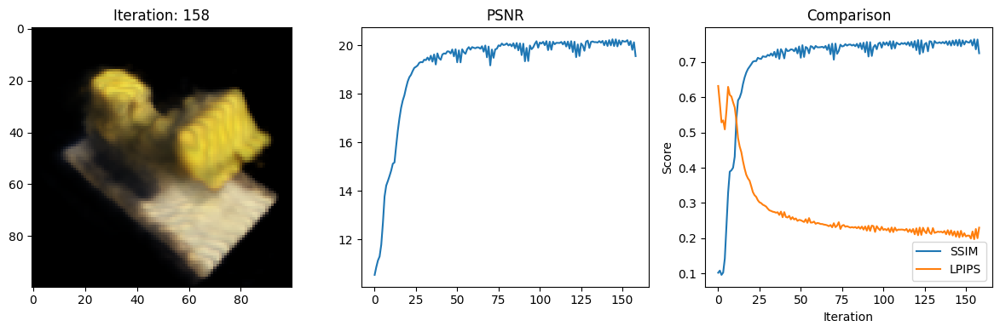

Data saved to: metrics.csv
159 8.889081239700317 secs per iter
Iteration: 159,PSNR: 20.053590774536133, SSIM: 0.7626924521846652, LPIPS: 0.20305025577545166


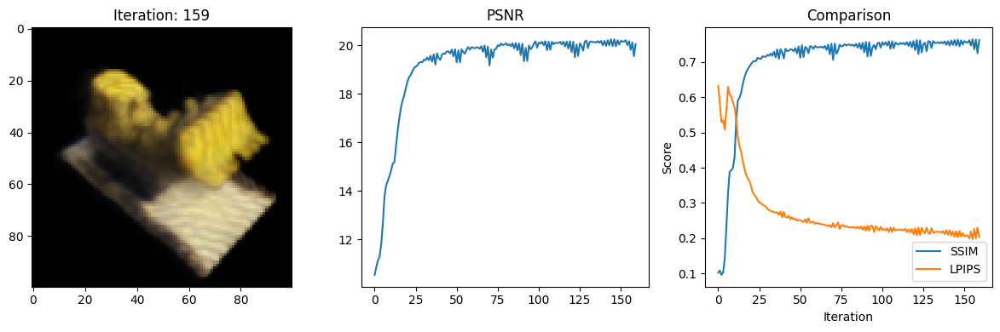

Data saved to: metrics.csv
160 8.943451881408691 secs per iter
Iteration: 160,PSNR: 19.716093063354492, SSIM: 0.7361515876024701, LPIPS: 0.2235998511314392


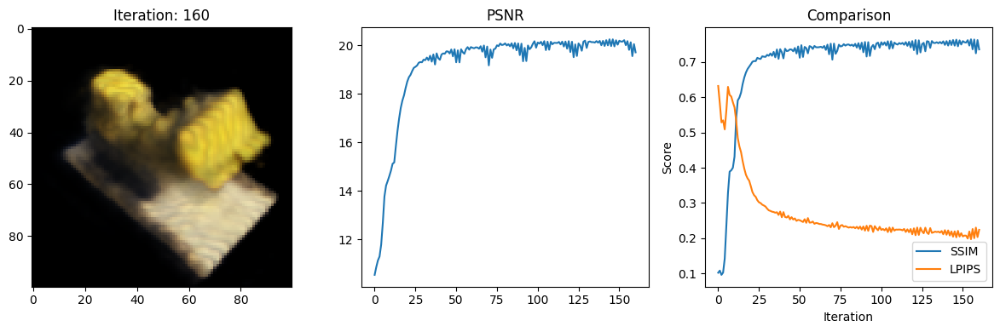

Data saved to: metrics.csv
161 8.908179521560669 secs per iter
Iteration: 161,PSNR: 19.96534538269043, SSIM: 0.7420577931713773, LPIPS: 0.2209070920944214


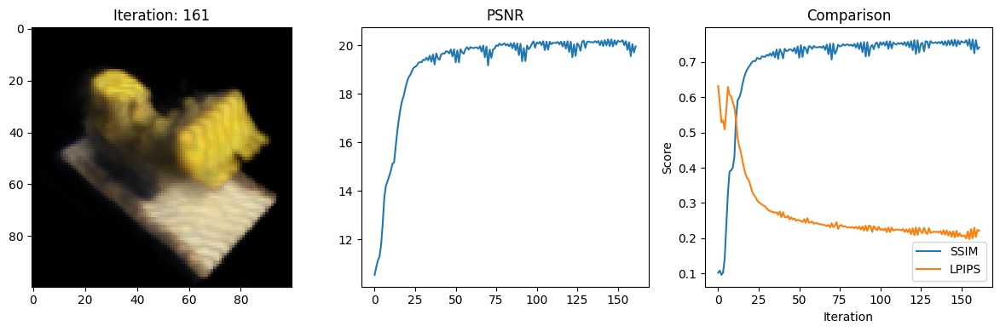

Data saved to: metrics.csv
162 9.138229370117188 secs per iter
Iteration: 162,PSNR: 20.08018684387207, SSIM: 0.7594884281082172, LPIPS: 0.20452898740768433


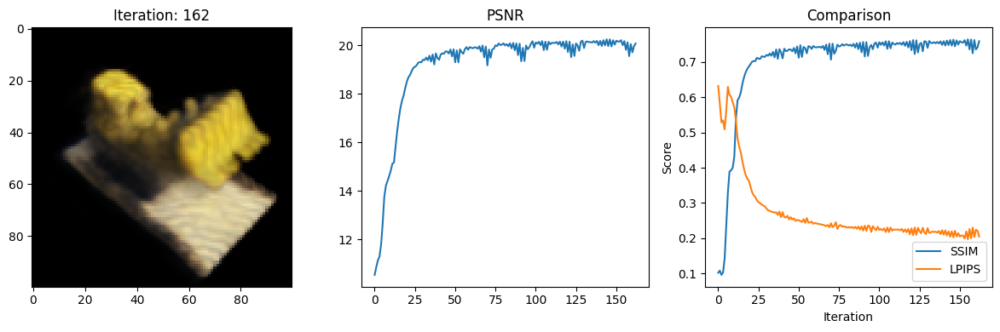

Data saved to: metrics.csv
163 9.016663074493408 secs per iter
Iteration: 163,PSNR: 20.099679946899414, SSIM: 0.7491132109923521, LPIPS: 0.21635624766349792


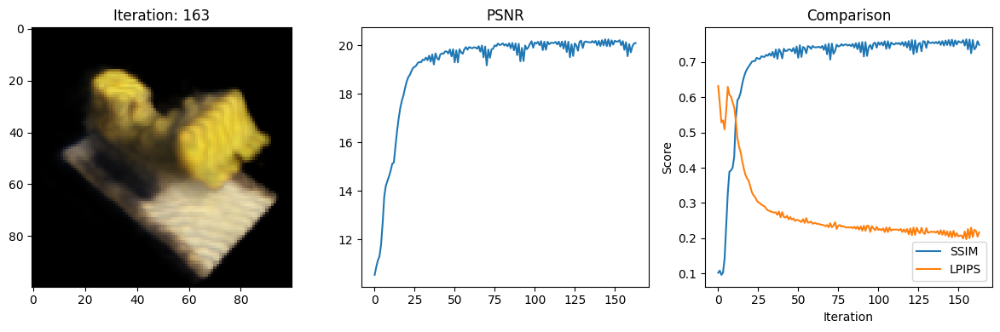

Data saved to: metrics.csv
164 9.148319482803345 secs per iter
Iteration: 164,PSNR: 20.259838104248047, SSIM: 0.7622721708929449, LPIPS: 0.206376314163208


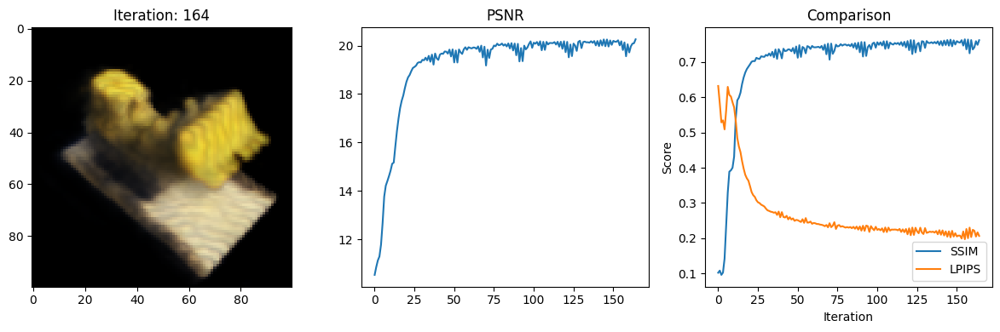

Data saved to: metrics.csv
165 9.527490377426147 secs per iter
Iteration: 165,PSNR: 20.10610008239746, SSIM: 0.754737483821792, LPIPS: 0.21033266186714172


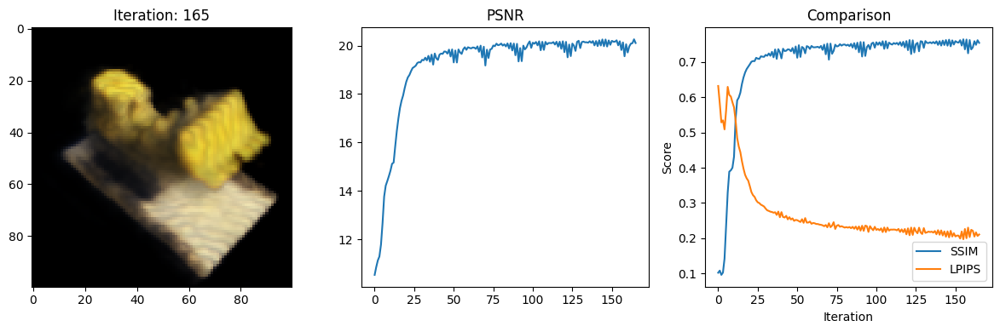

Data saved to: metrics.csv
166 9.267082214355469 secs per iter
Iteration: 166,PSNR: 20.066314697265625, SSIM: 0.7509758354472664, LPIPS: 0.211783304810524


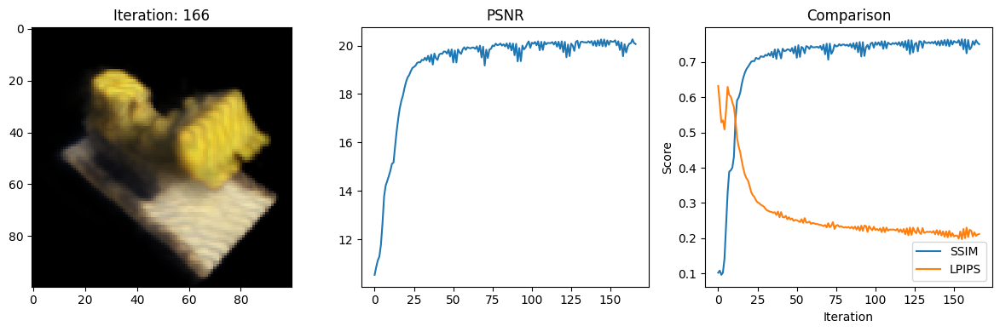

Data saved to: metrics.csv
167 9.039361953735352 secs per iter
Iteration: 167,PSNR: 20.154743194580078, SSIM: 0.7602768408834898, LPIPS: 0.20832045376300812


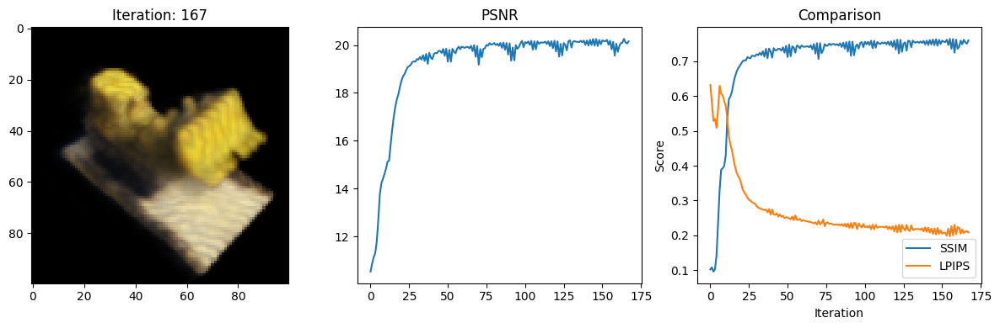

Data saved to: metrics.csv
168 8.98084306716919 secs per iter
Iteration: 168,PSNR: 20.134695053100586, SSIM: 0.7538631898879508, LPIPS: 0.21033897995948792


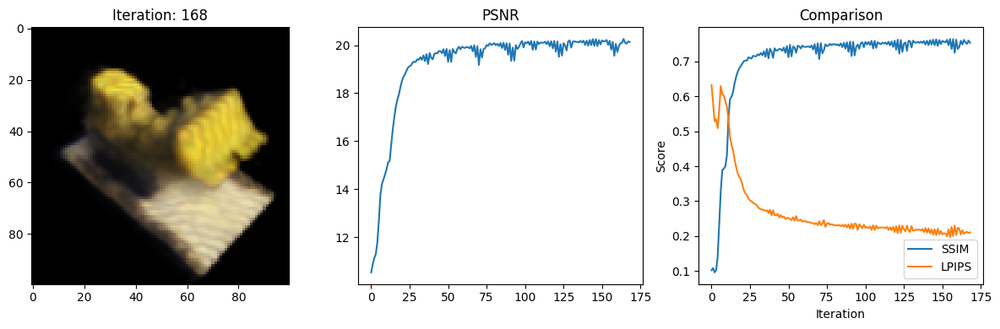

Data saved to: metrics.csv
169 8.908179521560669 secs per iter
Iteration: 169,PSNR: 20.268756866455078, SSIM: 0.7617568810272596, LPIPS: 0.20432548224925995


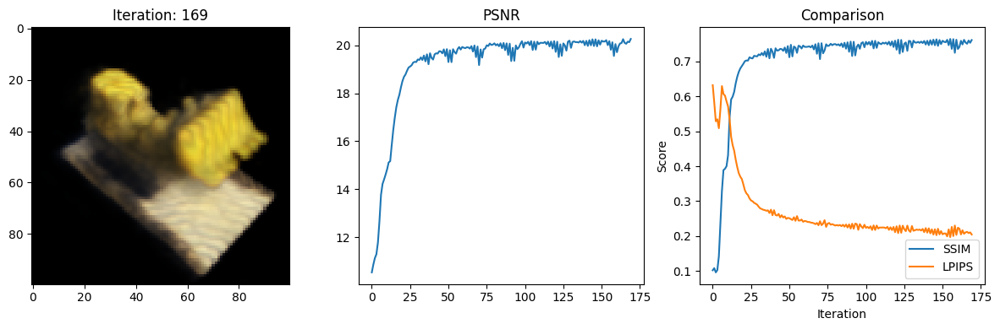

Data saved to: metrics.csv
170 8.928346872329712 secs per iter
Iteration: 170,PSNR: 20.037067413330078, SSIM: 0.7506031612318617, LPIPS: 0.2127070426940918


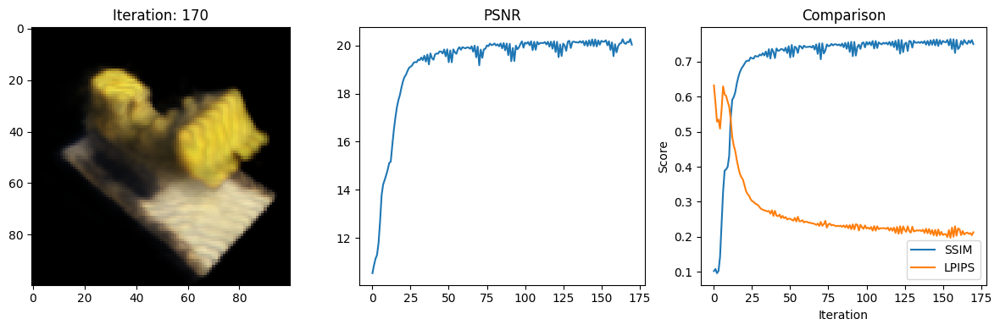

Data saved to: metrics.csv
171 8.929358005523682 secs per iter
Iteration: 171,PSNR: 20.200098037719727, SSIM: 0.7604247931632591, LPIPS: 0.2043348252773285


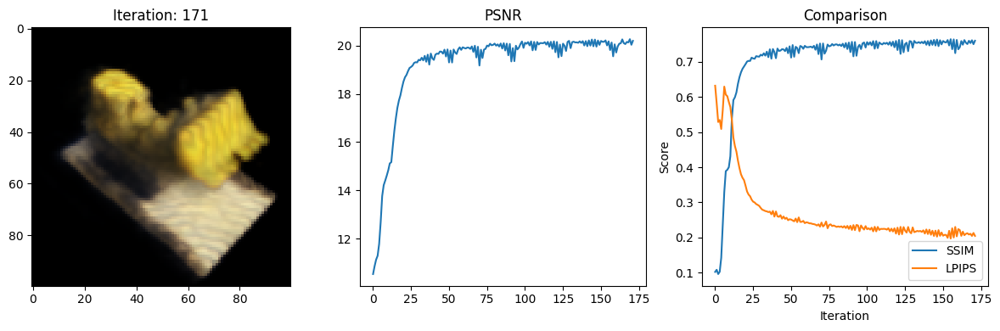

Data saved to: metrics.csv
172 8.904948711395264 secs per iter
Iteration: 172,PSNR: 19.9259090423584, SSIM: 0.7450476543135269, LPIPS: 0.21544066071510315


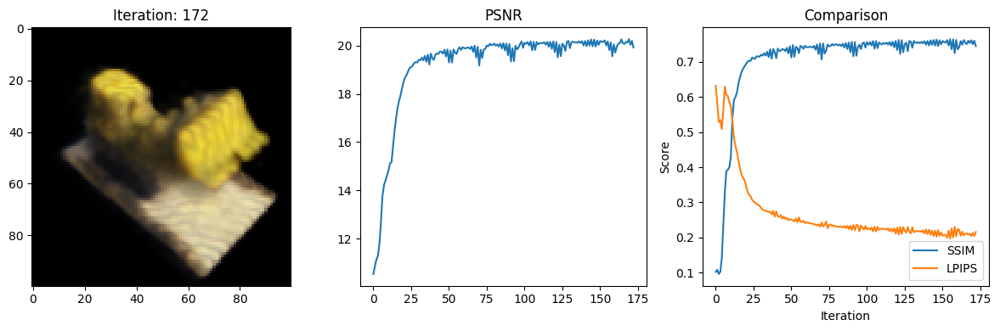

Data saved to: metrics.csv
173 8.958619594573975 secs per iter
Iteration: 173,PSNR: 20.217924118041992, SSIM: 0.76401440051013, LPIPS: 0.2000953108072281


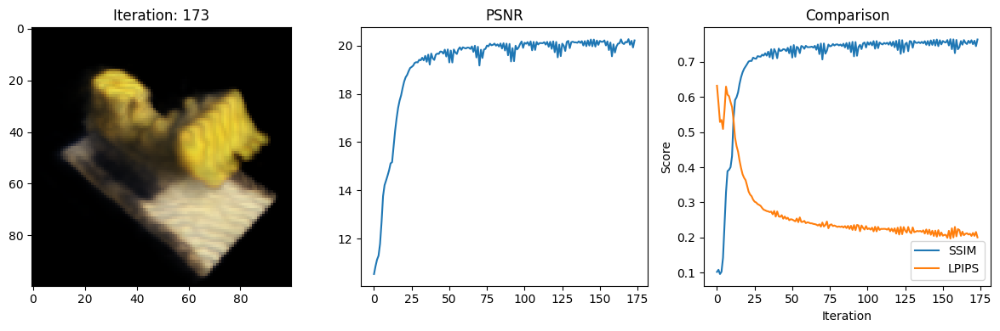

Data saved to: metrics.csv
174 8.98411750793457 secs per iter
Iteration: 174,PSNR: 19.835678100585938, SSIM: 0.7397174106178199, LPIPS: 0.21892096102237701


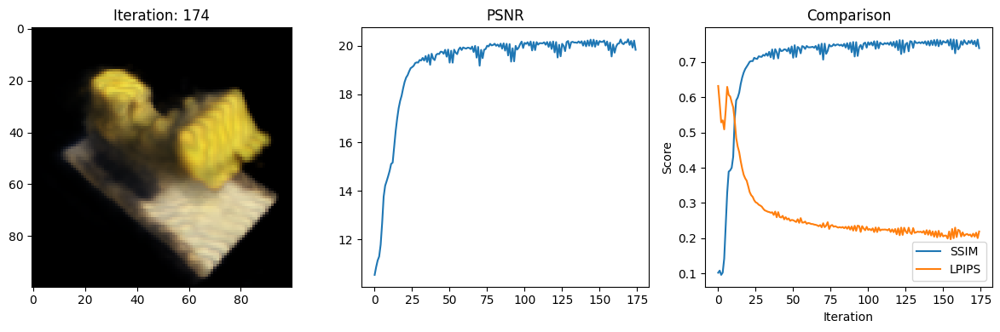

Data saved to: metrics.csv
175 8.957816123962402 secs per iter
Iteration: 175,PSNR: 20.206539154052734, SSIM: 0.7647545647686346, LPIPS: 0.1991388350725174


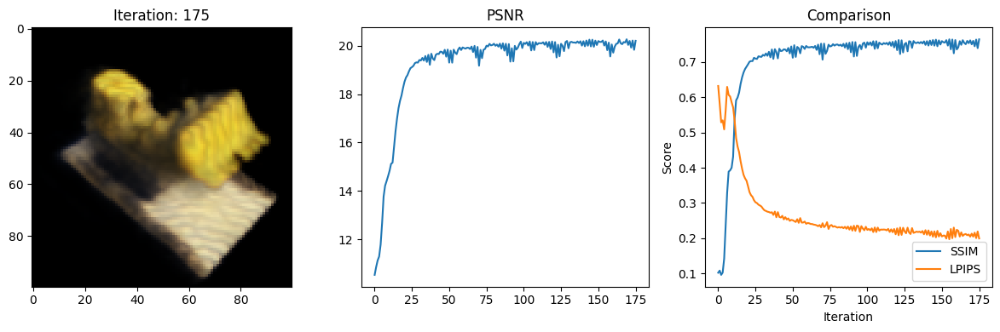

Data saved to: metrics.csv
176 8.963494777679443 secs per iter
Iteration: 176,PSNR: 19.965526580810547, SSIM: 0.7479006452508612, LPIPS: 0.21421241760253906


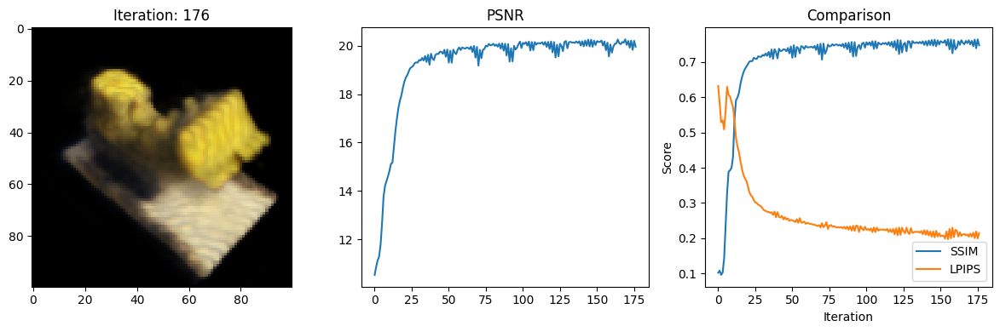

Data saved to: metrics.csv
177 9.040230751037598 secs per iter
Iteration: 177,PSNR: 20.14069366455078, SSIM: 0.7552830760131283, LPIPS: 0.20518839359283447


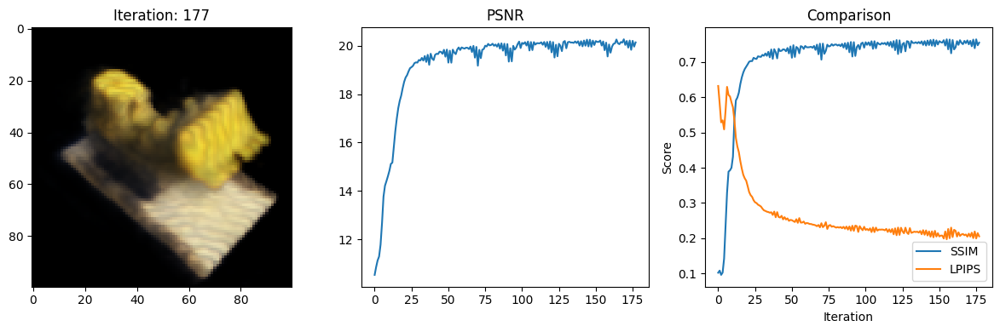

Data saved to: metrics.csv
178 8.859335899353027 secs per iter
Iteration: 178,PSNR: 20.224254608154297, SSIM: 0.7617106645885222, LPIPS: 0.204713374376297


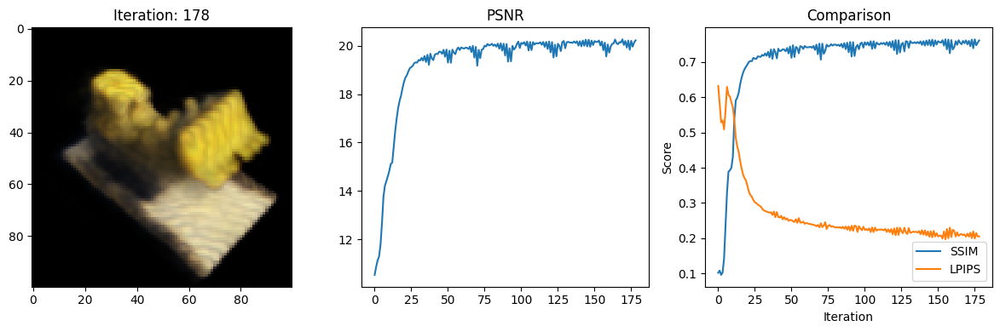

Data saved to: metrics.csv
179 9.070181608200073 secs per iter
Iteration: 179,PSNR: 20.059701919555664, SSIM: 0.7503575905259684, LPIPS: 0.20785951614379883


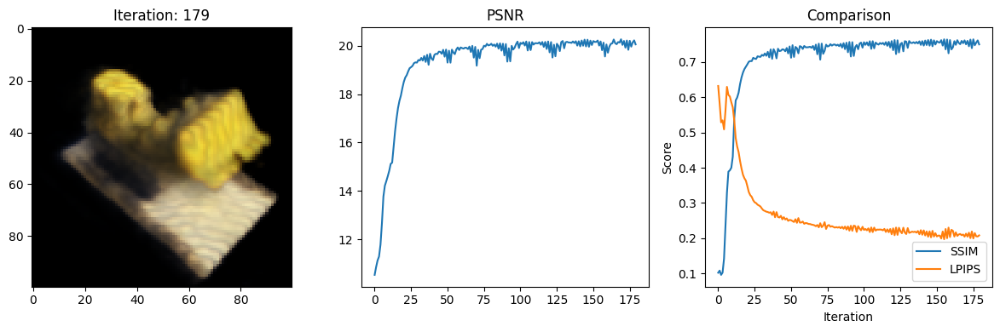

Data saved to: metrics.csv
180 9.253952503204346 secs per iter
Iteration: 180,PSNR: 20.295698165893555, SSIM: 0.765379017460129, LPIPS: 0.1993672251701355


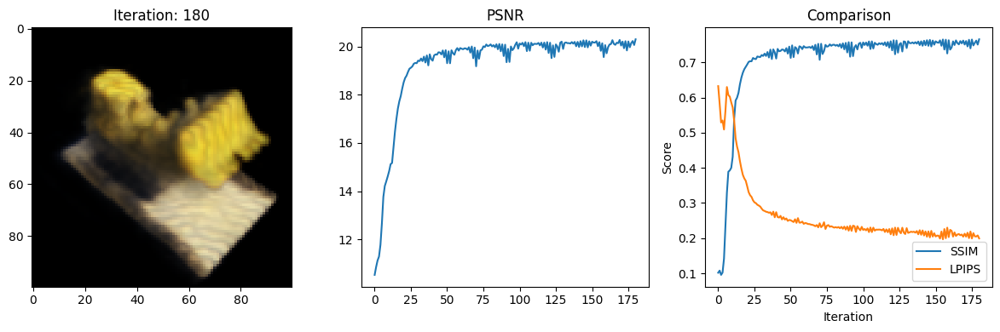

Data saved to: metrics.csv
181 9.082149982452393 secs per iter
Iteration: 181,PSNR: 20.012895584106445, SSIM: 0.7492141765296177, LPIPS: 0.21038199961185455


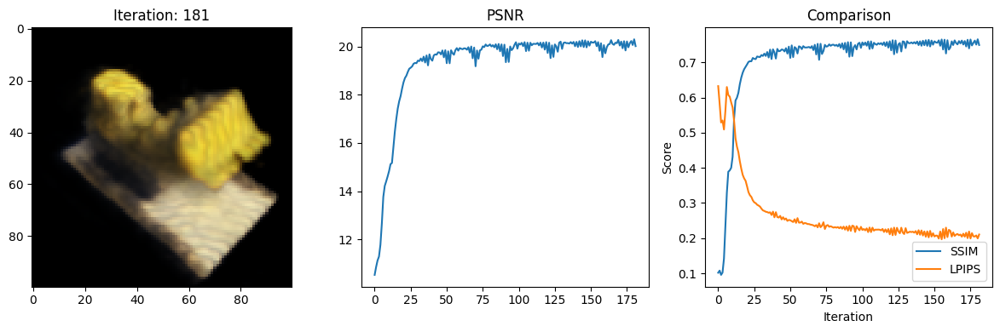

Data saved to: metrics.csv
182 8.94939398765564 secs per iter
Iteration: 182,PSNR: 20.234790802001953, SSIM: 0.7631900406640284, LPIPS: 0.1962013989686966


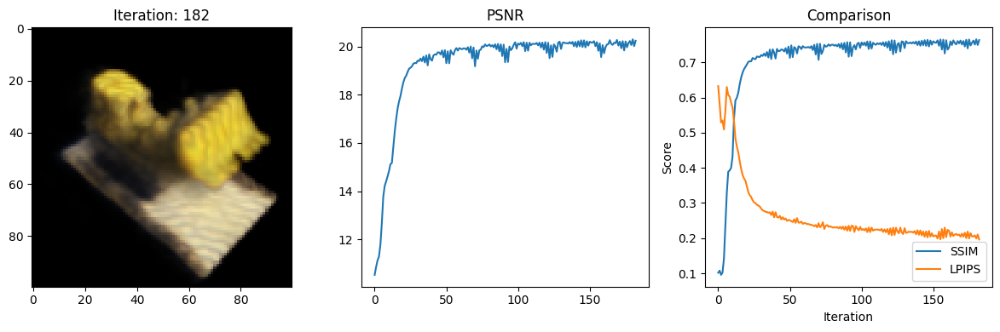

Data saved to: metrics.csv
183 9.115086555480957 secs per iter
Iteration: 183,PSNR: 20.052846908569336, SSIM: 0.7510096101986821, LPIPS: 0.21061712503433228


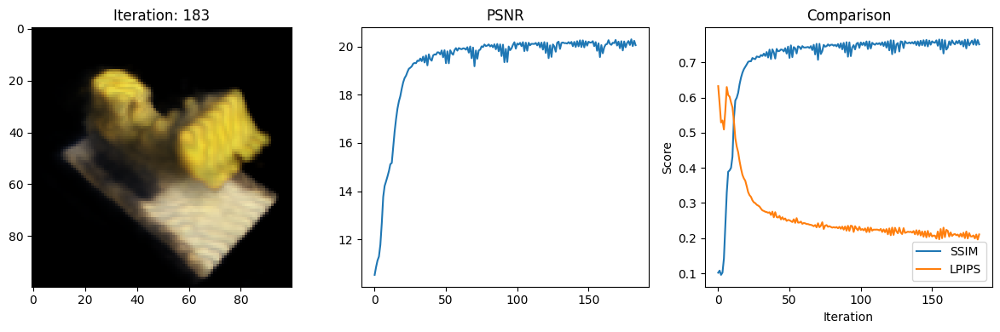

Data saved to: metrics.csv
184 8.964763641357422 secs per iter
Iteration: 184,PSNR: 20.2215518951416, SSIM: 0.7635154436958612, LPIPS: 0.19684068858623505


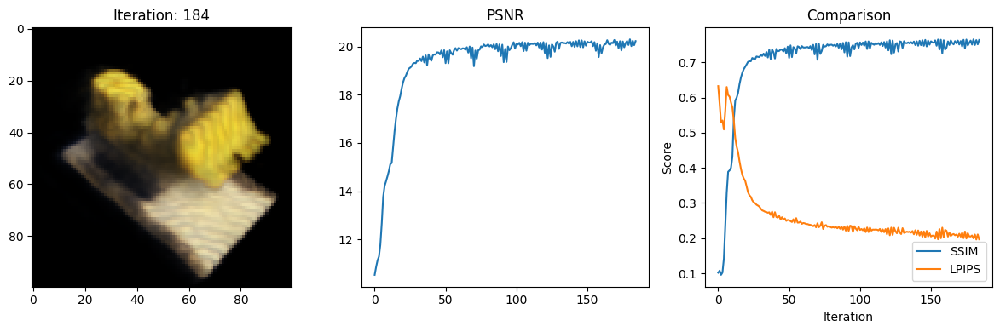

Data saved to: metrics.csv
185 8.963323593139648 secs per iter
Iteration: 185,PSNR: 20.098106384277344, SSIM: 0.7523557863179823, LPIPS: 0.2094152271747589


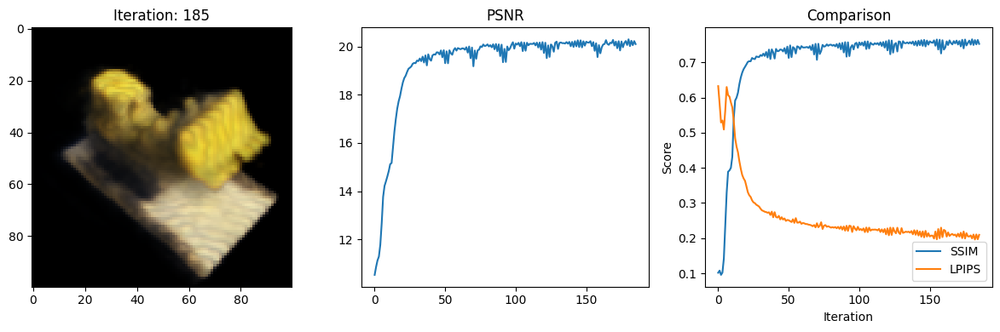

Data saved to: metrics.csv
186 8.891708850860596 secs per iter
Iteration: 186,PSNR: 20.171920776367188, SSIM: 0.7592443586531564, LPIPS: 0.20189642906188965


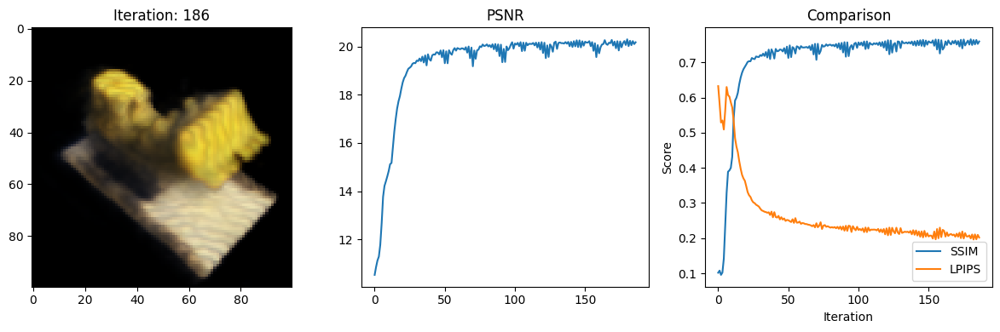

Data saved to: metrics.csv
187 9.039777517318726 secs per iter
Iteration: 187,PSNR: 20.14748191833496, SSIM: 0.7568248249788665, LPIPS: 0.21005851030349731


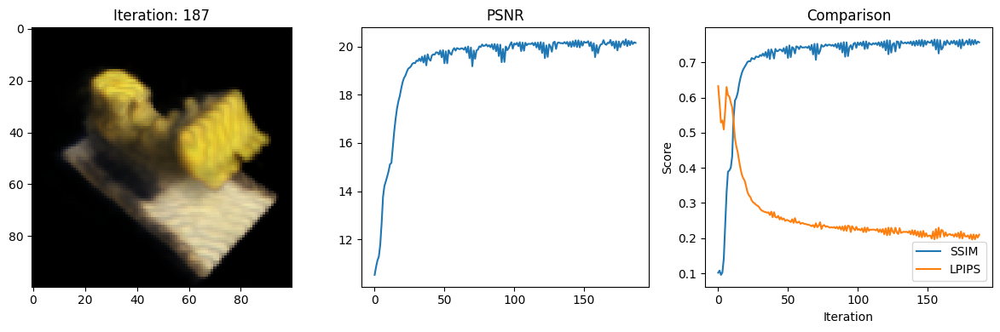

Data saved to: metrics.csv
188 8.953513860702515 secs per iter
Iteration: 188,PSNR: 20.17243194580078, SSIM: 0.759049736711488, LPIPS: 0.20259585976600647


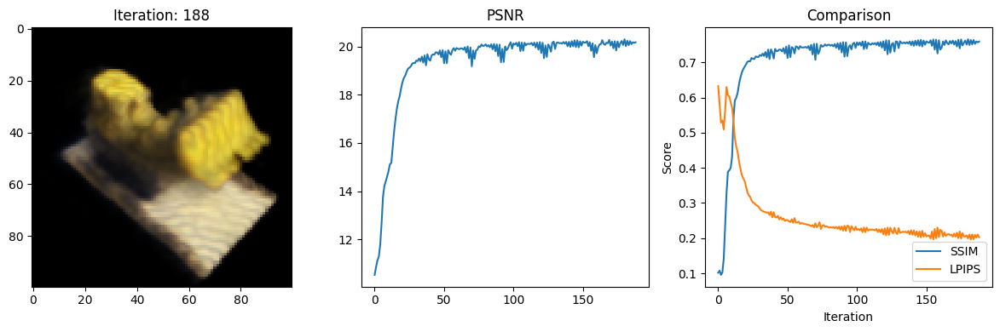

Data saved to: metrics.csv
189 8.913426876068115 secs per iter
Iteration: 189,PSNR: 20.198707580566406, SSIM: 0.7593032938912848, LPIPS: 0.20380067825317383


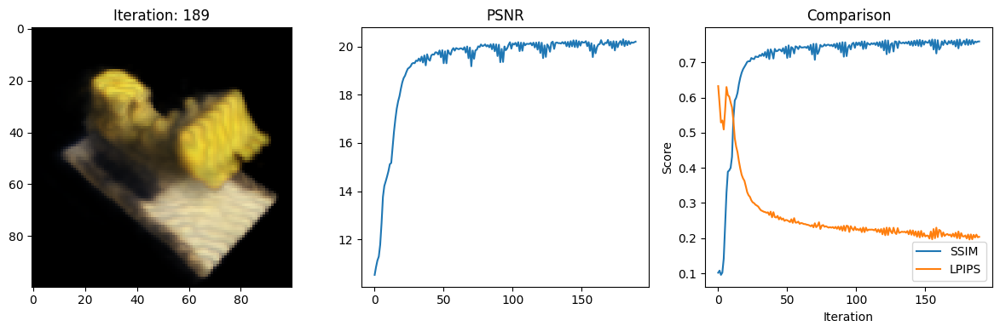

Data saved to: metrics.csv
190 8.888192653656006 secs per iter
Iteration: 190,PSNR: 20.14447784423828, SSIM: 0.7580778966237377, LPIPS: 0.20312178134918213


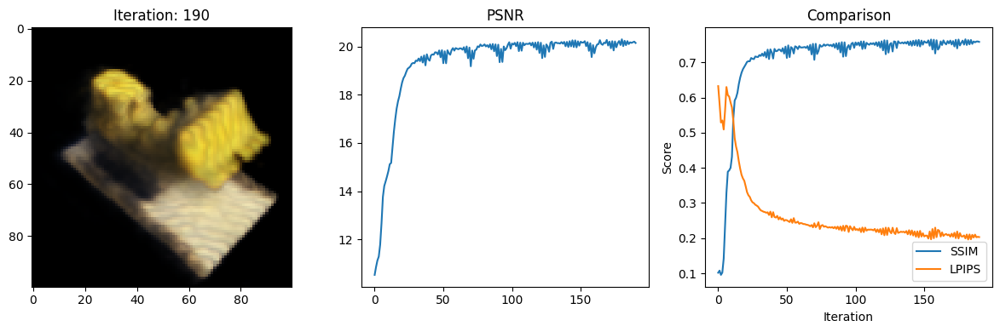

Data saved to: metrics.csv
191 9.03149962425232 secs per iter
Iteration: 191,PSNR: 20.211217880249023, SSIM: 0.7583905223445395, LPIPS: 0.2053718864917755


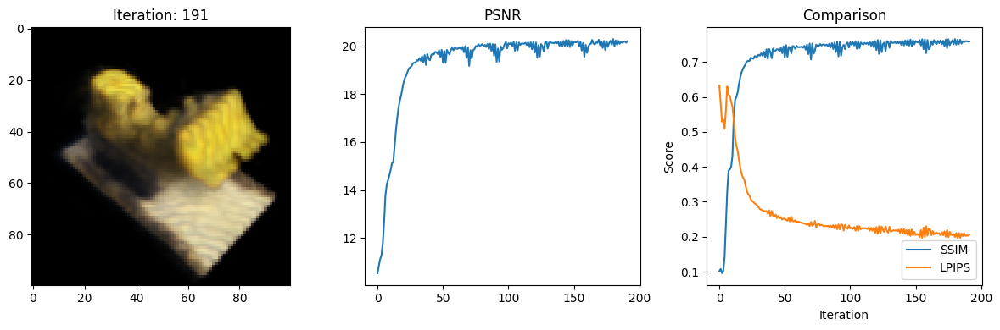

Data saved to: metrics.csv
192 8.949403285980225 secs per iter
Iteration: 192,PSNR: 20.159618377685547, SSIM: 0.759370206076407, LPIPS: 0.20098909735679626


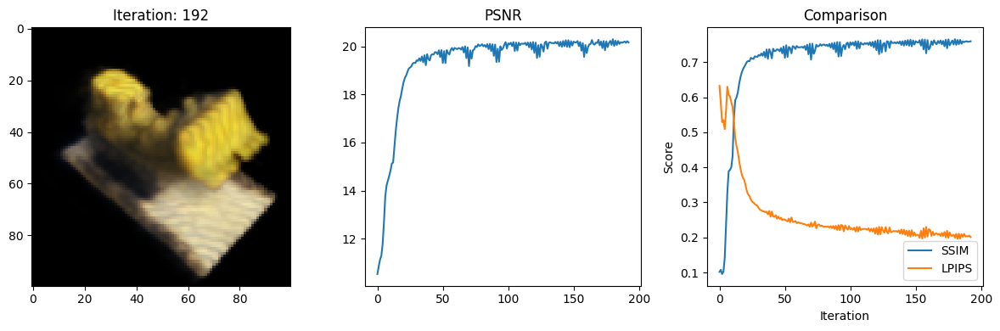

Data saved to: metrics.csv
193 8.997181177139282 secs per iter
Iteration: 193,PSNR: 20.160388946533203, SSIM: 0.7562023159105044, LPIPS: 0.20385320484638214


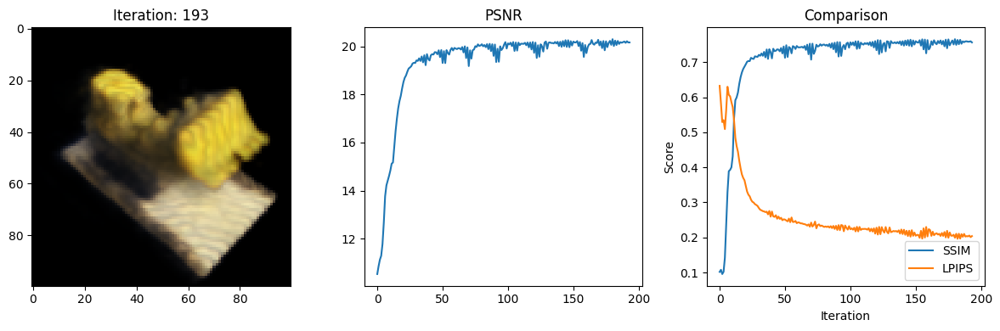

Data saved to: metrics.csv
194 8.915961265563965 secs per iter
Iteration: 194,PSNR: 20.207714080810547, SSIM: 0.7603560890044552, LPIPS: 0.2005334496498108


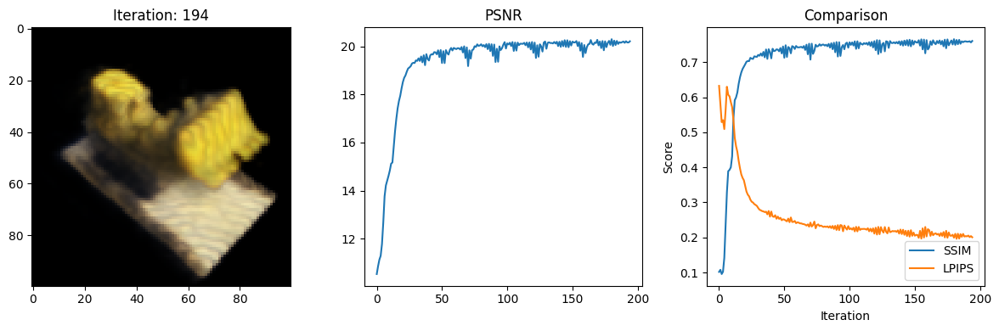

Data saved to: metrics.csv
195 9.142804622650146 secs per iter
Iteration: 195,PSNR: 20.138776779174805, SSIM: 0.7565976717325462, LPIPS: 0.2020353078842163


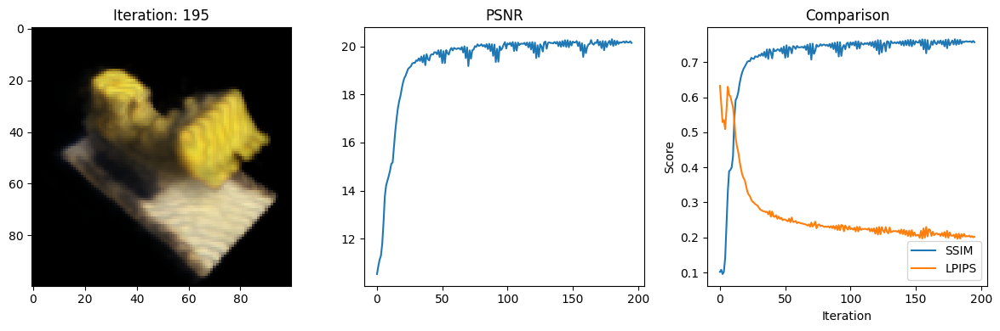

Data saved to: metrics.csv
196 9.29222321510315 secs per iter
Iteration: 196,PSNR: 20.198883056640625, SSIM: 0.7598582728104936, LPIPS: 0.19940589368343353


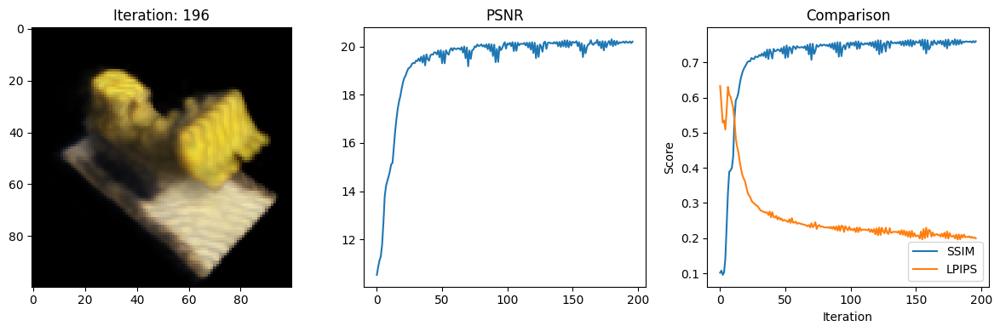

Data saved to: metrics.csv
197 8.956957340240479 secs per iter
Iteration: 197,PSNR: 20.2308292388916, SSIM: 0.7620242860508247, LPIPS: 0.19440826773643494


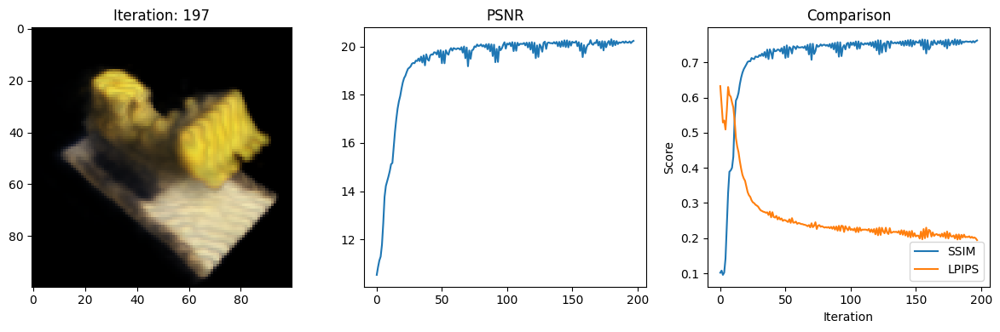

Data saved to: metrics.csv
198 8.92082142829895 secs per iter
Iteration: 198,PSNR: 20.221010208129883, SSIM: 0.7580084548330518, LPIPS: 0.19940808415412903


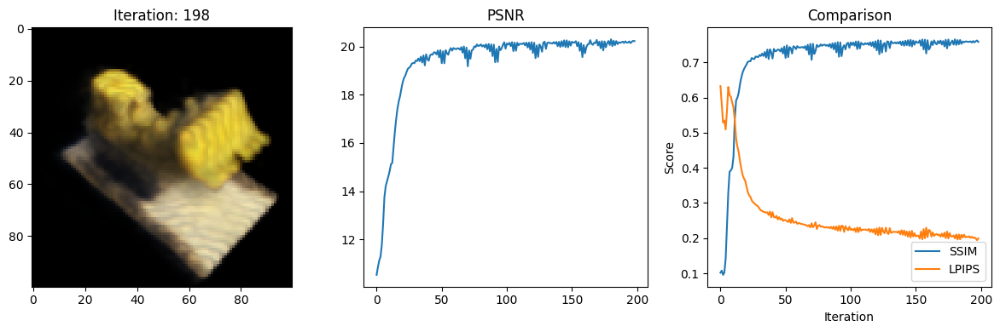

Data saved to: metrics.csv
199 9.139803409576416 secs per iter
Iteration: 199,PSNR: 20.24954605102539, SSIM: 0.7646063598206282, LPIPS: 0.19035500288009644


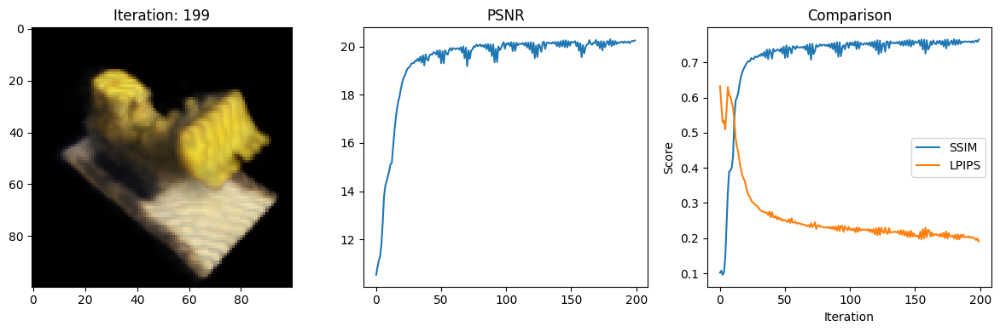

Data saved to: metrics.csv
200 9.018964052200317 secs per iter
Iteration: 200,PSNR: 20.206012725830078, SSIM: 0.7582296528179043, LPIPS: 0.19928528368473053


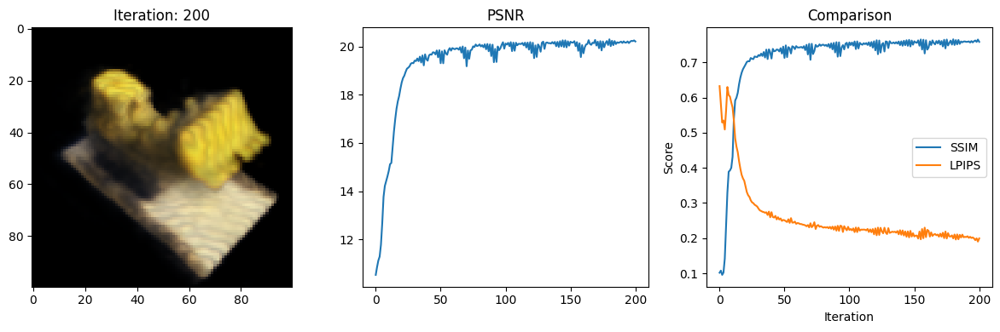

Data saved to: metrics.csv
201 9.017851829528809 secs per iter
Iteration: 201,PSNR: 20.195842742919922, SSIM: 0.7613914795595152, LPIPS: 0.19606712460517883


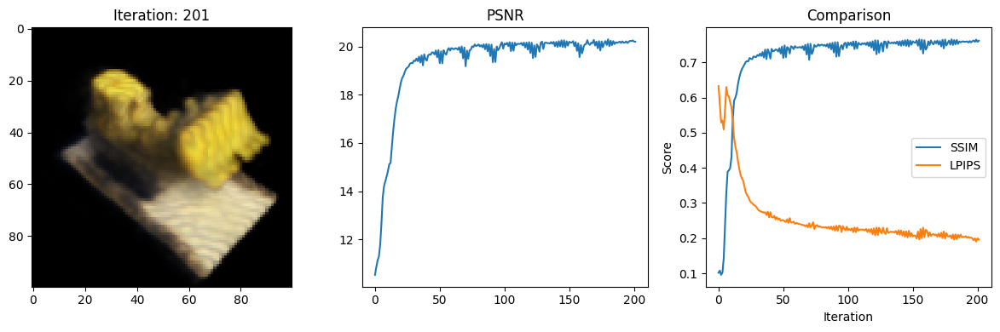

Data saved to: metrics.csv
202 8.93884801864624 secs per iter
Iteration: 202,PSNR: 20.23380470275879, SSIM: 0.7613395446431649, LPIPS: 0.19845888018608093


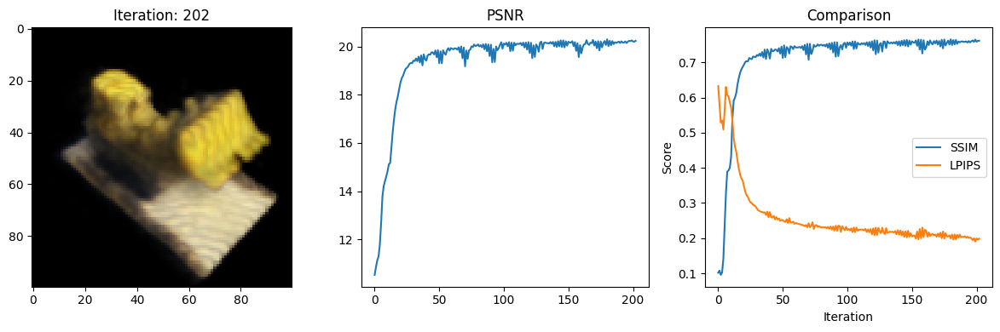

Data saved to: metrics.csv
203 9.153233289718628 secs per iter
Iteration: 203,PSNR: 20.232738494873047, SSIM: 0.7606679052421338, LPIPS: 0.198219895362854


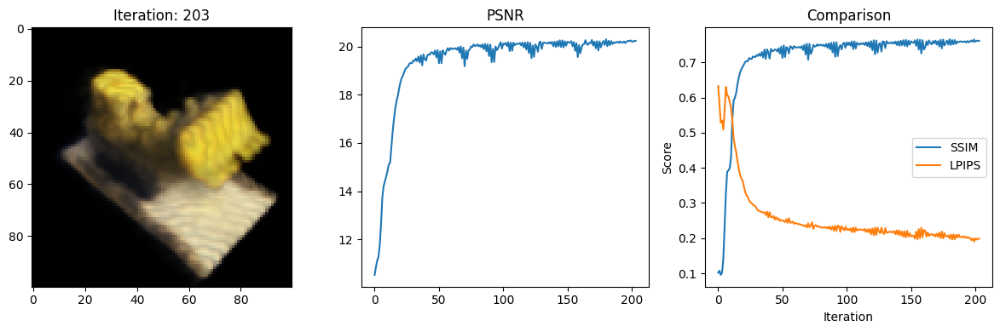

Data saved to: metrics.csv
204 8.991692781448364 secs per iter
Iteration: 204,PSNR: 20.19917106628418, SSIM: 0.7595610845509811, LPIPS: 0.20241984724998474


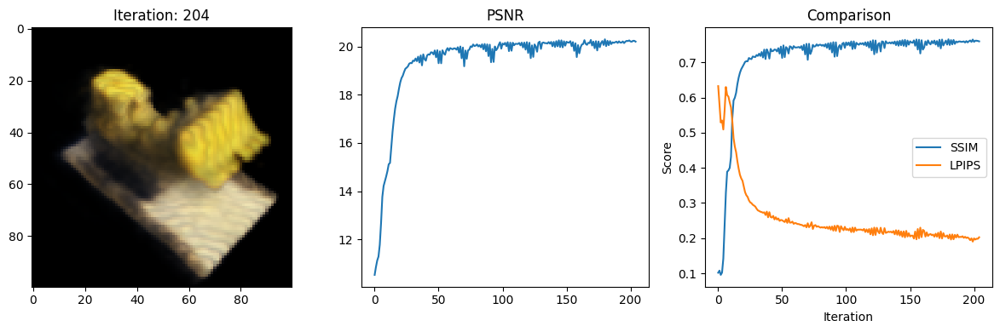

Data saved to: metrics.csv
205 8.994223833084106 secs per iter
Iteration: 205,PSNR: 20.18229103088379, SSIM: 0.7597675430049576, LPIPS: 0.2004733383655548


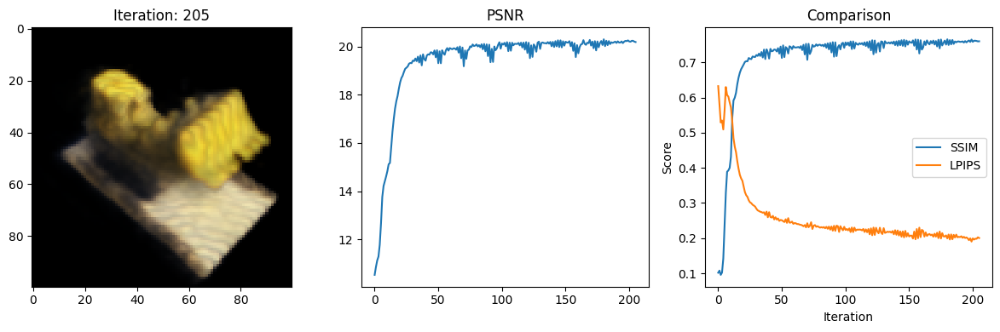

Data saved to: metrics.csv
206 8.94225025177002 secs per iter
Iteration: 206,PSNR: 20.078428268432617, SSIM: 0.7539307553000113, LPIPS: 0.2072197049856186


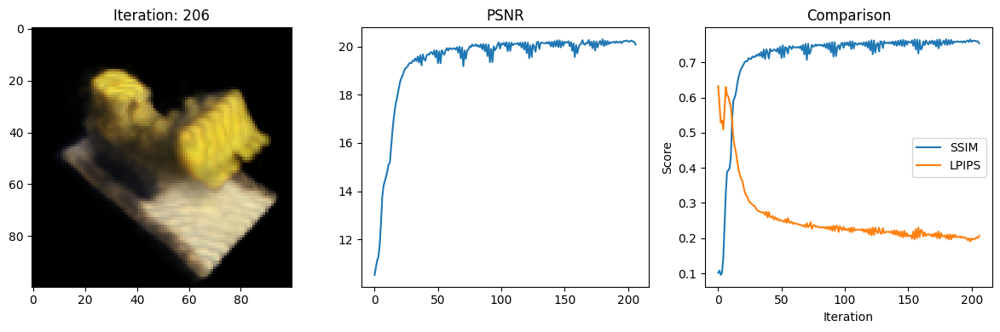

Data saved to: metrics.csv
207 9.270702600479126 secs per iter
Iteration: 207,PSNR: 20.161760330200195, SSIM: 0.7598006968448918, LPIPS: 0.2000669538974762


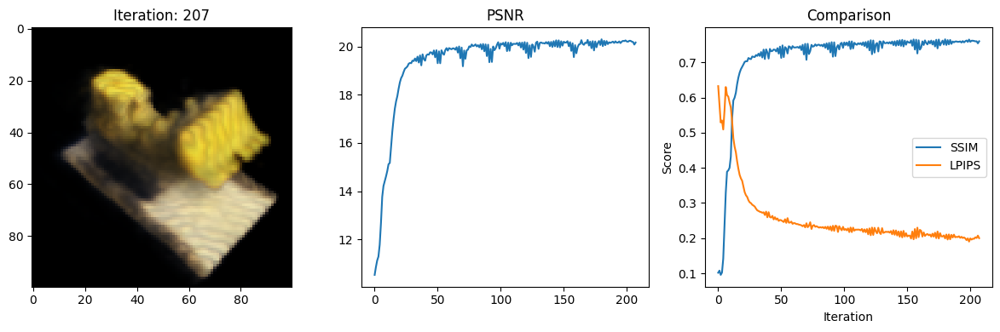

Data saved to: metrics.csv
208 8.975761413574219 secs per iter
Iteration: 208,PSNR: 20.155925750732422, SSIM: 0.7576464122666001, LPIPS: 0.202103853225708


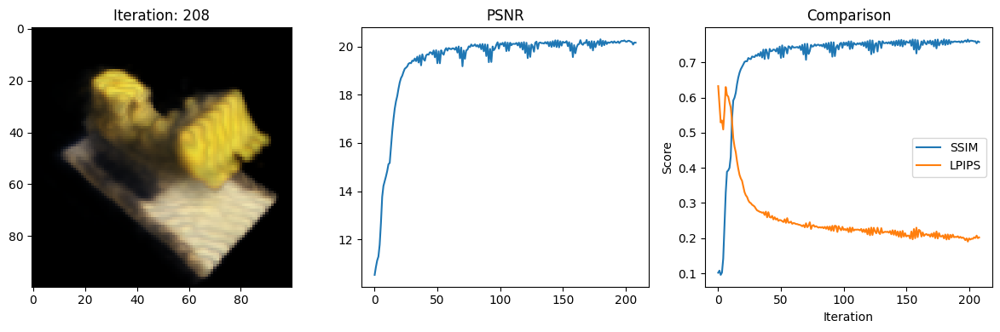

Data saved to: metrics.csv
209 8.965879917144775 secs per iter
Iteration: 209,PSNR: 20.14868927001953, SSIM: 0.756165401617284, LPIPS: 0.20325344800949097


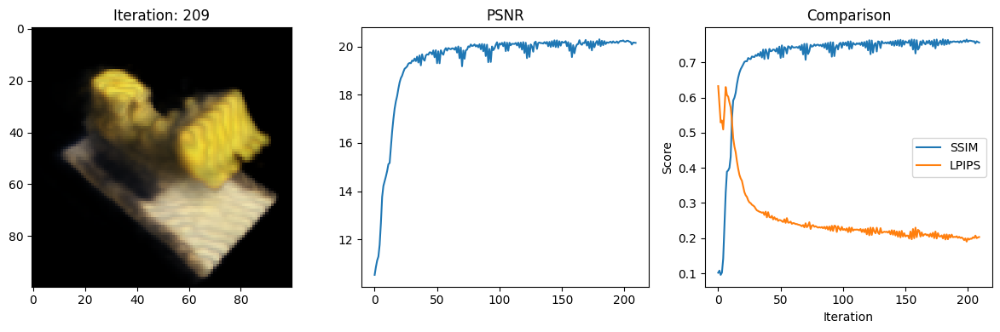

Data saved to: metrics.csv
210 8.948305130004883 secs per iter
Iteration: 210,PSNR: 20.224163055419922, SSIM: 0.7623523790099364, LPIPS: 0.1974182277917862


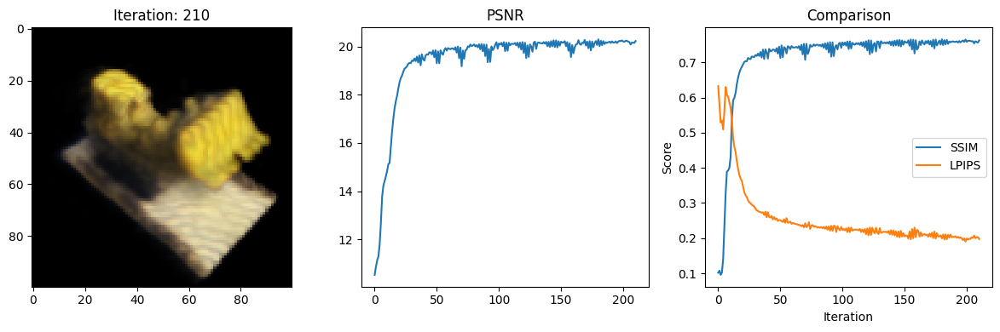

Data saved to: metrics.csv
211 9.224067449569702 secs per iter
Iteration: 211,PSNR: 19.987516403198242, SSIM: 0.748068345722977, LPIPS: 0.20792391896247864


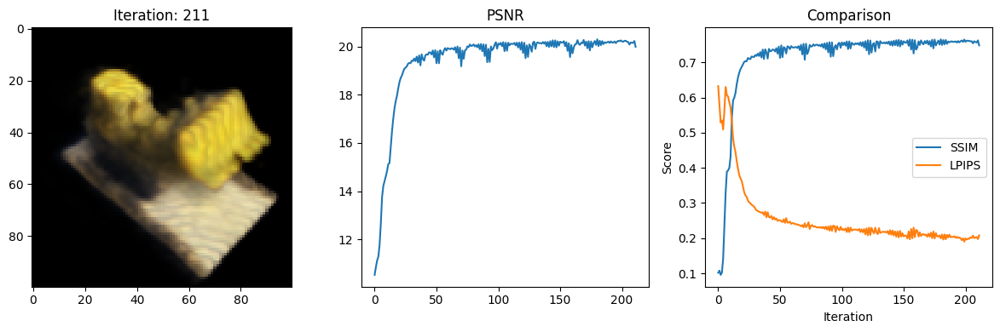

Data saved to: metrics.csv
212 9.411222457885742 secs per iter
Iteration: 212,PSNR: 20.18423843383789, SSIM: 0.7631914559702726, LPIPS: 0.19683121144771576


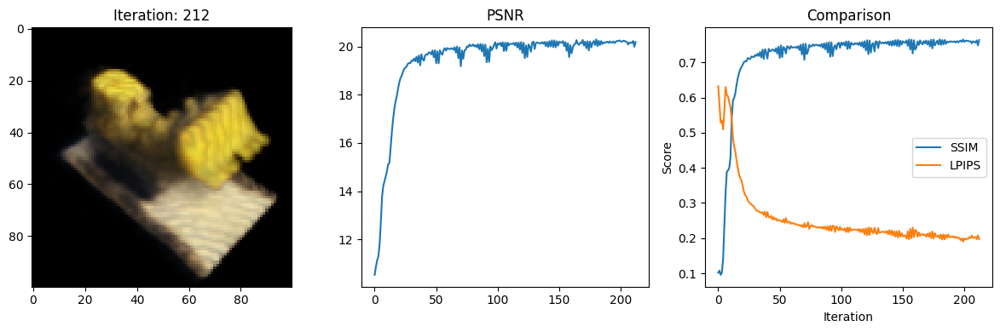

Data saved to: metrics.csv
213 9.098001480102539 secs per iter
Iteration: 213,PSNR: 19.941944122314453, SSIM: 0.7448912600275772, LPIPS: 0.20907756686210632


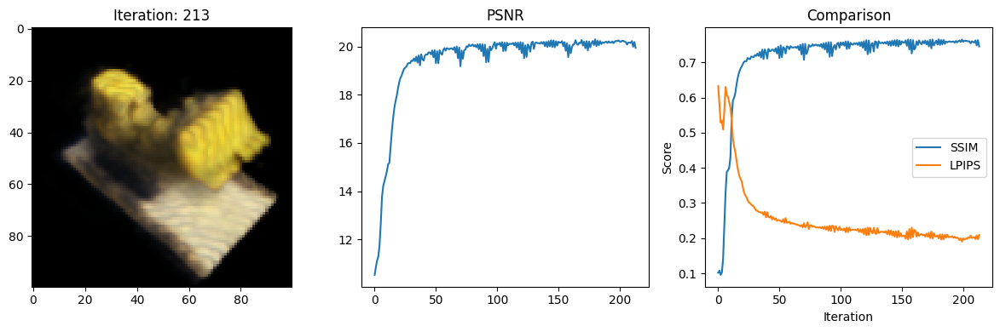

Data saved to: metrics.csv
214 9.004149436950684 secs per iter
Iteration: 214,PSNR: 20.23538589477539, SSIM: 0.7630893813420064, LPIPS: 0.19675590097904205


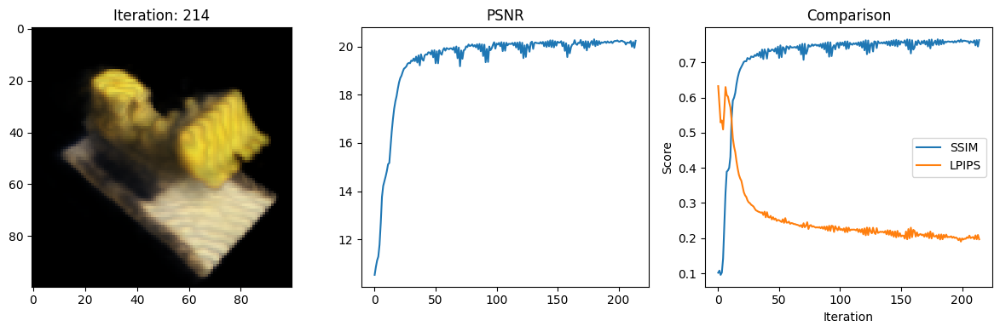

Data saved to: metrics.csv
215 9.135994911193848 secs per iter
Iteration: 215,PSNR: 20.124954223632812, SSIM: 0.7552866489710245, LPIPS: 0.20363761484622955


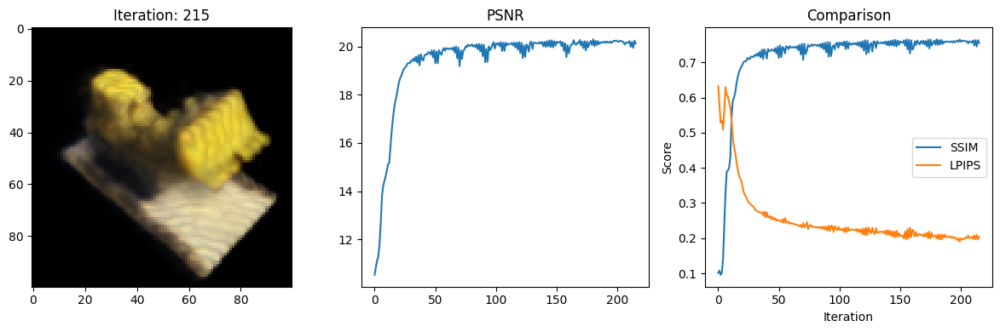

Data saved to: metrics.csv
216 9.041105270385742 secs per iter
Iteration: 216,PSNR: 20.0274658203125, SSIM: 0.7515922085519948, LPIPS: 0.20785559713840485


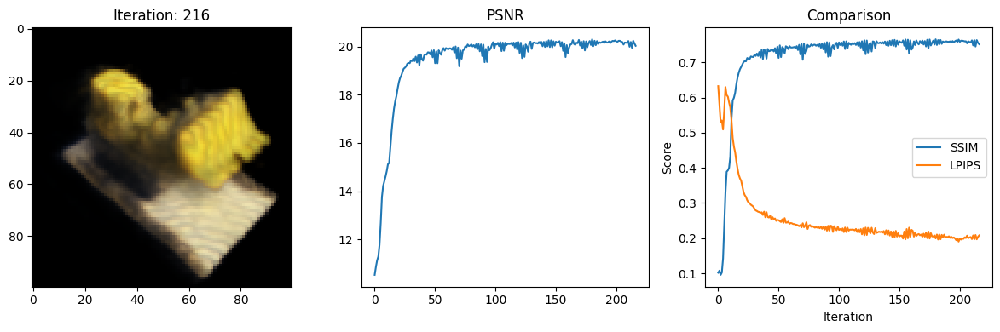

Data saved to: metrics.csv
217 9.059184789657593 secs per iter
Iteration: 217,PSNR: 20.169559478759766, SSIM: 0.760534497058166, LPIPS: 0.20157381892204285


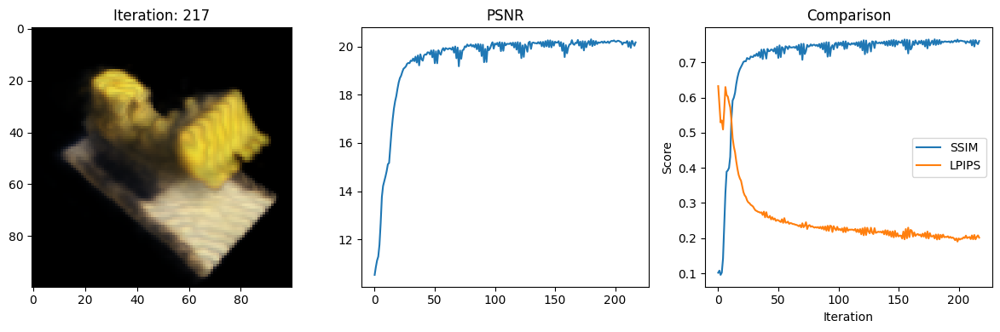

Data saved to: metrics.csv
218 8.844916820526123 secs per iter
Iteration: 218,PSNR: 19.683273315429688, SSIM: 0.734811526392058, LPIPS: 0.21892501413822174


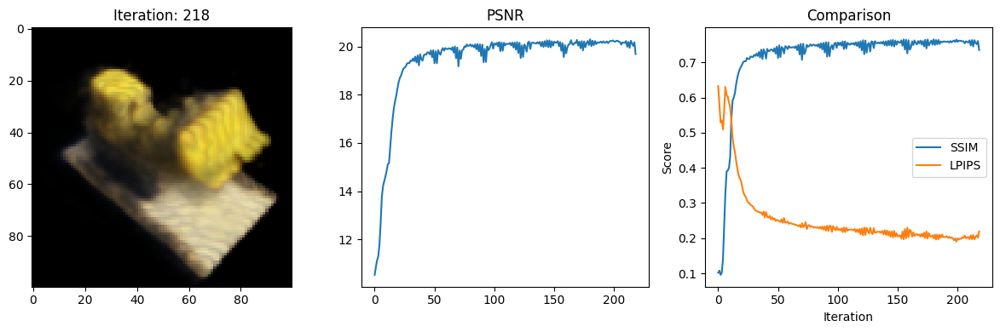

Data saved to: metrics.csv
219 9.073155641555786 secs per iter
Iteration: 219,PSNR: 20.129384994506836, SSIM: 0.7622540932732004, LPIPS: 0.19951918721199036


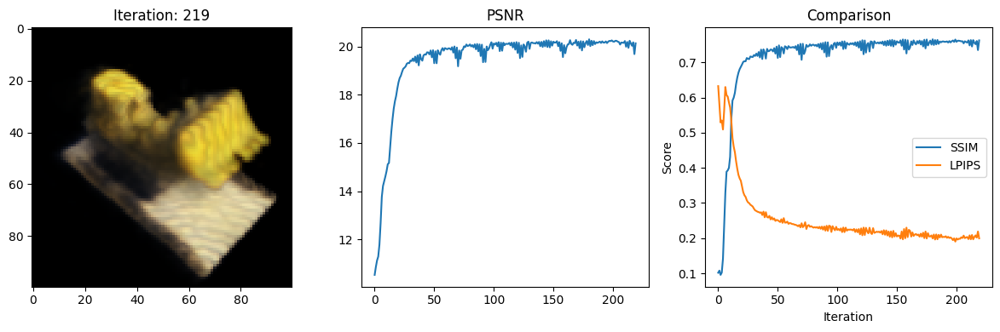

Data saved to: metrics.csv
220 8.881328105926514 secs per iter
Iteration: 220,PSNR: 19.50286865234375, SSIM: 0.7238736678907554, LPIPS: 0.2258916199207306


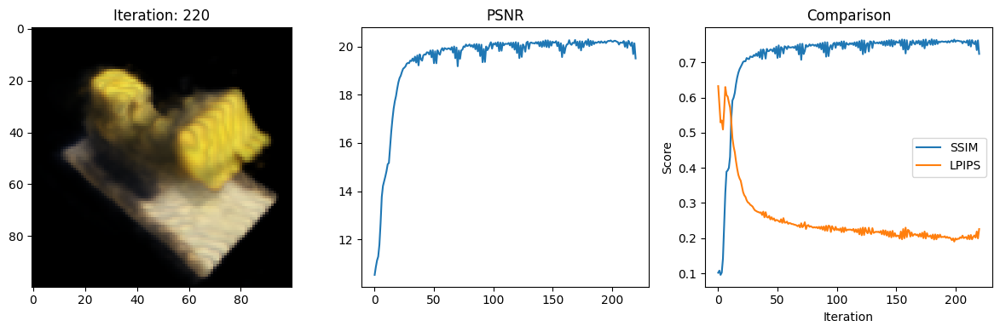

Data saved to: metrics.csv
221 8.896465539932251 secs per iter
Iteration: 221,PSNR: 20.07105827331543, SSIM: 0.7637246837276394, LPIPS: 0.19877327978610992


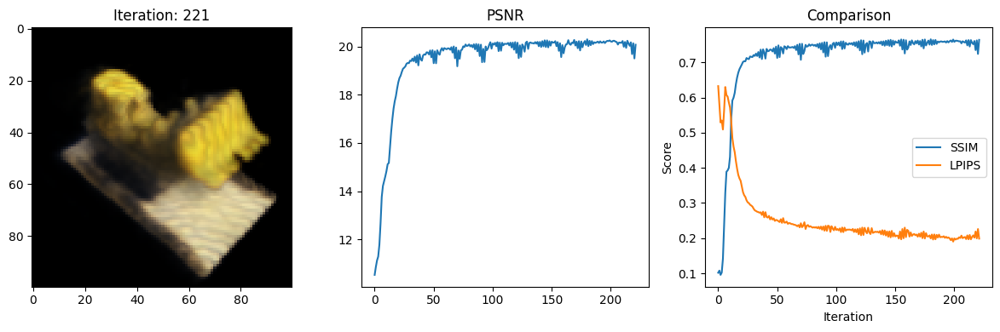

Data saved to: metrics.csv
222 8.814135313034058 secs per iter
Iteration: 222,PSNR: 19.401086807250977, SSIM: 0.7206041171613945, LPIPS: 0.22290275990962982


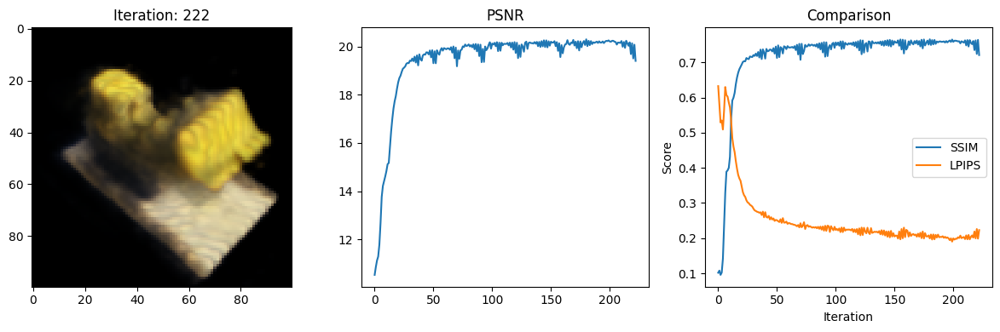

Data saved to: metrics.csv
223 9.000927448272705 secs per iter
Iteration: 223,PSNR: 20.095836639404297, SSIM: 0.7675813419456791, LPIPS: 0.19093699753284454


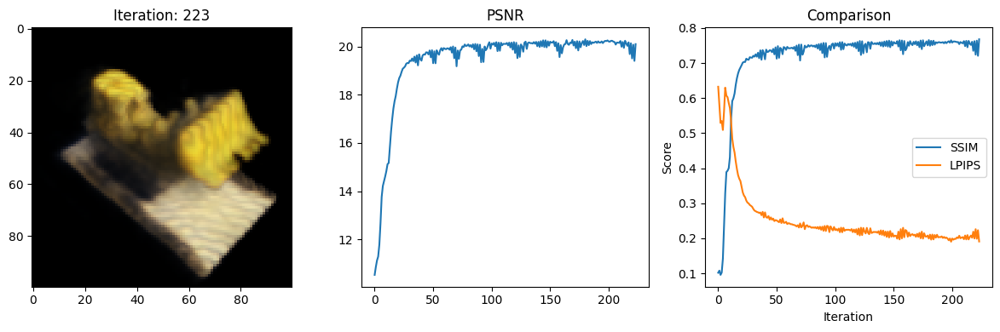

Data saved to: metrics.csv
224 8.942755222320557 secs per iter
Iteration: 224,PSNR: 19.845468521118164, SSIM: 0.7414260034857634, LPIPS: 0.2093420922756195


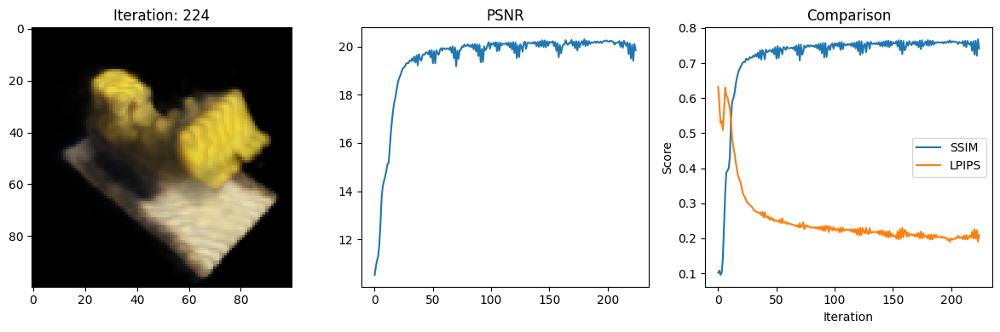

Data saved to: metrics.csv
225 8.887823104858398 secs per iter
Iteration: 225,PSNR: 20.17656135559082, SSIM: 0.7529517177925946, LPIPS: 0.19808900356292725


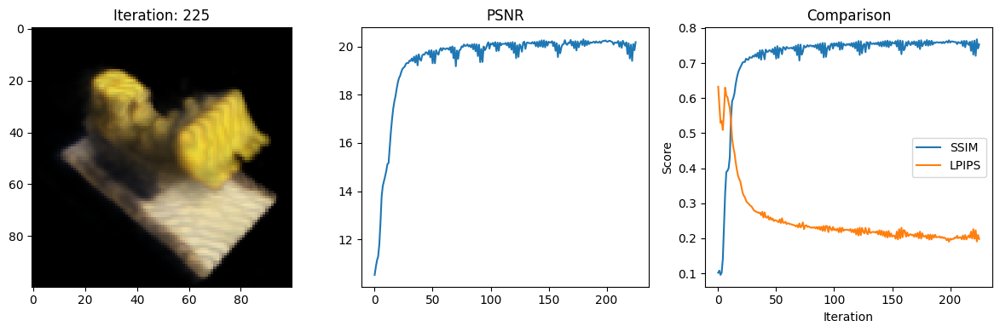

Data saved to: metrics.csv
226 8.856046915054321 secs per iter
Iteration: 226,PSNR: 20.06406021118164, SSIM: 0.7645731908821606, LPIPS: 0.1959143429994583


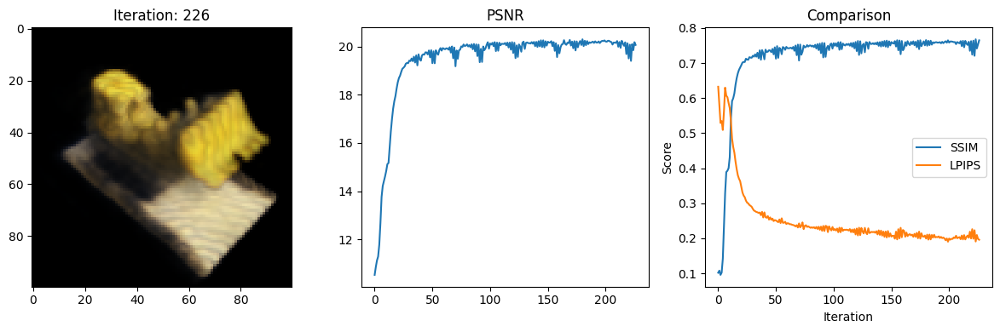

Data saved to: metrics.csv
227 8.906585693359375 secs per iter
Iteration: 227,PSNR: 19.944738388061523, SSIM: 0.7438285884985388, LPIPS: 0.2041841447353363


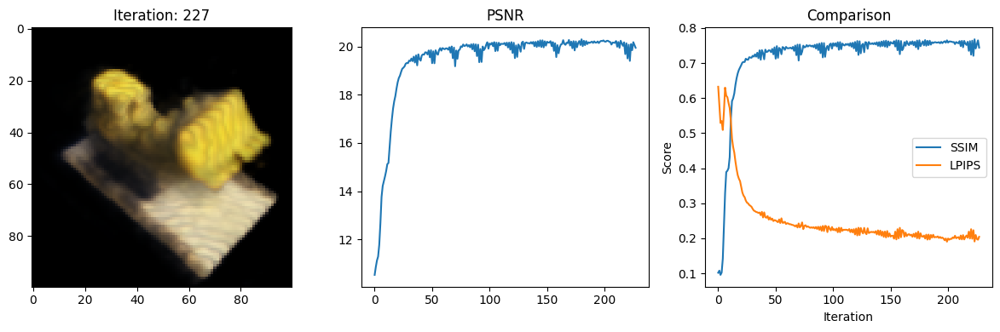

Data saved to: metrics.csv
228 9.128360748291016 secs per iter
Iteration: 228,PSNR: 20.324020385742188, SSIM: 0.7635421026218685, LPIPS: 0.19907525181770325


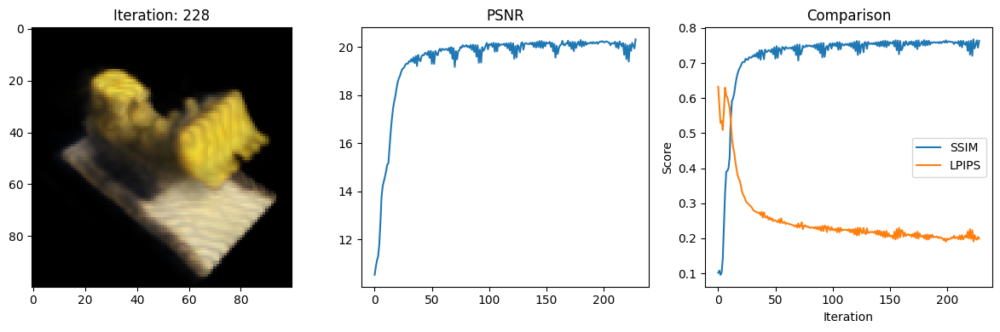

Data saved to: metrics.csv
229 8.831589460372925 secs per iter
Iteration: 229,PSNR: 20.06597328186035, SSIM: 0.7610455547480136, LPIPS: 0.19679176807403564


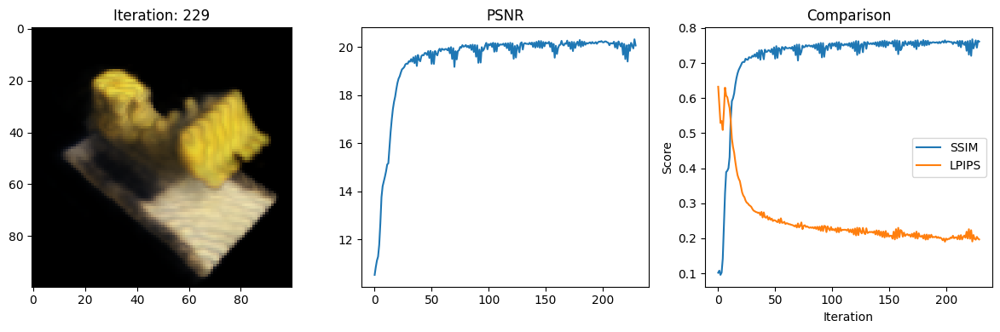

Data saved to: metrics.csv
230 8.78428030014038 secs per iter
Iteration: 230,PSNR: 19.936372756958008, SSIM: 0.7395921967091139, LPIPS: 0.2090701311826706


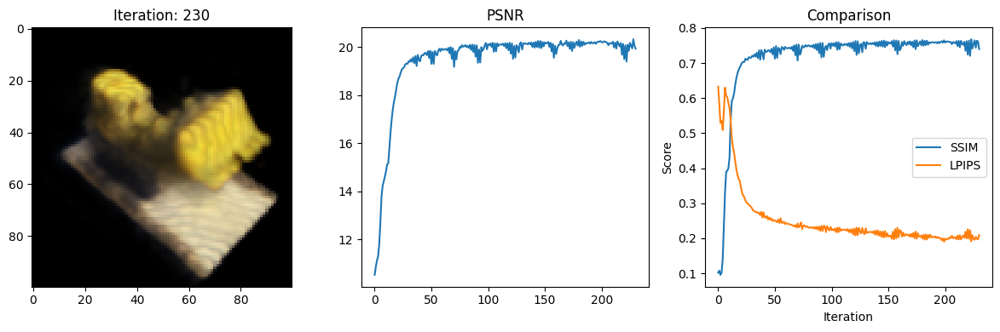

Data saved to: metrics.csv
231 8.850550651550293 secs per iter
Iteration: 231,PSNR: 20.20893669128418, SSIM: 0.7630497571392656, LPIPS: 0.19942504167556763


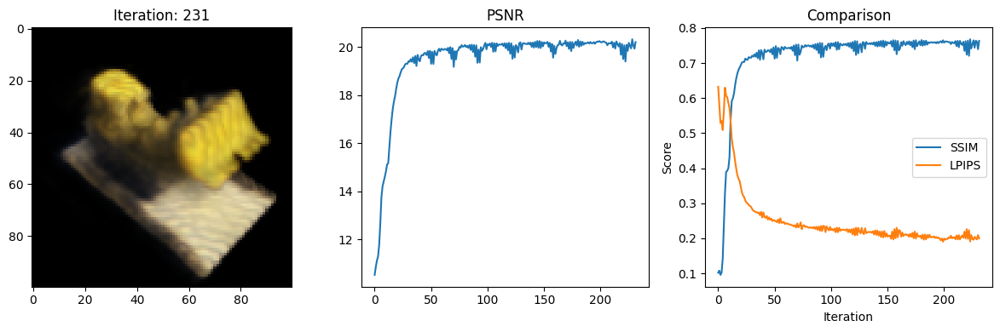

Data saved to: metrics.csv
232 8.908304929733276 secs per iter
Iteration: 232,PSNR: 20.12794303894043, SSIM: 0.7592640004427631, LPIPS: 0.19973549246788025


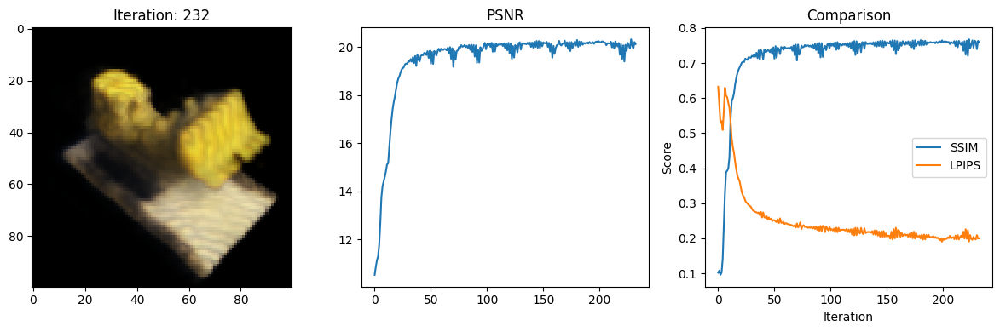

Data saved to: metrics.csv
233 8.893641233444214 secs per iter
Iteration: 233,PSNR: 19.973596572875977, SSIM: 0.7421597458658091, LPIPS: 0.20948810875415802


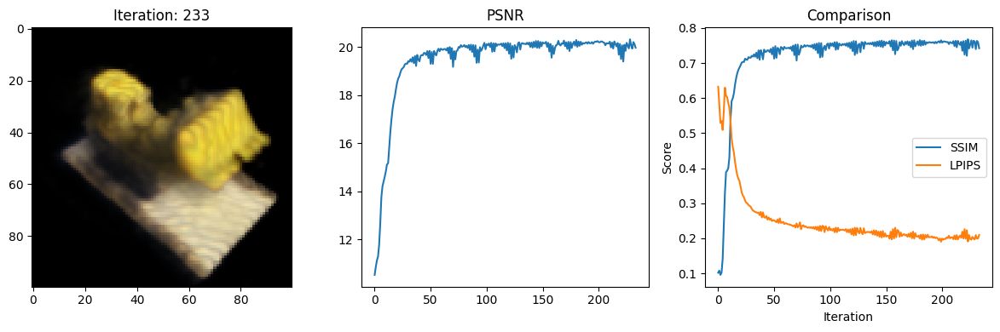

Data saved to: metrics.csv
234 9.0292329788208 secs per iter
Iteration: 234,PSNR: 20.18716812133789, SSIM: 0.7642836849228324, LPIPS: 0.19729048013687134


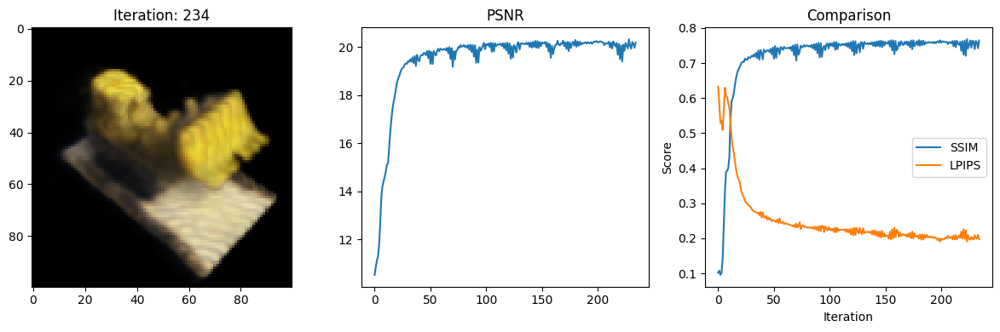

Data saved to: metrics.csv
235 8.894462585449219 secs per iter
Iteration: 235,PSNR: 20.20406723022461, SSIM: 0.75907184226964, LPIPS: 0.19752708077430725


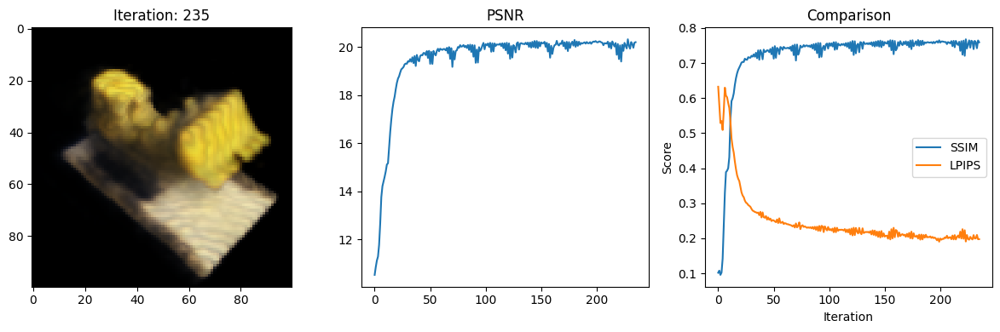

Data saved to: metrics.csv
236 8.913164377212524 secs per iter
Iteration: 236,PSNR: 20.244739532470703, SSIM: 0.7577133072777981, LPIPS: 0.19914691150188446


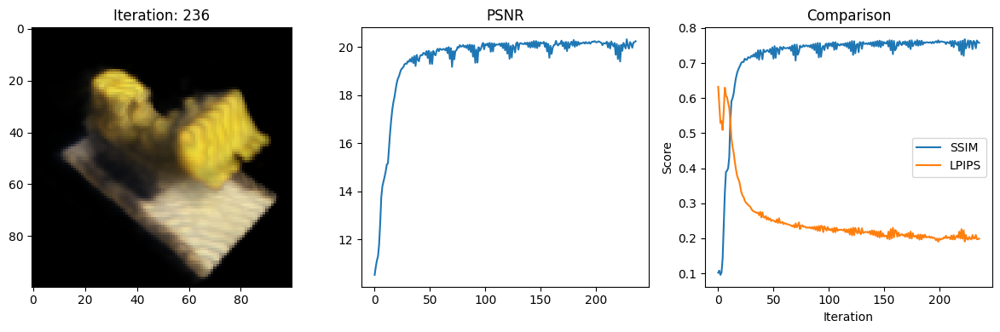

Data saved to: metrics.csv
237 8.94743800163269 secs per iter
Iteration: 237,PSNR: 20.209182739257812, SSIM: 0.7637610953886665, LPIPS: 0.19391019642353058


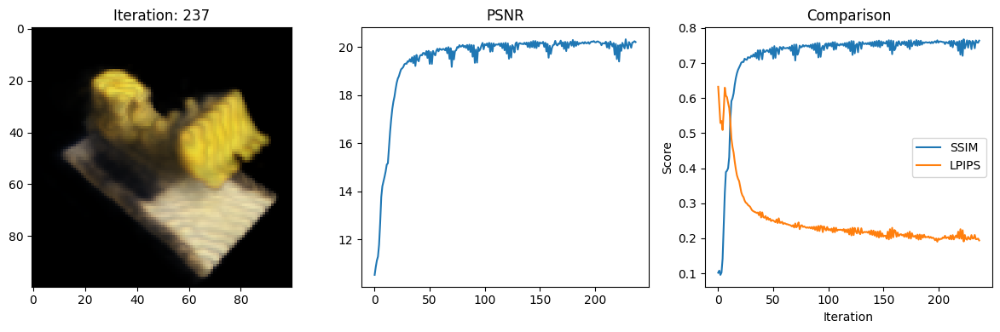

Data saved to: metrics.csv
238 9.188577890396118 secs per iter
Iteration: 238,PSNR: 20.19083595275879, SSIM: 0.7554533201069434, LPIPS: 0.20063906908035278


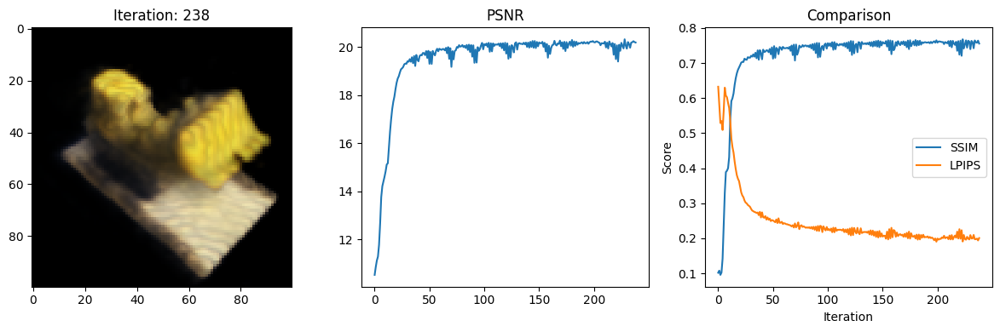

Data saved to: metrics.csv
239 9.056628465652466 secs per iter
Iteration: 239,PSNR: 20.30214500427246, SSIM: 0.7657984170674609, LPIPS: 0.19458654522895813


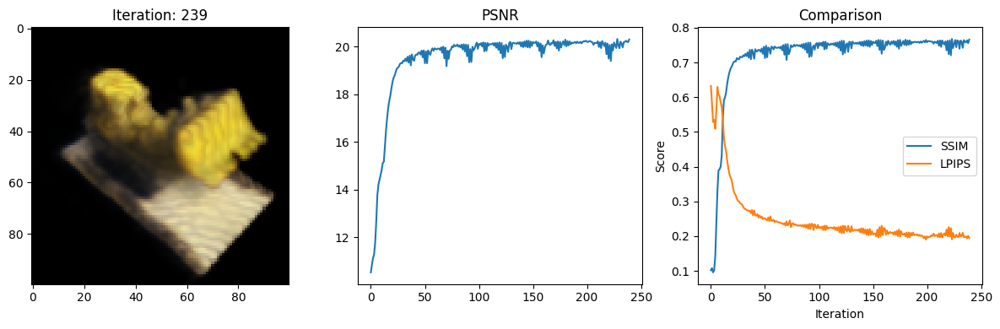

Data saved to: metrics.csv
240 9.0800039768219 secs per iter
Iteration: 240,PSNR: 20.062623977661133, SSIM: 0.7521257412638732, LPIPS: 0.20185258984565735


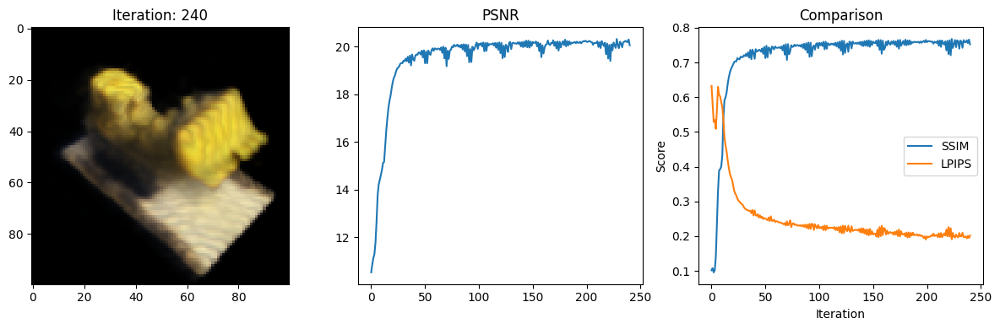

Data saved to: metrics.csv
241 9.094850540161133 secs per iter
Iteration: 241,PSNR: 20.300626754760742, SSIM: 0.764372121325713, LPIPS: 0.19266267120838165


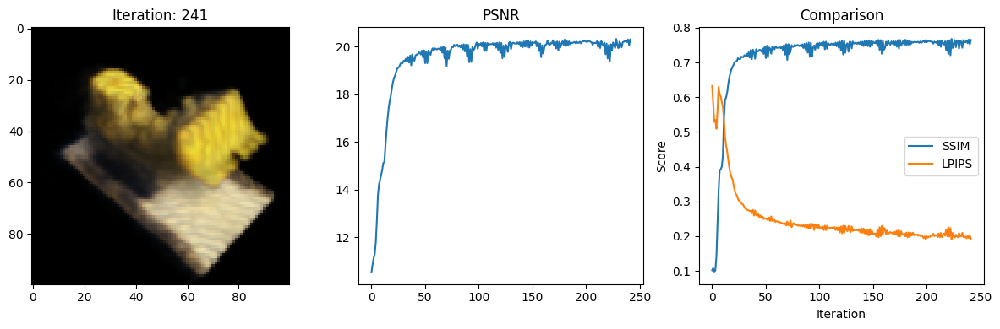

Data saved to: metrics.csv
242 8.994487285614014 secs per iter
Iteration: 242,PSNR: 20.036951065063477, SSIM: 0.7518465644442527, LPIPS: 0.20227119326591492


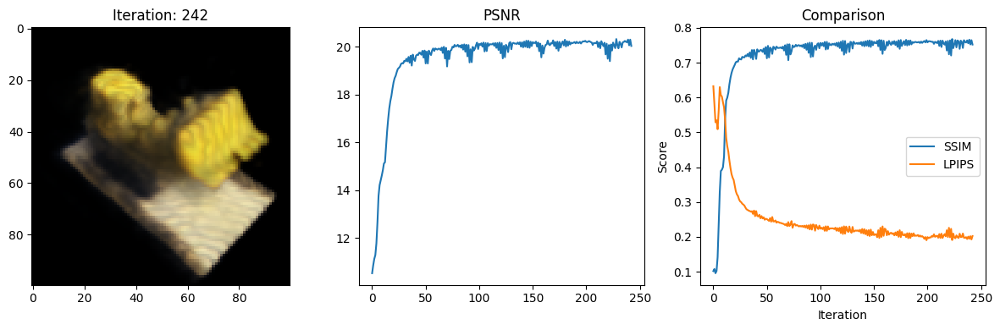

Data saved to: metrics.csv
243 9.239557266235352 secs per iter
Iteration: 243,PSNR: 20.26194190979004, SSIM: 0.7652477167816945, LPIPS: 0.19053205847740173


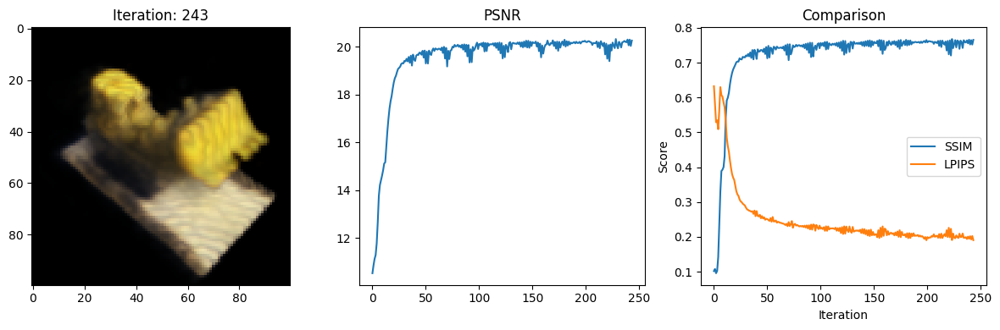

Data saved to: metrics.csv
244 9.414387941360474 secs per iter
Iteration: 244,PSNR: 20.069477081298828, SSIM: 0.7512051995029813, LPIPS: 0.2020392268896103


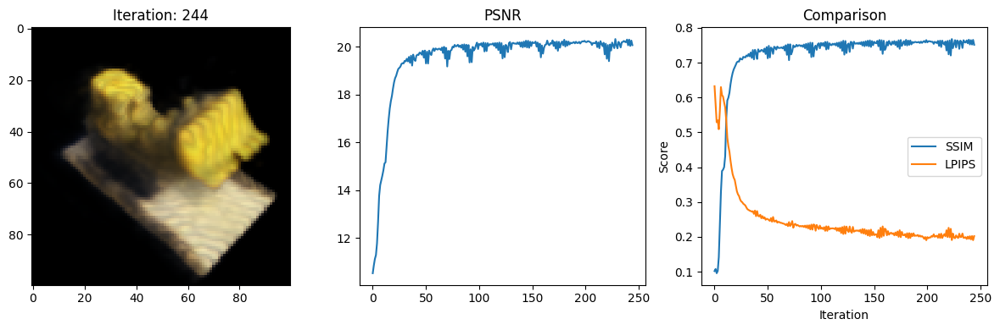

Data saved to: metrics.csv
245 9.03831696510315 secs per iter
Iteration: 245,PSNR: 20.250579833984375, SSIM: 0.7644972229149326, LPIPS: 0.19078387320041656


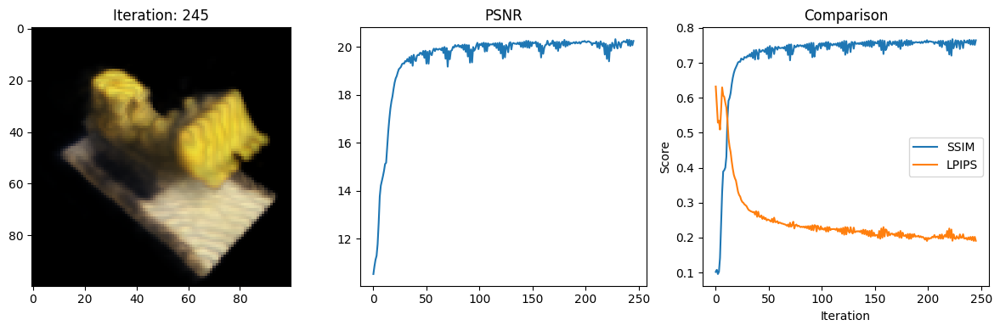

Data saved to: metrics.csv
246 9.020674705505371 secs per iter
Iteration: 246,PSNR: 20.147855758666992, SSIM: 0.7550103116341926, LPIPS: 0.20006036758422852


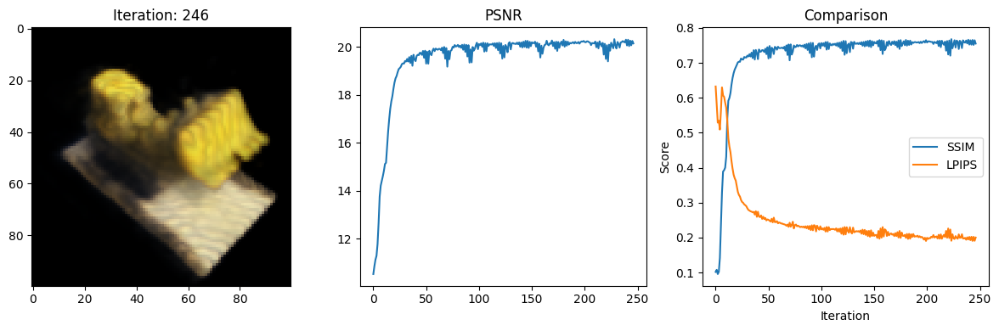

Data saved to: metrics.csv
247 9.274152994155884 secs per iter
Iteration: 247,PSNR: 20.26963996887207, SSIM: 0.7651814557455632, LPIPS: 0.18909552693367004


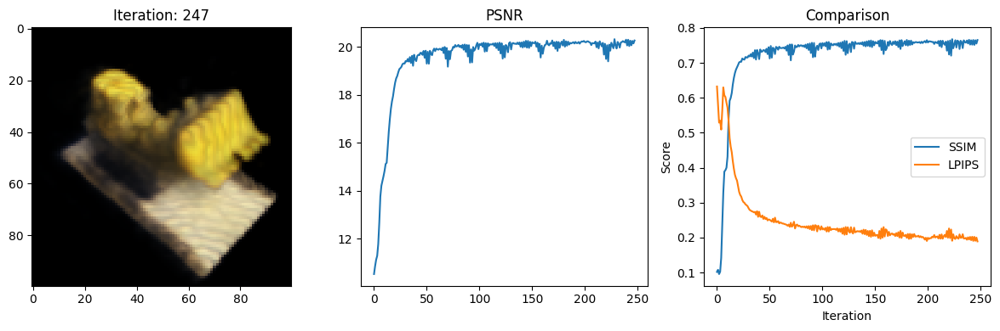

Data saved to: metrics.csv
248 9.114451169967651 secs per iter
Iteration: 248,PSNR: 20.103328704833984, SSIM: 0.7554687930789443, LPIPS: 0.20019999146461487


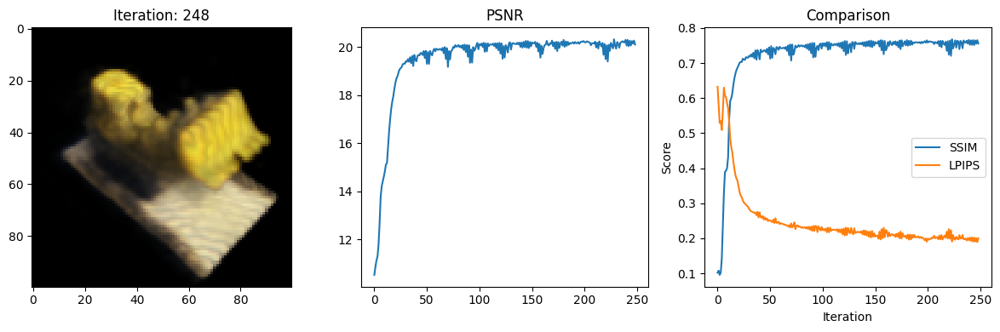

Data saved to: metrics.csv
249 9.104285478591919 secs per iter
Iteration: 249,PSNR: 20.21330451965332, SSIM: 0.760056831677257, LPIPS: 0.19252614676952362


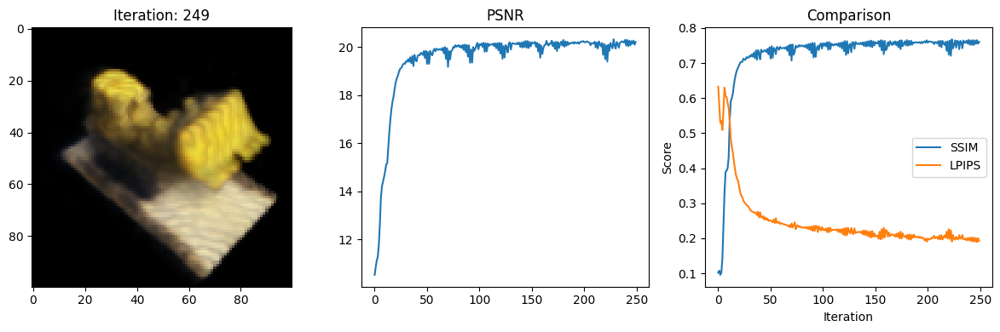

Data saved to: metrics.csv
250 9.027104377746582 secs per iter
Iteration: 250,PSNR: 20.267932891845703, SSIM: 0.7627531416848079, LPIPS: 0.1963290572166443


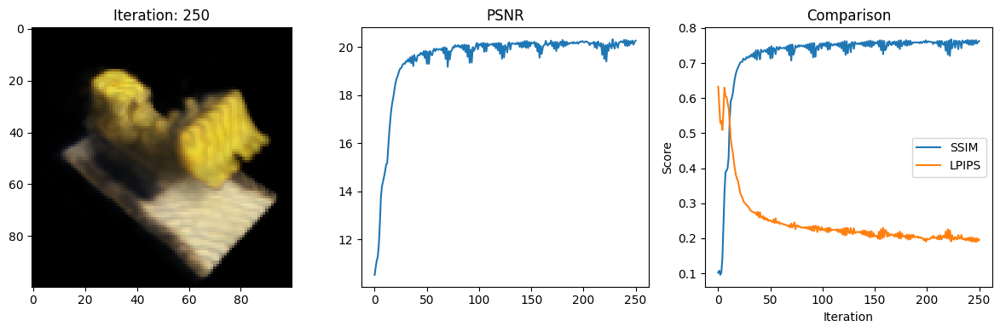

Data saved to: metrics.csv
251 9.206637144088745 secs per iter
Iteration: 251,PSNR: 20.14162826538086, SSIM: 0.7558025370618932, LPIPS: 0.1941288858652115


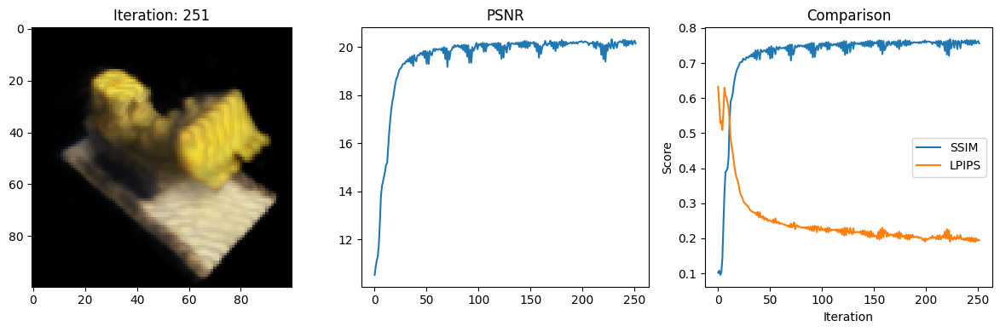

Data saved to: metrics.csv
252 9.066349744796753 secs per iter
Iteration: 252,PSNR: 20.338787078857422, SSIM: 0.765186472594307, LPIPS: 0.19385862350463867


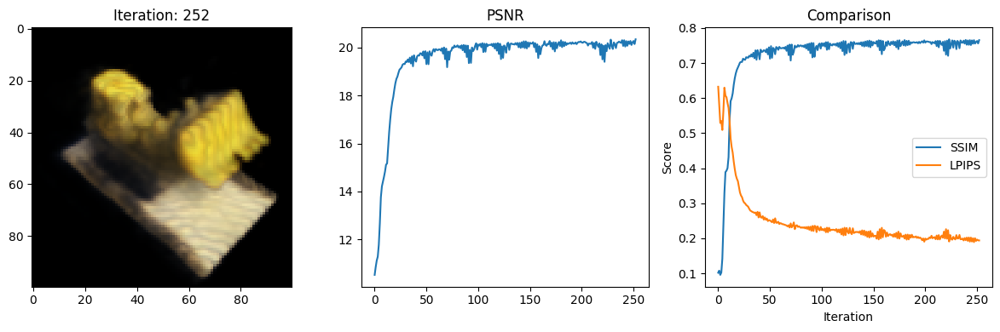

Data saved to: metrics.csv
253 9.164421796798706 secs per iter
Iteration: 253,PSNR: 20.096872329711914, SSIM: 0.7532507426869683, LPIPS: 0.19694262742996216


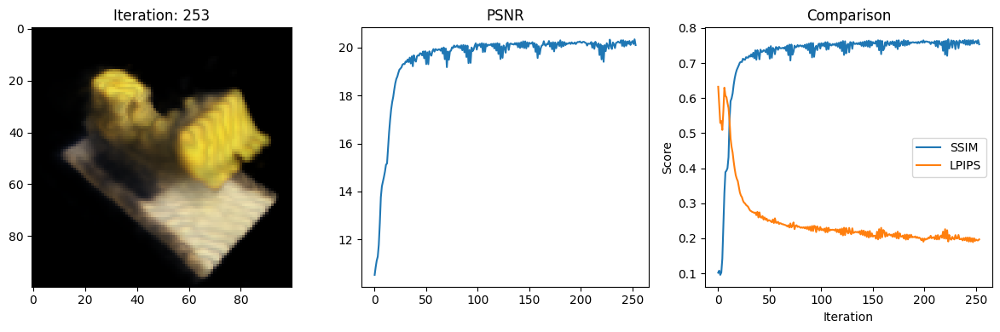

Data saved to: metrics.csv
254 9.032668352127075 secs per iter
Iteration: 254,PSNR: 20.32309341430664, SSIM: 0.7666057006450443, LPIPS: 0.19216668605804443


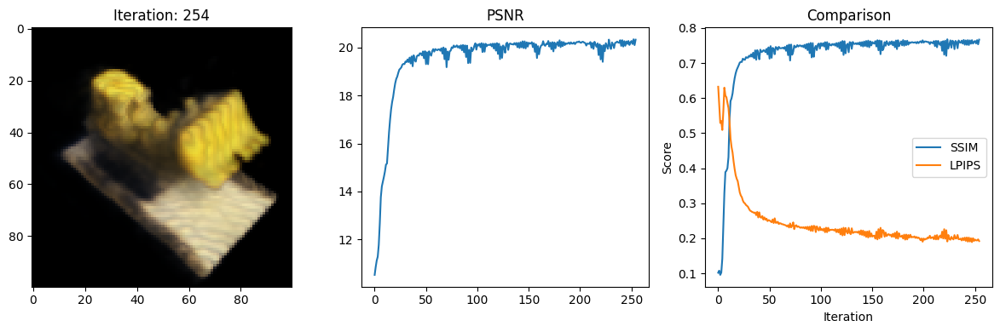

Data saved to: metrics.csv
255 9.29737138748169 secs per iter
Iteration: 255,PSNR: 20.093460083007812, SSIM: 0.751572163720642, LPIPS: 0.1973714679479599


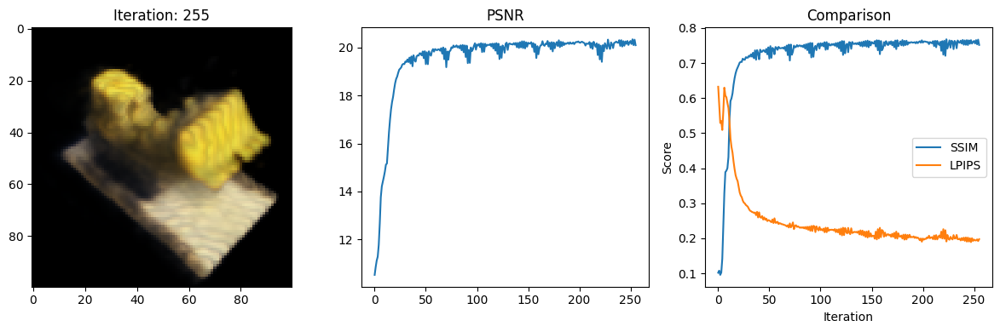

Data saved to: metrics.csv
256 9.122731447219849 secs per iter
Iteration: 256,PSNR: 20.318756103515625, SSIM: 0.7658410775652703, LPIPS: 0.19025003910064697


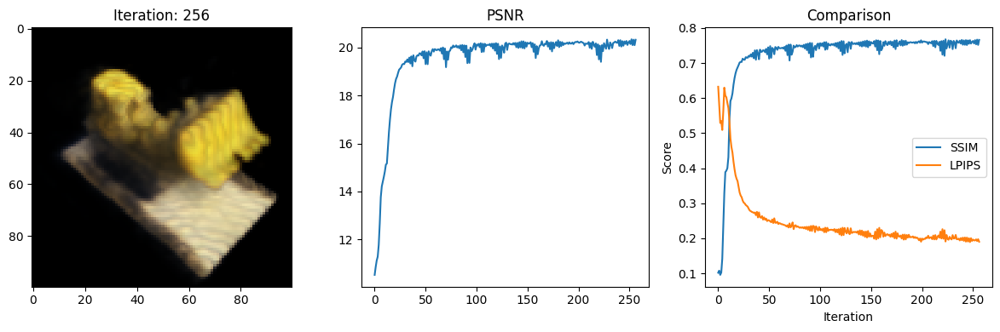

Data saved to: metrics.csv
257 9.074820756912231 secs per iter
Iteration: 257,PSNR: 20.094493865966797, SSIM: 0.7510530634623581, LPIPS: 0.1982460618019104


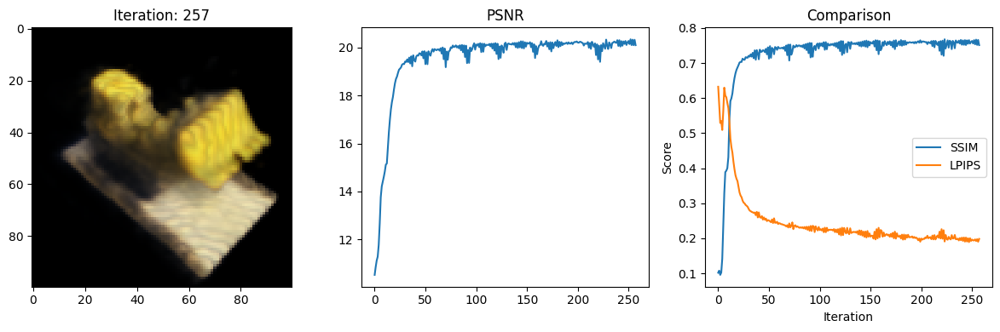

Data saved to: metrics.csv
258 9.047578811645508 secs per iter
Iteration: 258,PSNR: 20.306148529052734, SSIM: 0.7677542013071267, LPIPS: 0.18750344216823578


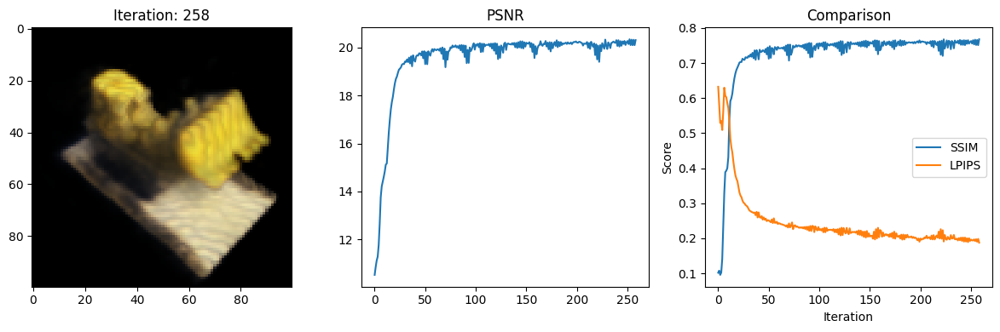

Data saved to: metrics.csv
259 9.253451347351074 secs per iter
Iteration: 259,PSNR: 19.932435989379883, SSIM: 0.7413170923917666, LPIPS: 0.20453959703445435


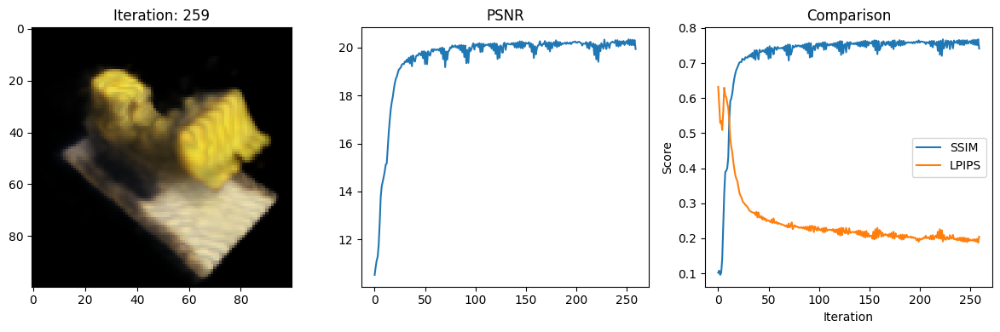

Data saved to: metrics.csv
260 9.844379425048828 secs per iter
Iteration: 260,PSNR: 20.264476776123047, SSIM: 0.7696677611924967, LPIPS: 0.1857646107673645


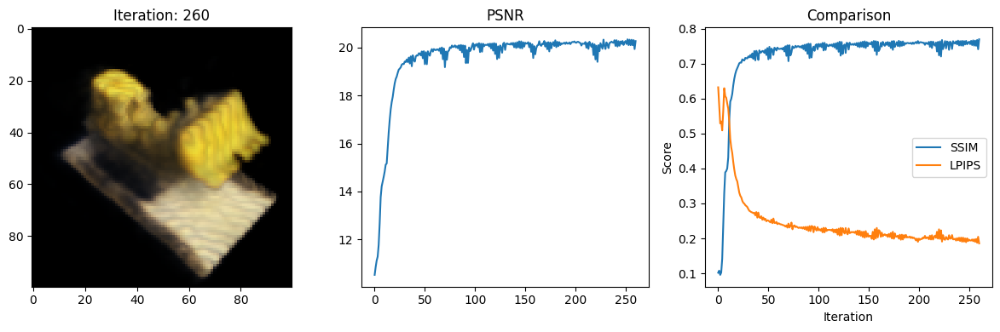

Data saved to: metrics.csv
261 9.149216651916504 secs per iter
Iteration: 261,PSNR: 19.776887893676758, SSIM: 0.7319605064300901, LPIPS: 0.2087281346321106


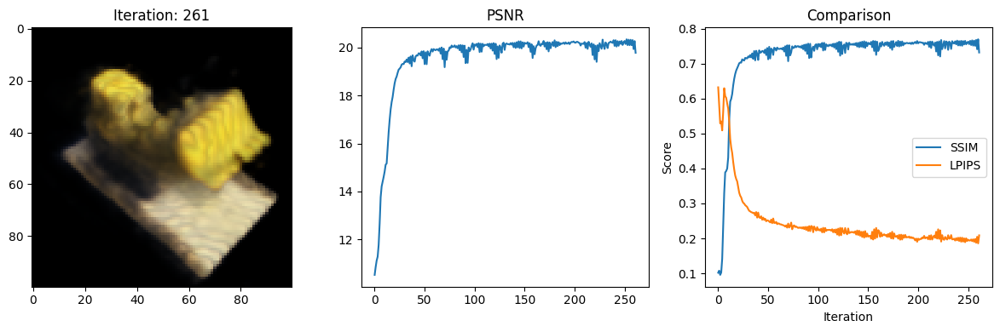

Data saved to: metrics.csv
262 9.094769716262817 secs per iter
Iteration: 262,PSNR: 20.21385383605957, SSIM: 0.7694487917480831, LPIPS: 0.18736693263053894


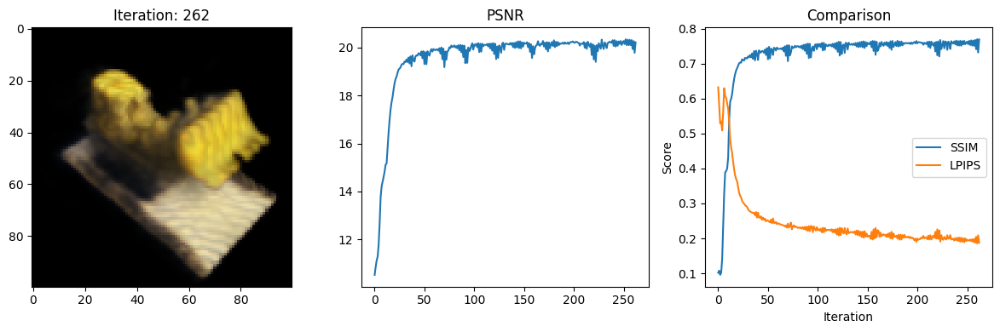

Data saved to: metrics.csv
263 9.30642318725586 secs per iter
Iteration: 263,PSNR: 19.732776641845703, SSIM: 0.7330075205321144, LPIPS: 0.20697978138923645


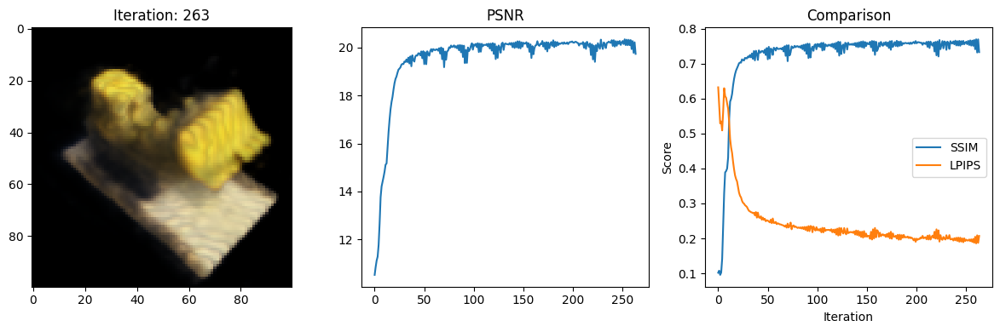

Data saved to: metrics.csv
264 9.111209154129028 secs per iter
Iteration: 264,PSNR: 20.306133270263672, SSIM: 0.7670375452546261, LPIPS: 0.18463051319122314


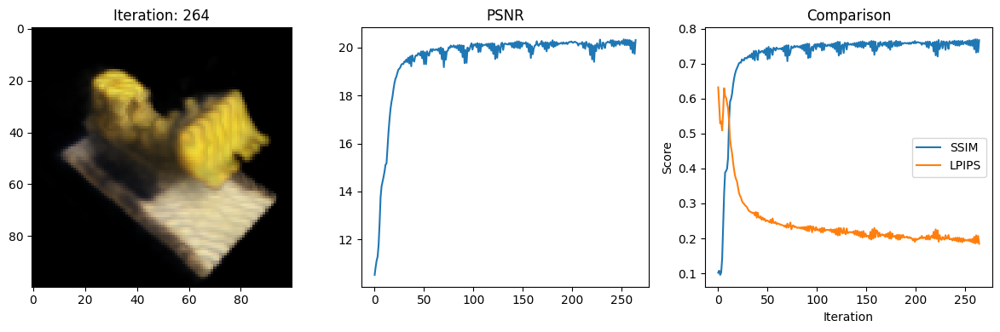

Data saved to: metrics.csv
265 9.089490175247192 secs per iter
Iteration: 265,PSNR: 20.15880012512207, SSIM: 0.7622474731470491, LPIPS: 0.19422221183776855


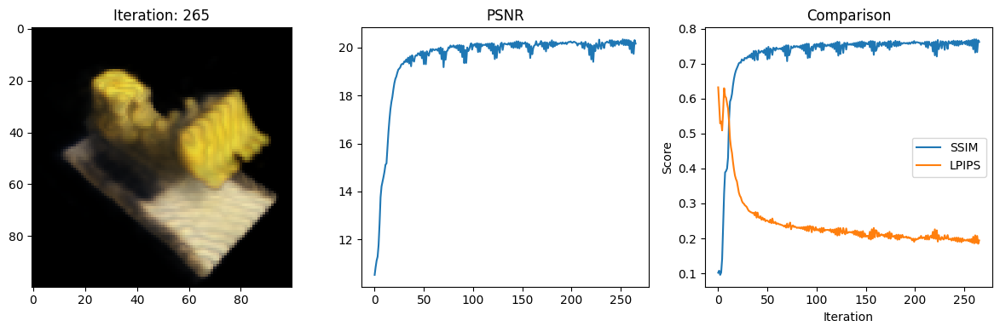

Data saved to: metrics.csv
266 9.112751483917236 secs per iter
Iteration: 266,PSNR: 19.718828201293945, SSIM: 0.7273779757455733, LPIPS: 0.20033475756645203


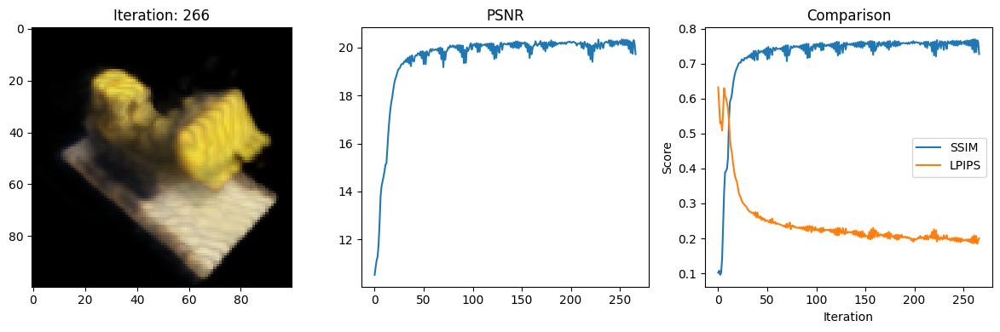

Data saved to: metrics.csv
267 9.159834146499634 secs per iter
Iteration: 267,PSNR: 20.178010940551758, SSIM: 0.7657549599280192, LPIPS: 0.1967761069536209


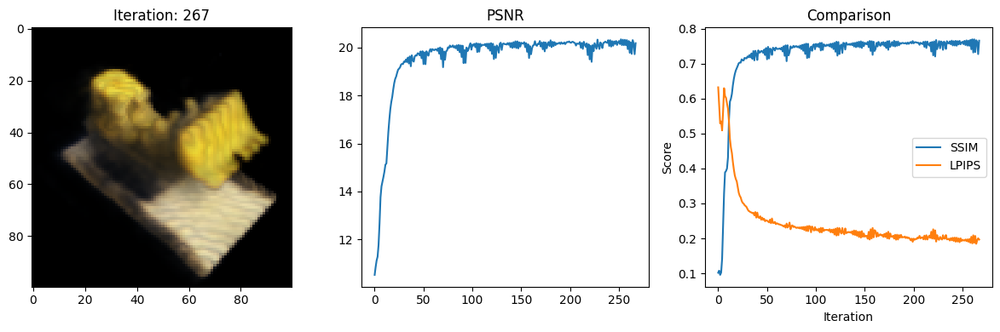

Data saved to: metrics.csv
268 9.214845180511475 secs per iter
Iteration: 268,PSNR: 20.123130798339844, SSIM: 0.7588388151942634, LPIPS: 0.1948440819978714


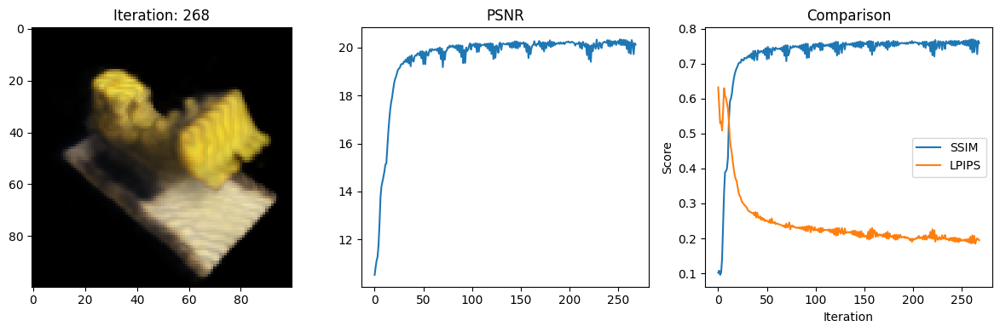

Data saved to: metrics.csv
269 9.112693786621094 secs per iter
Iteration: 269,PSNR: 19.971717834472656, SSIM: 0.736636516810384, LPIPS: 0.20457808673381805


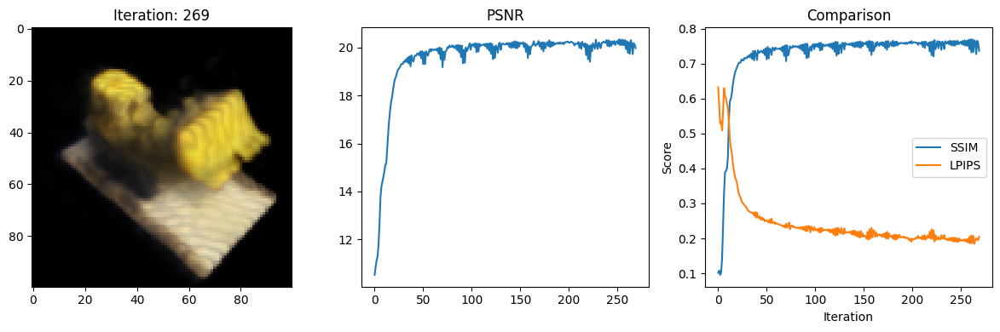

Data saved to: metrics.csv
270 9.124553918838501 secs per iter
Iteration: 270,PSNR: 20.165790557861328, SSIM: 0.7644766565168938, LPIPS: 0.19579127430915833


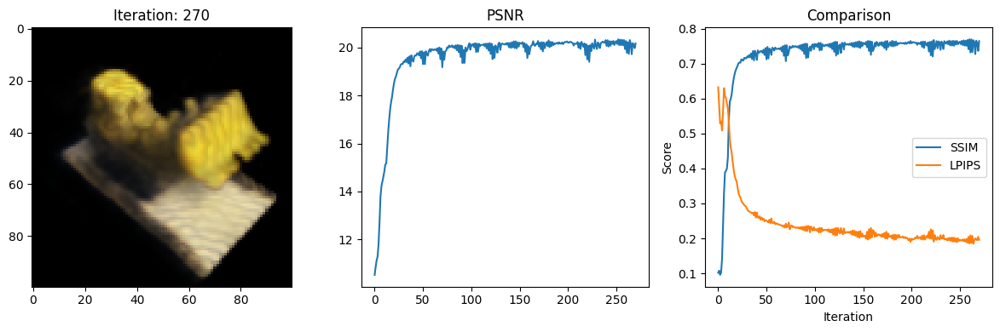

Data saved to: metrics.csv
271 9.063541650772095 secs per iter
Iteration: 271,PSNR: 20.233673095703125, SSIM: 0.7615761590698127, LPIPS: 0.19418677687644958


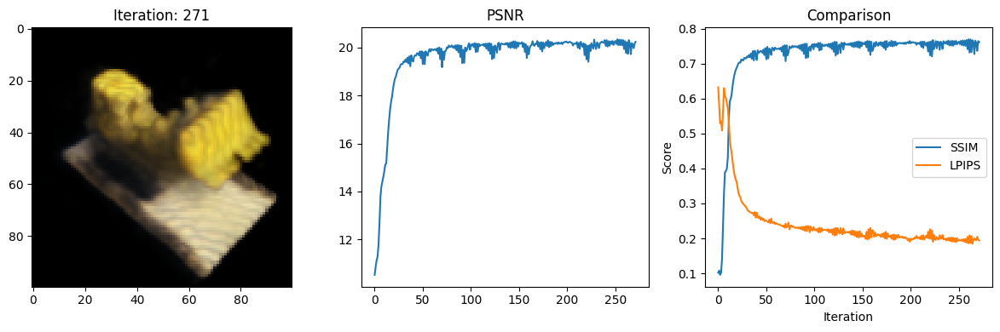

Data saved to: metrics.csv
272 9.226275205612183 secs per iter
Iteration: 272,PSNR: 20.130191802978516, SSIM: 0.7500122575964944, LPIPS: 0.19750085473060608


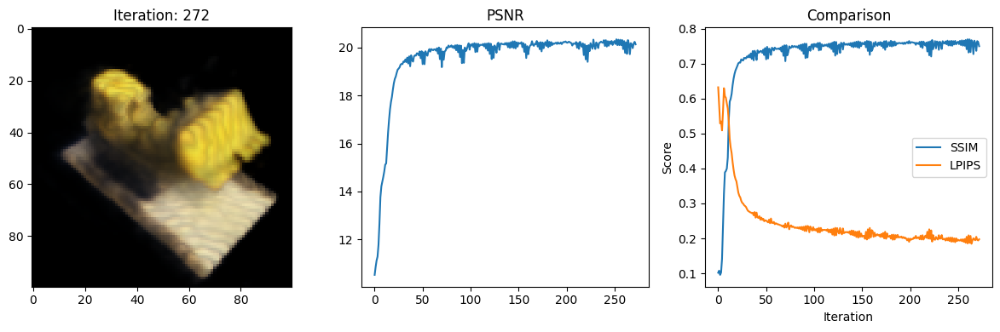

Data saved to: metrics.csv
273 9.144296646118164 secs per iter
Iteration: 273,PSNR: 20.247892379760742, SSIM: 0.7672311159768387, LPIPS: 0.1920967400074005


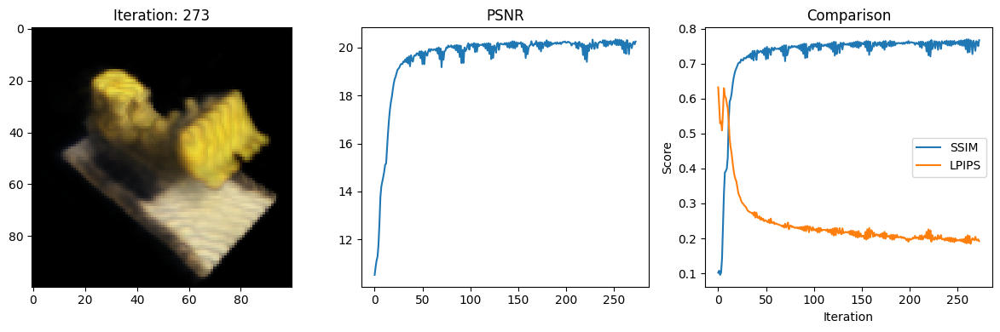

Data saved to: metrics.csv
274 9.092059135437012 secs per iter
Iteration: 274,PSNR: 20.18385887145996, SSIM: 0.756138084082695, LPIPS: 0.19681239128112793


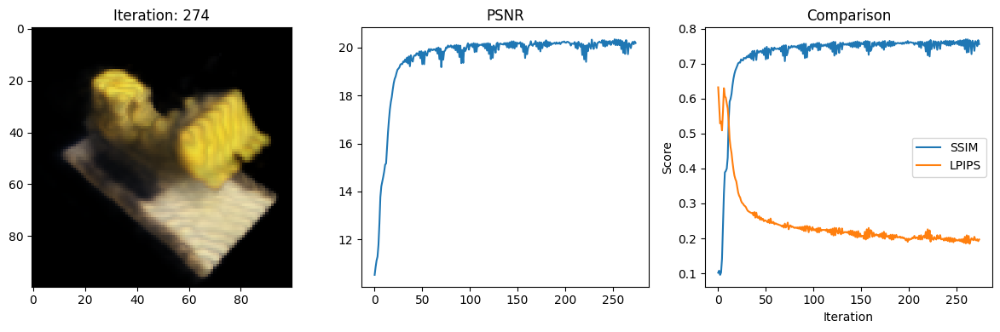

Data saved to: metrics.csv
275 9.330987453460693 secs per iter
Iteration: 275,PSNR: 20.379051208496094, SSIM: 0.7641411951596758, LPIPS: 0.19165775179862976


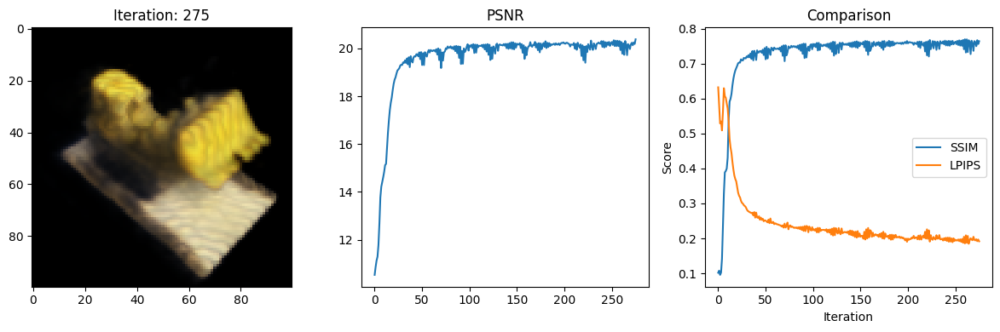

Data saved to: metrics.csv
276 9.273975133895874 secs per iter
Iteration: 276,PSNR: 20.213626861572266, SSIM: 0.7626533301738112, LPIPS: 0.19275179505348206


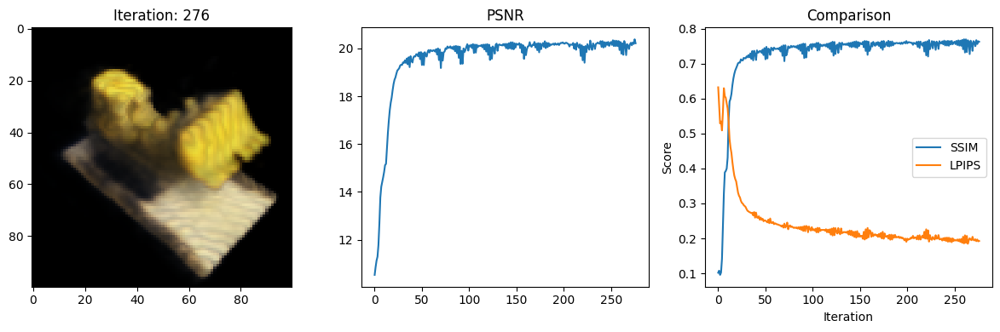

Data saved to: metrics.csv
277 9.082566738128662 secs per iter
Iteration: 277,PSNR: 20.235057830810547, SSIM: 0.7554741333286188, LPIPS: 0.19266919791698456


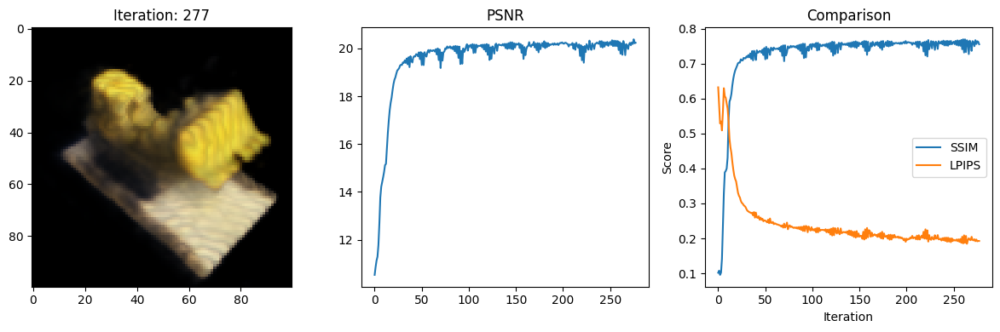

Data saved to: metrics.csv
278 9.130082130432129 secs per iter
Iteration: 278,PSNR: 20.25577163696289, SSIM: 0.763992190896423, LPIPS: 0.19336232542991638


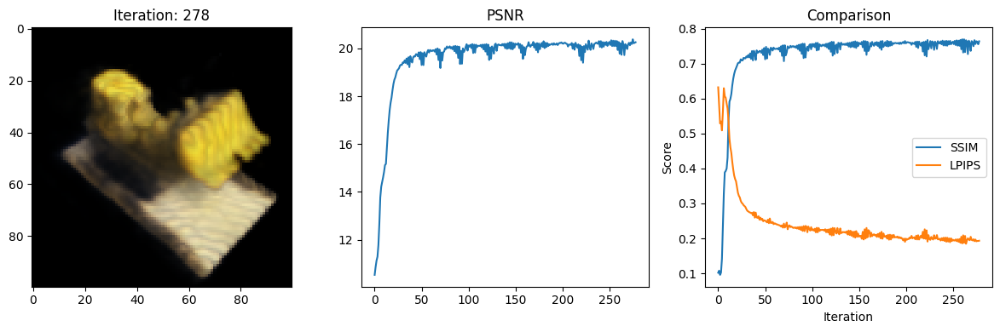

Data saved to: metrics.csv
279 9.069864511489868 secs per iter
Iteration: 279,PSNR: 20.12518310546875, SSIM: 0.7526415315222534, LPIPS: 0.1970265656709671


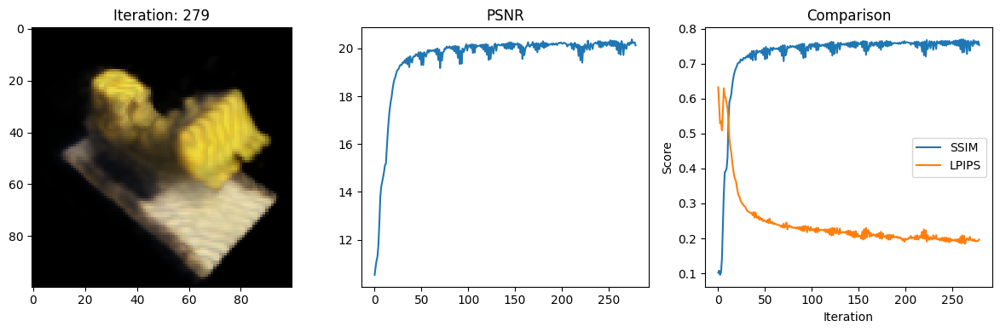

Data saved to: metrics.csv
280 9.295838117599487 secs per iter
Iteration: 280,PSNR: 20.339366912841797, SSIM: 0.7660591996032086, LPIPS: 0.190232515335083


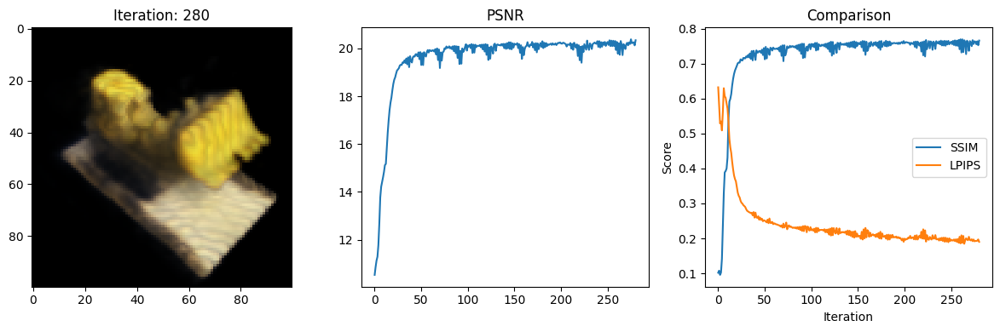

Data saved to: metrics.csv
281 9.138219833374023 secs per iter
Iteration: 281,PSNR: 20.120996475219727, SSIM: 0.7529570231786545, LPIPS: 0.19531147181987762


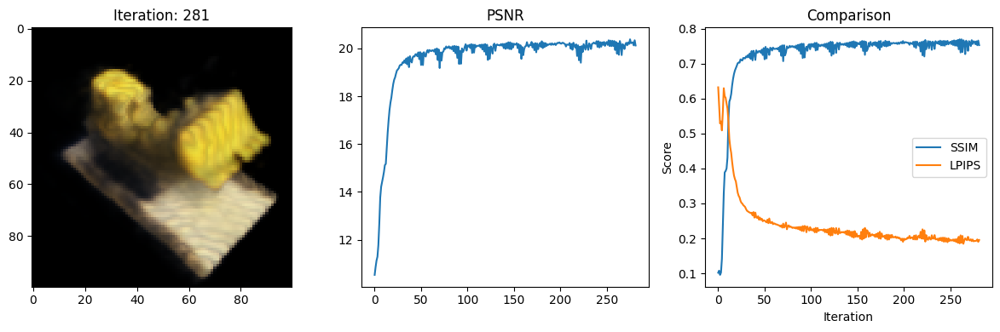

Data saved to: metrics.csv
282 9.141938924789429 secs per iter
Iteration: 282,PSNR: 20.33592987060547, SSIM: 0.7670421726915758, LPIPS: 0.18768686056137085


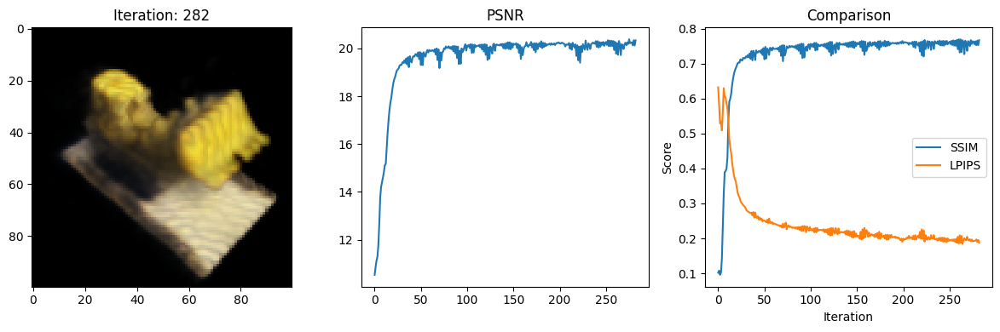

Data saved to: metrics.csv
283 9.028524160385132 secs per iter
Iteration: 283,PSNR: 20.09627342224121, SSIM: 0.7500598592753928, LPIPS: 0.19629305601119995


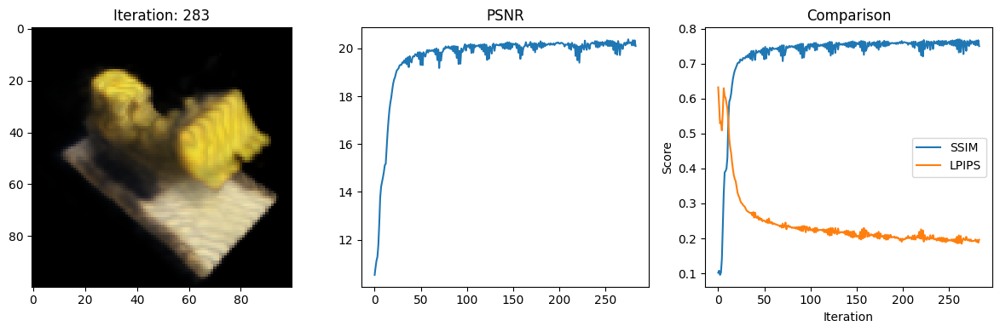

Data saved to: metrics.csv
284 9.297299146652222 secs per iter
Iteration: 284,PSNR: 20.31281280517578, SSIM: 0.7670536584574495, LPIPS: 0.18418438732624054


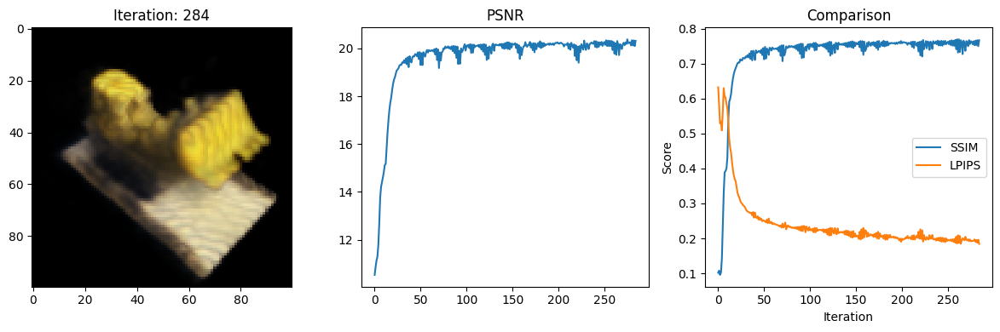

Data saved to: metrics.csv
285 9.197148561477661 secs per iter
Iteration: 285,PSNR: 20.156509399414062, SSIM: 0.7551577861523796, LPIPS: 0.19367548823356628


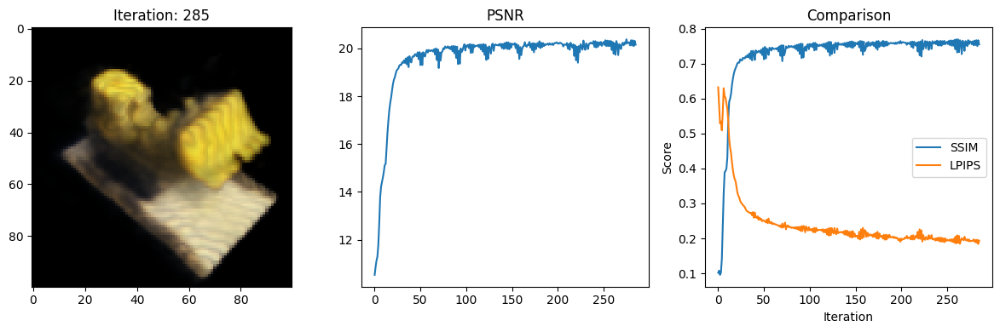

Data saved to: metrics.csv
286 9.134015798568726 secs per iter
Iteration: 286,PSNR: 20.273334503173828, SSIM: 0.7631359846911216, LPIPS: 0.18712186813354492


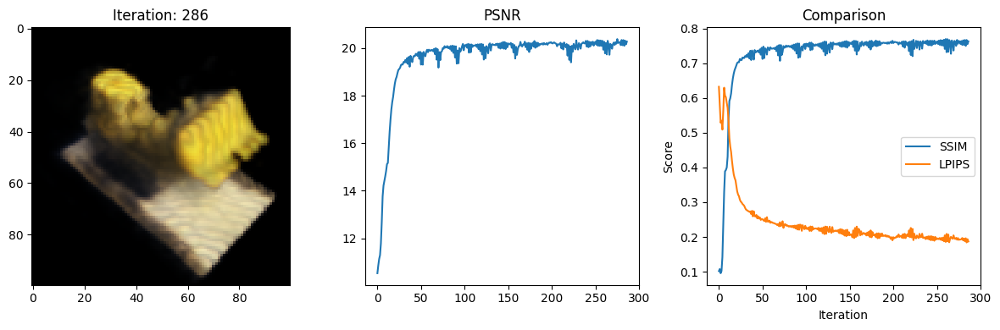

Data saved to: metrics.csv
287 9.092772245407104 secs per iter
Iteration: 287,PSNR: 20.22966957092285, SSIM: 0.7584546539422224, LPIPS: 0.19166819751262665


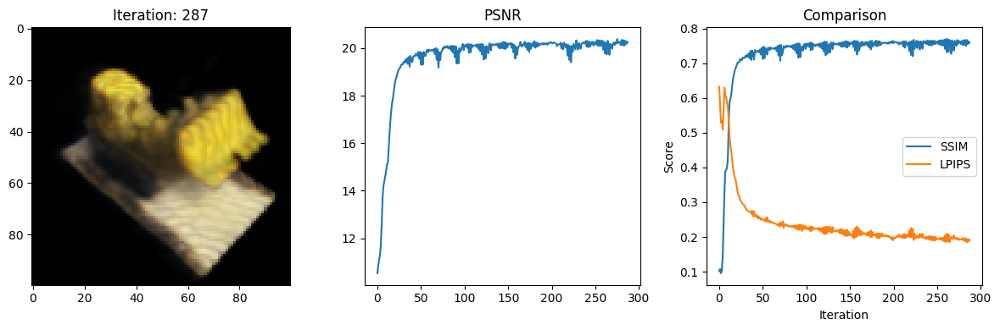

Data saved to: metrics.csv
288 9.419470310211182 secs per iter
Iteration: 288,PSNR: 20.263254165649414, SSIM: 0.7617189907776504, LPIPS: 0.18599924445152283


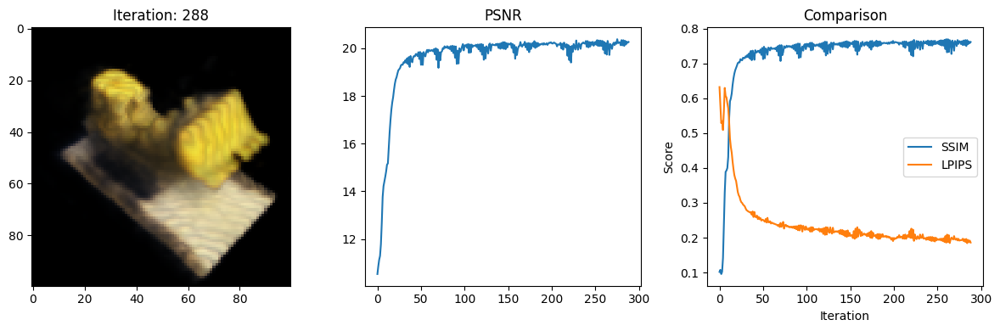

Data saved to: metrics.csv
289 9.14293122291565 secs per iter
Iteration: 289,PSNR: 20.314620971679688, SSIM: 0.7633321373863128, LPIPS: 0.18809613585472107


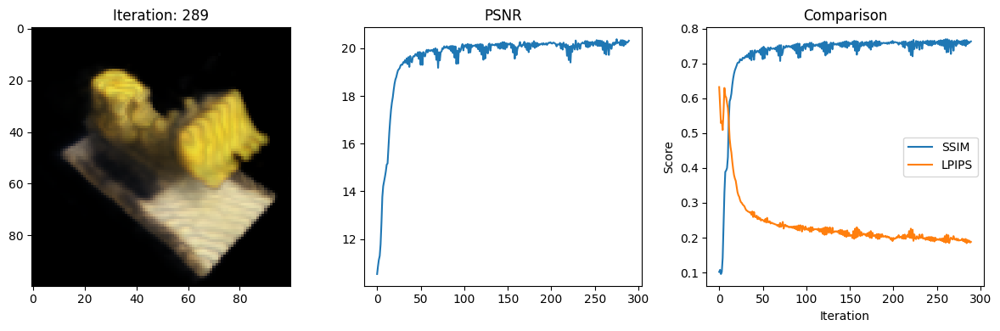

Data saved to: metrics.csv
290 9.172209739685059 secs per iter
Iteration: 290,PSNR: 20.261606216430664, SSIM: 0.7612525231275108, LPIPS: 0.18566389381885529


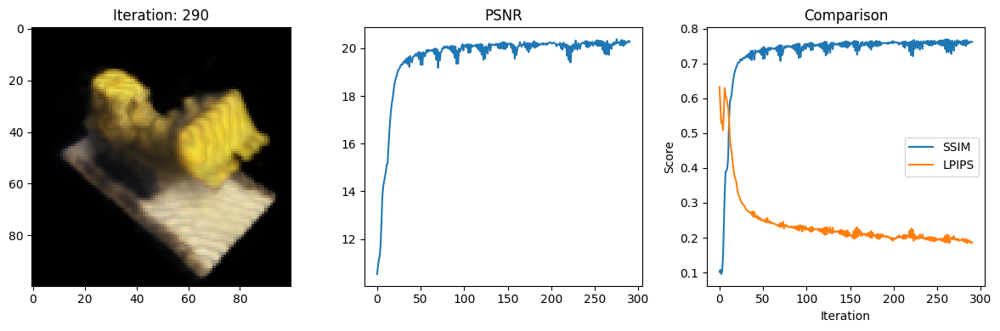

Data saved to: metrics.csv
291 9.449725151062012 secs per iter
Iteration: 291,PSNR: 20.343387603759766, SSIM: 0.7651323115317625, LPIPS: 0.18859148025512695


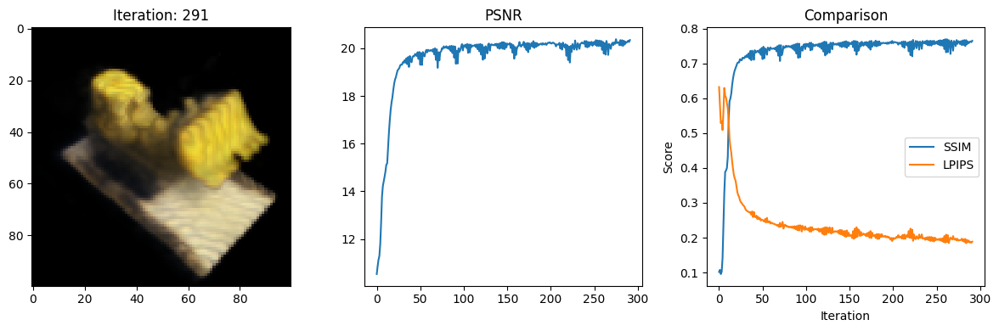

Data saved to: metrics.csv
292 9.34708547592163 secs per iter
Iteration: 292,PSNR: 20.186548233032227, SSIM: 0.7567960177700283, LPIPS: 0.19151949882507324


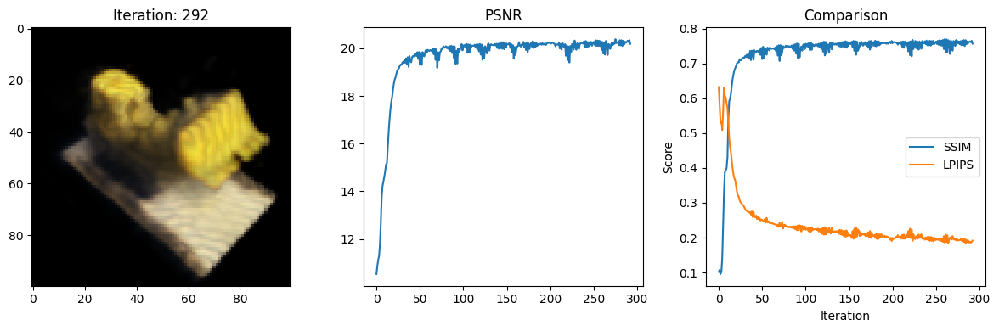

Data saved to: metrics.csv
293 9.190090417861938 secs per iter
Iteration: 293,PSNR: 20.28716278076172, SSIM: 0.7613216935321118, LPIPS: 0.19349628686904907


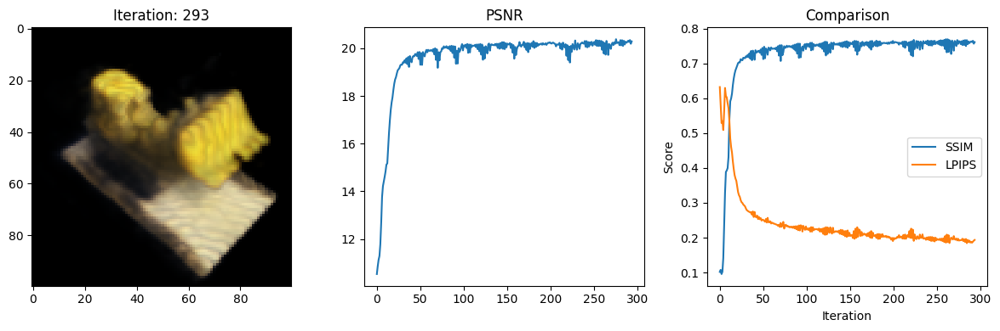

Data saved to: metrics.csv
294 9.19506049156189 secs per iter
Iteration: 294,PSNR: 20.143070220947266, SSIM: 0.755220069297507, LPIPS: 0.19102701544761658


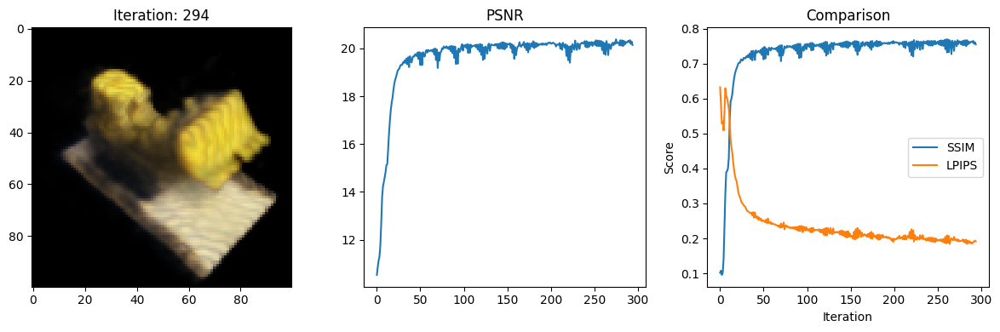

Data saved to: metrics.csv
295 9.110044956207275 secs per iter
Iteration: 295,PSNR: 20.273941040039062, SSIM: 0.7610083301859145, LPIPS: 0.19155248999595642


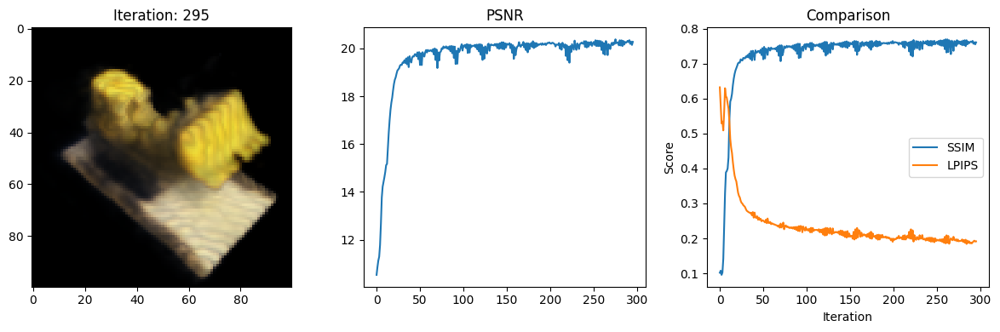

Data saved to: metrics.csv
296 9.358145952224731 secs per iter
Iteration: 296,PSNR: 20.22568130493164, SSIM: 0.7564148163068601, LPIPS: 0.19226884841918945


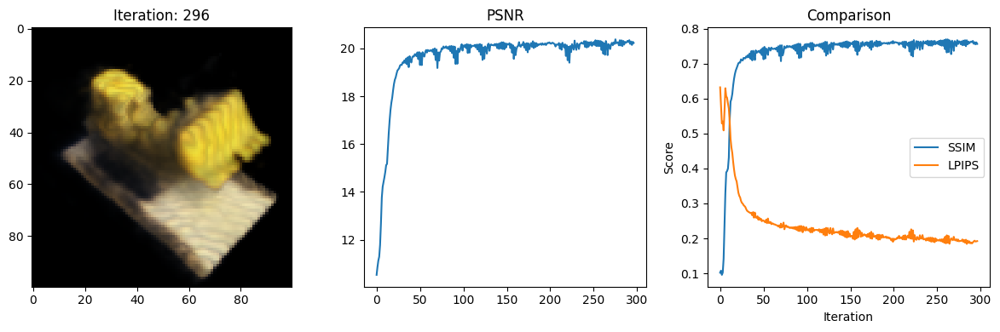

Data saved to: metrics.csv
297 9.161377906799316 secs per iter
Iteration: 297,PSNR: 20.304588317871094, SSIM: 0.7629573255787864, LPIPS: 0.1883845031261444


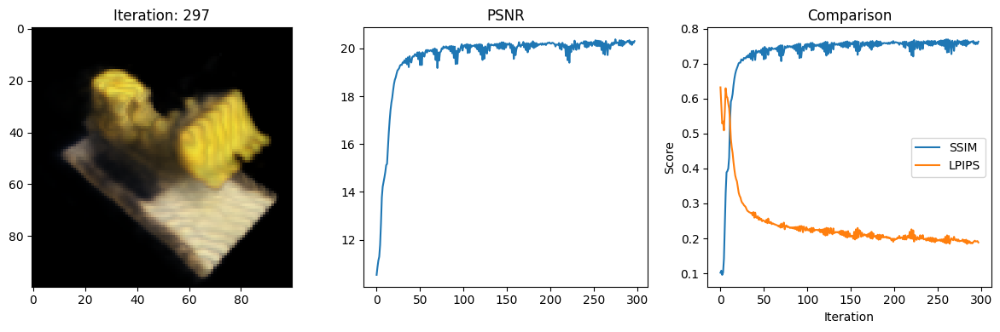

Data saved to: metrics.csv
298 9.140772819519043 secs per iter
Iteration: 298,PSNR: 20.1627197265625, SSIM: 0.7533511315161183, LPIPS: 0.19240276515483856


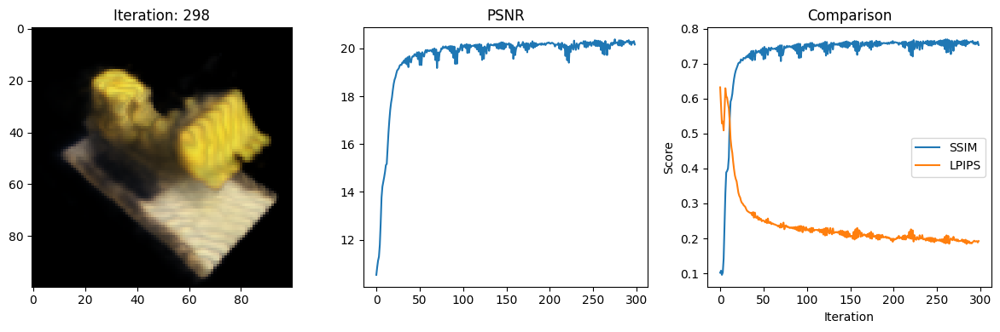

Data saved to: metrics.csv
299 9.148437976837158 secs per iter
Iteration: 299,PSNR: 20.331340789794922, SSIM: 0.7656875931533436, LPIPS: 0.18775081634521484


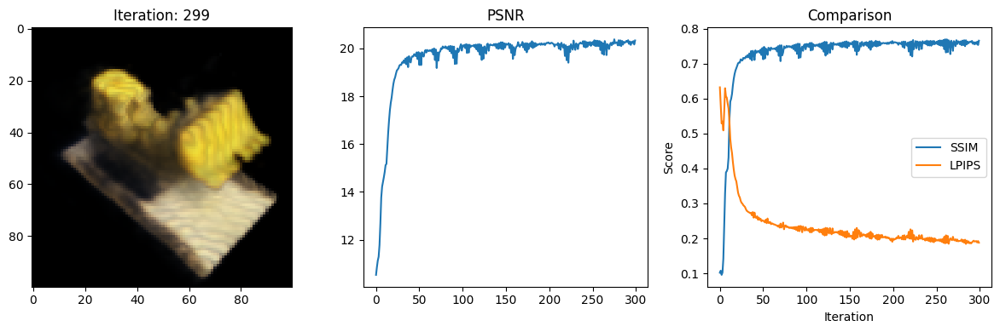

Data saved to: metrics.csv
300 9.202462911605835 secs per iter
Iteration: 300,PSNR: 20.170555114746094, SSIM: 0.751729352311345, LPIPS: 0.19267034530639648


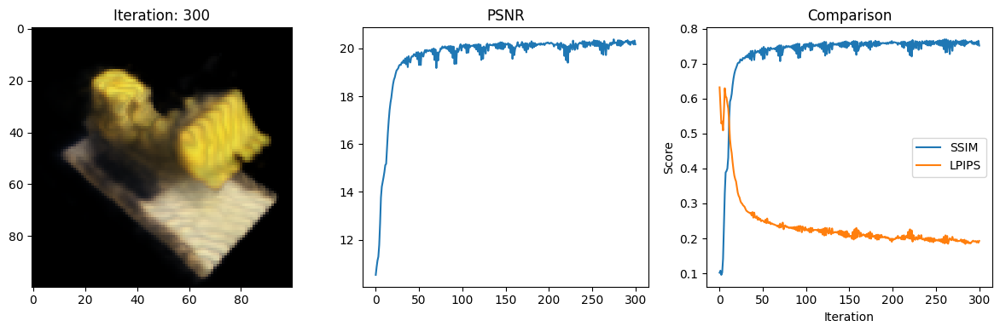

Data saved to: metrics.csv
301 9.219506978988647 secs per iter
Iteration: 301,PSNR: 20.348106384277344, SSIM: 0.7667720000572276, LPIPS: 0.18580563366413116


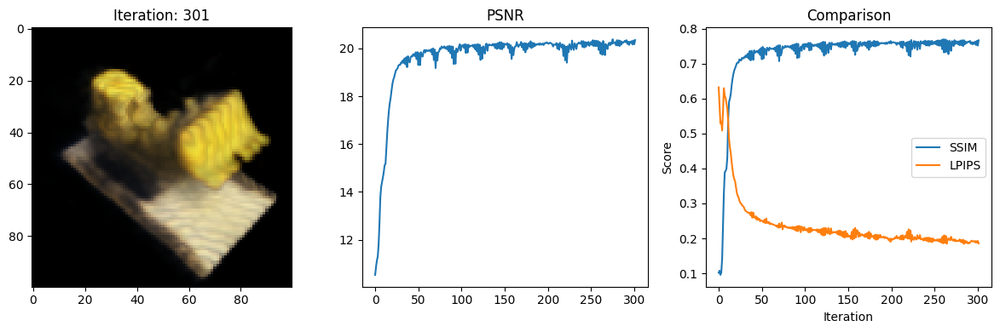

Data saved to: metrics.csv
302 9.11302375793457 secs per iter
Iteration: 302,PSNR: 20.22352409362793, SSIM: 0.7556797124464762, LPIPS: 0.19005168974399567


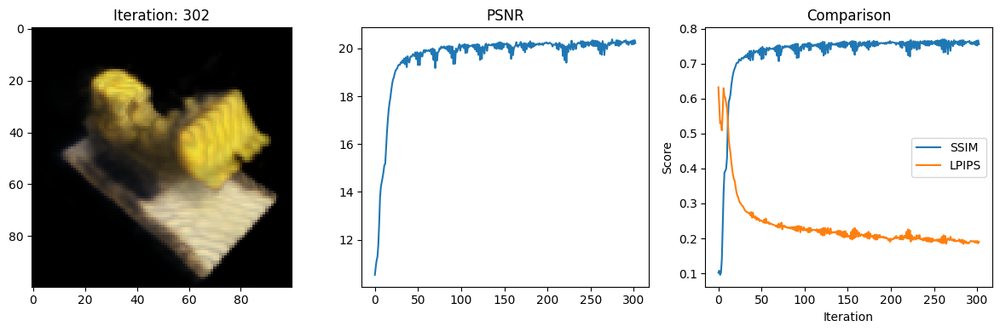

Data saved to: metrics.csv
303 9.14912748336792 secs per iter
Iteration: 303,PSNR: 20.280054092407227, SSIM: 0.7636707772028858, LPIPS: 0.18642181158065796


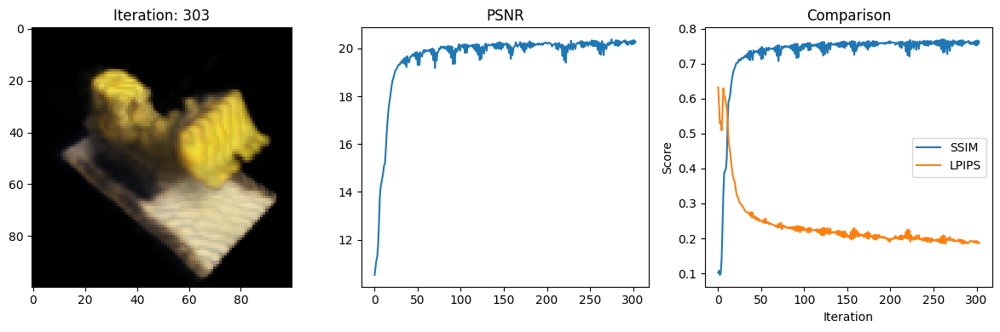

Data saved to: metrics.csv
304 9.085747480392456 secs per iter
Iteration: 304,PSNR: 20.220609664916992, SSIM: 0.7564261764815008, LPIPS: 0.18734847009181976


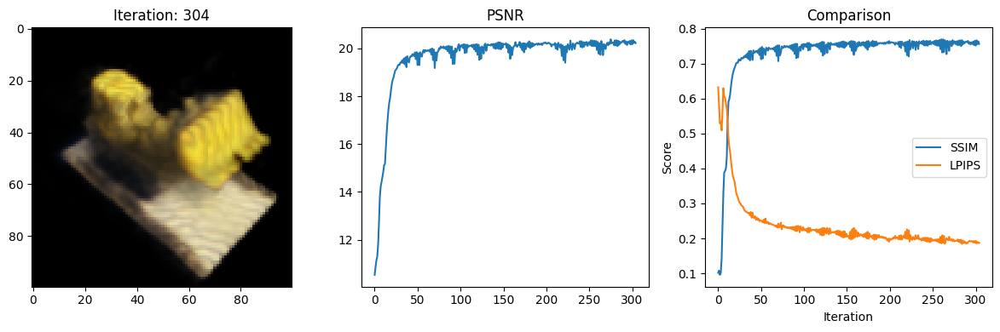

Data saved to: metrics.csv
305 9.370187997817993 secs per iter
Iteration: 305,PSNR: 20.27440643310547, SSIM: 0.763233540456982, LPIPS: 0.1850196123123169


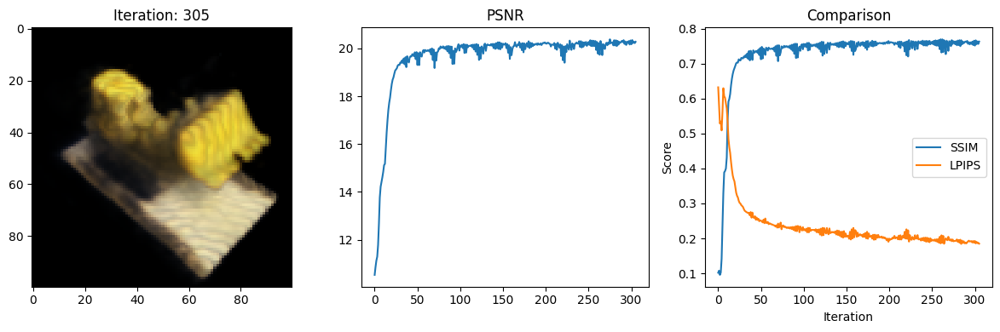

Data saved to: metrics.csv
306 9.62977933883667 secs per iter
Iteration: 306,PSNR: 20.221237182617188, SSIM: 0.7584078003890756, LPIPS: 0.1880205124616623


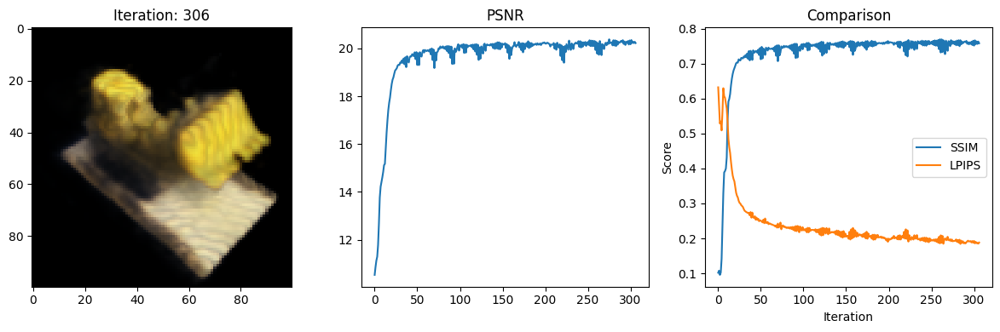

Data saved to: metrics.csv
307 9.196581363677979 secs per iter
Iteration: 307,PSNR: 20.21619415283203, SSIM: 0.7583691628845625, LPIPS: 0.18934090435504913


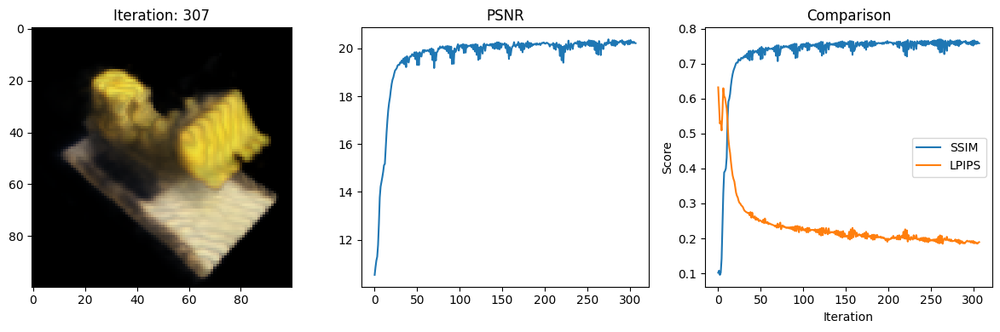

Data saved to: metrics.csv
308 9.079504251480103 secs per iter
Iteration: 308,PSNR: 20.31292152404785, SSIM: 0.763299639035495, LPIPS: 0.18605181574821472


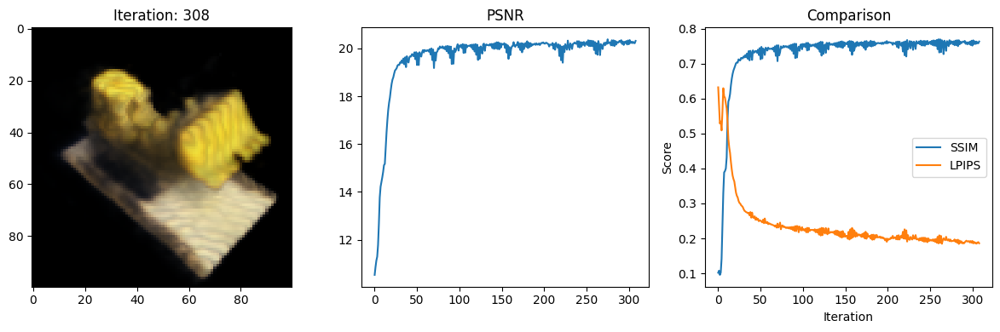

Data saved to: metrics.csv
309 9.34967041015625 secs per iter
Iteration: 309,PSNR: 20.235107421875, SSIM: 0.7579481903981241, LPIPS: 0.18602655827999115


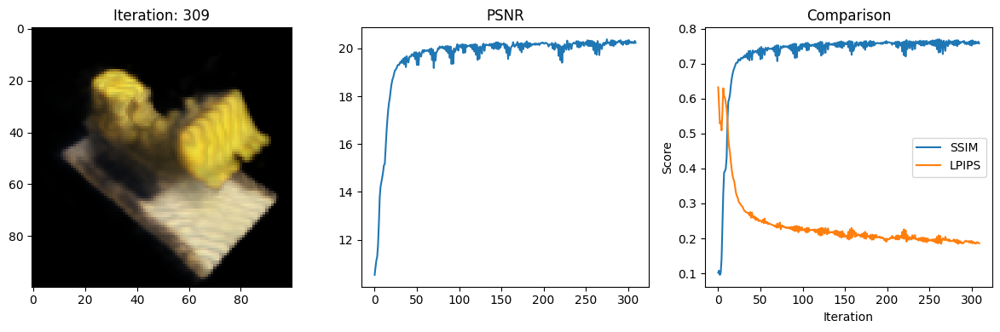

Data saved to: metrics.csv
310 9.172027587890625 secs per iter
Iteration: 310,PSNR: 20.33940887451172, SSIM: 0.7666081887124498, LPIPS: 0.1824997216463089


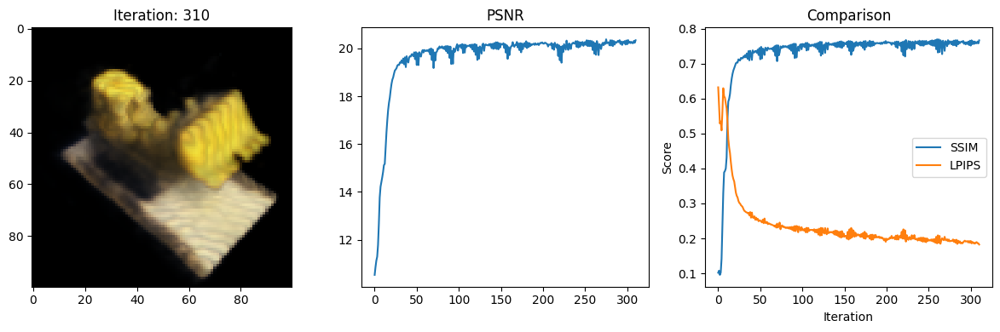

Data saved to: metrics.csv
311 9.271194458007812 secs per iter
Iteration: 311,PSNR: 20.226118087768555, SSIM: 0.7575964045810576, LPIPS: 0.18512746691703796


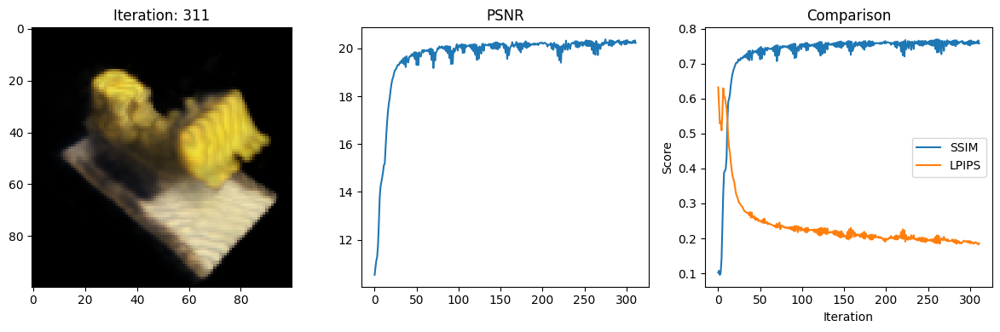

Data saved to: metrics.csv
312 9.162845373153687 secs per iter
Iteration: 312,PSNR: 20.410797119140625, SSIM: 0.7696654533072617, LPIPS: 0.17995628714561462


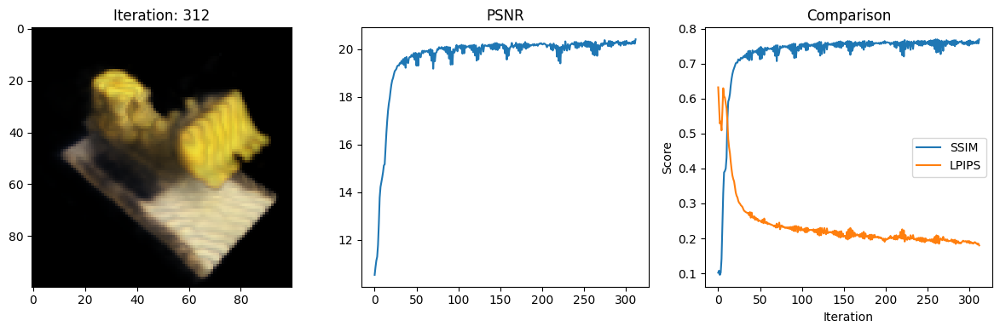

Data saved to: metrics.csv
313 9.401003360748291 secs per iter
Iteration: 313,PSNR: 20.27913475036621, SSIM: 0.7561896856589239, LPIPS: 0.18735896050930023


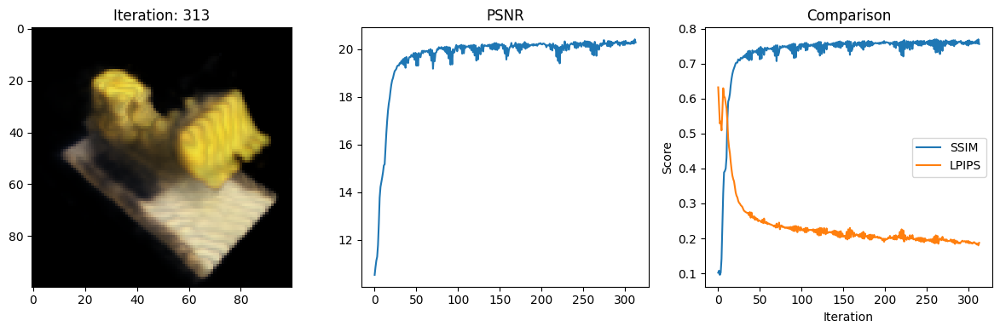

Data saved to: metrics.csv
314 9.086598634719849 secs per iter
Iteration: 314,PSNR: 20.3914737701416, SSIM: 0.7687578777727931, LPIPS: 0.18321828544139862


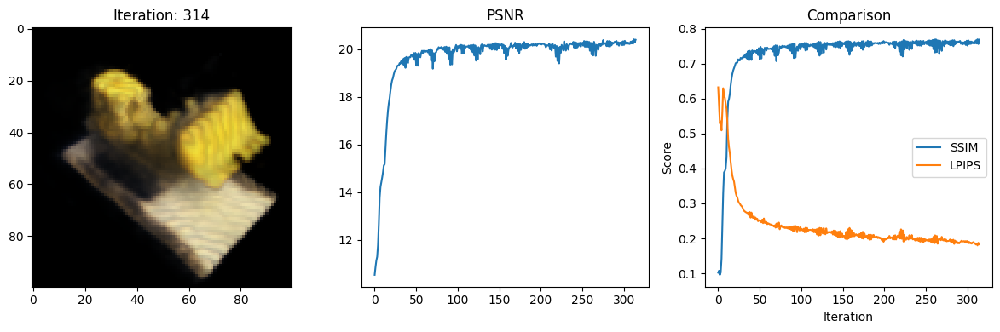

Data saved to: metrics.csv
315 8.930811166763306 secs per iter
Iteration: 315,PSNR: 20.296297073364258, SSIM: 0.7566132854385251, LPIPS: 0.19222164154052734


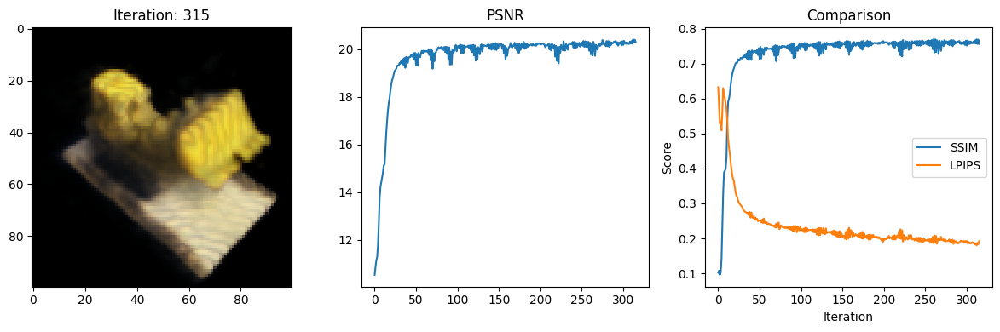

Data saved to: metrics.csv
316 8.916572332382202 secs per iter
Iteration: 316,PSNR: 20.322620391845703, SSIM: 0.7653266518265706, LPIPS: 0.18753878772258759


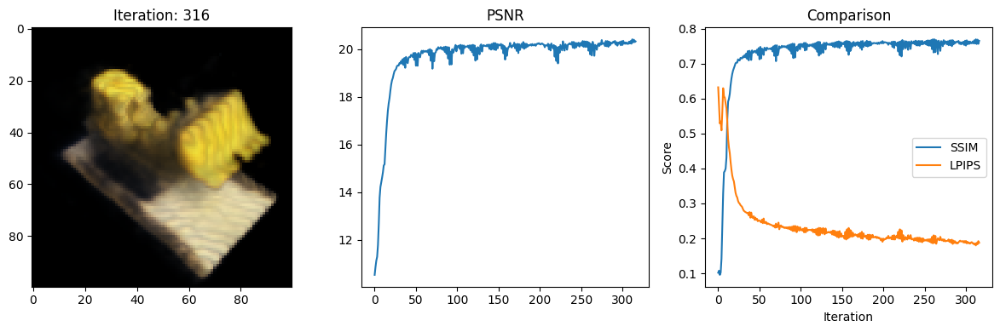

Data saved to: metrics.csv
317 9.134527444839478 secs per iter
Iteration: 317,PSNR: 20.06852912902832, SSIM: 0.7499906723769779, LPIPS: 0.19589321315288544


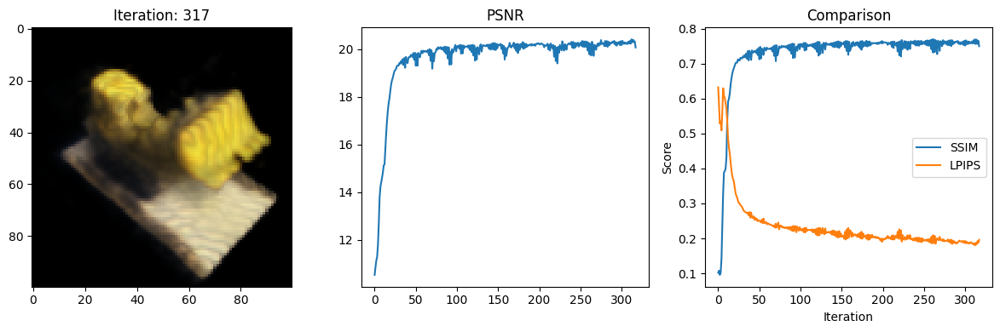

Data saved to: metrics.csv
318 9.022804260253906 secs per iter
Iteration: 318,PSNR: 20.22577667236328, SSIM: 0.7601633828287414, LPIPS: 0.1934424191713333


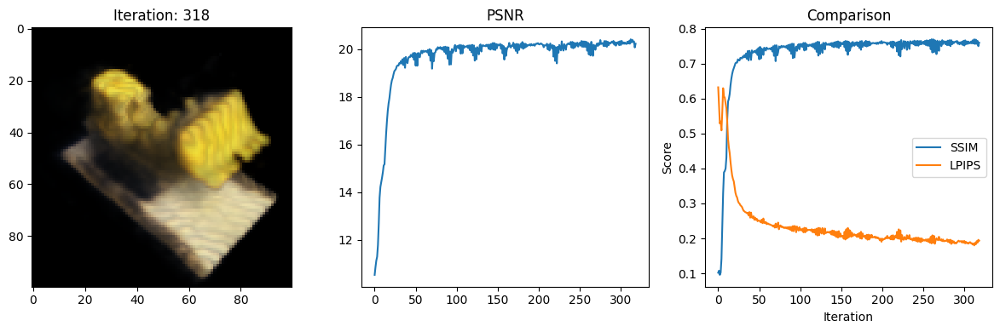

Data saved to: metrics.csv
319 8.94881010055542 secs per iter
Iteration: 319,PSNR: 20.08553123474121, SSIM: 0.7493636238629753, LPIPS: 0.19588196277618408


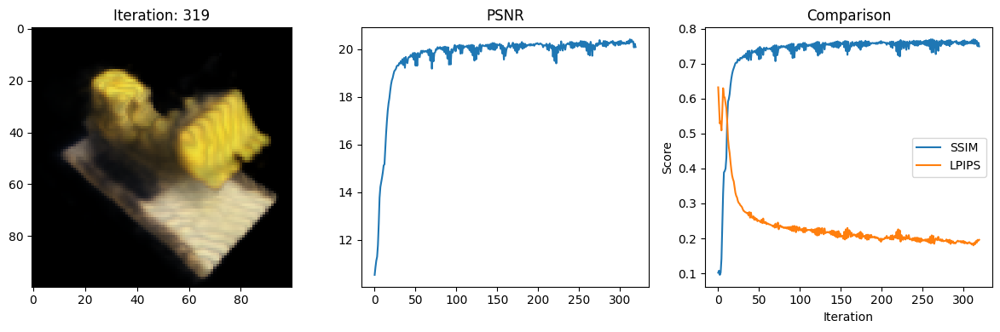

Data saved to: metrics.csv
320 8.909406661987305 secs per iter
Iteration: 320,PSNR: 20.270845413208008, SSIM: 0.7600925838389299, LPIPS: 0.19222211837768555


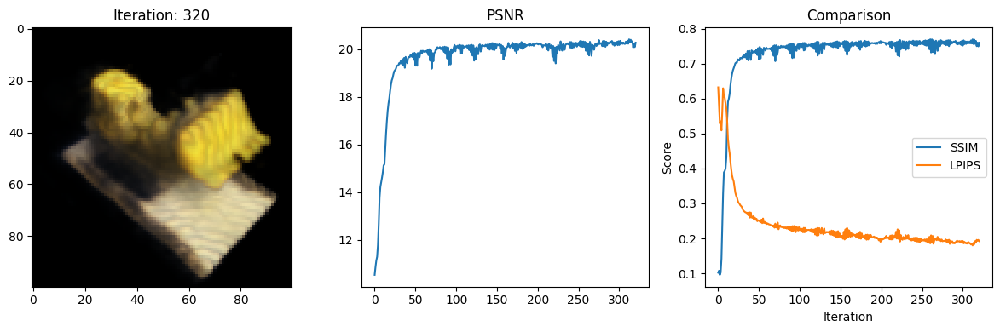

Data saved to: metrics.csv
321 9.683620929718018 secs per iter
Iteration: 321,PSNR: 20.167221069335938, SSIM: 0.7507796843307886, LPIPS: 0.19387707114219666


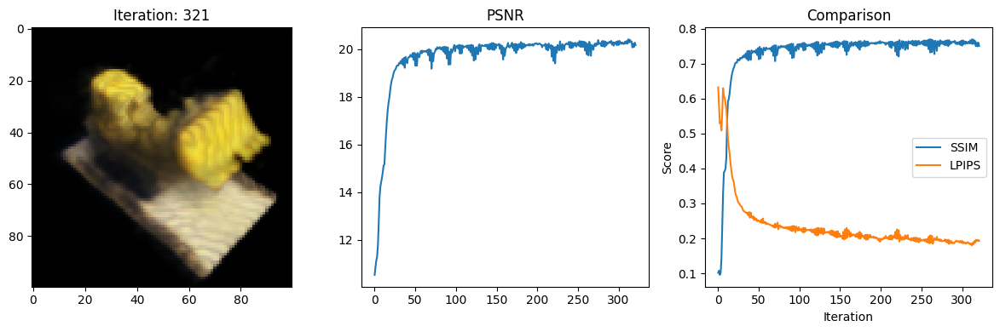

Data saved to: metrics.csv
322 9.011987924575806 secs per iter
Iteration: 322,PSNR: 20.3248233795166, SSIM: 0.7637579580887902, LPIPS: 0.18724341690540314


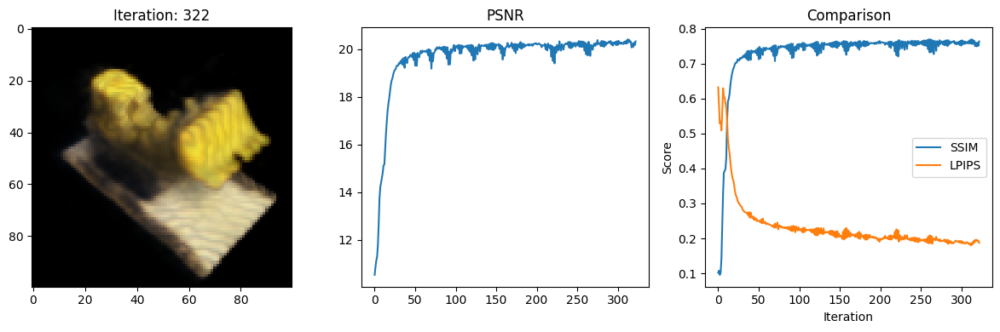

Data saved to: metrics.csv
323 8.934180974960327 secs per iter
Iteration: 323,PSNR: 20.175329208374023, SSIM: 0.7531005022250273, LPIPS: 0.19391976296901703


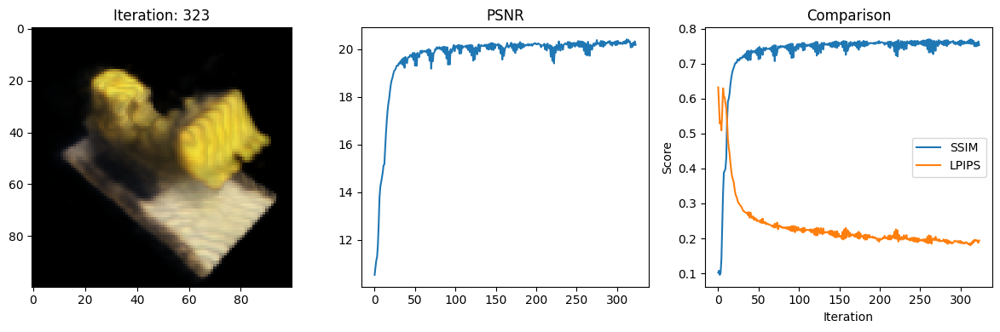

Data saved to: metrics.csv
324 8.936251163482666 secs per iter
Iteration: 324,PSNR: 20.1783390045166, SSIM: 0.7549475859541066, LPIPS: 0.1914145052433014


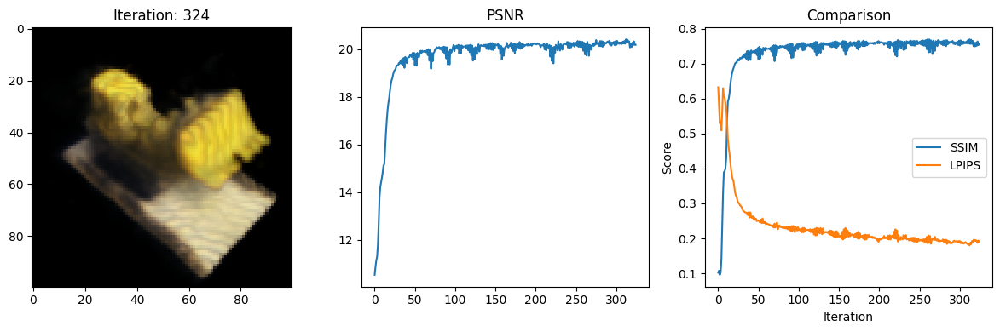

Data saved to: metrics.csv
325 9.166578769683838 secs per iter
Iteration: 325,PSNR: 20.1850643157959, SSIM: 0.7547106913120473, LPIPS: 0.19333884119987488


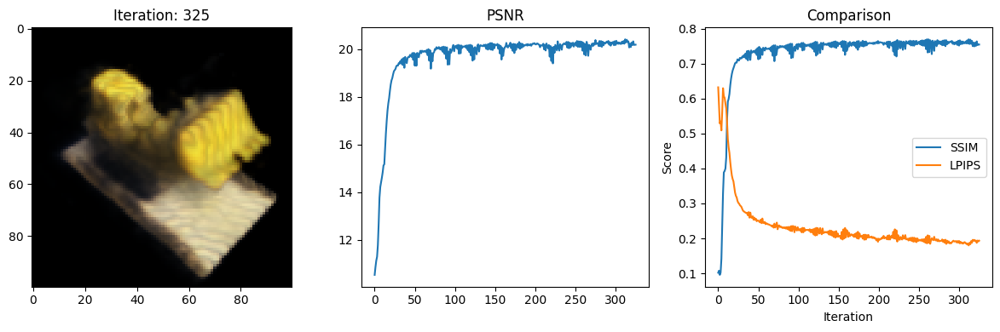

Data saved to: metrics.csv
326 8.985161066055298 secs per iter
Iteration: 326,PSNR: 19.998659133911133, SSIM: 0.745611029632375, LPIPS: 0.19729946553707123


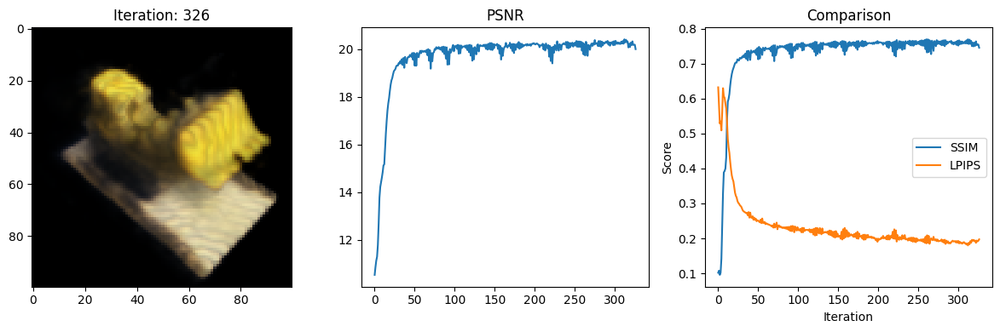

Data saved to: metrics.csv
327 8.925852298736572 secs per iter
Iteration: 327,PSNR: 20.212778091430664, SSIM: 0.7615989591225975, LPIPS: 0.18978454172611237


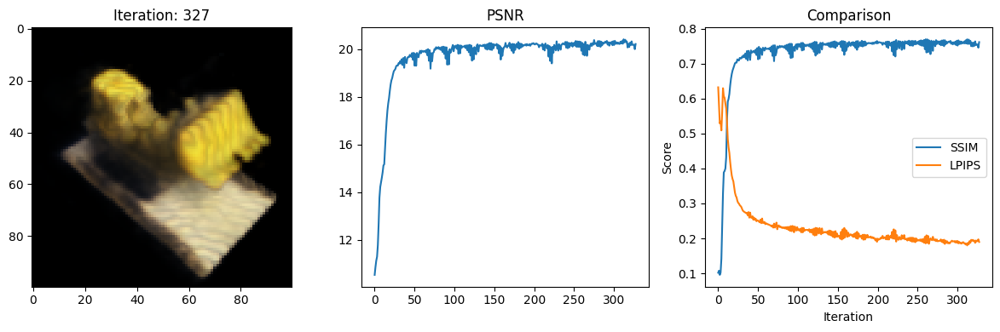

Data saved to: metrics.csv
328 8.875949621200562 secs per iter
Iteration: 328,PSNR: 19.827228546142578, SSIM: 0.7329246257141245, LPIPS: 0.19992642104625702


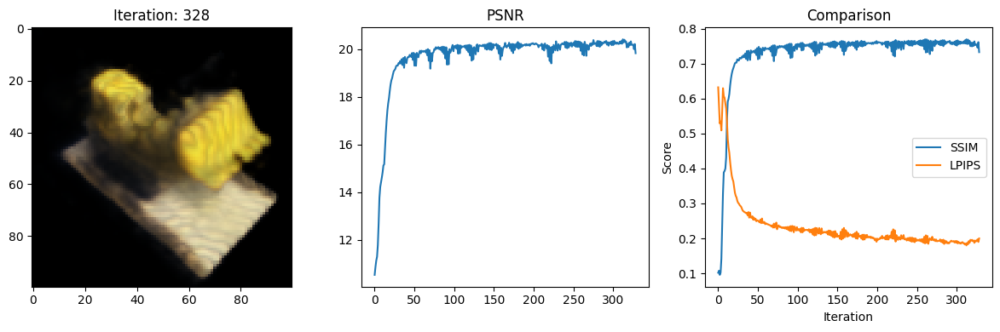

Data saved to: metrics.csv
329 9.012910604476929 secs per iter
Iteration: 329,PSNR: 20.214570999145508, SSIM: 0.7641231047660325, LPIPS: 0.1890079230070114


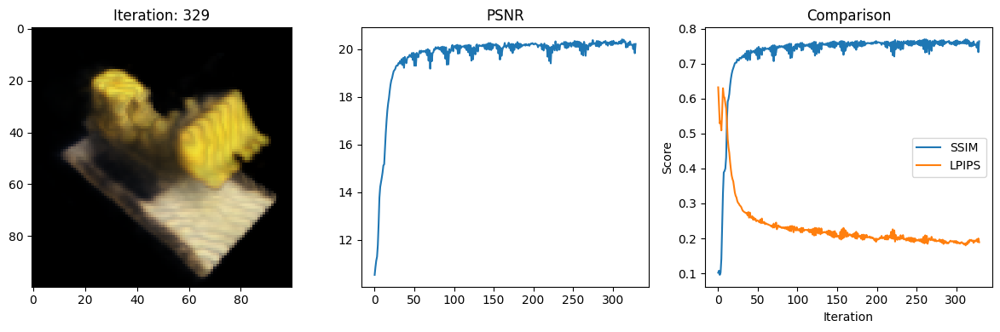

Data saved to: metrics.csv
330 8.967254161834717 secs per iter
Iteration: 330,PSNR: 19.832408905029297, SSIM: 0.7322152874363144, LPIPS: 0.20265956223011017


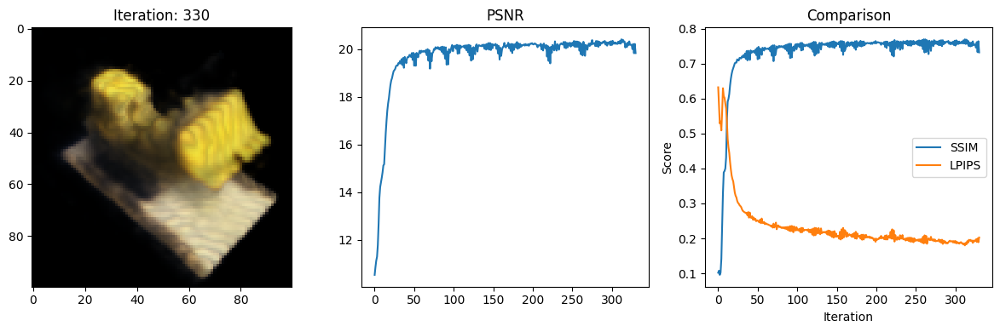

Data saved to: metrics.csv
331 9.027655839920044 secs per iter
Iteration: 331,PSNR: 20.220909118652344, SSIM: 0.7635504577869353, LPIPS: 0.191496342420578


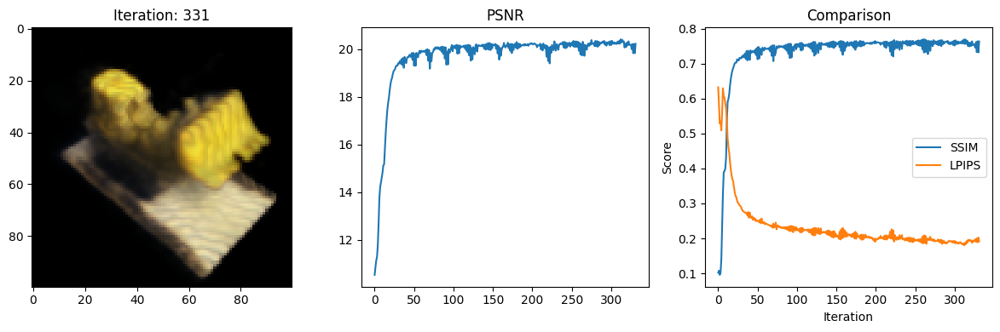

Data saved to: metrics.csv
332 8.873813152313232 secs per iter
Iteration: 332,PSNR: 19.937387466430664, SSIM: 0.7365823894011686, LPIPS: 0.1992982029914856


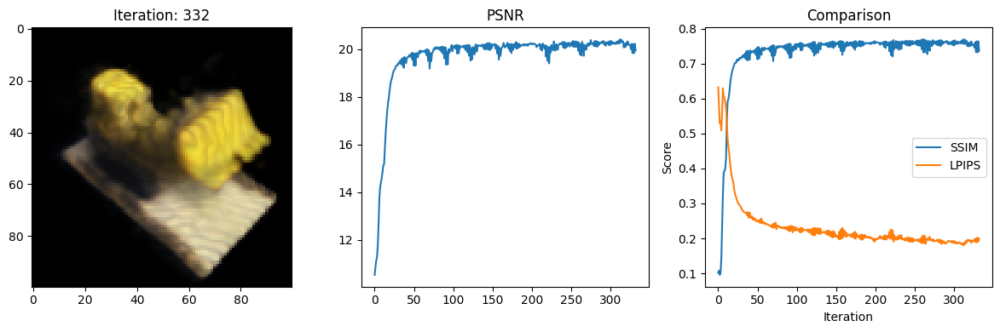

Data saved to: metrics.csv
333 9.000553607940674 secs per iter
Iteration: 333,PSNR: 20.245849609375, SSIM: 0.764627385741489, LPIPS: 0.18986853957176208


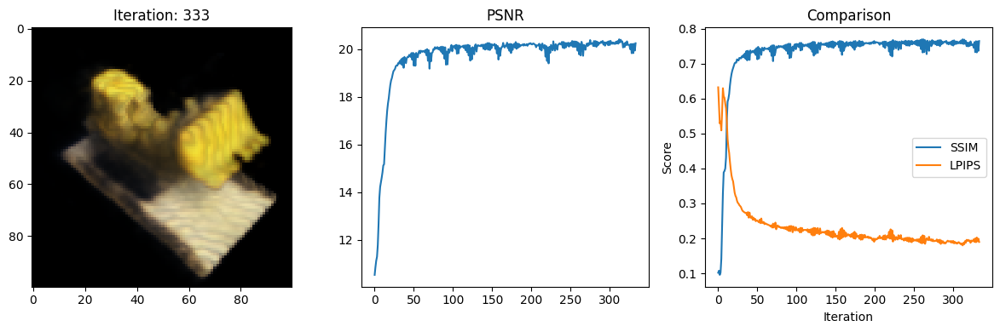

Data saved to: metrics.csv
334 9.003286123275757 secs per iter
Iteration: 334,PSNR: 19.951879501342773, SSIM: 0.737716597989391, LPIPS: 0.19802990555763245


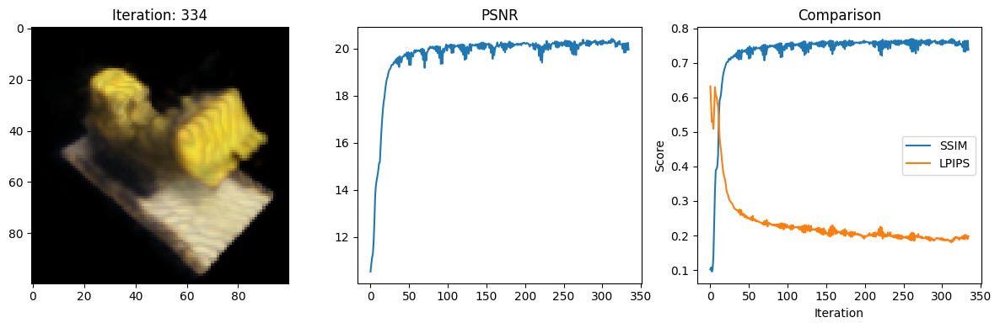

Data saved to: metrics.csv
335 8.953489542007446 secs per iter
Iteration: 335,PSNR: 20.289730072021484, SSIM: 0.7661144163580275, LPIPS: 0.18794037401676178


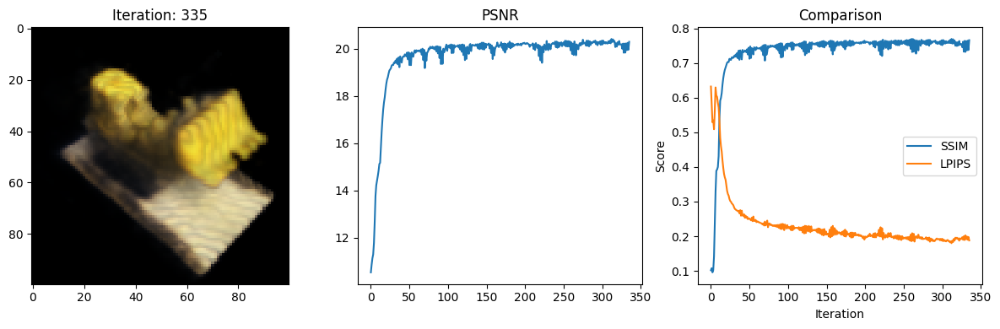

Data saved to: metrics.csv
336 9.020164728164673 secs per iter
Iteration: 336,PSNR: 19.945823669433594, SSIM: 0.7377436395911202, LPIPS: 0.19740134477615356


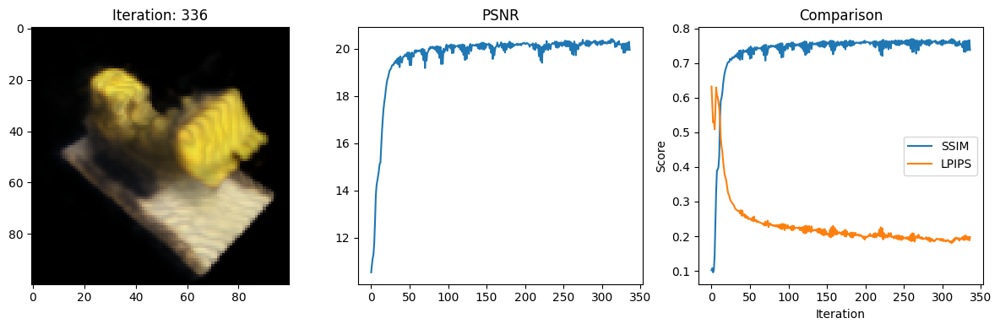

Data saved to: metrics.csv
337 9.402216911315918 secs per iter
Iteration: 337,PSNR: 20.30267333984375, SSIM: 0.7683999627038708, LPIPS: 0.1862666755914688


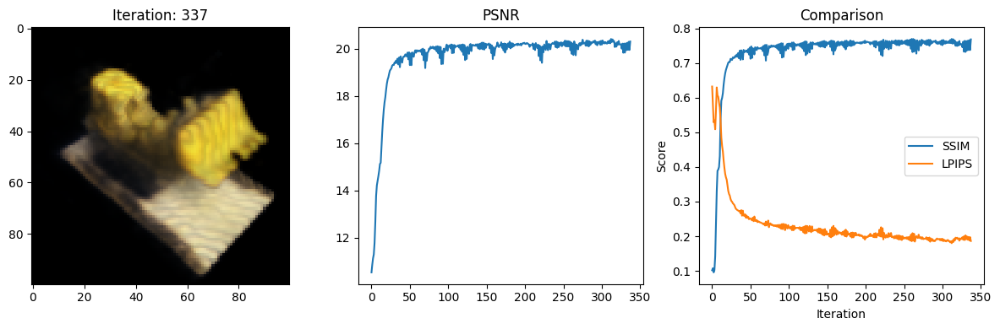

Data saved to: metrics.csv
338 9.40024185180664 secs per iter
Iteration: 338,PSNR: 19.88560676574707, SSIM: 0.7338485465842899, LPIPS: 0.19936875998973846


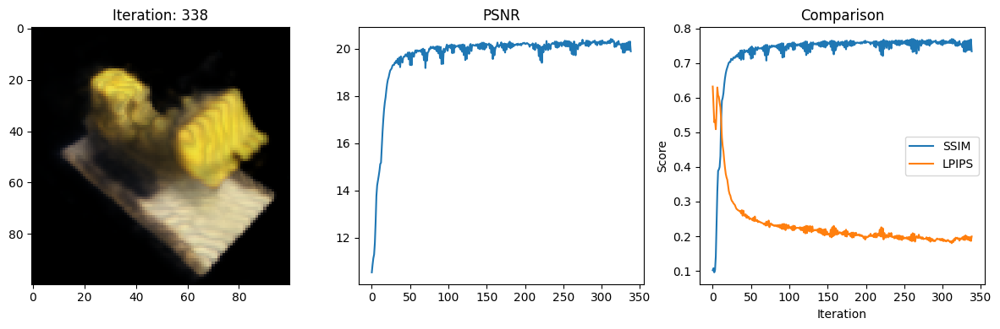

Data saved to: metrics.csv
339 9.078851222991943 secs per iter
Iteration: 339,PSNR: 20.299230575561523, SSIM: 0.7691670772596487, LPIPS: 0.1847897320985794


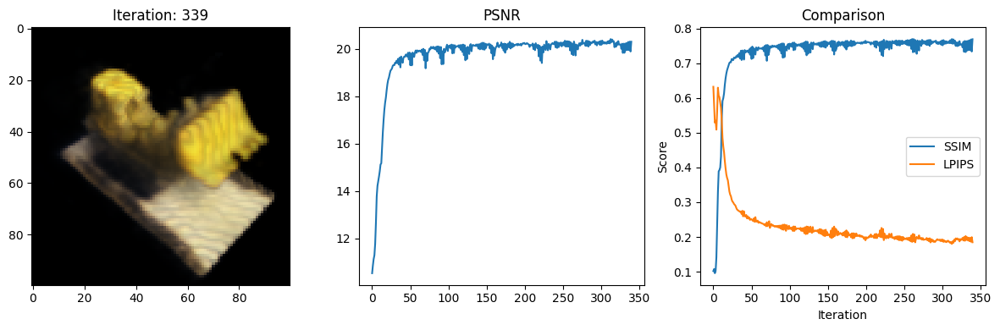

Data saved to: metrics.csv
340 8.931998491287231 secs per iter
Iteration: 340,PSNR: 19.8132266998291, SSIM: 0.7286770406220419, LPIPS: 0.2025323361158371


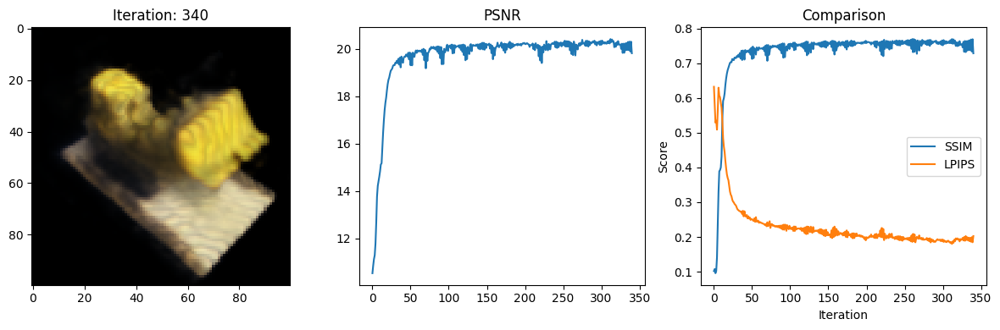

Data saved to: metrics.csv
341 9.159259557723999 secs per iter
Iteration: 341,PSNR: 20.286331176757812, SSIM: 0.7716053292992667, LPIPS: 0.1844659000635147


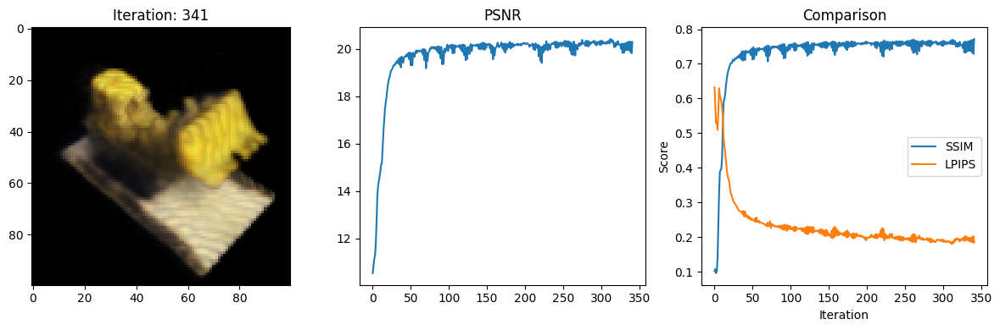

Data saved to: metrics.csv
342 8.992431640625 secs per iter
Iteration: 342,PSNR: 19.64773178100586, SSIM: 0.7232547341394872, LPIPS: 0.2054012566804886


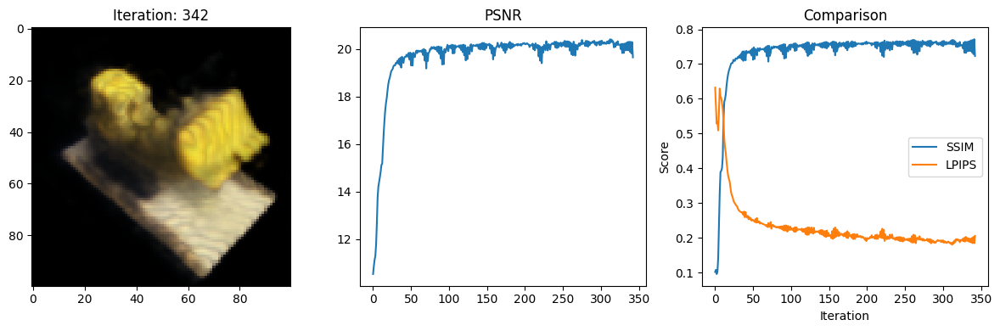

Data saved to: metrics.csv
343 8.987371444702148 secs per iter
Iteration: 343,PSNR: 20.222475051879883, SSIM: 0.7713454975903984, LPIPS: 0.18418844044208527


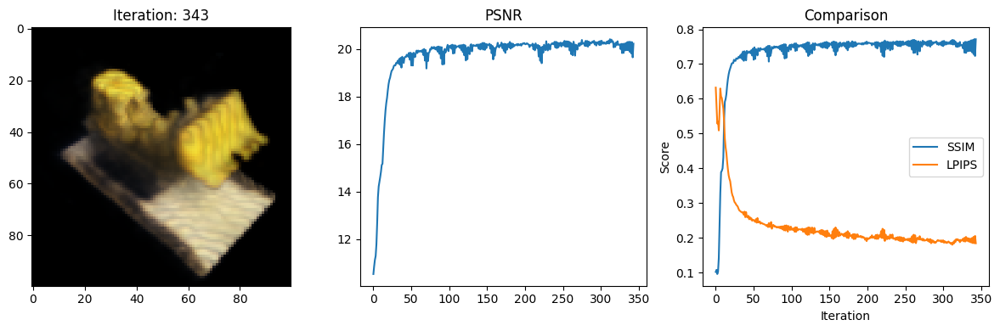

Data saved to: metrics.csv
344 8.958485841751099 secs per iter
Iteration: 344,PSNR: 20.06259536743164, SSIM: 0.7468327979718189, LPIPS: 0.19625987112522125


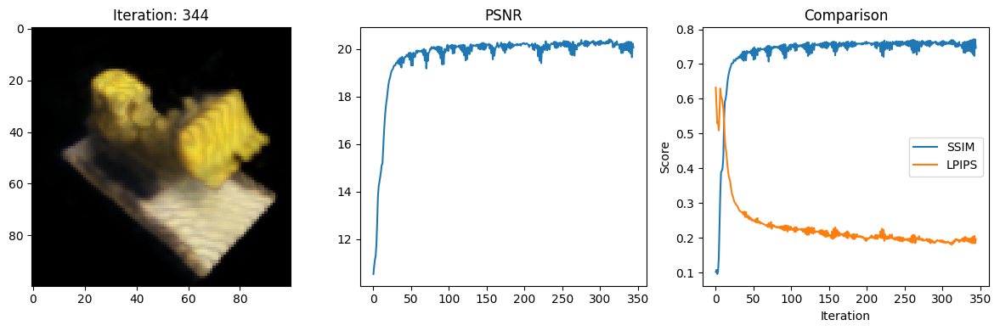

Data saved to: metrics.csv
345 9.003402471542358 secs per iter
Iteration: 345,PSNR: 20.302764892578125, SSIM: 0.7586590954489351, LPIPS: 0.1844368427991867


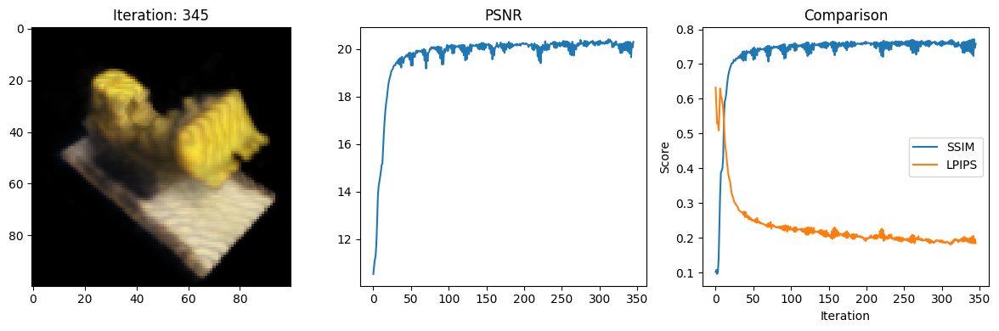

Data saved to: metrics.csv
346 8.987532138824463 secs per iter
Iteration: 346,PSNR: 20.060863494873047, SSIM: 0.7654192083921229, LPIPS: 0.18876563012599945


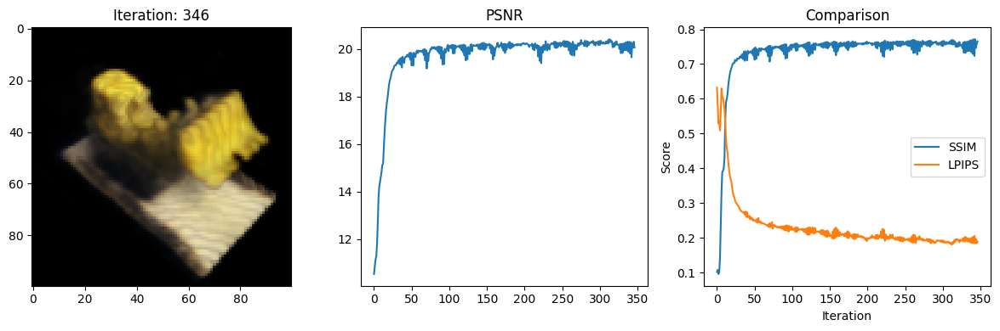

Data saved to: metrics.csv
347 8.978674173355103 secs per iter
Iteration: 347,PSNR: 19.992883682250977, SSIM: 0.7445241189594946, LPIPS: 0.1947653889656067


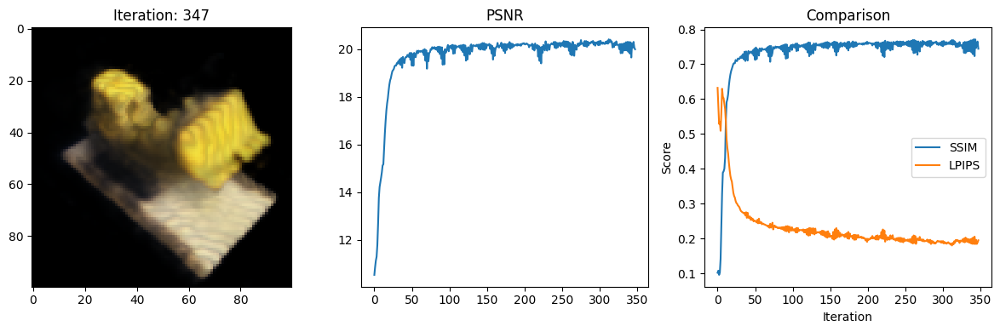

Data saved to: metrics.csv
348 9.087593793869019 secs per iter
Iteration: 348,PSNR: 20.40369987487793, SSIM: 0.7615493140906063, LPIPS: 0.19148629903793335


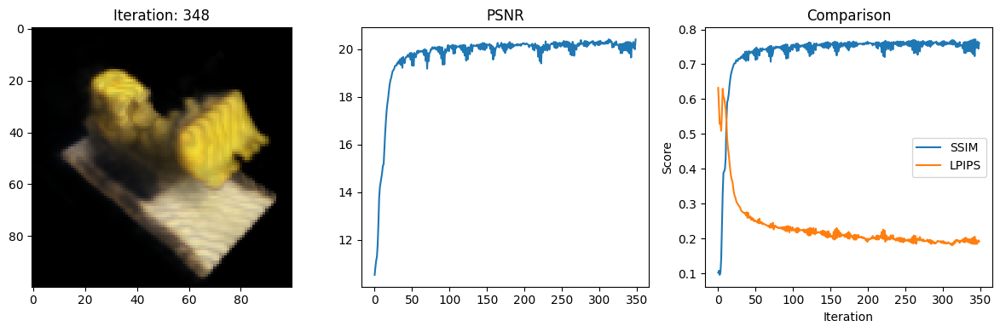

Data saved to: metrics.csv
349 9.001255512237549 secs per iter
Iteration: 349,PSNR: 20.069562911987305, SSIM: 0.7641063167368456, LPIPS: 0.1911626160144806


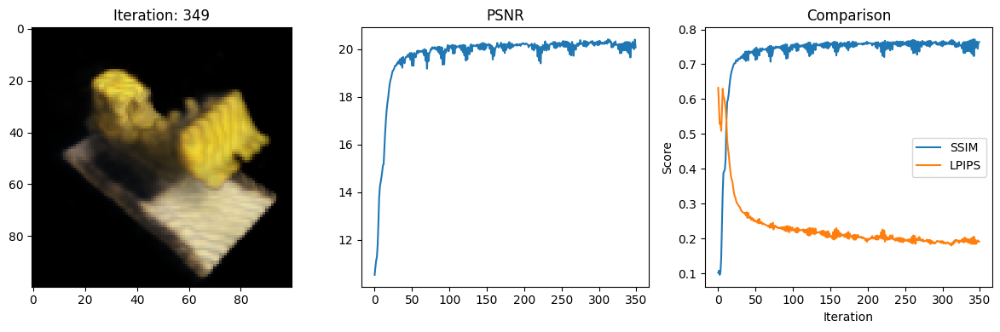

Data saved to: metrics.csv
350 9.006639242172241 secs per iter
Iteration: 350,PSNR: 20.04805564880371, SSIM: 0.7412720135131958, LPIPS: 0.19587598741054535


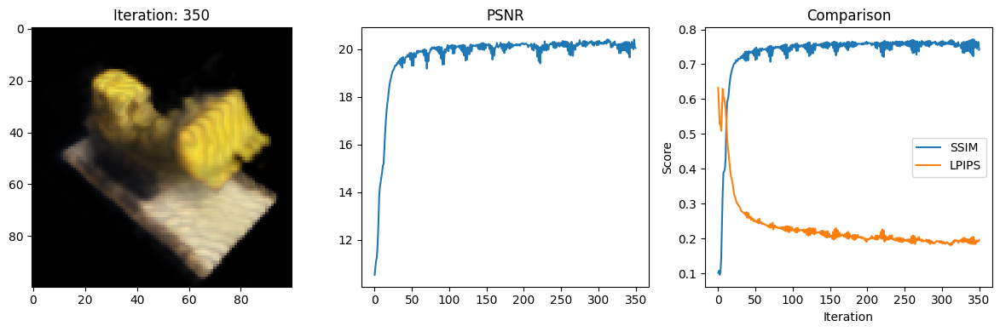

Data saved to: metrics.csv
351 8.957882404327393 secs per iter
Iteration: 351,PSNR: 20.274890899658203, SSIM: 0.7645642754910665, LPIPS: 0.1918589472770691


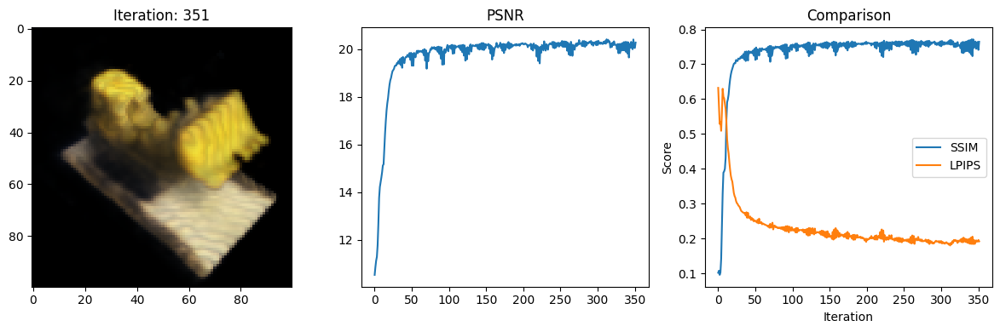

Data saved to: metrics.csv
352 9.411082029342651 secs per iter
Iteration: 352,PSNR: 20.157094955444336, SSIM: 0.7618372214051755, LPIPS: 0.19088758528232574


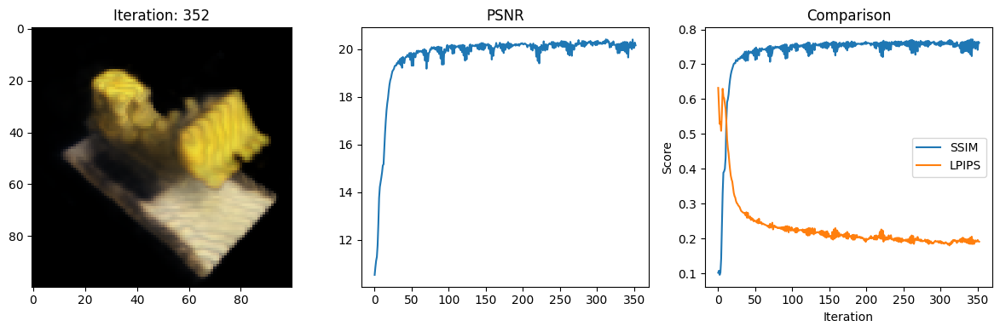

Data saved to: metrics.csv
353 9.180993795394897 secs per iter
Iteration: 353,PSNR: 20.136585235595703, SSIM: 0.7466922250863594, LPIPS: 0.1924629807472229


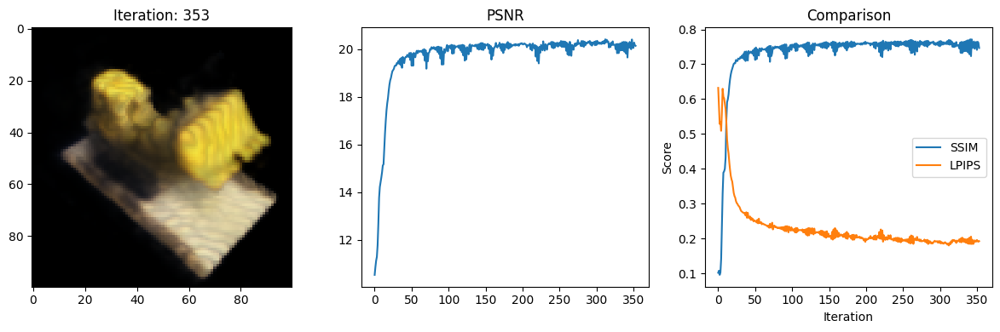

Data saved to: metrics.csv
354 8.983301162719727 secs per iter
Iteration: 354,PSNR: 20.258607864379883, SSIM: 0.7667838230694817, LPIPS: 0.18886947631835938


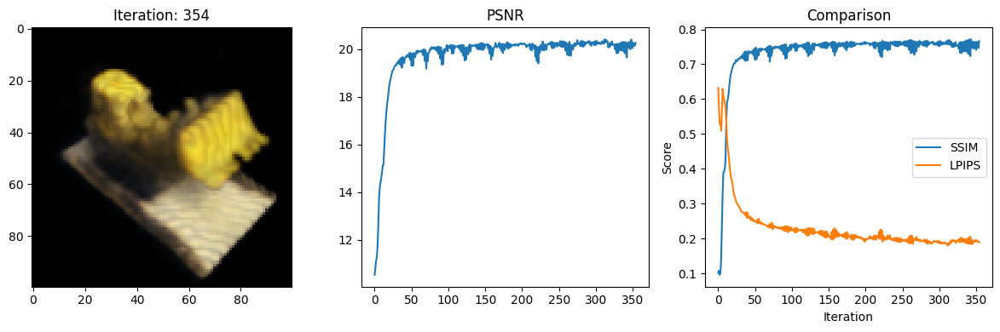

Data saved to: metrics.csv
355 8.976845979690552 secs per iter
Iteration: 355,PSNR: 20.26095199584961, SSIM: 0.7605547681948167, LPIPS: 0.19040510058403015


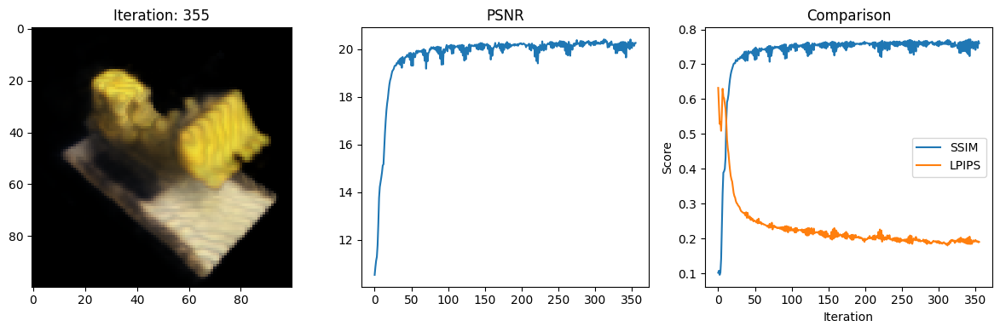

Data saved to: metrics.csv
356 8.960720300674438 secs per iter
Iteration: 356,PSNR: 20.290407180786133, SSIM: 0.7565817810122898, LPIPS: 0.19129428267478943


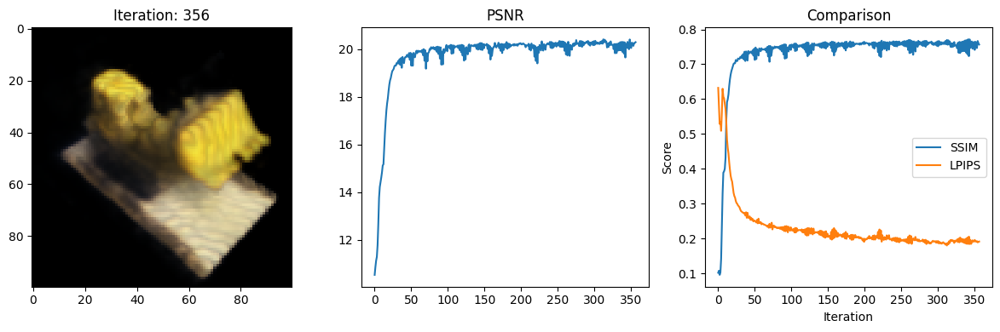

Data saved to: metrics.csv
357 9.050753355026245 secs per iter
Iteration: 357,PSNR: 20.2680606842041, SSIM: 0.766509120638109, LPIPS: 0.1875305026769638


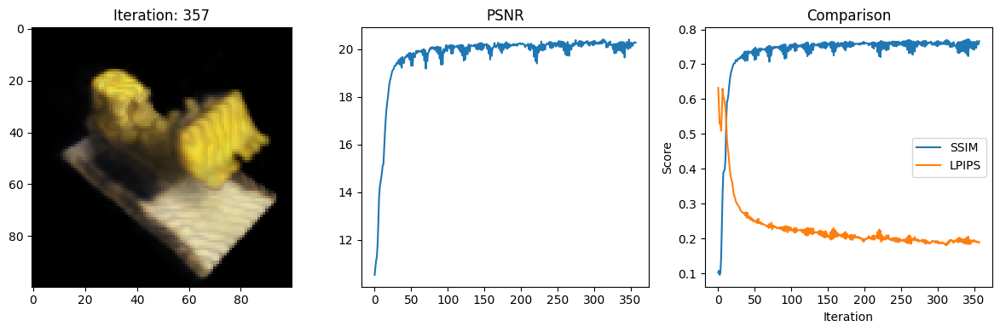

Data saved to: metrics.csv
358 9.077894687652588 secs per iter
Iteration: 358,PSNR: 20.256162643432617, SSIM: 0.7570965335057119, LPIPS: 0.19217504560947418


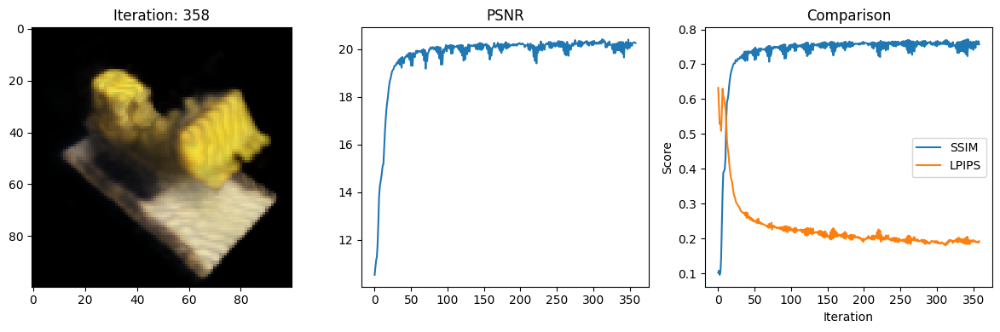

Data saved to: metrics.csv
359 9.013206720352173 secs per iter
Iteration: 359,PSNR: 20.434093475341797, SSIM: 0.7675991498809078, LPIPS: 0.18771326541900635


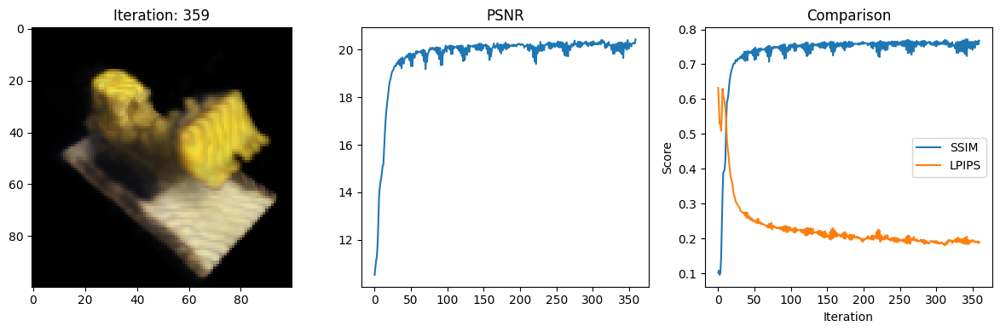

Data saved to: metrics.csv
360 8.950727939605713 secs per iter
Iteration: 360,PSNR: 20.223155975341797, SSIM: 0.7585197608845969, LPIPS: 0.1914704144001007


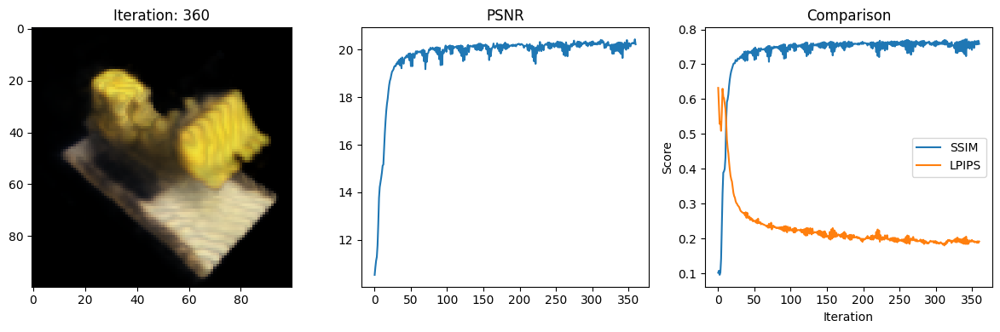

Data saved to: metrics.csv
361 9.047569513320923 secs per iter
Iteration: 361,PSNR: 20.4011287689209, SSIM: 0.7661792604568468, LPIPS: 0.18744879961013794


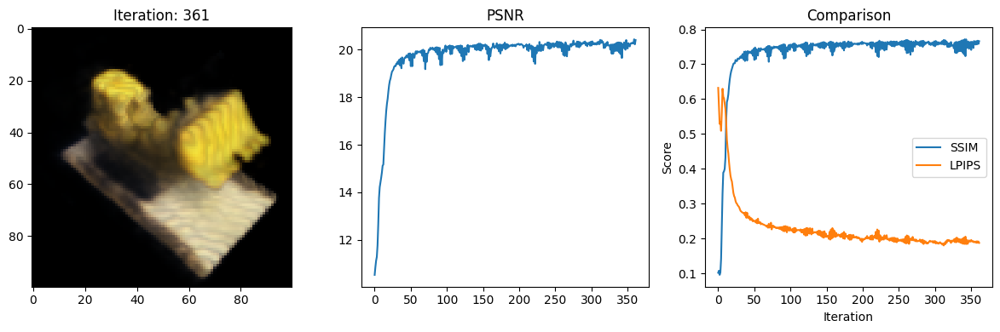

Data saved to: metrics.csv
362 9.02074909210205 secs per iter
Iteration: 362,PSNR: 20.249038696289062, SSIM: 0.7602714381657499, LPIPS: 0.1898413598537445


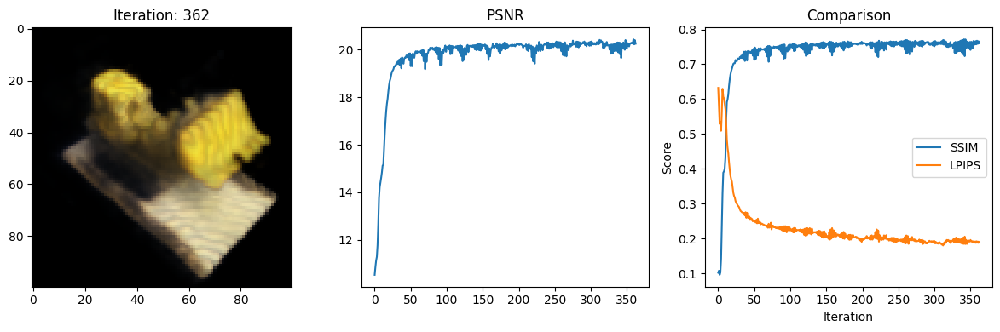

Data saved to: metrics.csv
363 8.976866722106934 secs per iter
Iteration: 363,PSNR: 20.323972702026367, SSIM: 0.7641751948207048, LPIPS: 0.18568101525306702


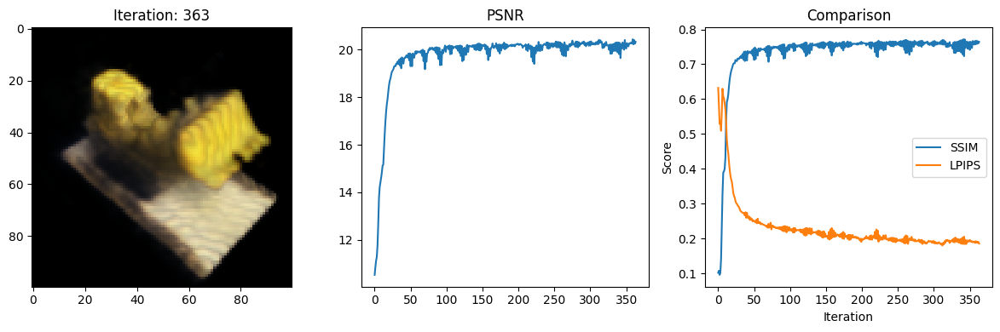

Data saved to: metrics.csv
364 9.006835460662842 secs per iter
Iteration: 364,PSNR: 20.292644500732422, SSIM: 0.7589370178984852, LPIPS: 0.19047576189041138


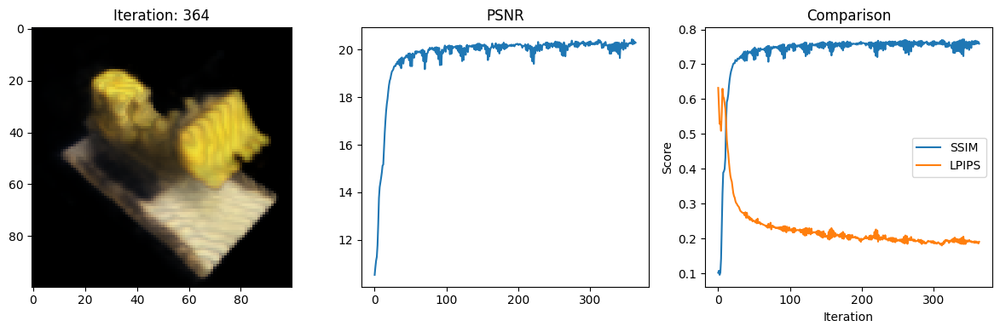

Data saved to: metrics.csv
365 9.000623226165771 secs per iter
Iteration: 365,PSNR: 20.32828140258789, SSIM: 0.7649154463018673, LPIPS: 0.18431444466114044


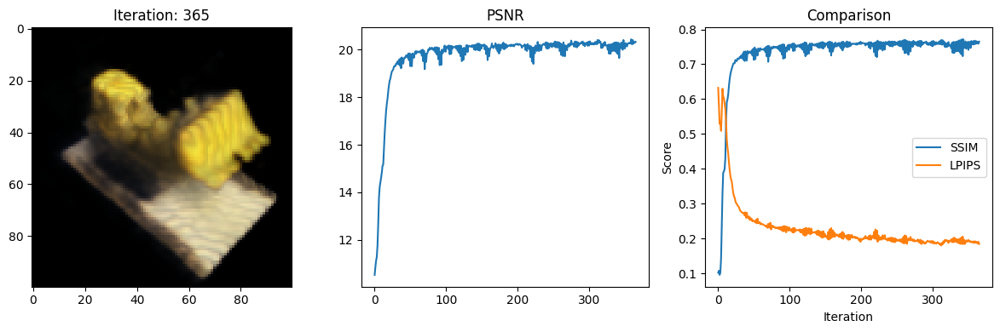

Data saved to: metrics.csv
366 9.00515604019165 secs per iter
Iteration: 366,PSNR: 20.25607681274414, SSIM: 0.7598681180184613, LPIPS: 0.18932661414146423


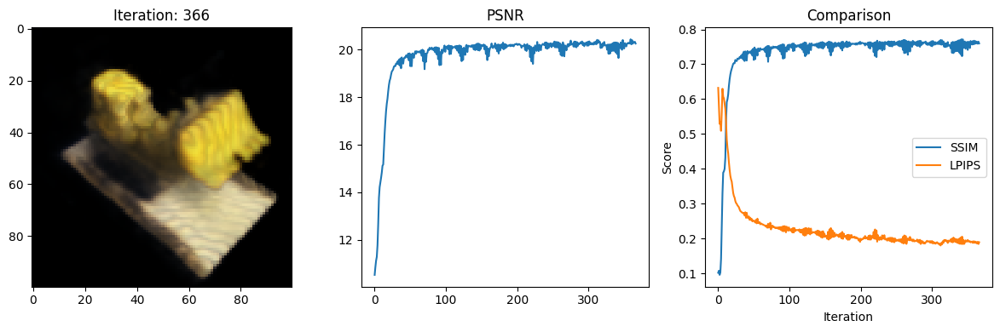

Data saved to: metrics.csv
367 9.26954460144043 secs per iter
Iteration: 367,PSNR: 20.41640853881836, SSIM: 0.7686968091706351, LPIPS: 0.18224738538265228


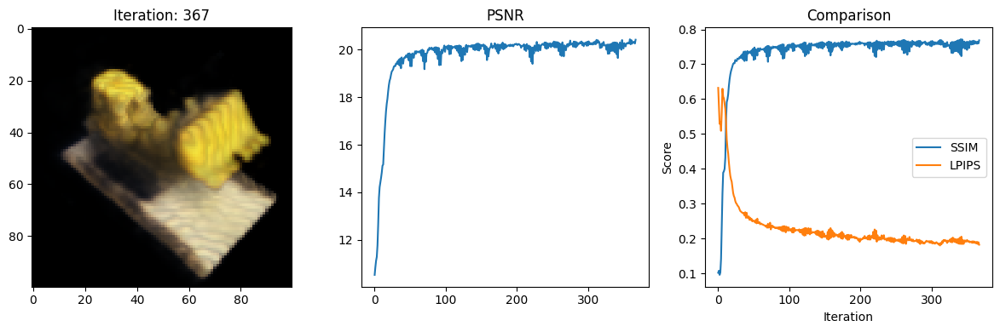

Data saved to: metrics.csv
368 8.899479150772095 secs per iter
Iteration: 368,PSNR: 20.31960105895996, SSIM: 0.7632733553778749, LPIPS: 0.18790480494499207


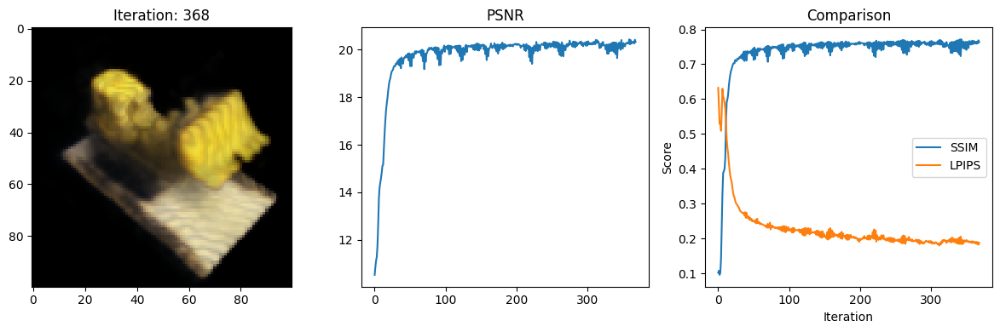

Data saved to: metrics.csv
369 9.003237009048462 secs per iter
Iteration: 369,PSNR: 20.37487030029297, SSIM: 0.7641770959569948, LPIPS: 0.18282921612262726


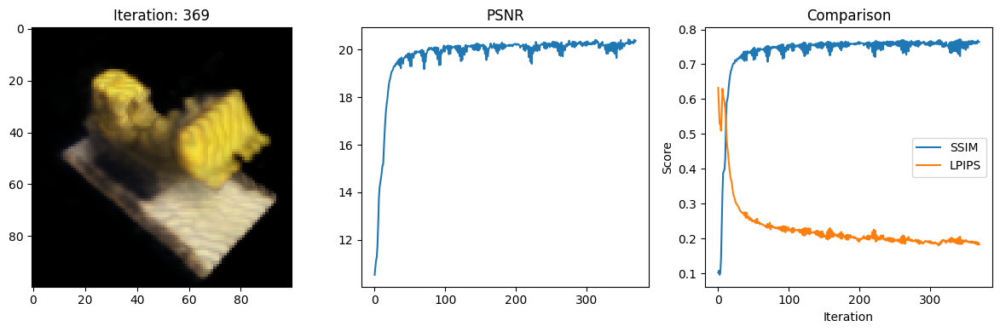

Data saved to: metrics.csv
370 8.975642919540405 secs per iter
Iteration: 370,PSNR: 20.332351684570312, SSIM: 0.7673207804627022, LPIPS: 0.1859636753797531


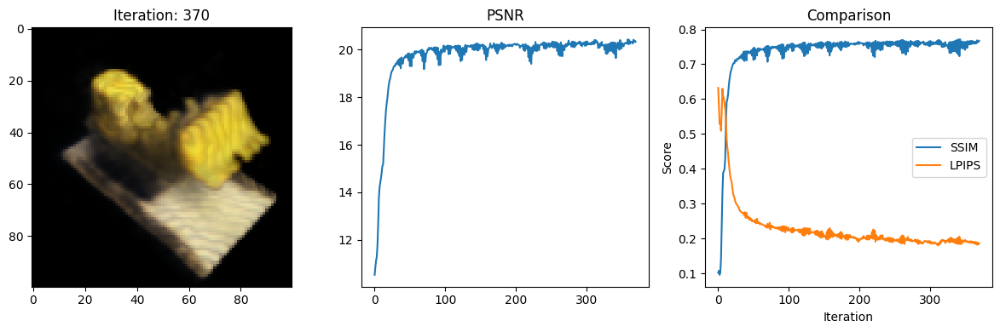

Data saved to: metrics.csv
371 8.940674781799316 secs per iter
Iteration: 371,PSNR: 20.24382781982422, SSIM: 0.7588409566290801, LPIPS: 0.18474134802818298


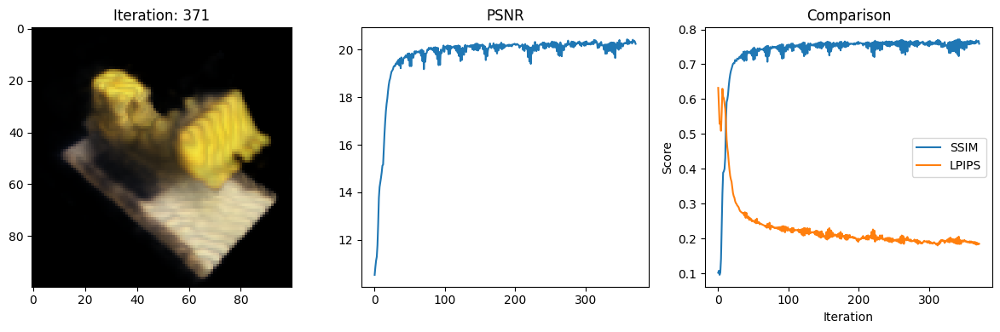

Data saved to: metrics.csv
372 9.042071342468262 secs per iter
Iteration: 372,PSNR: 20.269550323486328, SSIM: 0.7639610230945412, LPIPS: 0.18870049715042114


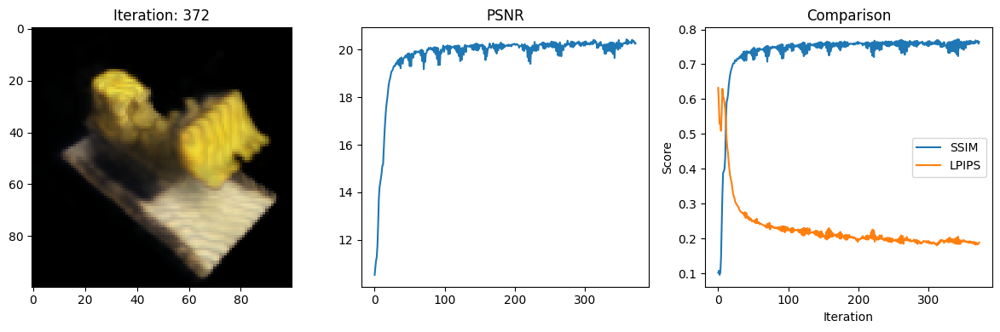

Data saved to: metrics.csv
373 8.995206117630005 secs per iter
Iteration: 373,PSNR: 20.156410217285156, SSIM: 0.7537094341983775, LPIPS: 0.1919671595096588


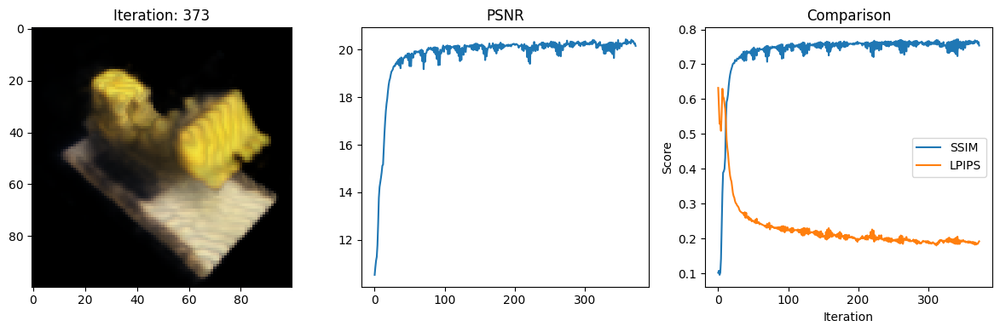

Data saved to: metrics.csv
374 8.991698980331421 secs per iter
Iteration: 374,PSNR: 20.284727096557617, SSIM: 0.7628993310955363, LPIPS: 0.1900387853384018


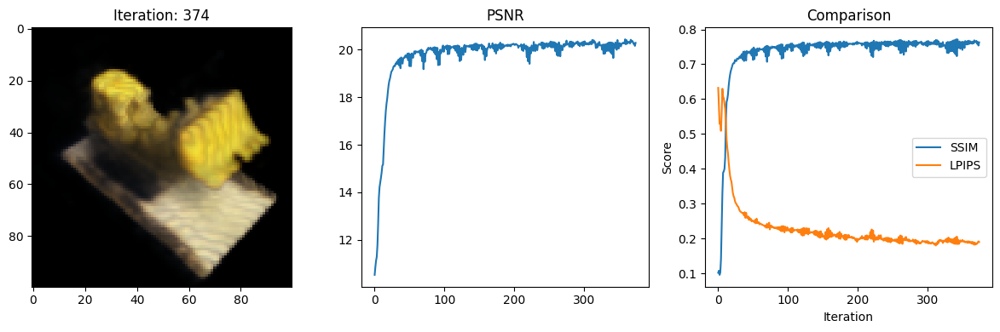

Data saved to: metrics.csv
375 8.939675092697144 secs per iter
Iteration: 375,PSNR: 20.134628295898438, SSIM: 0.7519655411243954, LPIPS: 0.1922864317893982


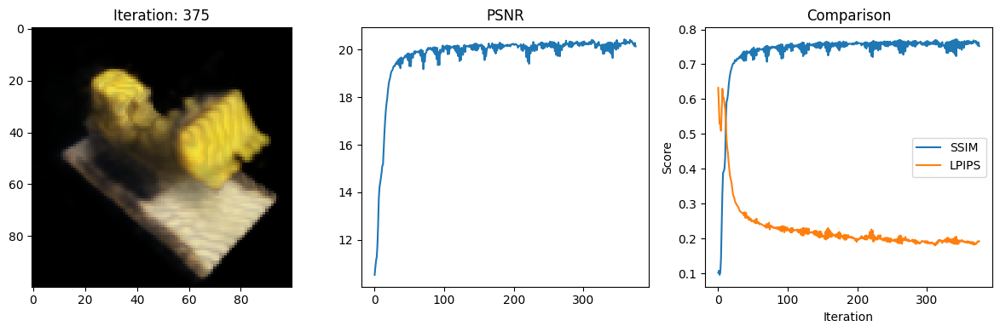

Data saved to: metrics.csv
376 8.943501949310303 secs per iter
Iteration: 376,PSNR: 20.283443450927734, SSIM: 0.7628021335105184, LPIPS: 0.18757466971874237


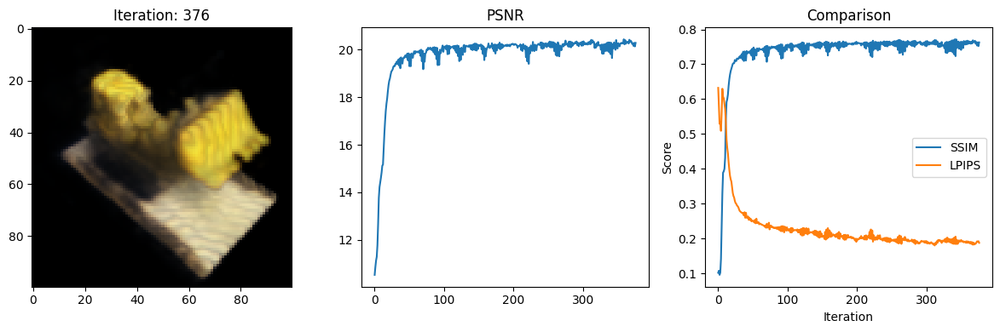

Data saved to: metrics.csv
377 8.988533020019531 secs per iter
Iteration: 377,PSNR: 20.158002853393555, SSIM: 0.7539465681885078, LPIPS: 0.1921544373035431


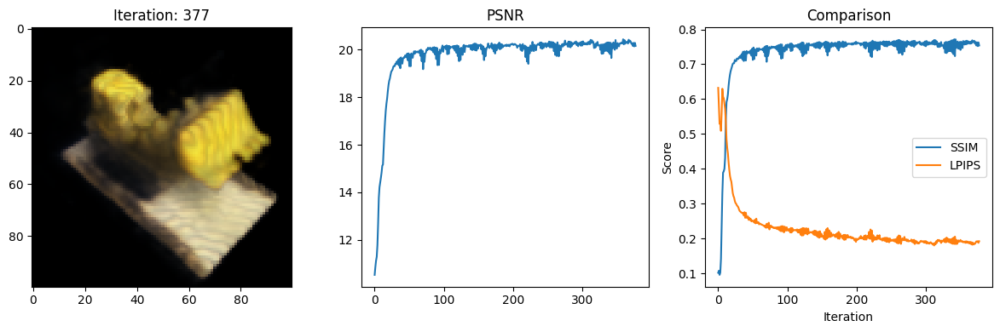

Data saved to: metrics.csv
378 8.96640920639038 secs per iter
Iteration: 378,PSNR: 20.32990264892578, SSIM: 0.7669362514835343, LPIPS: 0.1842637062072754


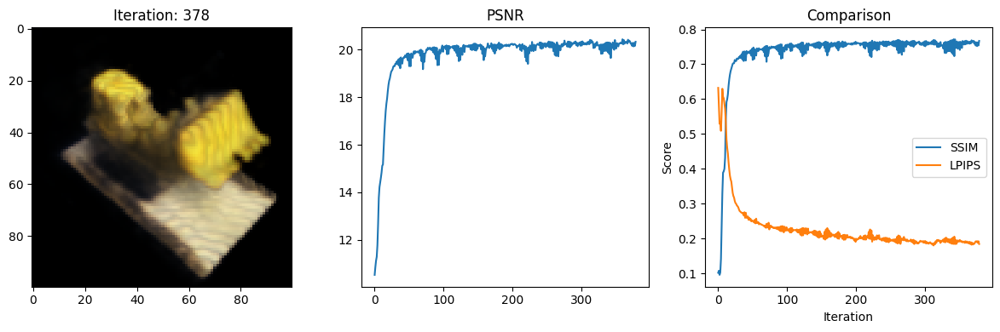

Data saved to: metrics.csv
379 8.915165662765503 secs per iter
Iteration: 379,PSNR: 20.11886215209961, SSIM: 0.7503416560109434, LPIPS: 0.19026166200637817


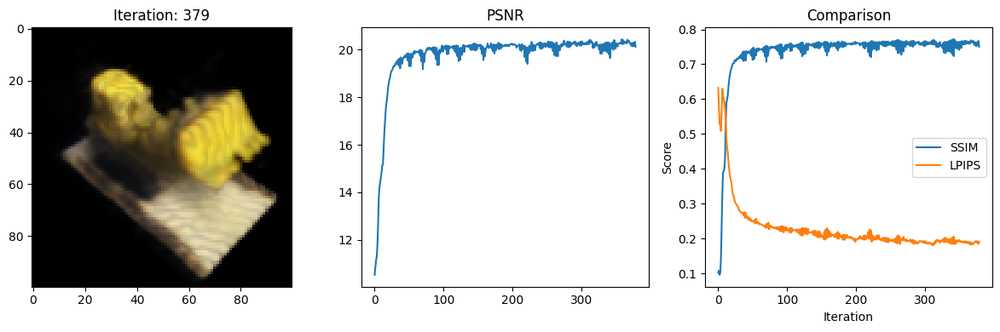

Data saved to: metrics.csv
380 9.00350570678711 secs per iter
Iteration: 380,PSNR: 20.34636116027832, SSIM: 0.7695912257679681, LPIPS: 0.18193885684013367


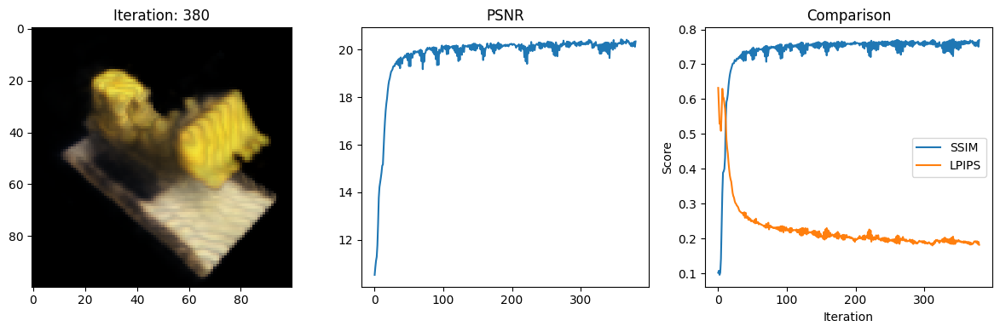

Data saved to: metrics.csv
381 8.928595304489136 secs per iter
Iteration: 381,PSNR: 20.062538146972656, SSIM: 0.7486819233125015, LPIPS: 0.19058090448379517


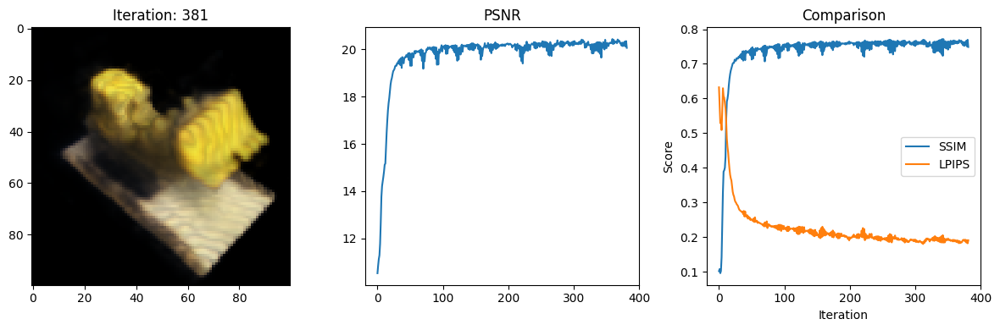

Data saved to: metrics.csv
382 8.950217723846436 secs per iter
Iteration: 382,PSNR: 20.374223709106445, SSIM: 0.7712036516199957, LPIPS: 0.18045274913311005


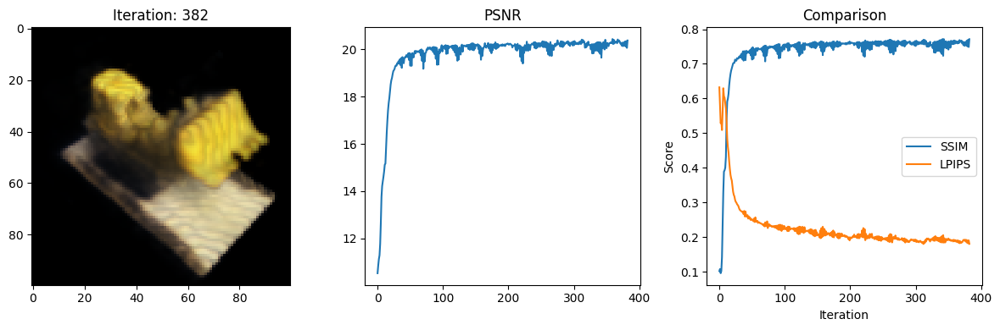

Data saved to: metrics.csv
383 9.010123491287231 secs per iter
Iteration: 383,PSNR: 20.138202667236328, SSIM: 0.7514912103240614, LPIPS: 0.18789026141166687


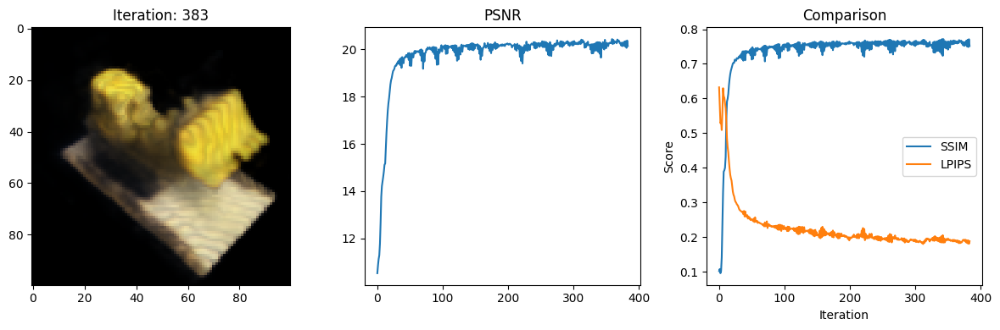

Data saved to: metrics.csv
384 9.449659824371338 secs per iter
Iteration: 384,PSNR: 20.37348175048828, SSIM: 0.7710247872326619, LPIPS: 0.18198207020759583


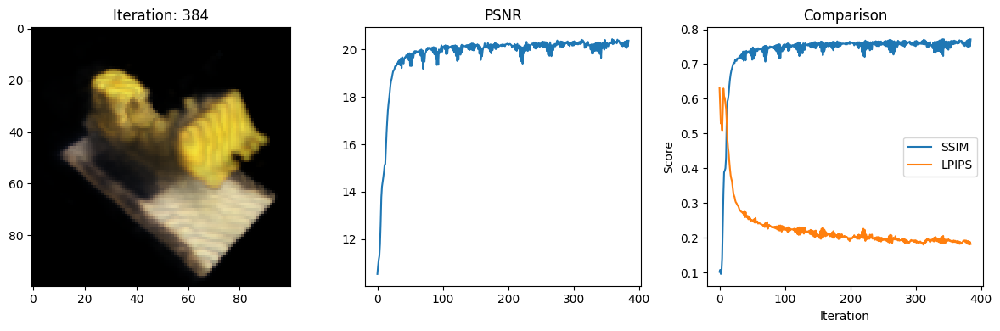

Data saved to: metrics.csv
385 9.328047513961792 secs per iter
Iteration: 385,PSNR: 20.179656982421875, SSIM: 0.7552001348266636, LPIPS: 0.18978619575500488


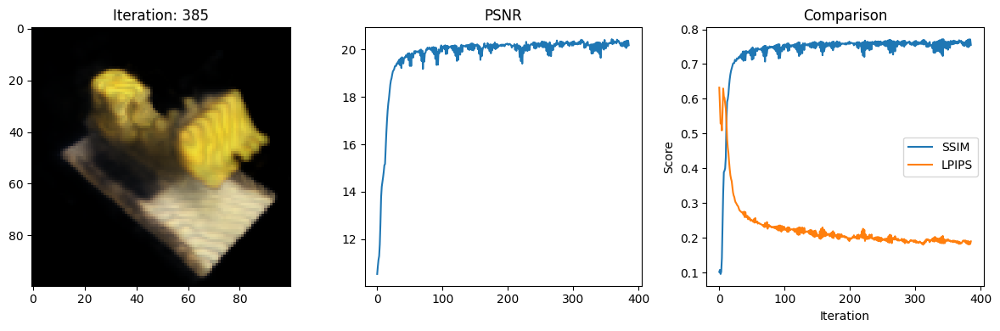

Data saved to: metrics.csv
386 9.253334283828735 secs per iter
Iteration: 386,PSNR: 20.321130752563477, SSIM: 0.7637269238537545, LPIPS: 0.17994830012321472


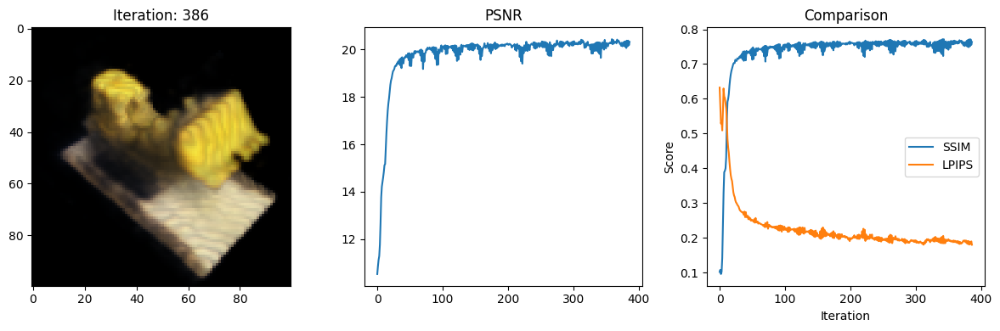

Data saved to: metrics.csv
387 9.223217725753784 secs per iter
Iteration: 387,PSNR: 20.309642791748047, SSIM: 0.7666516801412344, LPIPS: 0.18553884327411652


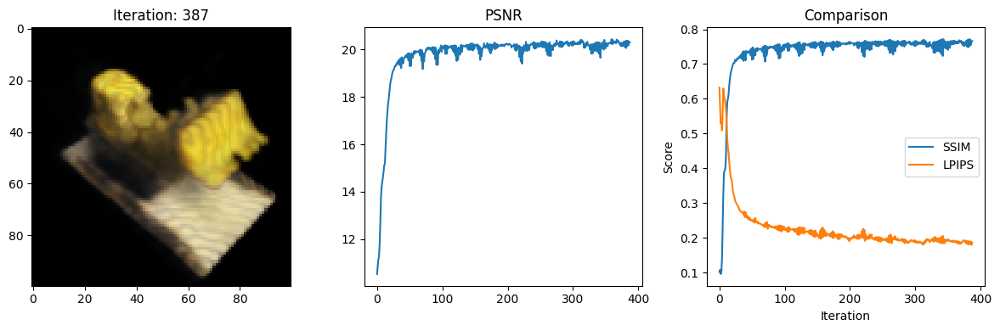

Data saved to: metrics.csv
388 9.184602737426758 secs per iter
Iteration: 388,PSNR: 20.065080642700195, SSIM: 0.7490483582854832, LPIPS: 0.18795299530029297


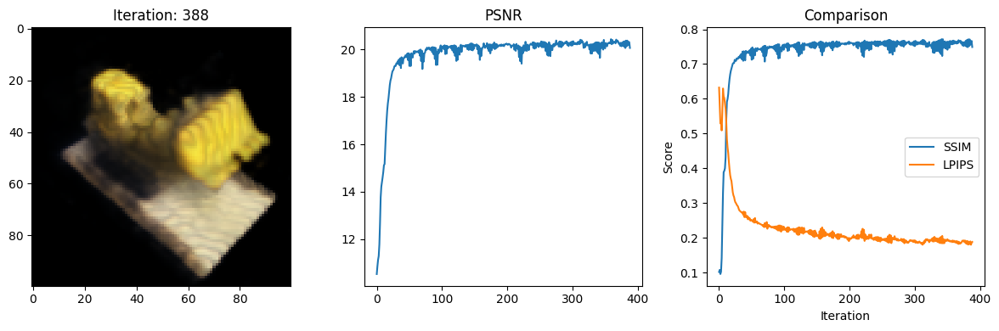

Data saved to: metrics.csv
389 9.512409687042236 secs per iter
Iteration: 389,PSNR: 20.285890579223633, SSIM: 0.7688203451816197, LPIPS: 0.1897139698266983


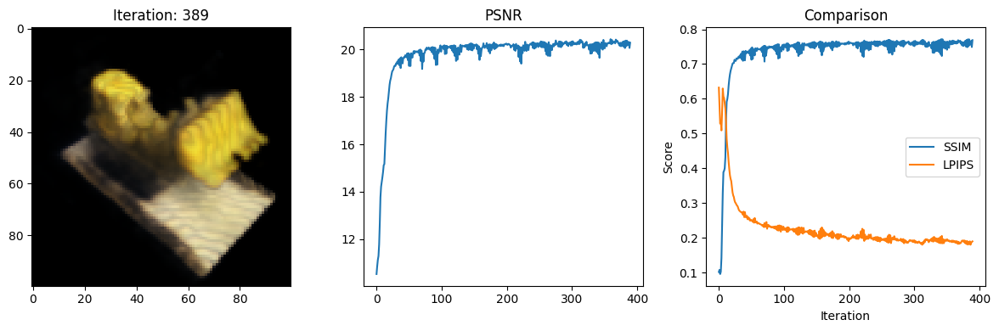

Data saved to: metrics.csv
390 9.21711254119873 secs per iter
Iteration: 390,PSNR: 20.15699577331543, SSIM: 0.7567263395520184, LPIPS: 0.19197483360767365


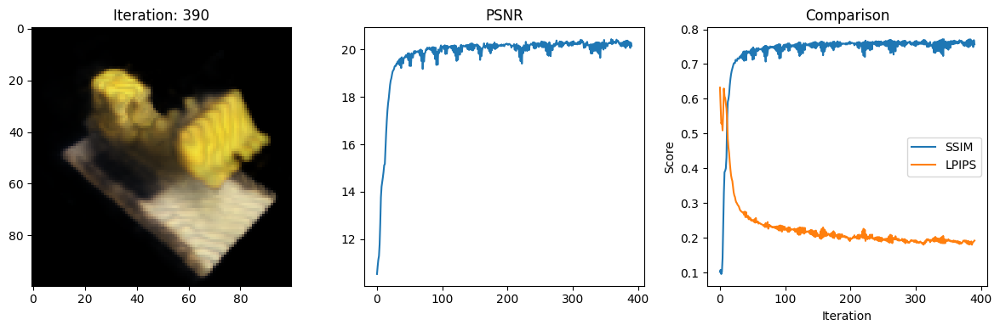

Data saved to: metrics.csv
391 9.466081380844116 secs per iter
Iteration: 391,PSNR: 20.422943115234375, SSIM: 0.7644398473195971, LPIPS: 0.18808934092521667


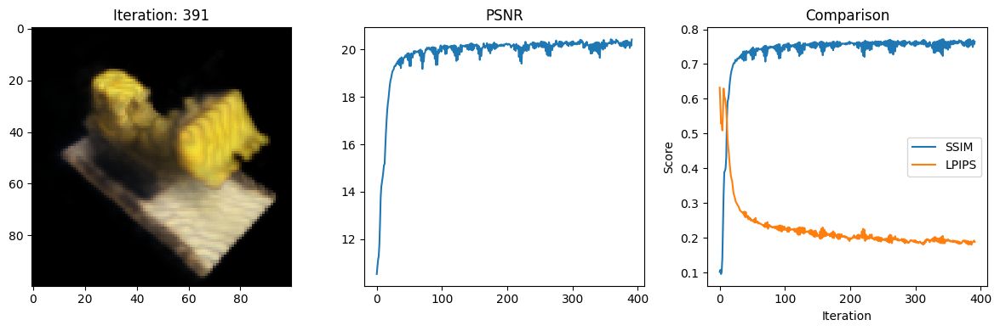

Data saved to: metrics.csv
392 9.202353477478027 secs per iter
Iteration: 392,PSNR: 20.17120361328125, SSIM: 0.7645195221517364, LPIPS: 0.18965661525726318


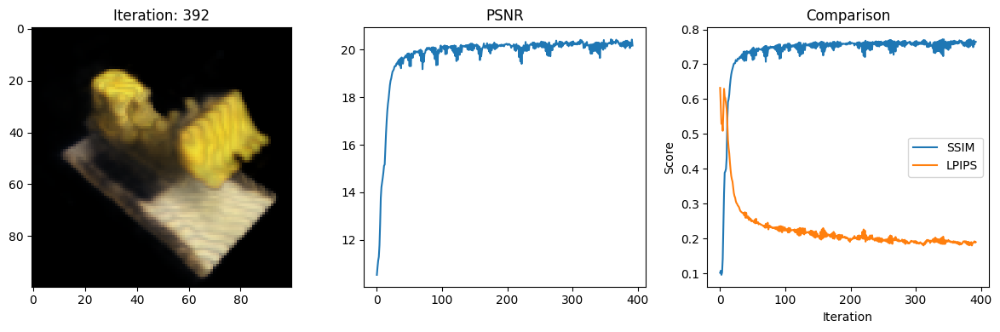

Data saved to: metrics.csv
393 9.38357162475586 secs per iter
Iteration: 393,PSNR: 20.059555053710938, SSIM: 0.747099656962961, LPIPS: 0.19279828667640686


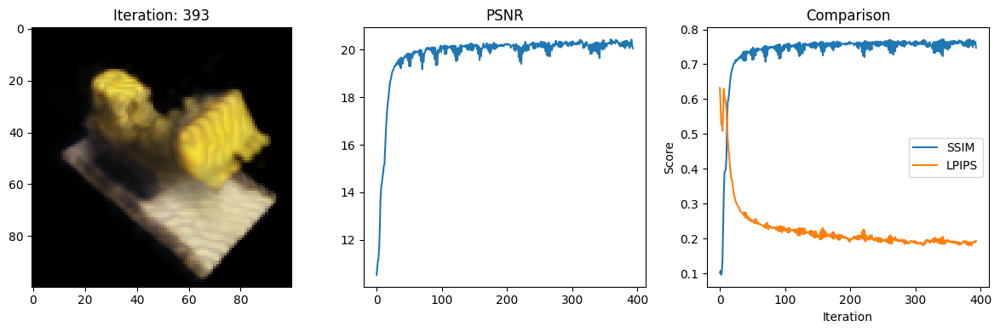

Data saved to: metrics.csv
394 9.2362802028656 secs per iter
Iteration: 394,PSNR: 20.287765502929688, SSIM: 0.7685770148485555, LPIPS: 0.1881585419178009


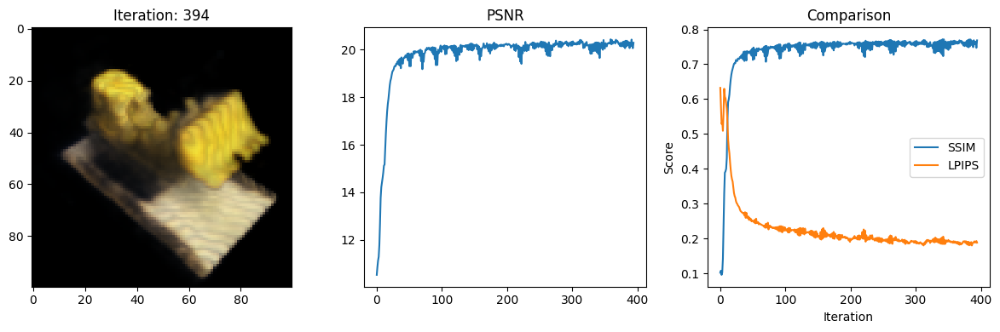

Data saved to: metrics.csv
395 9.29911994934082 secs per iter
Iteration: 395,PSNR: 20.041275024414062, SSIM: 0.75163916434509, LPIPS: 0.19408360123634338


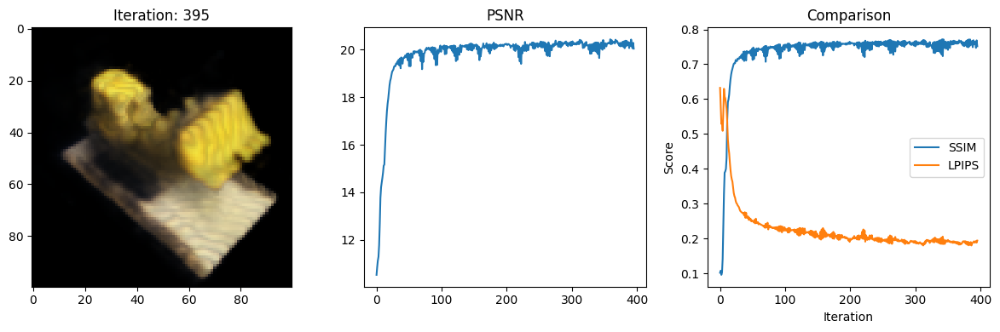

Data saved to: metrics.csv
396 9.180318355560303 secs per iter
Iteration: 396,PSNR: 20.38554573059082, SSIM: 0.7666425442231527, LPIPS: 0.1866535097360611


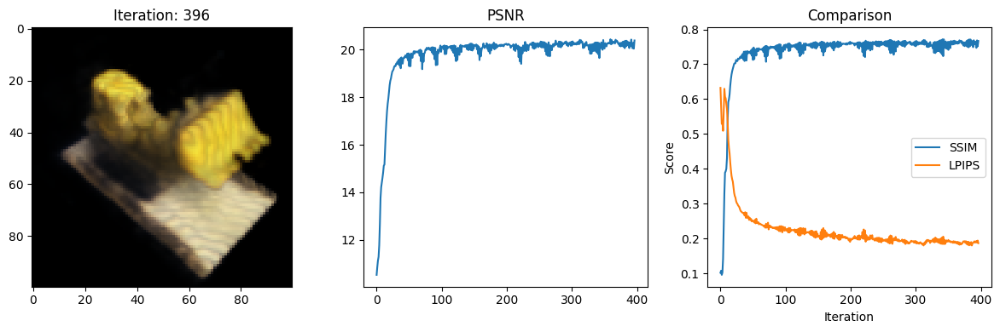

Data saved to: metrics.csv
397 9.43478775024414 secs per iter
Iteration: 397,PSNR: 20.162044525146484, SSIM: 0.7635292074864489, LPIPS: 0.1882183849811554


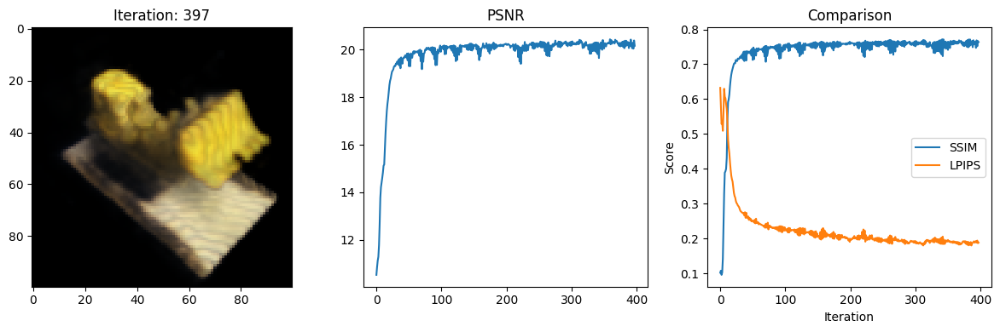

Data saved to: metrics.csv
398 9.198670148849487 secs per iter
Iteration: 398,PSNR: 19.99256706237793, SSIM: 0.7440523446280457, LPIPS: 0.19173923134803772


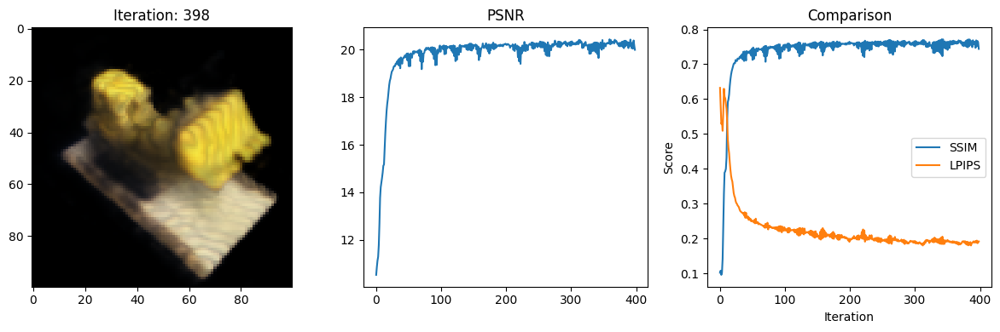

Data saved to: metrics.csv
399 9.522607803344727 secs per iter
Iteration: 399,PSNR: 20.19747543334961, SSIM: 0.7696392376003711, LPIPS: 0.18734446167945862


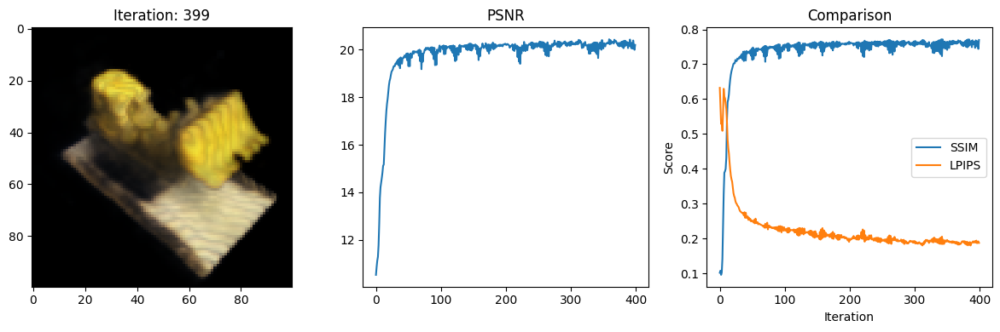

Data saved to: metrics.csv
400 9.831588506698608 secs per iter
Iteration: 400,PSNR: 20.25249481201172, SSIM: 0.7618973034824315, LPIPS: 0.18771721422672272


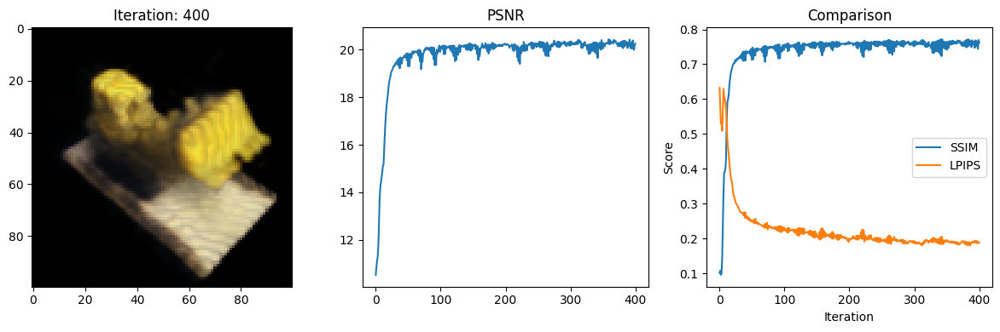

Data saved to: metrics.csv
401 9.127365350723267 secs per iter
Iteration: 401,PSNR: 20.37047576904297, SSIM: 0.7621873254835251, LPIPS: 0.18628333508968353


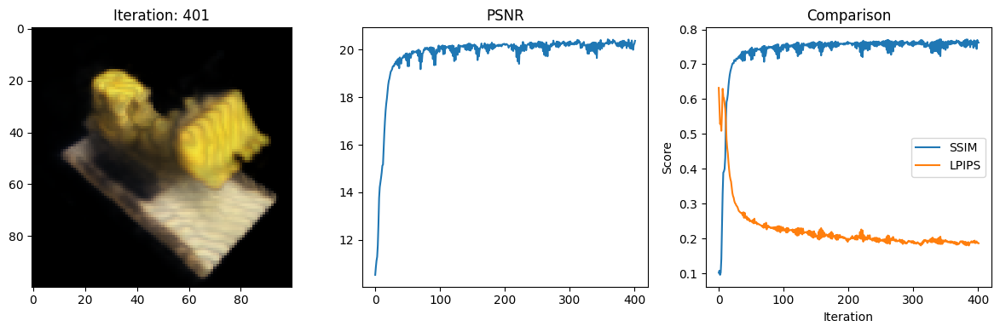

Data saved to: metrics.csv
402 9.440377712249756 secs per iter
Iteration: 402,PSNR: 20.206893920898438, SSIM: 0.7691712711139767, LPIPS: 0.18632321059703827


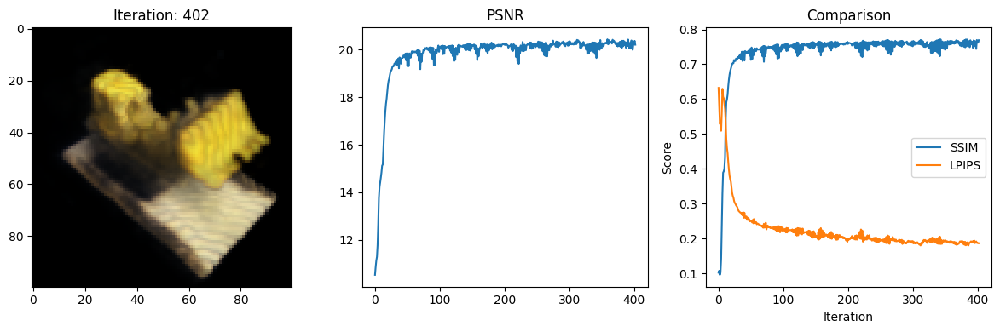

Data saved to: metrics.csv
403 9.268930196762085 secs per iter
Iteration: 403,PSNR: 20.17876625061035, SSIM: 0.7531206578816271, LPIPS: 0.1900845170021057


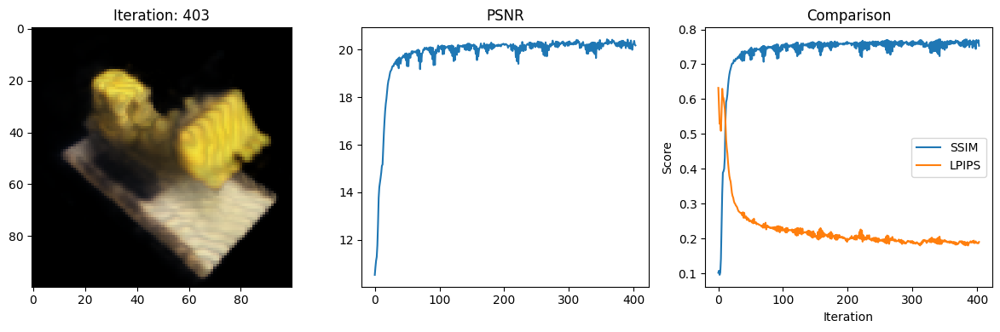

Data saved to: metrics.csv
404 9.265466213226318 secs per iter
Iteration: 404,PSNR: 20.39423370361328, SSIM: 0.7723207143909766, LPIPS: 0.18534082174301147


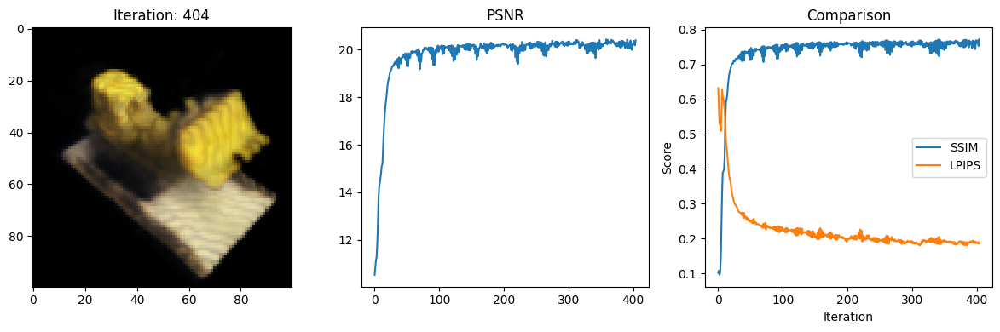

Data saved to: metrics.csv
405 9.327669143676758 secs per iter
Iteration: 405,PSNR: 20.25642967224121, SSIM: 0.7635785526026225, LPIPS: 0.18607275187969208


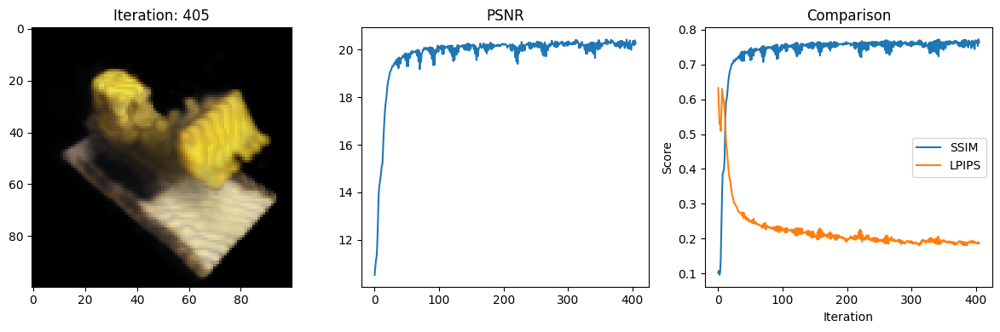

Data saved to: metrics.csv
406 9.4037184715271 secs per iter
Iteration: 406,PSNR: 20.395620346069336, SSIM: 0.7640513268714958, LPIPS: 0.18438196182250977


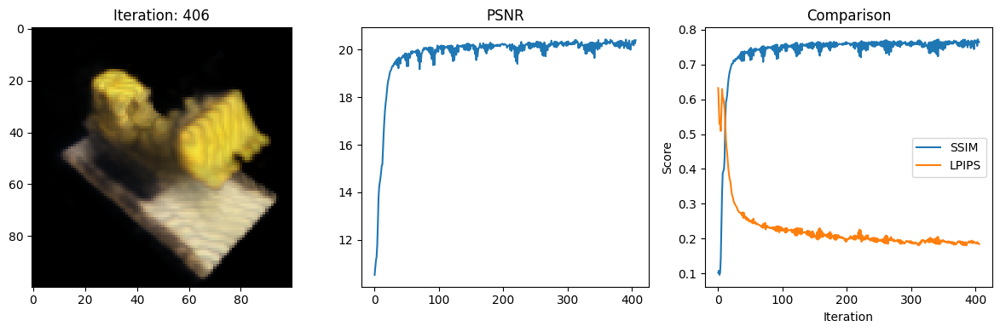

Data saved to: metrics.csv
407 9.185080528259277 secs per iter
Iteration: 407,PSNR: 20.280580520629883, SSIM: 0.7698615993181757, LPIPS: 0.1848246157169342


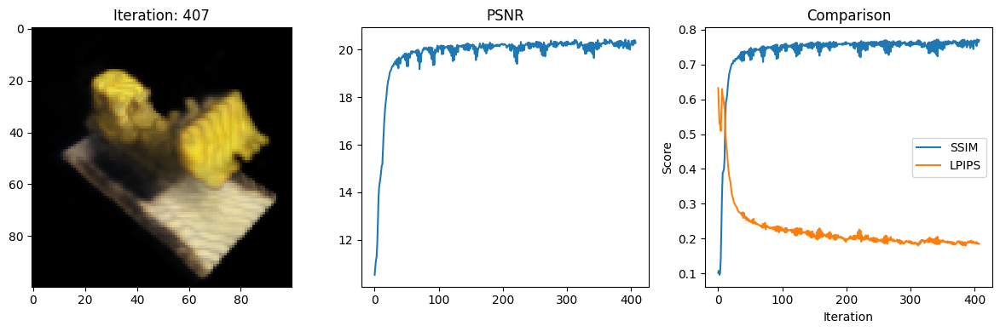

Data saved to: metrics.csv
408 9.319329977035522 secs per iter
Iteration: 408,PSNR: 20.183414459228516, SSIM: 0.7556303065381774, LPIPS: 0.18787160515785217


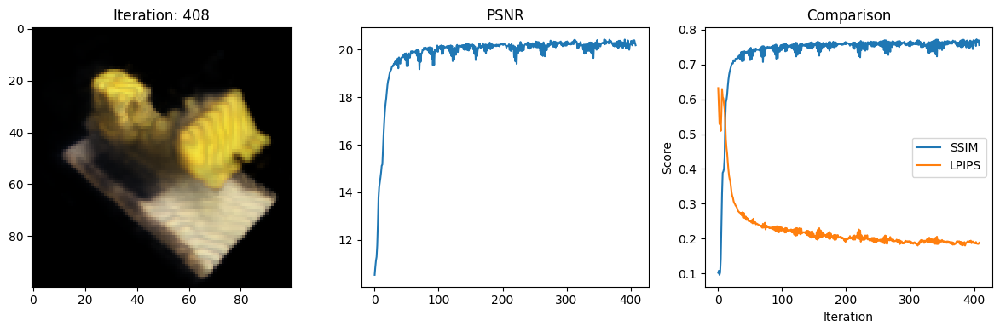

Data saved to: metrics.csv
409 9.209715843200684 secs per iter
Iteration: 409,PSNR: 20.38685417175293, SSIM: 0.7708813505643803, LPIPS: 0.18483072519302368


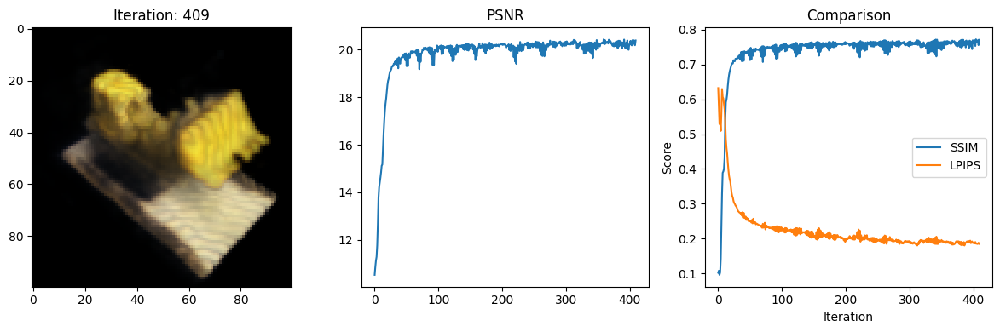

Data saved to: metrics.csv
410 9.28120756149292 secs per iter
Iteration: 410,PSNR: 20.2170467376709, SSIM: 0.7603433274673351, LPIPS: 0.18830400705337524


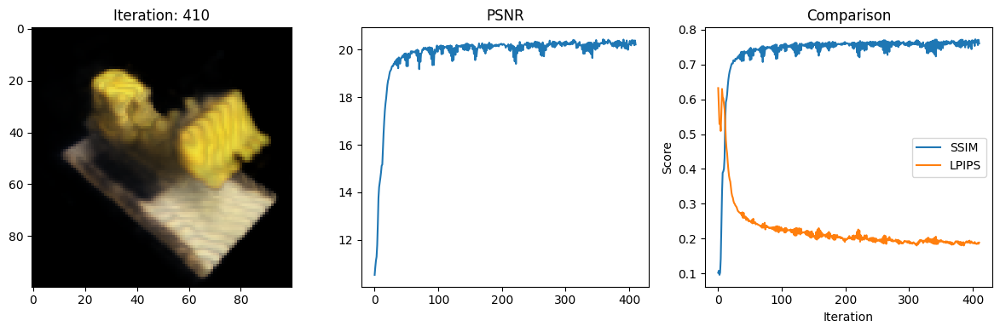

Data saved to: metrics.csv
411 9.258422613143921 secs per iter
Iteration: 411,PSNR: 20.353849411010742, SSIM: 0.7634555474777484, LPIPS: 0.18643349409103394


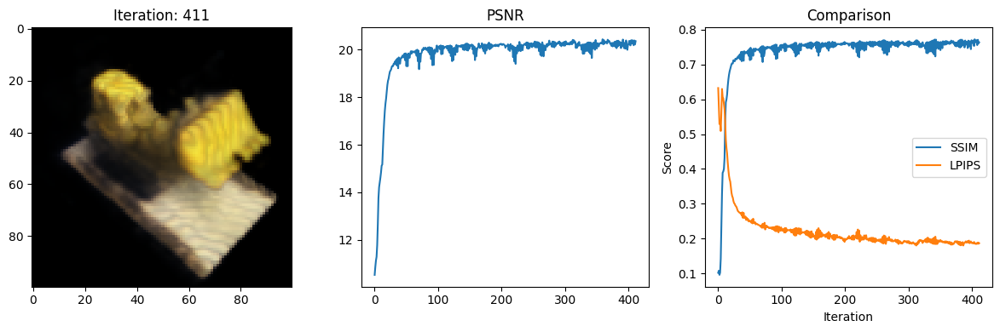

Data saved to: metrics.csv
412 9.233778238296509 secs per iter
Iteration: 412,PSNR: 20.260616302490234, SSIM: 0.7654756387408218, LPIPS: 0.18602928519248962


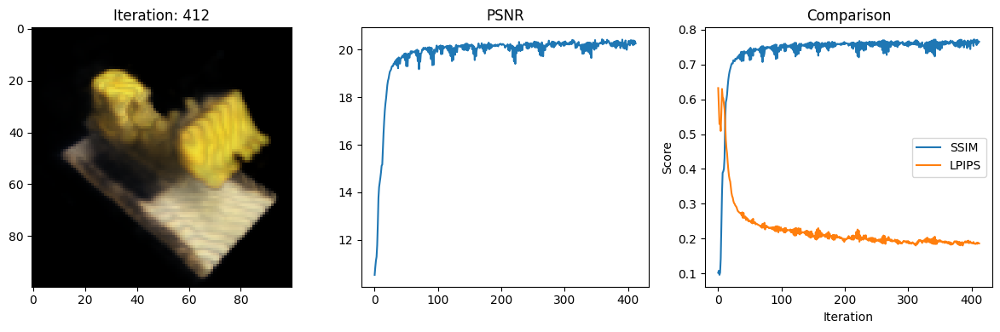

Data saved to: metrics.csv
413 9.220320701599121 secs per iter
Iteration: 413,PSNR: 20.16494369506836, SSIM: 0.7550890590771696, LPIPS: 0.19065912067890167


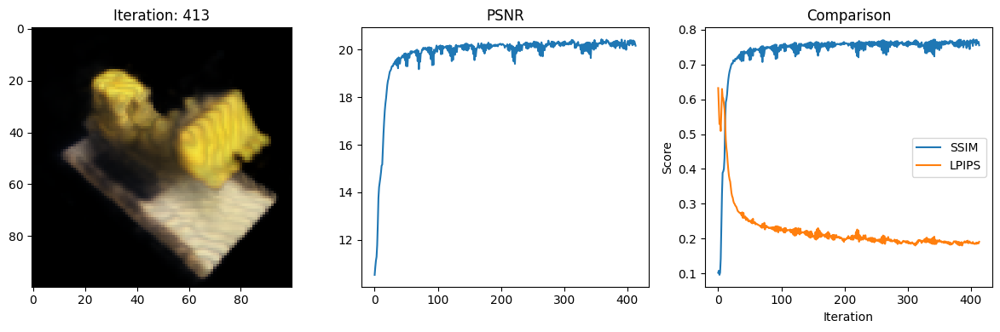

Data saved to: metrics.csv
414 9.493701934814453 secs per iter
Iteration: 414,PSNR: 20.223562240600586, SSIM: 0.764635138475632, LPIPS: 0.18931947648525238


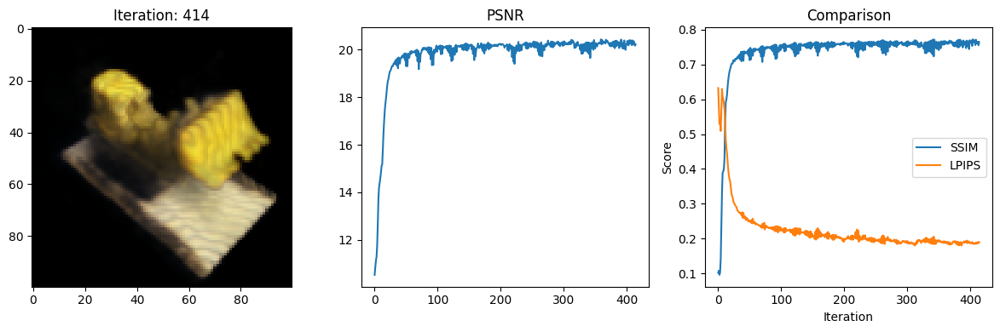

Data saved to: metrics.csv
415 9.57282567024231 secs per iter
Iteration: 415,PSNR: 20.09780502319336, SSIM: 0.7533508873664579, LPIPS: 0.19132664799690247


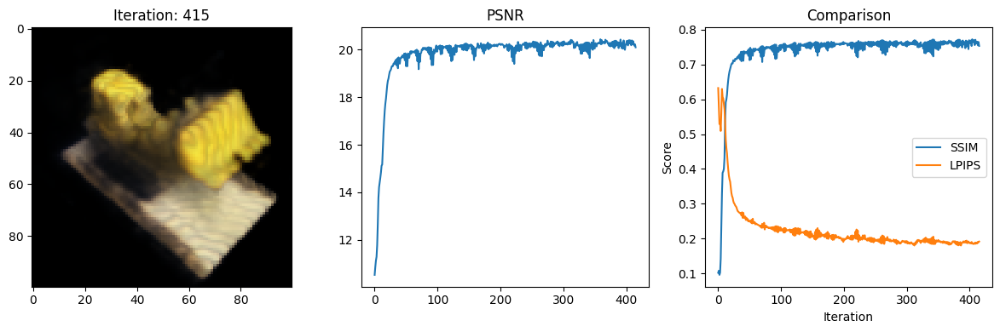

Data saved to: metrics.csv
416 9.343947410583496 secs per iter
Iteration: 416,PSNR: 20.275066375732422, SSIM: 0.765988297576142, LPIPS: 0.1878439337015152


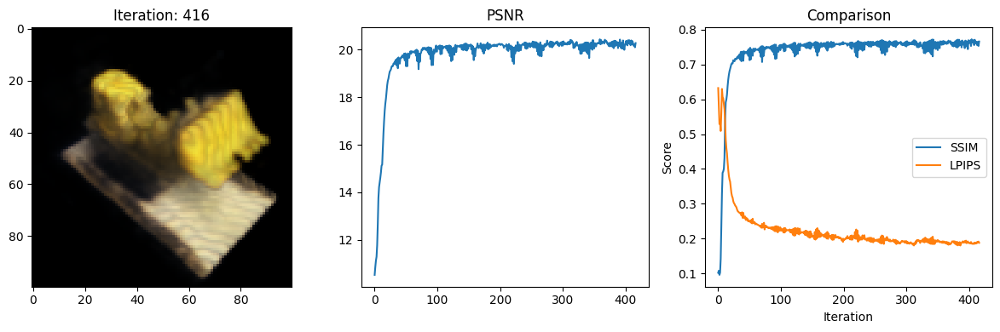

Data saved to: metrics.csv
417 9.24753189086914 secs per iter
Iteration: 417,PSNR: 20.11254119873047, SSIM: 0.7545609128004095, LPIPS: 0.19053874909877777


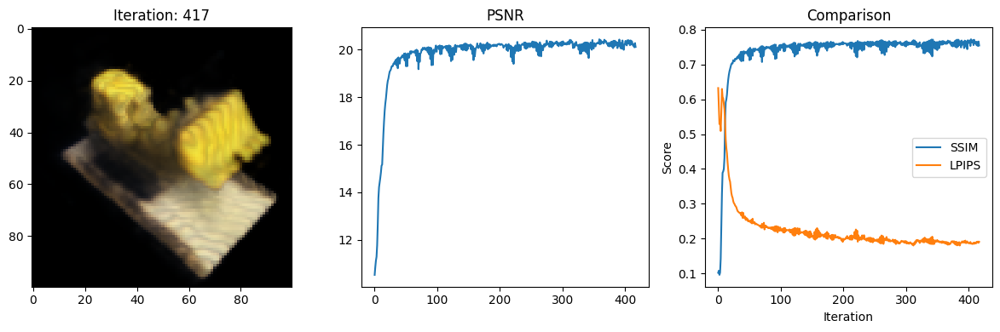

Data saved to: metrics.csv
418 9.46075439453125 secs per iter
Iteration: 418,PSNR: 20.36795997619629, SSIM: 0.7693060336027684, LPIPS: 0.18520773947238922


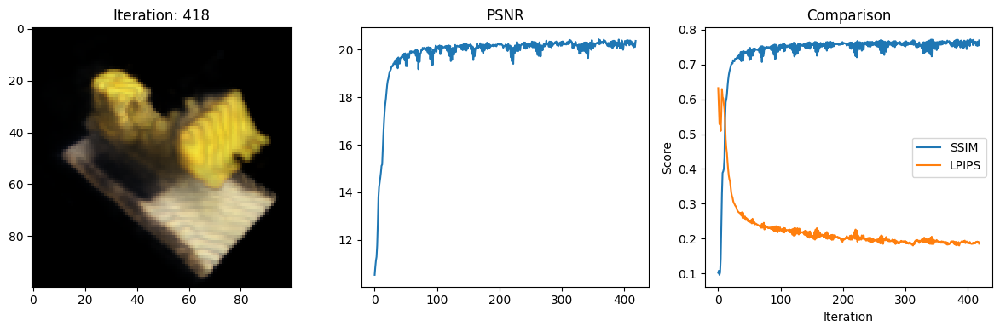

Data saved to: metrics.csv
419 9.275606632232666 secs per iter
Iteration: 419,PSNR: 20.239578247070312, SSIM: 0.7604574229513643, LPIPS: 0.18694163858890533


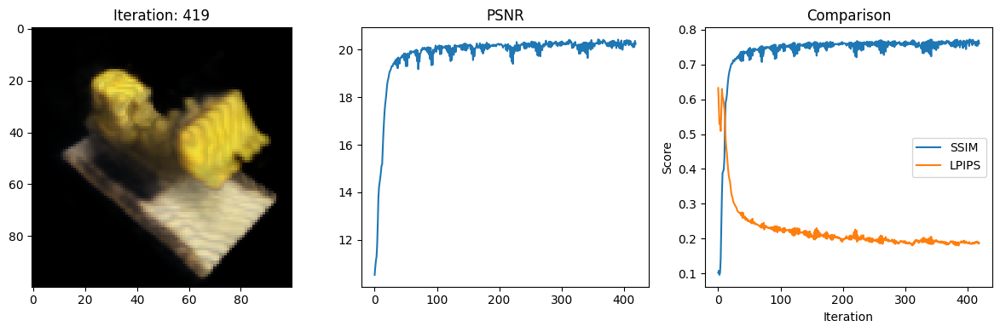

Data saved to: metrics.csv
420 9.290037155151367 secs per iter
Iteration: 420,PSNR: 20.32192039489746, SSIM: 0.7665277932684663, LPIPS: 0.1846579909324646


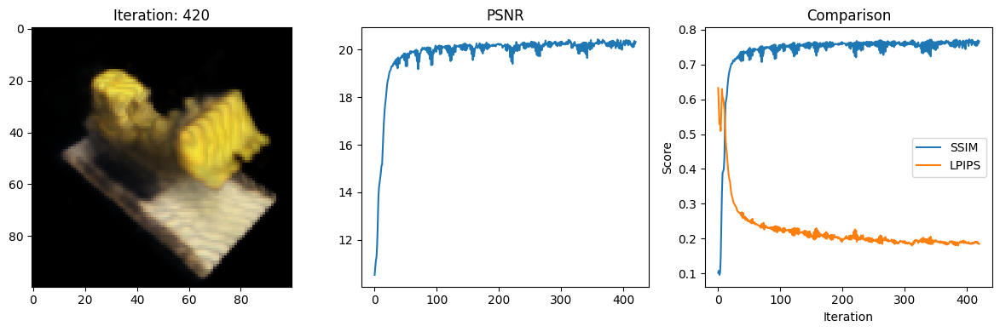

Data saved to: metrics.csv
421 9.375812768936157 secs per iter
Iteration: 421,PSNR: 20.281463623046875, SSIM: 0.7665807747774789, LPIPS: 0.1847202181816101


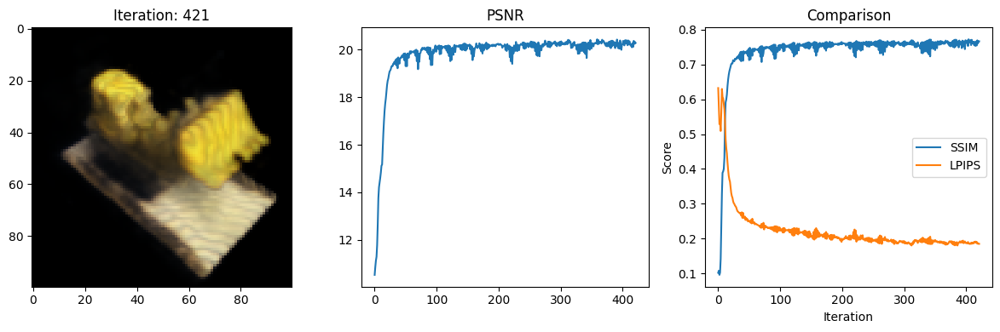

Data saved to: metrics.csv
422 9.238428115844727 secs per iter
Iteration: 422,PSNR: 20.23139762878418, SSIM: 0.7612332152375273, LPIPS: 0.1859164983034134


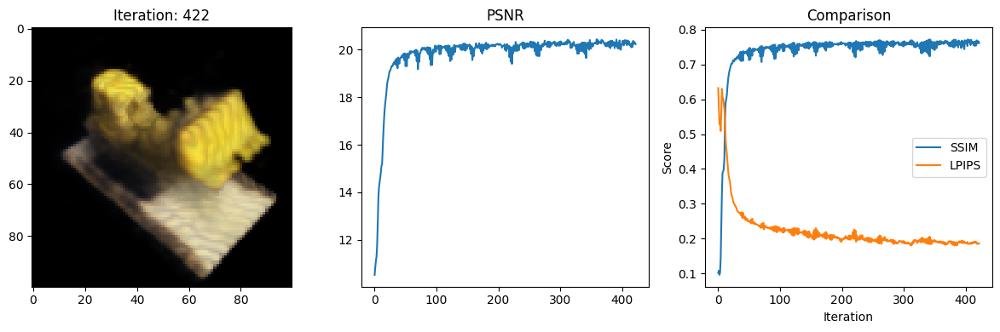

Data saved to: metrics.csv
423 9.482860088348389 secs per iter
Iteration: 423,PSNR: 20.316059112548828, SSIM: 0.7692678368738767, LPIPS: 0.18408189713954926


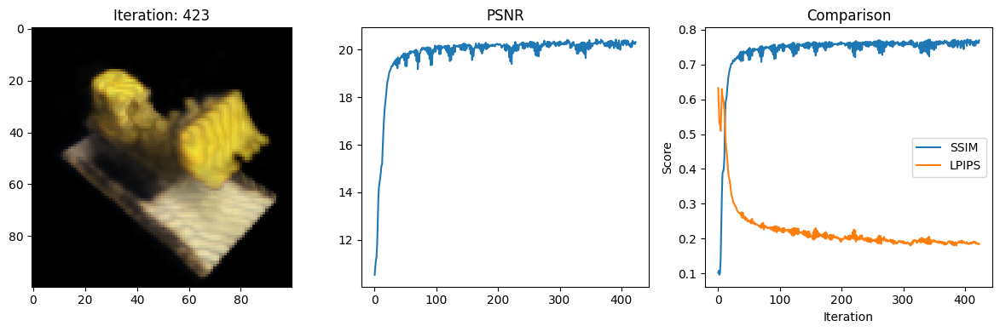

Data saved to: metrics.csv
424 9.2840576171875 secs per iter
Iteration: 424,PSNR: 20.222816467285156, SSIM: 0.7587663495494823, LPIPS: 0.18744447827339172


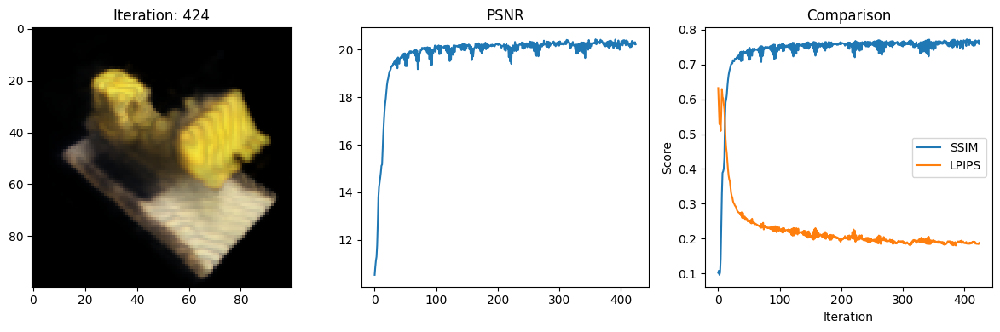

Data saved to: metrics.csv
425 9.31706166267395 secs per iter
Iteration: 425,PSNR: 20.385543823242188, SSIM: 0.7727705695551892, LPIPS: 0.18375897407531738


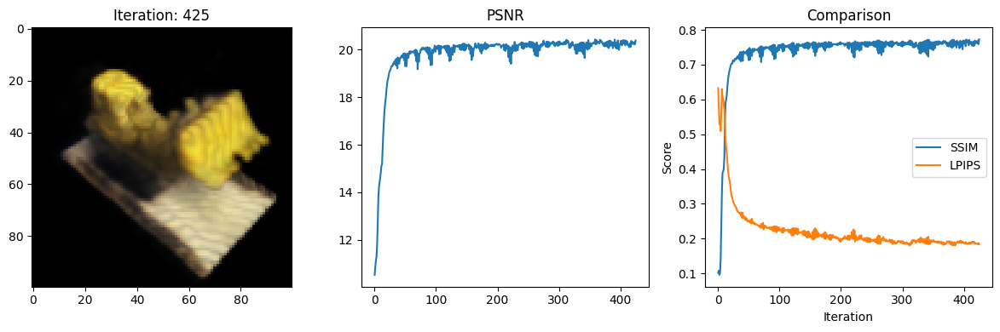

Data saved to: metrics.csv
426 9.260558366775513 secs per iter
Iteration: 426,PSNR: 20.200603485107422, SSIM: 0.7573936327607131, LPIPS: 0.18951791524887085


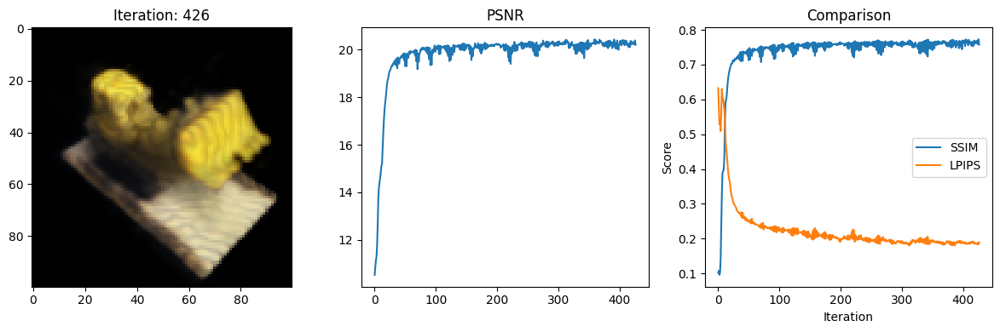

Data saved to: metrics.csv
427 9.393948554992676 secs per iter
Iteration: 427,PSNR: 20.451316833496094, SSIM: 0.7737966282082654, LPIPS: 0.18401265144348145


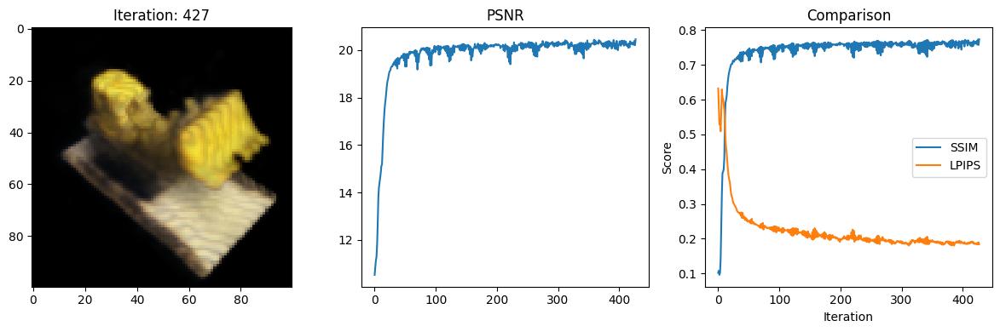

Data saved to: metrics.csv
428 9.30335521697998 secs per iter
Iteration: 428,PSNR: 20.298362731933594, SSIM: 0.762934334646009, LPIPS: 0.1865159124135971


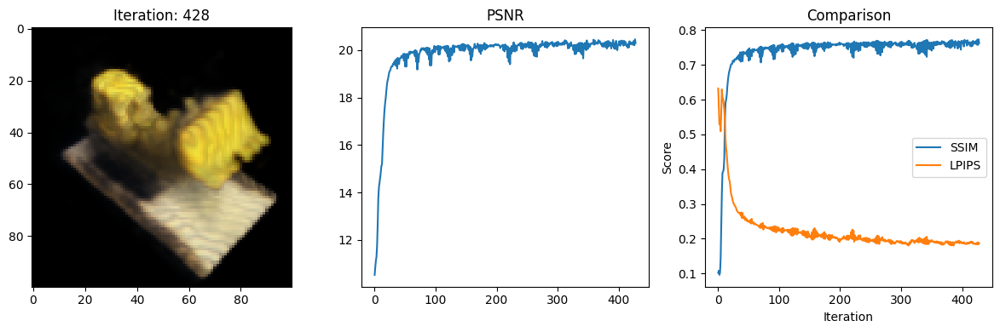

Data saved to: metrics.csv
429 9.322956323623657 secs per iter
Iteration: 429,PSNR: 20.460222244262695, SSIM: 0.7731396107607812, LPIPS: 0.18198378384113312


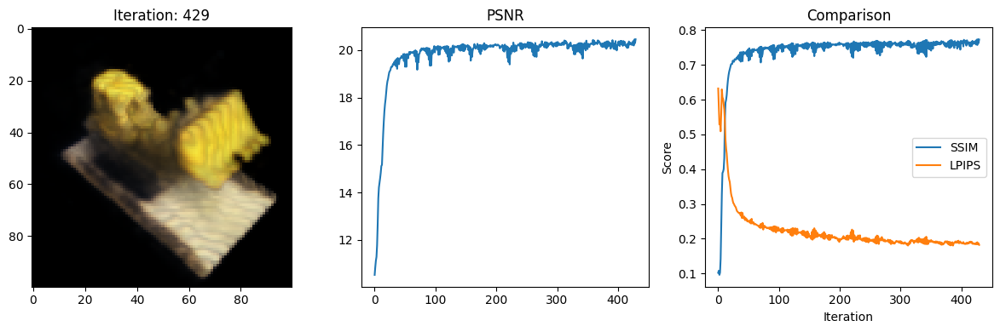

Data saved to: metrics.csv
430 9.22740912437439 secs per iter
Iteration: 430,PSNR: 20.40311050415039, SSIM: 0.7692877581912465, LPIPS: 0.18145576119422913


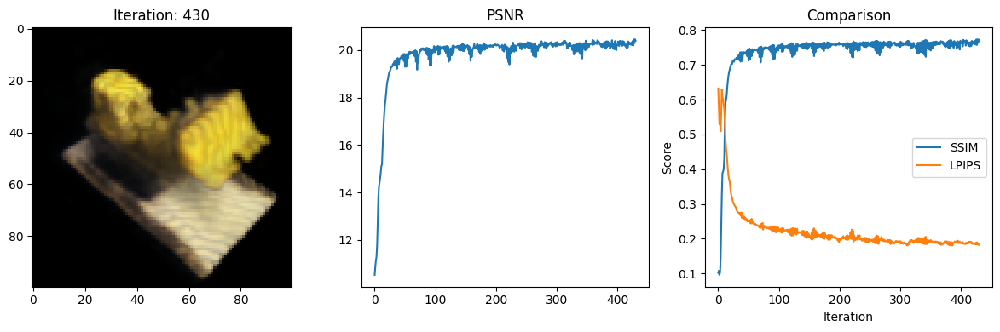

Data saved to: metrics.csv
431 9.640059471130371 secs per iter
Iteration: 431,PSNR: 20.413890838623047, SSIM: 0.7685272461556808, LPIPS: 0.1808495968580246


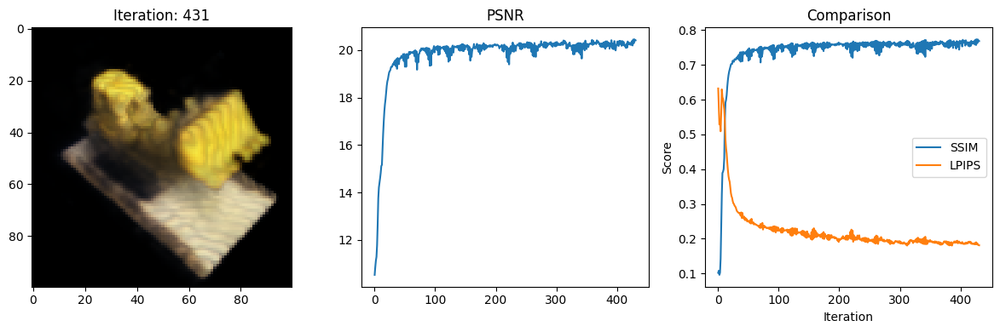

Data saved to: metrics.csv
432 9.335504293441772 secs per iter
Iteration: 432,PSNR: 20.409048080444336, SSIM: 0.7739904654920001, LPIPS: 0.17897221446037292


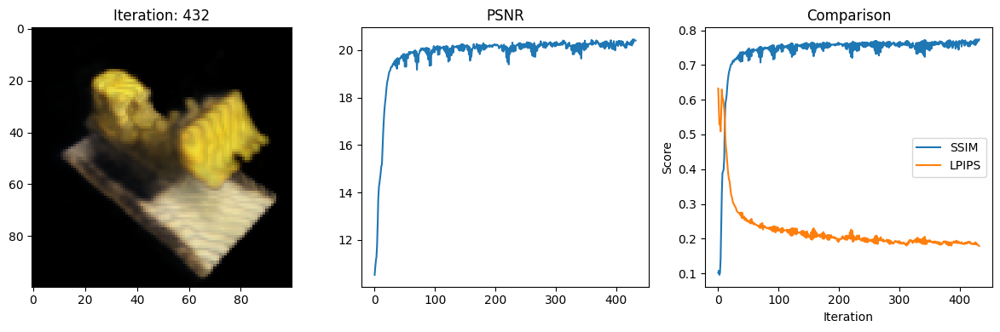

Data saved to: metrics.csv
433 9.348552942276001 secs per iter
Iteration: 433,PSNR: 20.169462203979492, SSIM: 0.7557461170993743, LPIPS: 0.1846236288547516


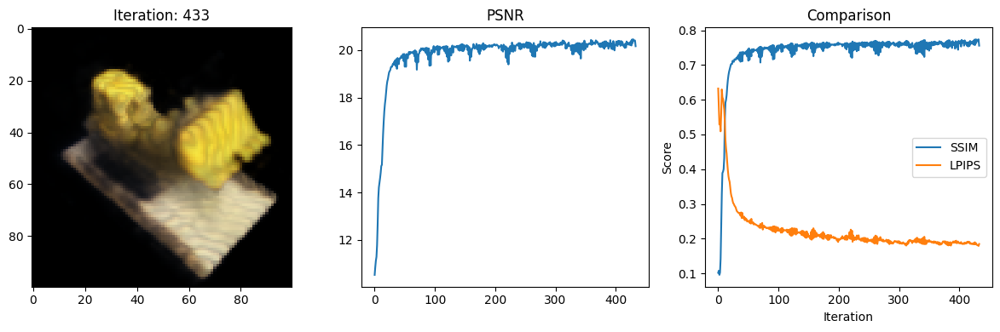

Data saved to: metrics.csv
434 9.26025128364563 secs per iter
Iteration: 434,PSNR: 20.42060661315918, SSIM: 0.7759927919797082, LPIPS: 0.1824711561203003


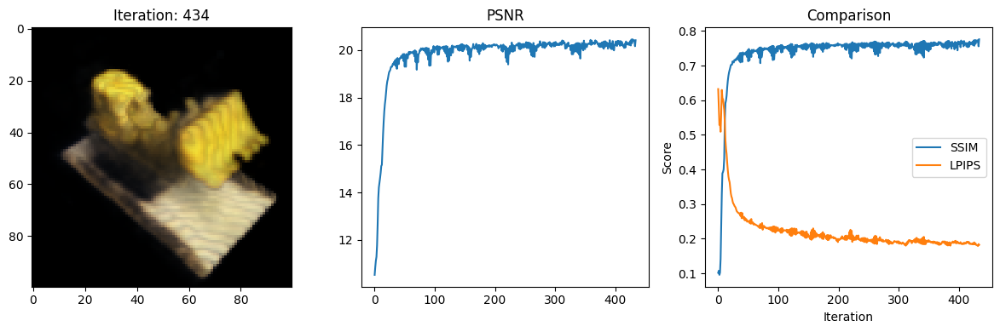

Data saved to: metrics.csv
435 9.366127490997314 secs per iter
Iteration: 435,PSNR: 20.407861709594727, SSIM: 0.7683925263690506, LPIPS: 0.1827431172132492


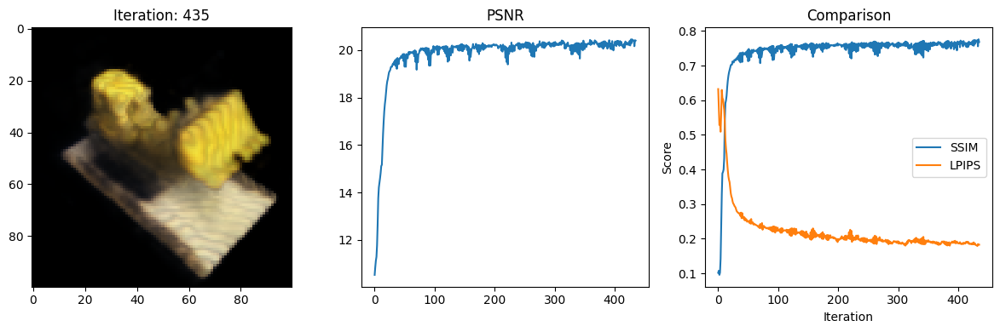

Data saved to: metrics.csv
436 9.287598133087158 secs per iter
Iteration: 436,PSNR: 20.528045654296875, SSIM: 0.7723809654243469, LPIPS: 0.1808074414730072


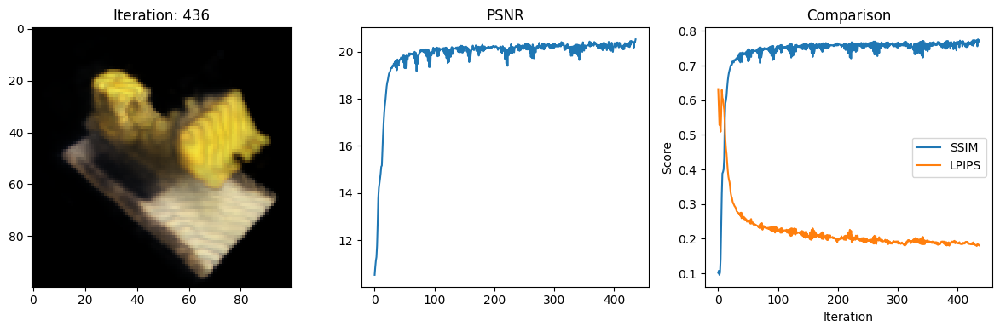

Data saved to: metrics.csv
437 9.44977331161499 secs per iter
Iteration: 437,PSNR: 20.412979125976562, SSIM: 0.7730882261647123, LPIPS: 0.18008264899253845


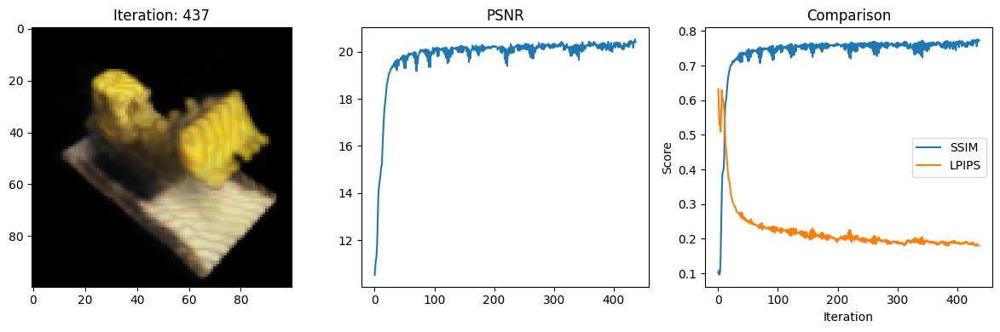

Data saved to: metrics.csv
438 9.28741717338562 secs per iter
Iteration: 438,PSNR: 20.30585479736328, SSIM: 0.7604574983666067, LPIPS: 0.18800586462020874


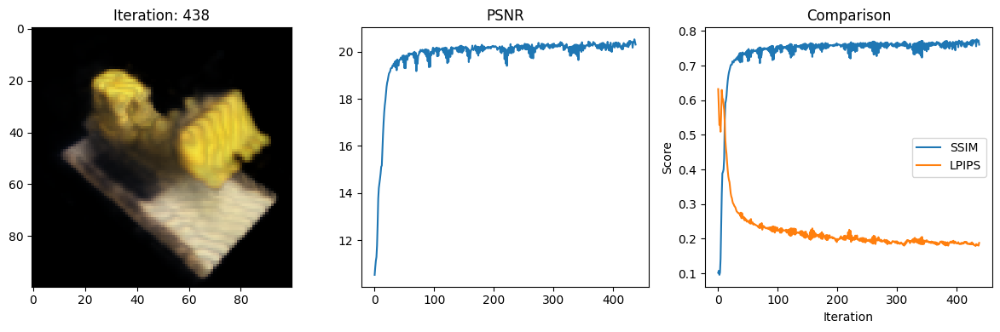

Data saved to: metrics.csv
439 9.2080659866333 secs per iter
Iteration: 439,PSNR: 20.297119140625, SSIM: 0.7679416147258351, LPIPS: 0.18885193765163422


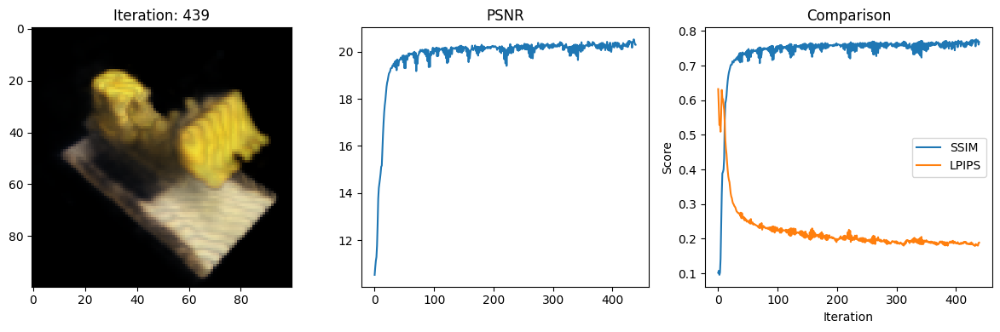

Data saved to: metrics.csv
440 9.490440607070923 secs per iter
Iteration: 440,PSNR: 19.86817741394043, SSIM: 0.7451711592746059, LPIPS: 0.20127730071544647


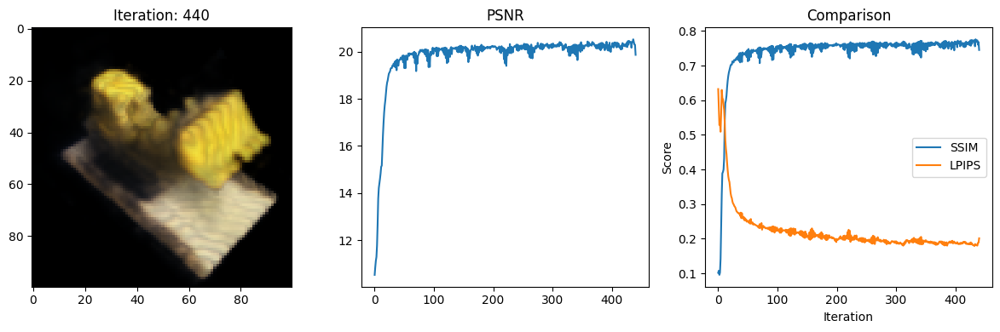

Data saved to: metrics.csv
441 9.350605249404907 secs per iter
Iteration: 441,PSNR: 19.89240264892578, SSIM: 0.7492893681537932, LPIPS: 0.20376679301261902


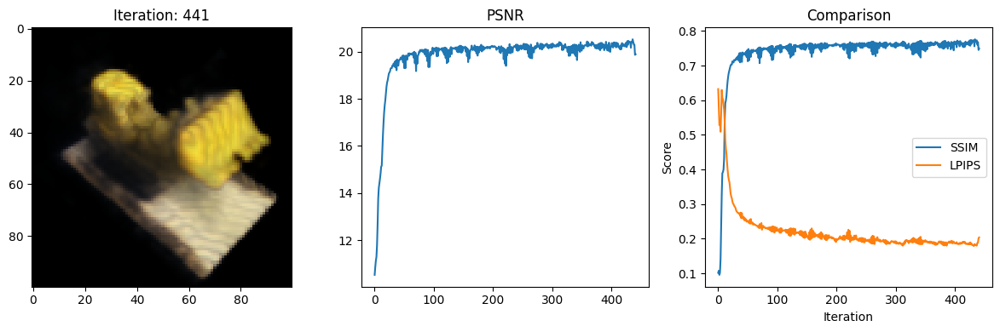

Data saved to: metrics.csv
442 9.394109964370728 secs per iter
Iteration: 442,PSNR: 19.83884620666504, SSIM: 0.7424835232503599, LPIPS: 0.20467931032180786


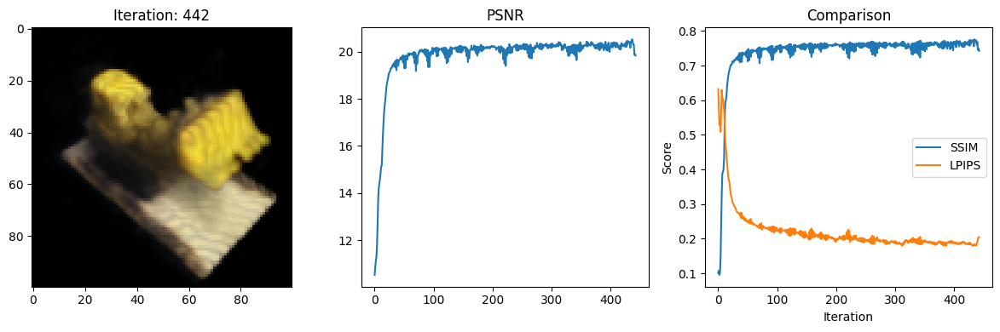

Data saved to: metrics.csv
443 9.202471256256104 secs per iter
Iteration: 443,PSNR: 20.099178314208984, SSIM: 0.7556111579984622, LPIPS: 0.19572055339813232


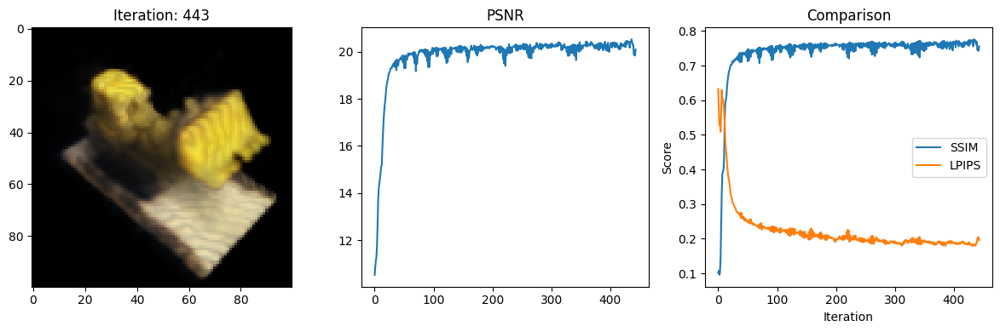

Data saved to: metrics.csv
444 9.423981189727783 secs per iter
Iteration: 444,PSNR: 20.073137283325195, SSIM: 0.7550850157298544, LPIPS: 0.19214138388633728


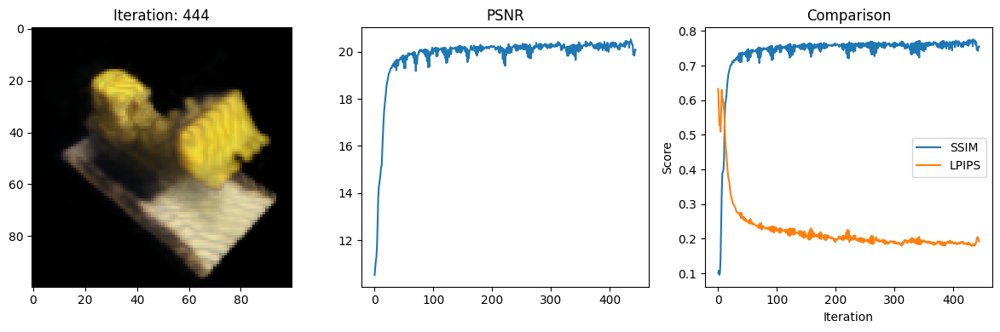

Data saved to: metrics.csv
445 9.220256328582764 secs per iter
Iteration: 445,PSNR: 20.319997787475586, SSIM: 0.7650951486238817, LPIPS: 0.1869029998779297


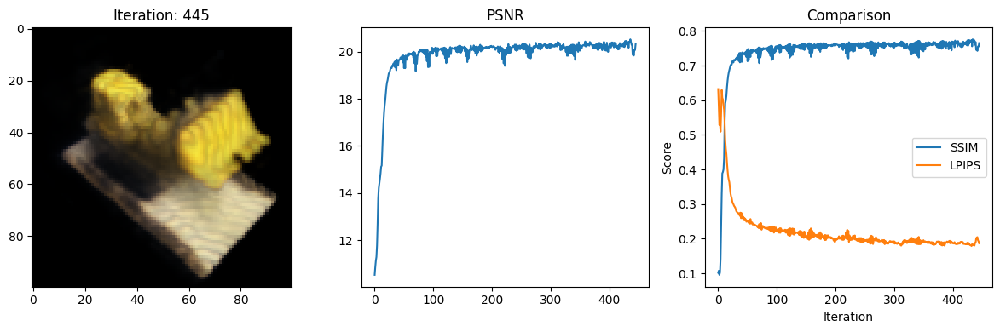

Data saved to: metrics.csv
446 9.309194564819336 secs per iter
Iteration: 446,PSNR: 20.256160736083984, SSIM: 0.7648286102221363, LPIPS: 0.18386131525039673


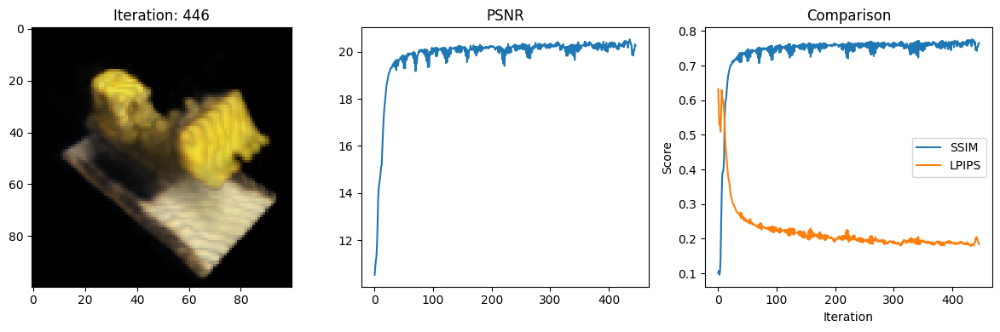

Data saved to: metrics.csv
447 9.611442804336548 secs per iter
Iteration: 447,PSNR: 20.21366310119629, SSIM: 0.7611219794267042, LPIPS: 0.18535315990447998


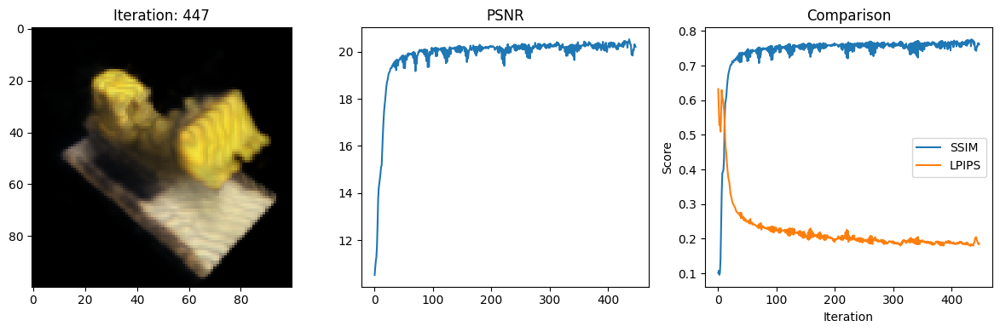

Data saved to: metrics.csv
448 9.59679627418518 secs per iter
Iteration: 448,PSNR: 20.25860023498535, SSIM: 0.7703715310543001, LPIPS: 0.18059132993221283


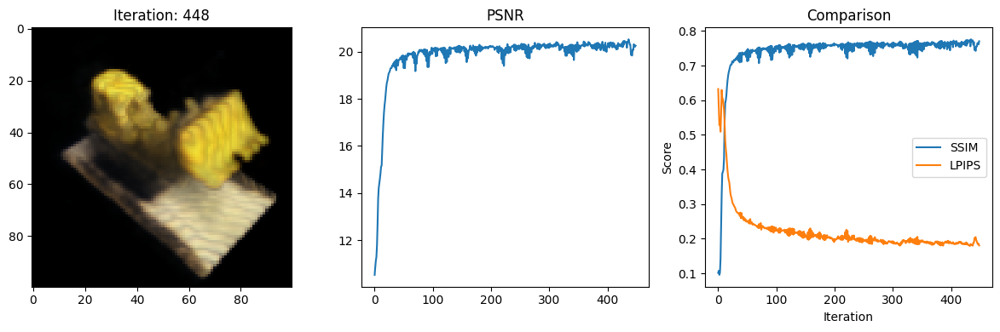

Data saved to: metrics.csv
449 9.343064308166504 secs per iter
Iteration: 449,PSNR: 20.19837760925293, SSIM: 0.759012152529272, LPIPS: 0.1839316040277481


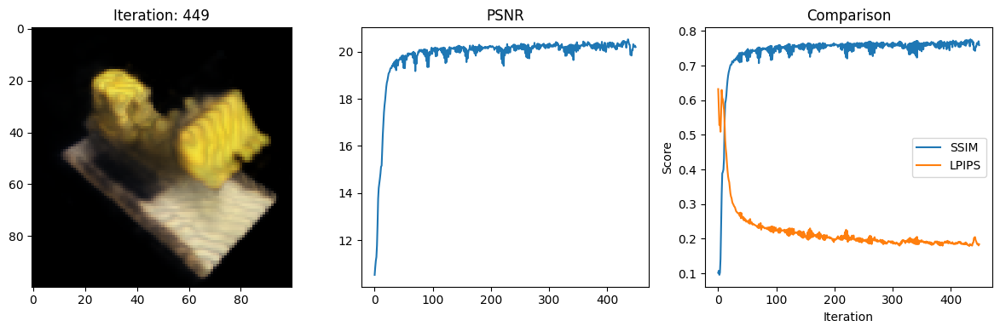

Data saved to: metrics.csv
450 9.40337872505188 secs per iter
Iteration: 450,PSNR: 20.464584350585938, SSIM: 0.7759086375092784, LPIPS: 0.17731407284736633


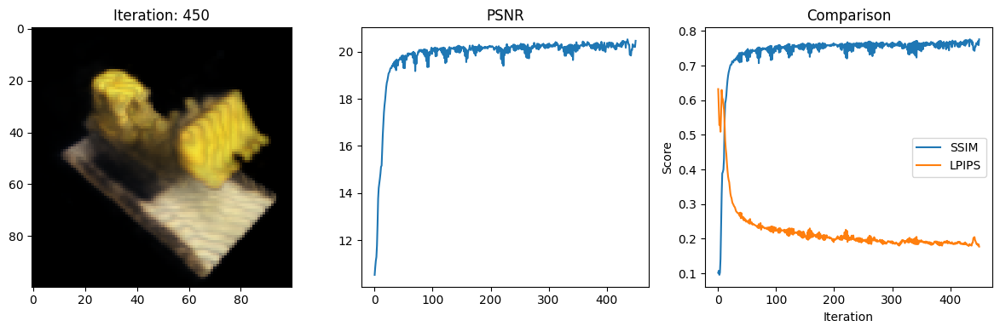

Data saved to: metrics.csv
451 9.333239078521729 secs per iter
Iteration: 451,PSNR: 20.360937118530273, SSIM: 0.7673978044986657, LPIPS: 0.18074959516525269


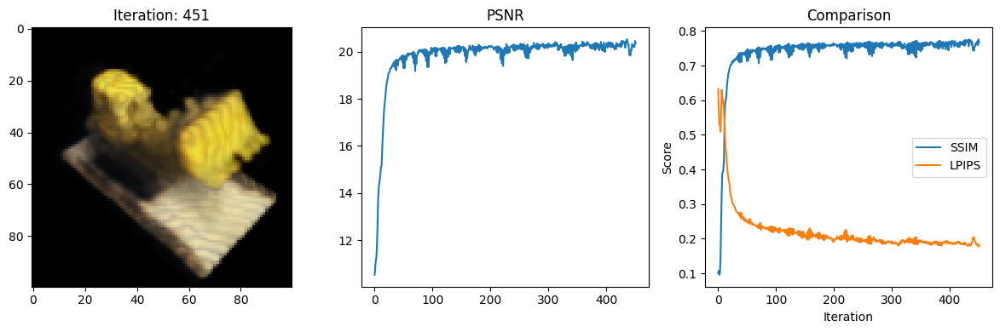

Data saved to: metrics.csv
452 9.382428169250488 secs per iter
Iteration: 452,PSNR: 20.440481185913086, SSIM: 0.7720876702569711, LPIPS: 0.179719477891922


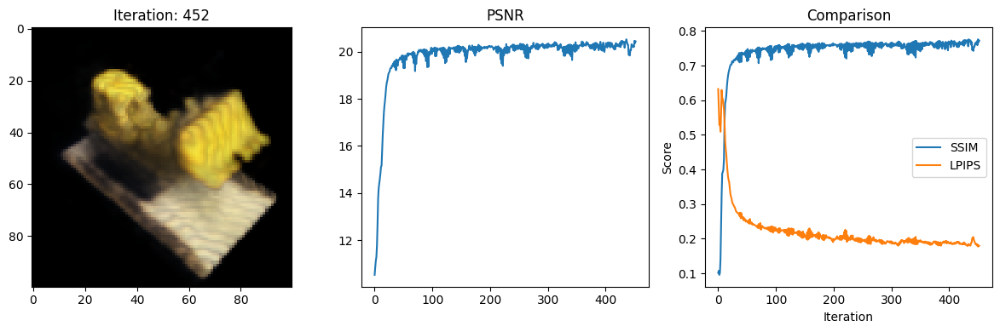

Data saved to: metrics.csv
453 9.434722900390625 secs per iter
Iteration: 453,PSNR: 20.419967651367188, SSIM: 0.773472935840243, LPIPS: 0.17809133231639862


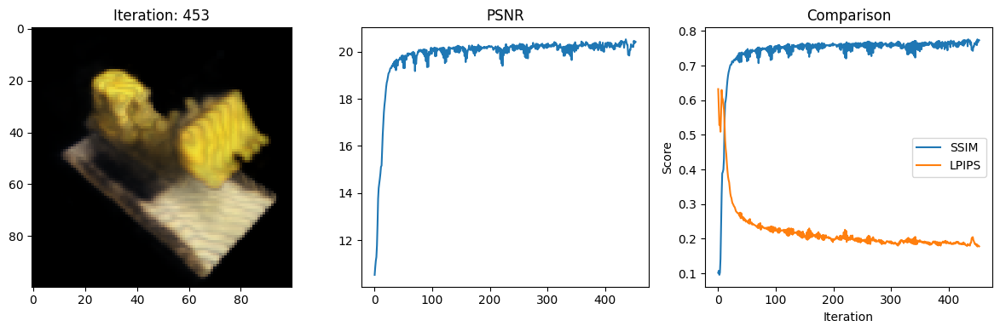

Data saved to: metrics.csv
454 9.311707019805908 secs per iter
Iteration: 454,PSNR: 20.36100959777832, SSIM: 0.764112515659729, LPIPS: 0.1809053122997284


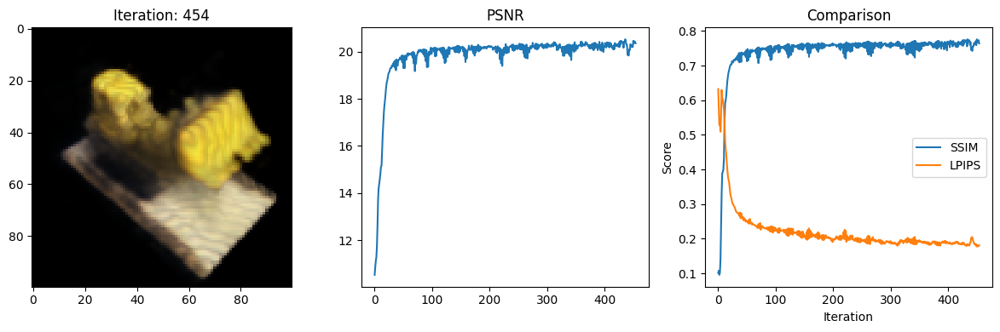

Data saved to: metrics.csv
455 9.334370374679565 secs per iter
Iteration: 455,PSNR: 20.3303165435791, SSIM: 0.7748178680035904, LPIPS: 0.17798063158988953


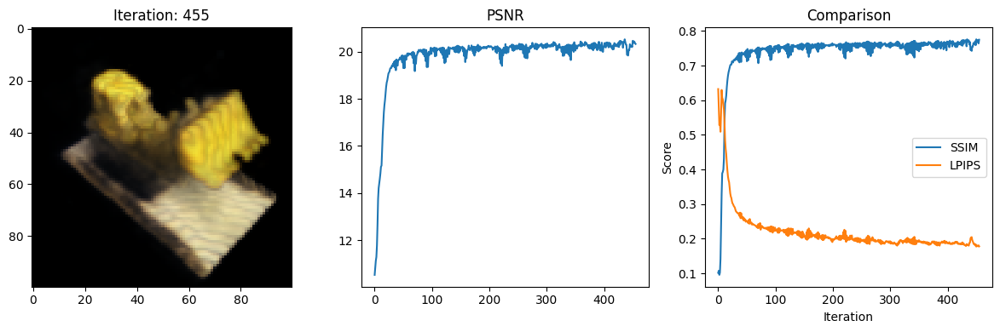

Data saved to: metrics.csv
456 9.282485961914062 secs per iter
Iteration: 456,PSNR: 20.29360580444336, SSIM: 0.7621752854476108, LPIPS: 0.18097856640815735


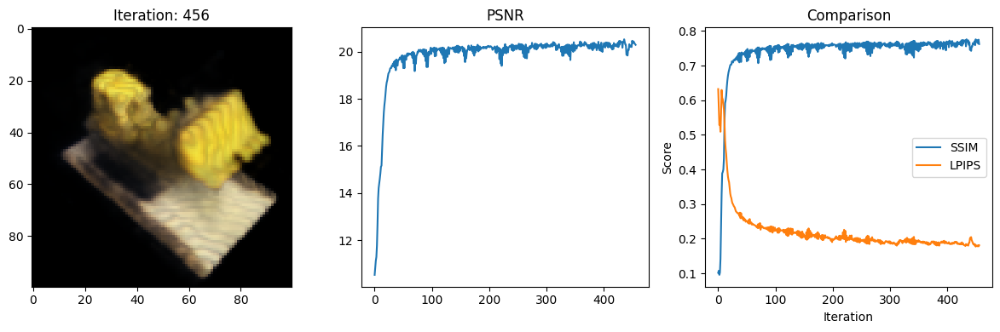

Data saved to: metrics.csv
457 9.484838008880615 secs per iter
Iteration: 457,PSNR: 20.512073516845703, SSIM: 0.7774904711266308, LPIPS: 0.17857491970062256


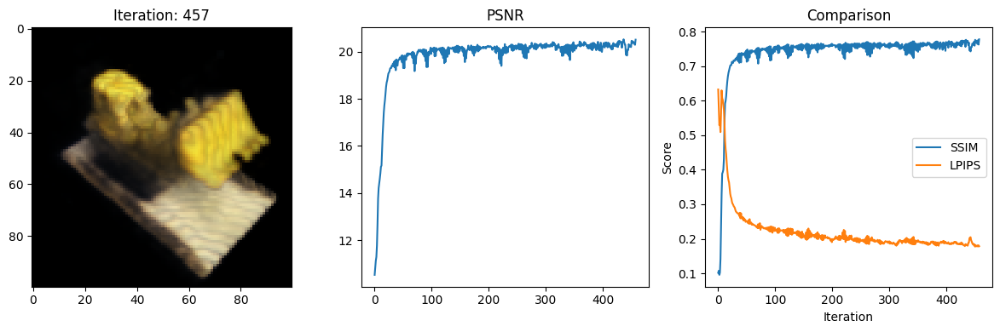

Data saved to: metrics.csv
458 9.395567655563354 secs per iter
Iteration: 458,PSNR: 20.43779754638672, SSIM: 0.7728943903029987, LPIPS: 0.17690381407737732


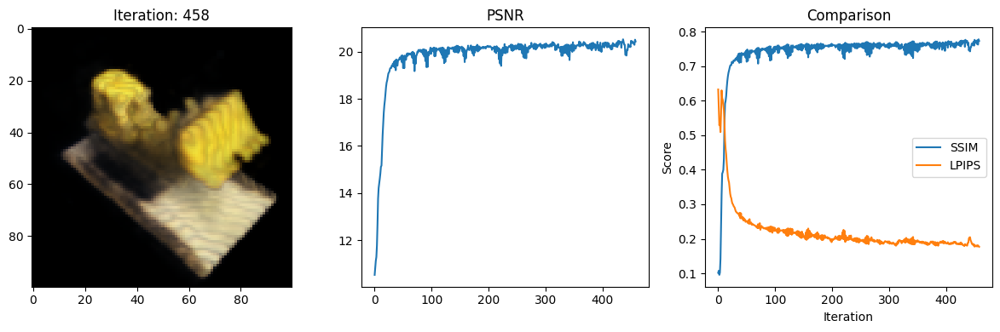

Data saved to: metrics.csv
459 9.35125994682312 secs per iter
Iteration: 459,PSNR: 20.463464736938477, SSIM: 0.7690379342175223, LPIPS: 0.1772664487361908


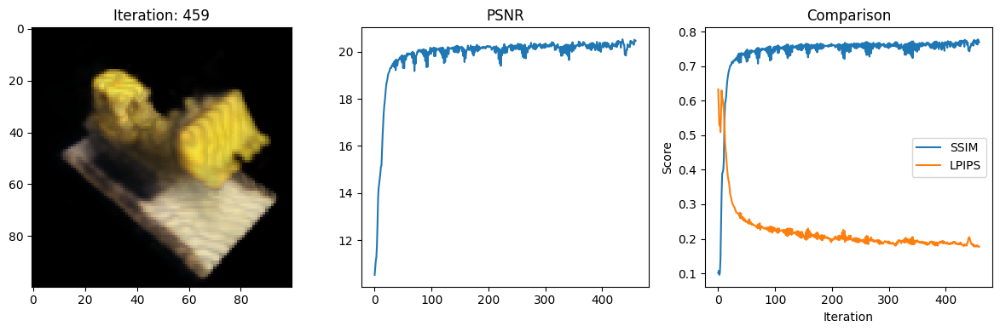

Data saved to: metrics.csv
460 9.385621309280396 secs per iter
Iteration: 460,PSNR: 20.369367599487305, SSIM: 0.7745606001577746, LPIPS: 0.17595770955085754


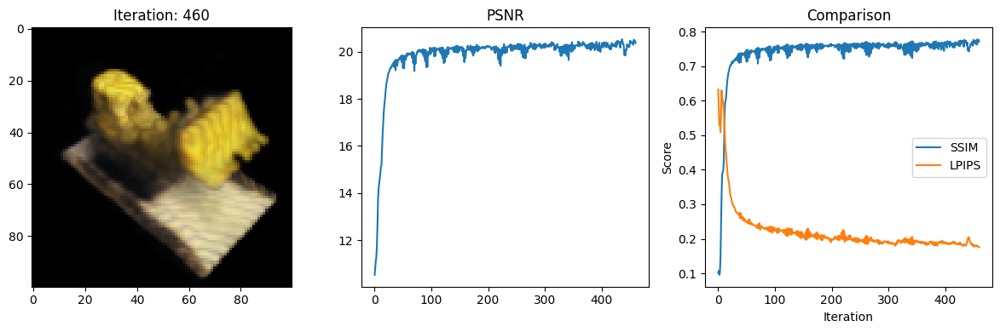

Data saved to: metrics.csv
461 9.514626264572144 secs per iter
Iteration: 461,PSNR: 20.31295394897461, SSIM: 0.7637068761742473, LPIPS: 0.1791096329689026


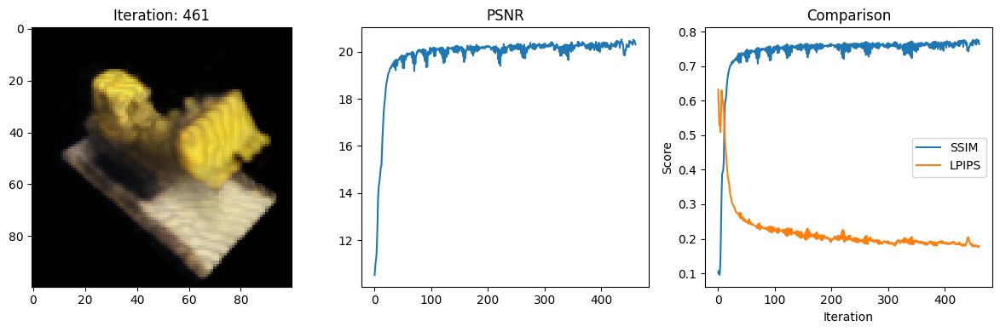

Data saved to: metrics.csv
462 9.433714628219604 secs per iter
Iteration: 462,PSNR: 20.426021575927734, SSIM: 0.7768917643518254, LPIPS: 0.17673581838607788


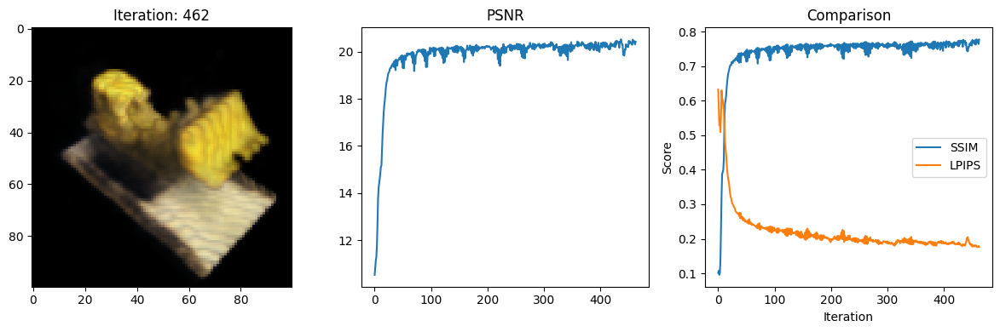

Data saved to: metrics.csv
463 9.748411417007446 secs per iter
Iteration: 463,PSNR: 20.36996078491211, SSIM: 0.7680366599214458, LPIPS: 0.18143820762634277


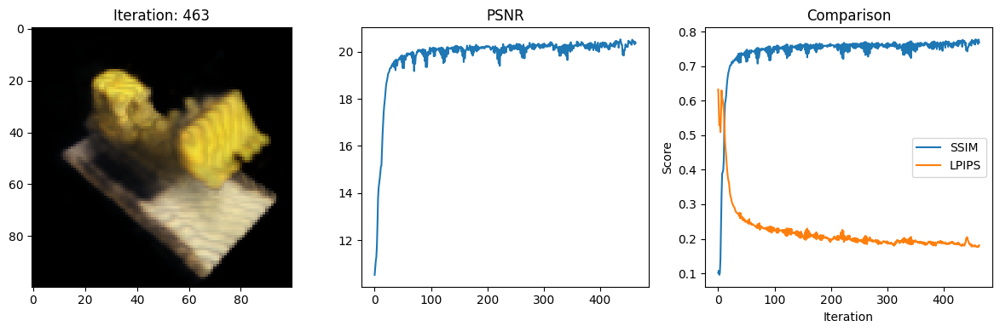

Data saved to: metrics.csv
464 9.369152545928955 secs per iter
Iteration: 464,PSNR: 20.560697555541992, SSIM: 0.7732048103062569, LPIPS: 0.18077006936073303


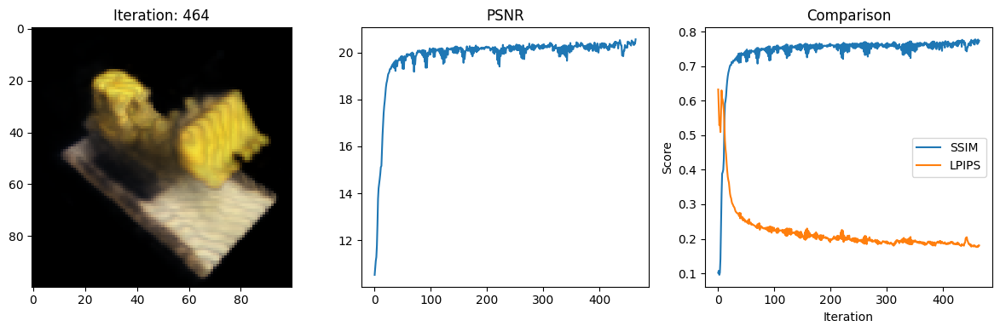

Data saved to: metrics.csv
465 9.495001554489136 secs per iter
Iteration: 465,PSNR: 20.122966766357422, SSIM: 0.7633420290697036, LPIPS: 0.18780238926410675


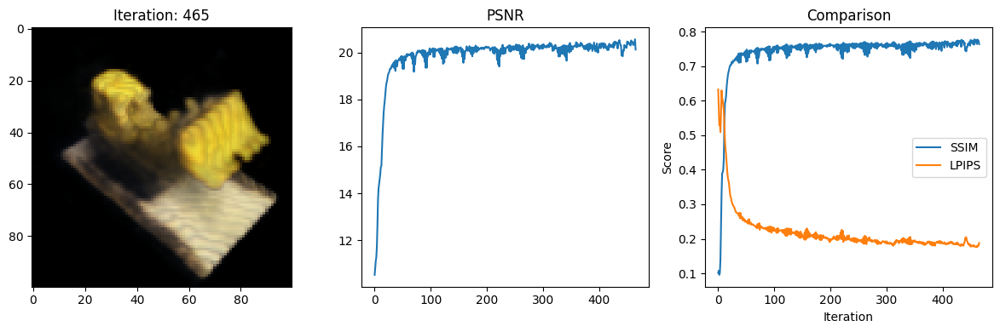

Data saved to: metrics.csv
466 9.451411008834839 secs per iter
Iteration: 466,PSNR: 19.452247619628906, SSIM: 0.7272478280295877, LPIPS: 0.2098136693239212


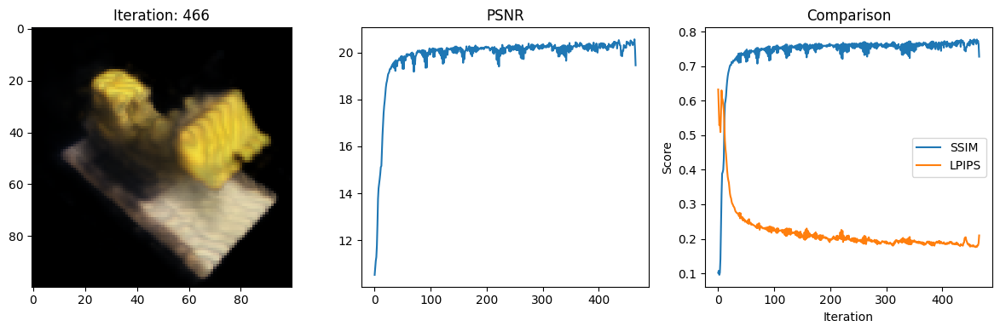

Data saved to: metrics.csv
467 9.256047010421753 secs per iter
Iteration: 467,PSNR: 19.78719139099121, SSIM: 0.7459936937179514, LPIPS: 0.2055545151233673


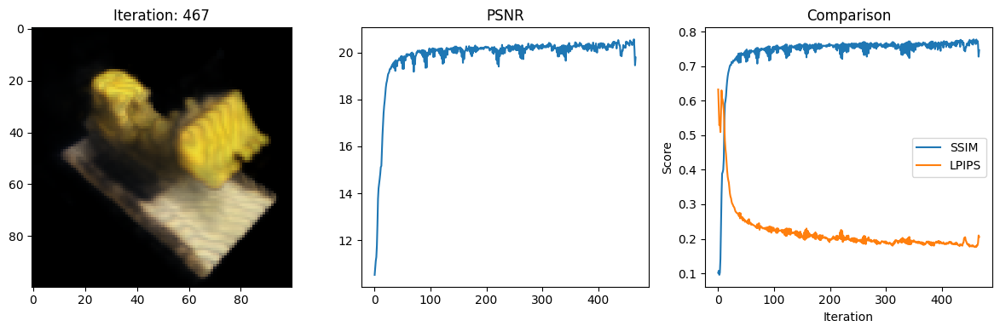

Data saved to: metrics.csv
468 9.455800771713257 secs per iter
Iteration: 468,PSNR: 19.978988647460938, SSIM: 0.755665955559747, LPIPS: 0.19585511088371277


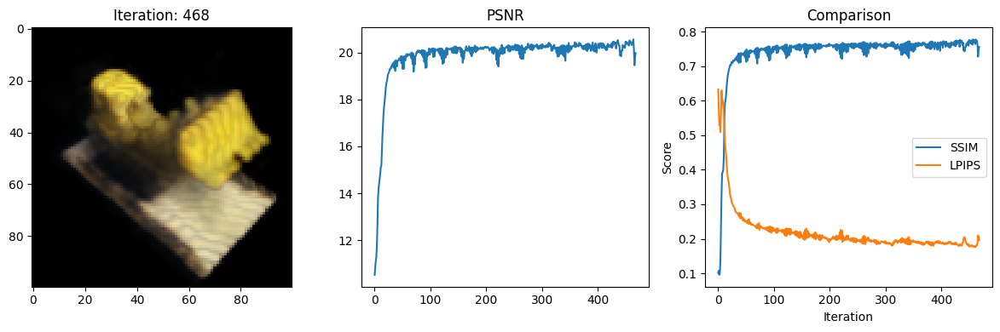

Data saved to: metrics.csv
469 9.394965648651123 secs per iter
Iteration: 469,PSNR: 20.208593368530273, SSIM: 0.7563457025312461, LPIPS: 0.193700909614563


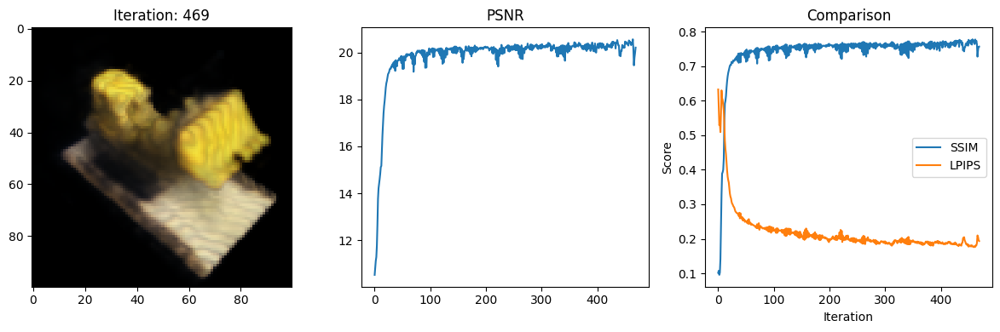

Data saved to: metrics.csv
470 9.463807344436646 secs per iter
Iteration: 470,PSNR: 20.236963272094727, SSIM: 0.7682172586260655, LPIPS: 0.18190604448318481


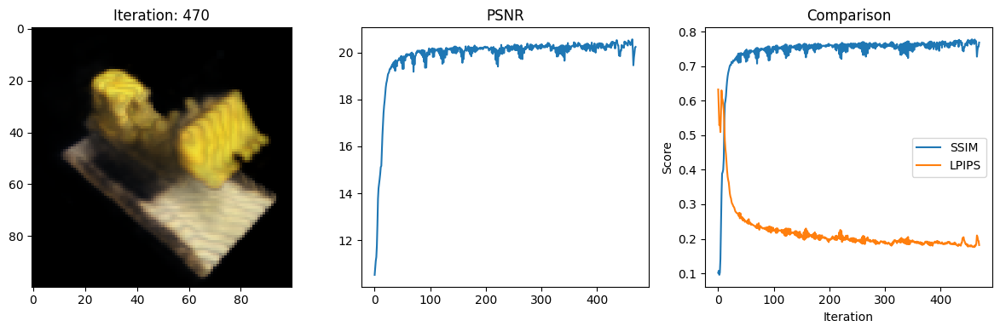

Data saved to: metrics.csv
471 9.370593786239624 secs per iter
Iteration: 471,PSNR: 20.31638526916504, SSIM: 0.766274290968815, LPIPS: 0.18331590294837952


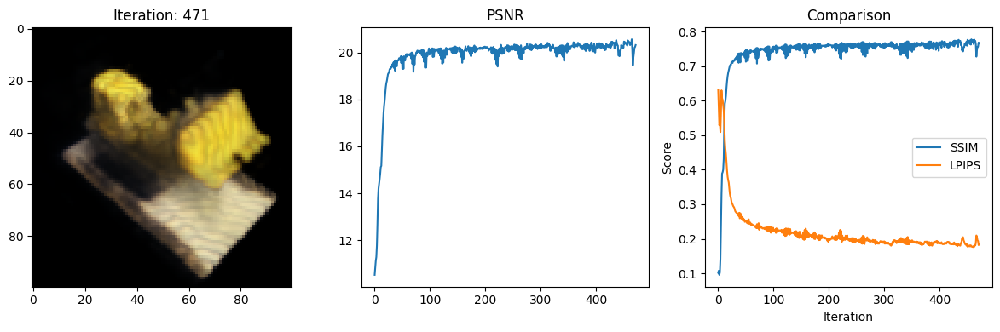

Data saved to: metrics.csv
472 9.386711359024048 secs per iter
Iteration: 472,PSNR: 20.432430267333984, SSIM: 0.771682183956909, LPIPS: 0.18032999336719513


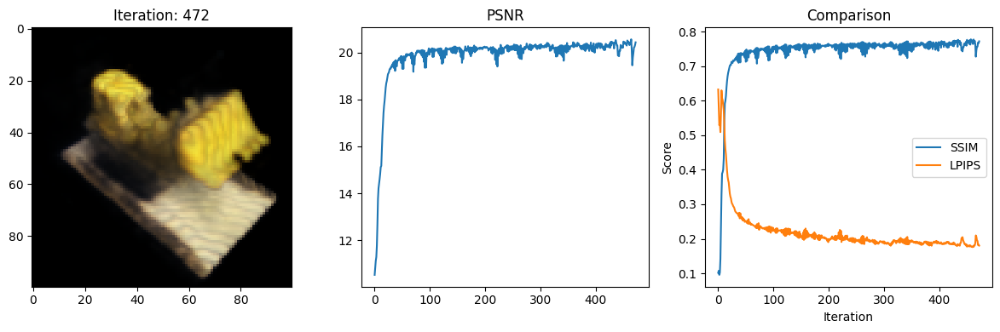

Data saved to: metrics.csv
473 9.382061004638672 secs per iter
Iteration: 473,PSNR: 20.387285232543945, SSIM: 0.7719628883897268, LPIPS: 0.17760547995567322


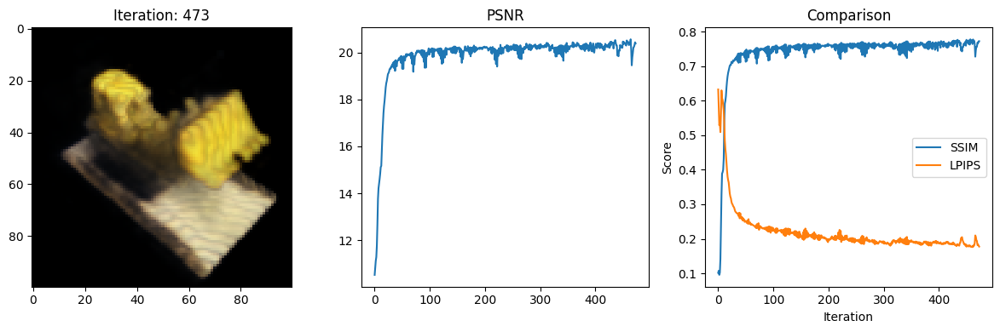

Data saved to: metrics.csv
474 9.589884757995605 secs per iter
Iteration: 474,PSNR: 20.420488357543945, SSIM: 0.769150932159897, LPIPS: 0.1800888478755951


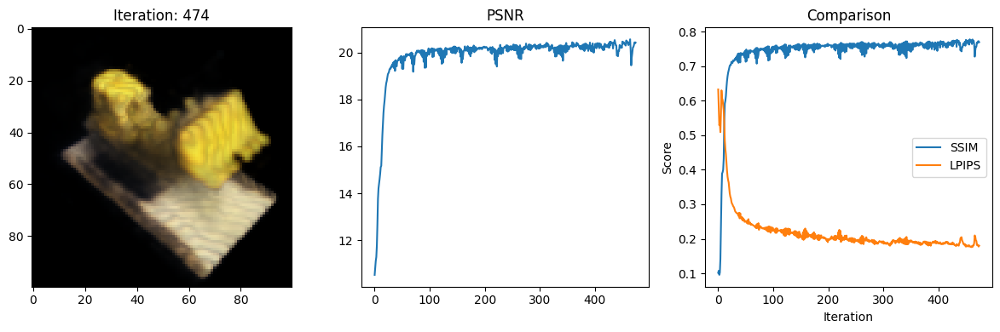

Data saved to: metrics.csv
475 9.435319185256958 secs per iter
Iteration: 475,PSNR: 20.415138244628906, SSIM: 0.7746938737945329, LPIPS: 0.1754588782787323


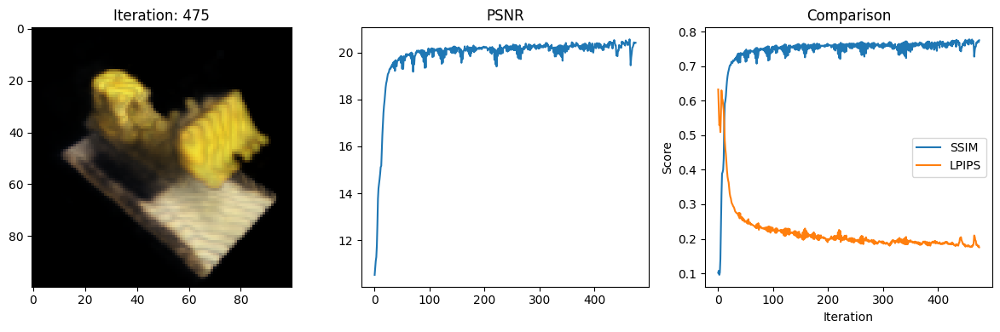

Data saved to: metrics.csv
476 9.50504732131958 secs per iter
Iteration: 476,PSNR: 20.383384704589844, SSIM: 0.7684227537253481, LPIPS: 0.17993396520614624


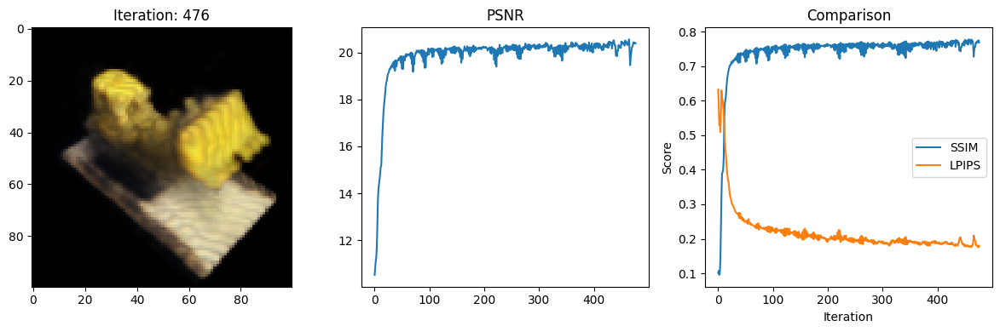

Data saved to: metrics.csv
477 9.322930574417114 secs per iter
Iteration: 477,PSNR: 20.486156463623047, SSIM: 0.775400242139928, LPIPS: 0.1765766441822052


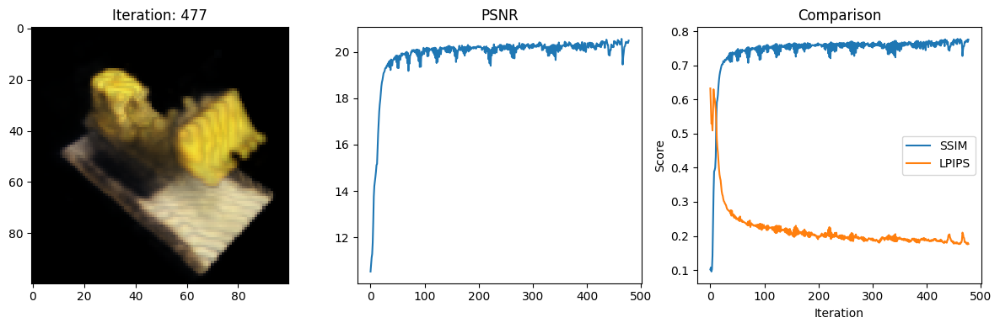

Data saved to: metrics.csv
478 9.579808235168457 secs per iter
Iteration: 478,PSNR: 20.45193862915039, SSIM: 0.7712827036342614, LPIPS: 0.17902150750160217


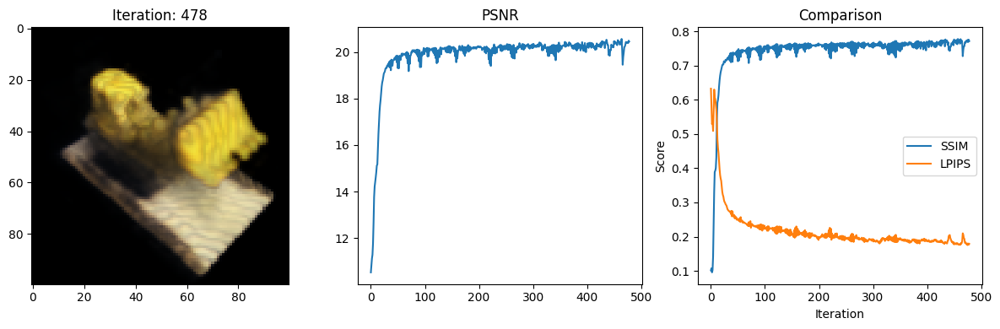

Data saved to: metrics.csv
479 9.700754404067993 secs per iter
Iteration: 479,PSNR: 20.50650405883789, SSIM: 0.7752627293626783, LPIPS: 0.17734238505363464


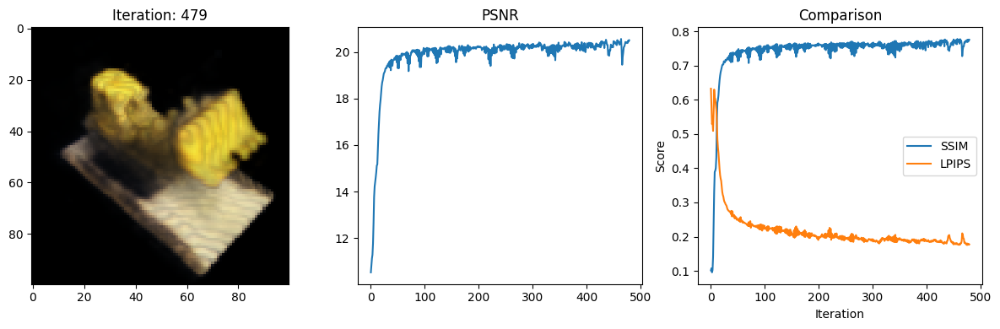

Data saved to: metrics.csv
480 9.421449899673462 secs per iter
Iteration: 480,PSNR: 20.473756790161133, SSIM: 0.7738366659059394, LPIPS: 0.17481598258018494


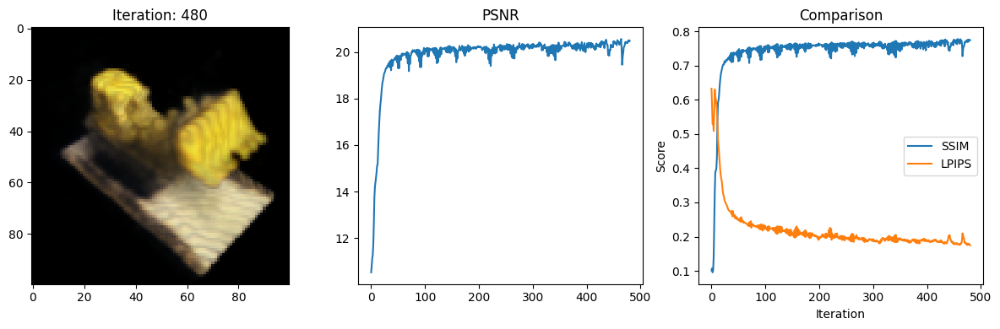

Data saved to: metrics.csv
481 9.46500277519226 secs per iter
Iteration: 481,PSNR: 20.457311630249023, SSIM: 0.7693880907555424, LPIPS: 0.1785675585269928


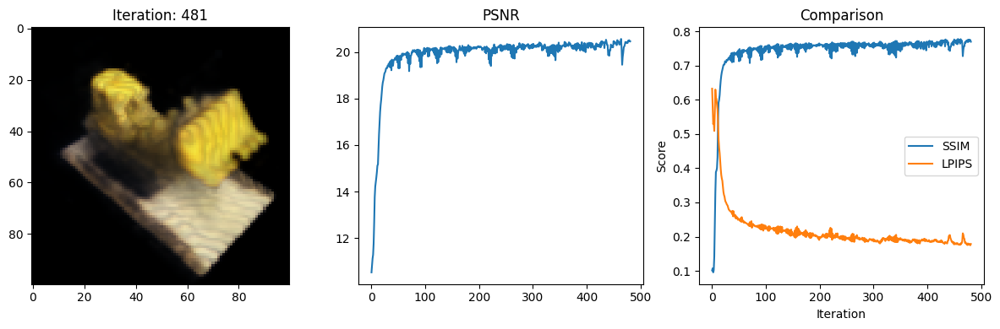

Data saved to: metrics.csv
482 9.390475988388062 secs per iter
Iteration: 482,PSNR: 20.40654182434082, SSIM: 0.7738468419058057, LPIPS: 0.17548546195030212


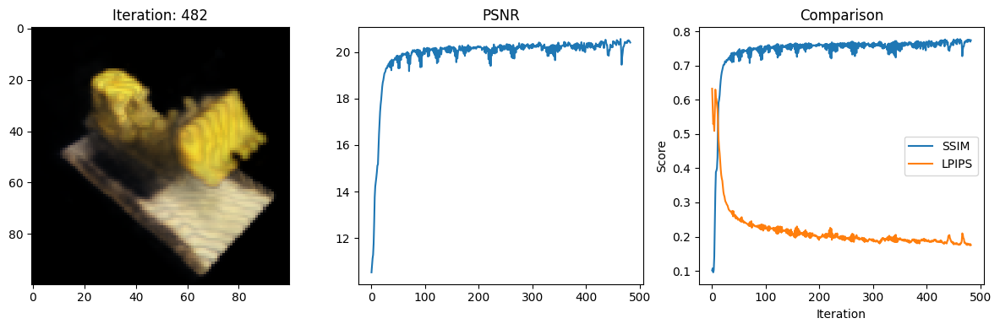

Data saved to: metrics.csv
483 9.542837381362915 secs per iter
Iteration: 483,PSNR: 20.219512939453125, SSIM: 0.756879367743235, LPIPS: 0.18488387763500214


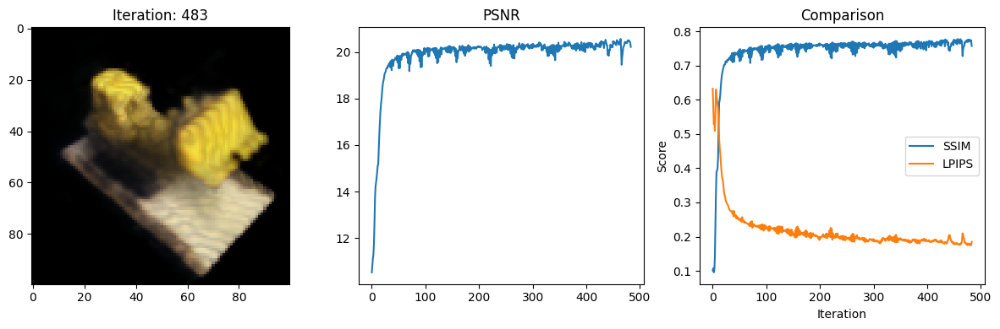

Data saved to: metrics.csv
484 9.546643018722534 secs per iter
Iteration: 484,PSNR: 20.247127532958984, SSIM: 0.7689100429499401, LPIPS: 0.18282341957092285


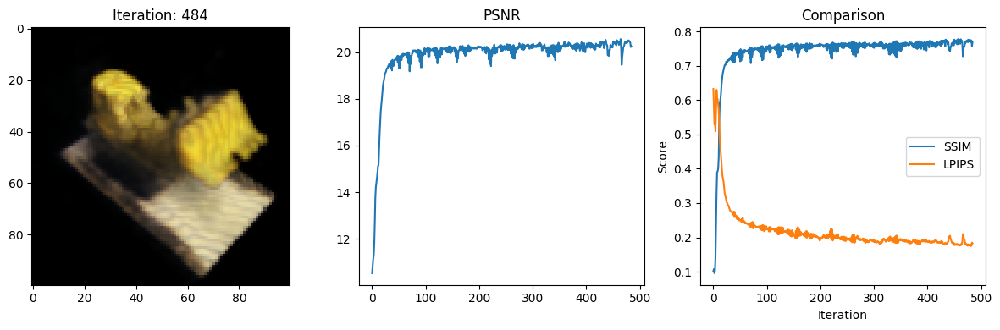

Data saved to: metrics.csv
485 9.342255592346191 secs per iter
Iteration: 485,PSNR: 19.934736251831055, SSIM: 0.7451098501691343, LPIPS: 0.19865810871124268


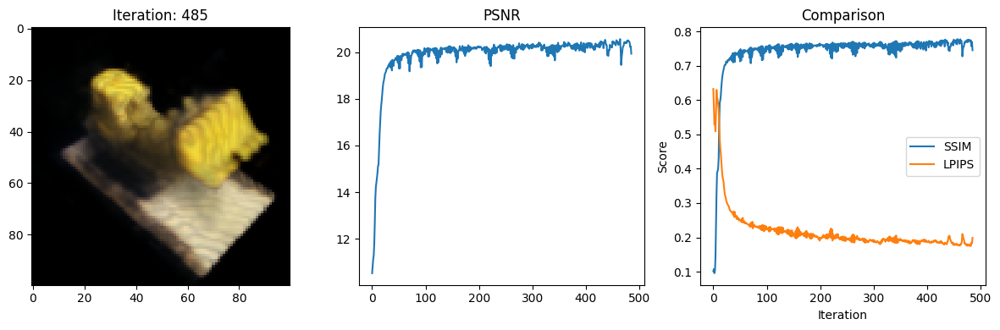

Data saved to: metrics.csv
486 9.349994421005249 secs per iter
Iteration: 486,PSNR: 19.706506729125977, SSIM: 0.7438082628566473, LPIPS: 0.20372110605239868


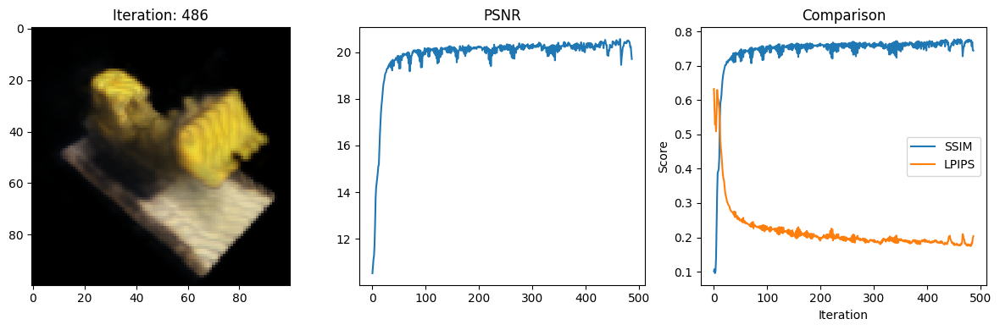

Data saved to: metrics.csv
487 9.644814014434814 secs per iter
Iteration: 487,PSNR: 19.631155014038086, SSIM: 0.7362133642890477, LPIPS: 0.20661741495132446


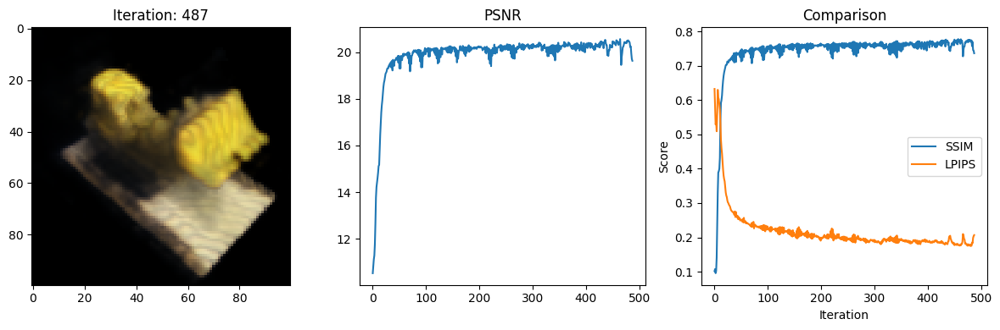

Data saved to: metrics.csv
488 9.389461517333984 secs per iter
Iteration: 488,PSNR: 20.11144256591797, SSIM: 0.7587720329548434, LPIPS: 0.19107939302921295


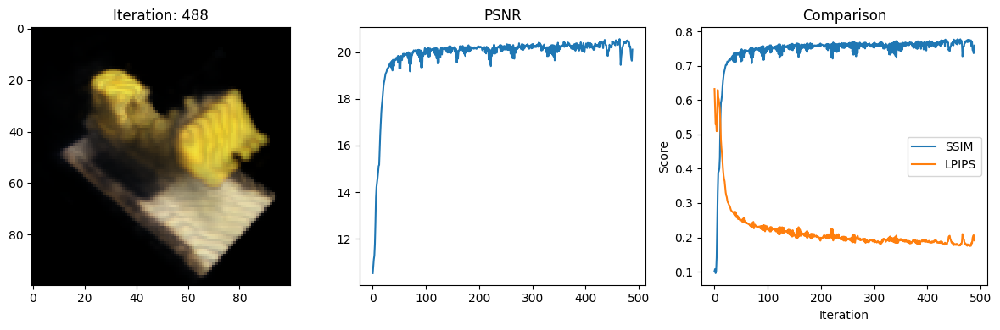

Data saved to: metrics.csv
489 9.376820087432861 secs per iter
Iteration: 489,PSNR: 20.096256256103516, SSIM: 0.7570048807092223, LPIPS: 0.1862289309501648


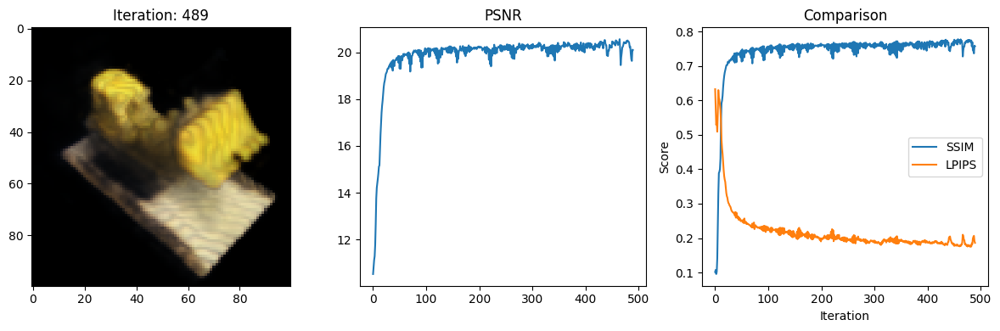

Data saved to: metrics.csv
490 9.366154432296753 secs per iter
Iteration: 490,PSNR: 20.373493194580078, SSIM: 0.7686714809827024, LPIPS: 0.18067851662635803


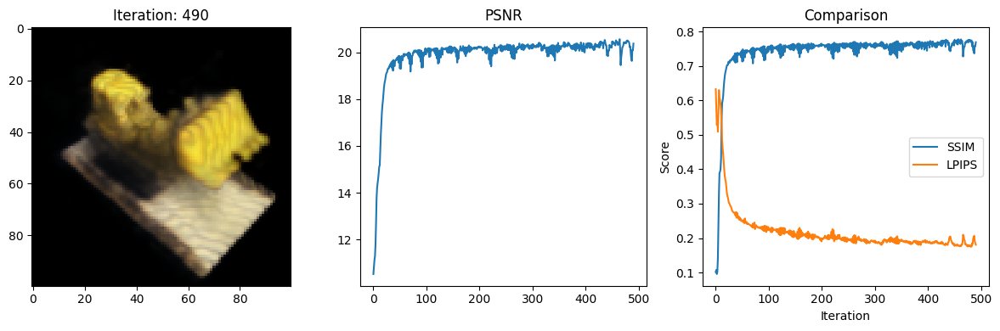

Data saved to: metrics.csv
491 9.660839796066284 secs per iter
Iteration: 491,PSNR: 20.331336975097656, SSIM: 0.7701499220411616, LPIPS: 0.17618519067764282


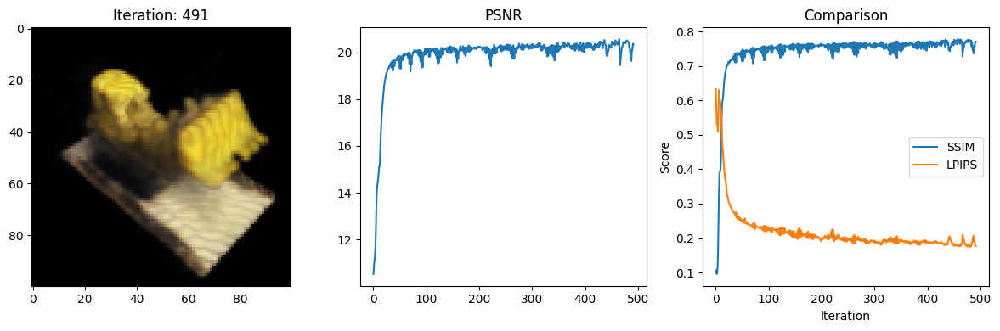

Data saved to: metrics.csv
492 9.432105541229248 secs per iter
Iteration: 492,PSNR: 20.31639862060547, SSIM: 0.764218529381779, LPIPS: 0.179996058344841


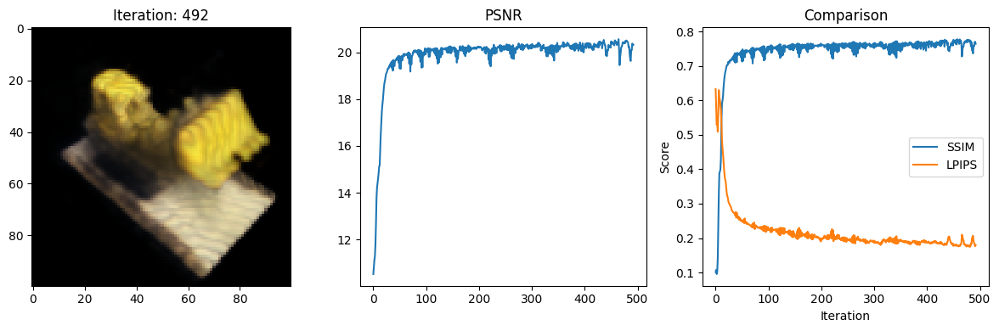

Data saved to: metrics.csv
493 9.629238843917847 secs per iter
Iteration: 493,PSNR: 20.261474609375, SSIM: 0.7749146693591366, LPIPS: 0.1764966994524002


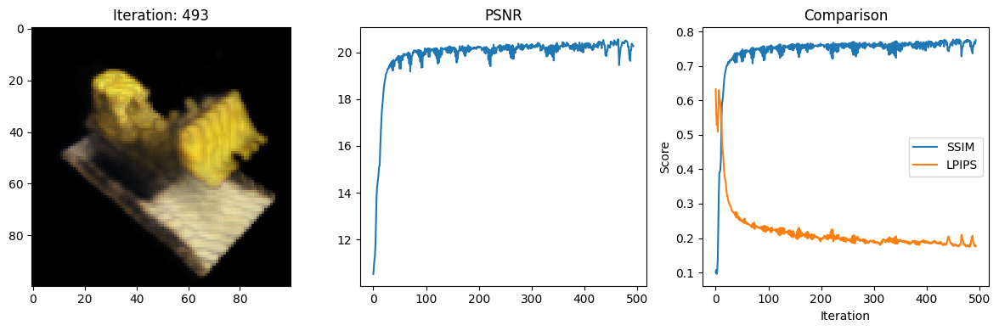

Data saved to: metrics.csv
494 9.369110584259033 secs per iter
Iteration: 494,PSNR: 20.41116714477539, SSIM: 0.7689980330016358, LPIPS: 0.17790786921977997


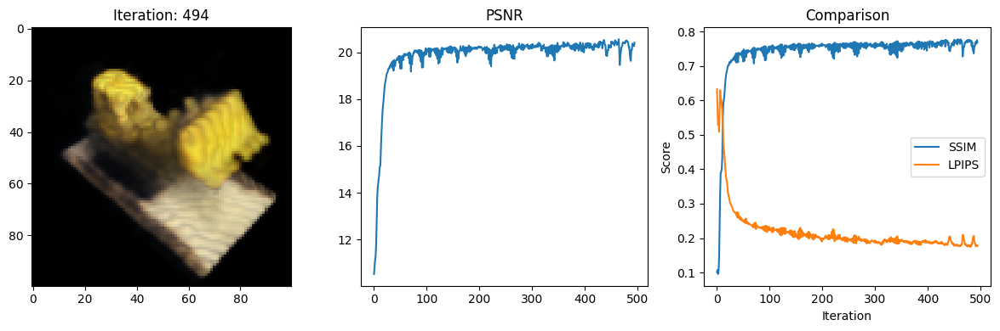

Data saved to: metrics.csv
495 9.837526798248291 secs per iter
Iteration: 495,PSNR: 20.57976722717285, SSIM: 0.7764790923753435, LPIPS: 0.17692480981349945


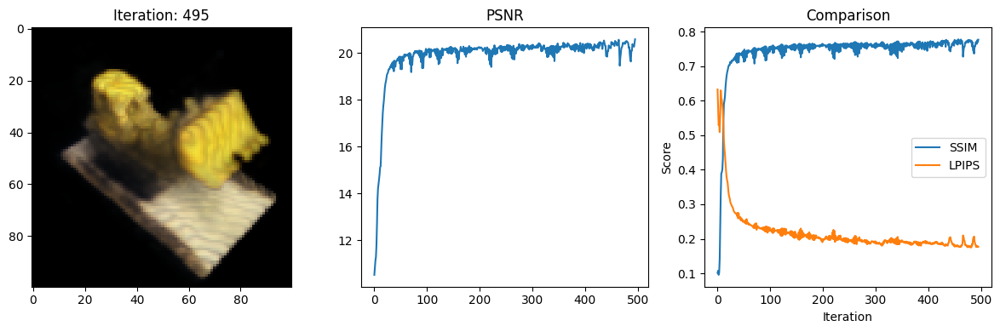

Data saved to: metrics.csv


KeyboardInterrupt: 

In [7]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as compare_ssim
from torchmetrics.image.lpip import LearnedPerceptualImagePatchSimilarity
import torch
import time
import csv
# Define functions init_model(), get_rays(), and render_rays() here

lpips = LearnedPerceptualImagePatchSimilarity(net_type='squeeze')

data = np.load('tiny_nerf_data.npz')
images = data['images']
poses = data['poses']
focal = data['focal']
H, W = images.shape[1:3]

model = init_model()
optimizer = tf.keras.optimizers.Adam(5e-4)

N_samples = 64
N_iters = 1000
weight_decay_coeff = 1e-4  # Define weight decay coefficient

psnrs = []
ssims = []  # List to store SSIM values
lpips_scores = []  # List to store LPIPS scores
iternums = []
i_plot = 1

def train_step(images, poses):
    losses = []
    for img_i in range(0, images.shape[0], 10):
        target = images[img_i]
        pose = poses[img_i]
        rays_o, rays_d = get_rays(H, W, focal, pose)

        with tf.GradientTape() as tape:
            rgb, _, _ = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples, rand=True)
            loss = tf.reduce_mean(tf.square(rgb - target))

            # Compute weight decay term
            wd_loss = tf.reduce_sum([tf.reduce_sum(tf.square(w)) for w in model.trainable_variables])
            total_loss = loss + weight_decay_coeff * wd_loss  # Total loss including weight decay term

            # Calculate SSIM
            rgb_np = rgb.numpy().astype(np.float64)
            target_np = target.astype(np.float64)  # Direct conversion to NumPy array
            ssim_loss = 1 - tf.convert_to_tensor(compare_ssim(rgb_np, target_np, multichannel=True), dtype=tf.float32)

            # Calculate LPIPS score
            rgb_lpips = torch.tensor(np.transpose(rgb_np, (2, 0, 1)), dtype=torch.float32)  # Convert RGB to PyTorch format
            target_lpips = torch.tensor(np.transpose(target_np, (2, 0, 1)), dtype=torch.float32)  # Convert target image to PyTorch format
            lpips_loss = lpips(rgb_lpips.unsqueeze(0), target_lpips.unsqueeze(0))

            # Combine losses
            total_loss += ssim_loss  # maximize SSIM
            total_loss += lpips_loss  # minimize LPIPS

        gradients = tape.gradient(total_loss, model.trainable_variables)
        optimizer.apply_gradients(zip(gradients, model.trainable_variables))

        losses.append(total_loss.numpy())

    return losses


t = time.time()
for i in range(N_iters + 1):
    losses = train_step(images, poses)

    if i % i_plot == 0:
        print(i, (time.time() - t) / i_plot, 'secs per iter')
        t = time.time()

        # Render the holdout view for logging
        rays_o, rays_d = get_rays(H, W, focal, testpose)
        rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples)
        loss = tf.reduce_mean(tf.square(rgb - testimg))
        psnr = -10. * tf.math.log(loss) / tf.math.log(10.)

        psnrs.append(psnr.numpy())
        iternums.append(i)

        # Convert TensorFlow arrays to NumPy arrays with correct data type
        rgb_np = rgb.numpy().astype(np.float64)
        testimg_np = testimg.astype(np.float64)

        # Calculate SSIM
        ssim_score = compare_ssim(rgb_np, testimg_np, multichannel=True)
        ssims.append(ssim_score)

        # Calculate LPIPS score
        # Convert RGB to PyTorch format and ensure the data type is the same
        rgb_lpips = torch.tensor(np.transpose(rgb_np, (2, 0, 1)), dtype=torch.float32)  # Convert RGB to PyTorch format
        testimg_lpips = torch.tensor(np.transpose(testimg_np, (2, 0, 1)), dtype=torch.float32)  # Convert target image to PyTorch format

        lpips_score = lpips(rgb_lpips.unsqueeze(0), testimg_lpips.unsqueeze(0)).item()
        lpips_scores.append(lpips_score)

        print(f"Iteration: {i},PSNR: {psnr}, SSIM: {ssim_score}, LPIPS: {lpips_score}")

        plt.figure(figsize=(12, 4))  # Increase width to accommodate spacing
        plt.subplots_adjust(wspace=0.4)  # Adjust the horizontal space between subplots

        plt.subplot(131)
        plt.imshow(rgb)
        plt.title(f'Iteration: {i}')

        plt.subplot(132)
        plt.plot(iternums, psnrs)
        plt.title('PSNR')

        plt.subplot(133)
        plt.plot(iternums, ssims, label='SSIM')
        plt.plot(iternums, lpips_scores,label='LPIPS')
        plt.title('Comparison')
        plt.xlabel('Iteration')
        plt.ylabel('Score')
        plt.legend()

        plt.tight_layout()  # Adjust layout to prevent overlap
        plt.show()

        # Define the file path for saving the CSV
        csv_file_path = "metrics.csv"

        # Open the CSV file in write mode
        with open(csv_file_path, mode='w', newline='') as file:
            writer = csv.writer(file)

            # Write the header row
            writer.writerow(["Iteration", "PSNR", "SSIM", "LPIPS"])

            # Write the data for each iteration
            for i, psnr, ssim, lpips_score in zip(iternums, psnrs, ssims, lpips_scores):
                writer.writerow([i, psnr, ssim, lpips_score])

        print("Data saved to:", csv_file_path)


# Plot SSIM and LPIPS after all iterations
plt.figure(figsize=(10, 4))
plt.plot(iternums, ssims, marker='o', linestyle='-', label='SSIM')
plt.plot(iternums, lpips_scores, marker='x', linestyle='-', label='LPIPS')
plt.title('Comparison')
plt.xlabel('Iteration')
plt.ylabel('Score')
plt.legend()
plt.show()

print('Done')


# Interactive Visualization

In [8]:
%matplotlib inline
from ipywidgets import interactive, widgets


trans_t = lambda t : tf.convert_to_tensor([
    [1,0,0,0],
    [0,1,0,0],
    [0,0,1,t],
    [0,0,0,1],
], dtype=tf.float32)

rot_phi = lambda phi : tf.convert_to_tensor([
    [1,0,0,0],
    [0,tf.cos(phi),-tf.sin(phi),0],
    [0,tf.sin(phi), tf.cos(phi),0],
    [0,0,0,1],
], dtype=tf.float32)

rot_theta = lambda th : tf.convert_to_tensor([
    [tf.cos(th),0,-tf.sin(th),0],
    [0,1,0,0],
    [tf.sin(th),0, tf.cos(th),0],
    [0,0,0,1],
], dtype=tf.float32)


def pose_spherical(theta, phi, radius):
    c2w = trans_t(radius)
    c2w = rot_phi(phi/180.*np.pi) @ c2w
    c2w = rot_theta(theta/180.*np.pi) @ c2w
    c2w = np.array([[-1,0,0,0],[0,0,1,0],[0,1,0,0],[0,0,0,1]]) @ c2w
    return c2w


def f(**kwargs):
    c2w = pose_spherical(**kwargs)
    rays_o, rays_d = get_rays(H, W, focal, c2w[:3,:4])
    rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples)
    img = np.clip(rgb,0,1)

    plt.figure(2, figsize=(20,6))
    plt.imshow(img)
    plt.show()


sldr = lambda v, mi, ma: widgets.FloatSlider(
    value=v,
    min=mi,
    max=ma,
    step=.01,
)

names = [
    ['theta', [100., 0., 360]],
    ['phi', [-30., -90, 0]],
    ['radius', [4., 3., 5.]],
]

interactive_plot = interactive(f, **{s[0] : sldr(*s[1]) for s in names})
output = interactive_plot.children[-1]
output.layout.height = '350px'
interactive_plot

interactive(children=(FloatSlider(value=100.0, description='theta', max=360.0, step=0.01), FloatSlider(value=-…

# Render 360 Video

In [9]:
frames = []
for th in tqdm(np.linspace(0., 360., 120, endpoint=False)):
    c2w = pose_spherical(th, -30., 4.)
    rays_o, rays_d = get_rays(H, W, focal, c2w[:3,:4])
    rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples)
    frames.append((255*np.clip(rgb,0,1)).astype(np.uint8))

import imageio
f = 'video.mp4'
imageio.mimwrite(f, frames, fps=30, quality=7)

<ipython-input-9-bc28ed268829>:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for th in tqdm(np.linspace(0., 360., 120, endpoint=False)):


  0%|          | 0/120 [00:00<?, ?it/s]

/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(


In [10]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)